In [1]:
# import all libraries and dependencies for dataframe
from numpy import *
from pandas import *
from scipy.stats import *
from matplotlib.pyplot import *
from seaborn import *
#from statsmodels.api import *
from statsmodels.formula.api import *
from matplotlib import rcParams
#import warnings
#warnings.filterwarnings("ignore")
# Don't need to type show() command further if you do %matplotlib inline
%matplotlib inline
from statsmodels.tsa.api import *
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
#from datetime import datetime, timedelta

In [2]:
#import all libraries and dependencies for data visualization
rcParams['figure.figsize'] = [10,10]
set(style='darkgrid')
rcParams["scatter.edgecolors"]='black'
from matplotlib.ticker import *
#Set Option for Displaying All Columns of a Pandas DataFrame
#Set Option for Displaying All Rows of a Pandas DataFrame
set_option('display.max_columns',None)
set_option('display.max_rows',None)

# Check out the Data

In [84]:
# sep=',' to align the DataFrame properly
# header='infer' which Row should be taken as header, default behaviour is to infer the Column names as header
# header=0 means 0th Row index should be taken as header
# na_values=None or na_values="String" or na_values=["String1","String2"] if you wanna specify any "String" as NaN
# keep_default_na=True by default ‘#N/A’,‘#N/A N/A’,‘#NA’,‘-1.#IND’,‘-1.#QNAN’,‘-NaN’,‘-nan’,‘1.#IND’,‘1.#QNAN’,‘N/A’,‘NA’,‘NULL’,‘NaN’,‘n/a’,‘nan’,‘null’ will be treated as NaN
# na_filter=True blank cells will be treated as NaN
# index_col=None works just like set_index() & you just need to type the column name to be set as index column

#Liver=read_csv("DataFile\\indian_liver_patient.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
#Liver
Liver=read_csv("DataFile\\indian_liver_patient.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
0,65,Female,0.7,0.1,187,16,18,6.8,3.3,0.90,1
1,62,Male,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,Male,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,Male,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,Male,3.9,2.0,195,27,59,7.3,2.4,0.40,1
5,46,Male,1.8,0.7,208,19,14,7.6,4.4,1.30,1
6,26,Female,0.9,0.2,154,16,12,7.0,3.5,1.00,1
7,29,Female,0.9,0.3,202,14,11,6.7,3.6,1.10,1
8,17,Male,0.9,0.3,202,22,19,7.4,4.1,1.20,2
9,55,Male,0.7,0.2,290,53,58,6.8,3.4,1.00,1


In [85]:
# It shows type of the DataFrame
# Shows no of Rows & Cols
# Shows all Col names
# Shows total no of NaN values for each Column
# Shows data type of each Columns
Liver.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 583 entries, 0 to 582
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         583 non-null    int64  
 1   Gender                      583 non-null    object 
 2   Total_Bilirubin             583 non-null    float64
 3   Direct_Bilirubin            583 non-null    float64
 4   Alkaline_Phosphotase        583 non-null    int64  
 5   Alamine_Aminotransferase    583 non-null    int64  
 6   Aspartate_Aminotransferase  583 non-null    int64  
 7   Total_Protiens              583 non-null    float64
 8   Albumin                     583 non-null    float64
 9   Albumin_and_Globulin_Ratio  579 non-null    float64
 10  Dataset                     583 non-null    int64  
dtypes: float64(5), int64(5), object(1)
memory usage: 50.2+ KB


In [86]:
# Total no of NaN Values in each column
# Shows which col has how many no of NaN values in total
# No Column has NaN value
Liver.isna().sum()

Age                           0
Gender                        0
Total_Bilirubin               0
Direct_Bilirubin              0
Alkaline_Phosphotase          0
Alamine_Aminotransferase      0
Aspartate_Aminotransferase    0
Total_Protiens                0
Albumin                       0
Albumin_and_Globulin_Ratio    4
Dataset                       0
dtype: int64

In [87]:
# Find the Mean of 'Albumin_and_Globulin_Ratio' Numeric Column
Liver['Albumin_and_Globulin_Ratio'].mean()

0.9470639032815197

In [88]:
Liver=Liver.fillna(0.94) # Replace the Missing Values of 'Albumin_and_Globulin_Ratio' Numeric Column with the Column Mean

In [89]:
# Total no of NaN Values in each column
# Shows which col has how many no of NaN values in total
# No Column has NaN value
Liver.isna().sum()

Age                           0
Gender                        0
Total_Bilirubin               0
Direct_Bilirubin              0
Alkaline_Phosphotase          0
Alamine_Aminotransferase      0
Aspartate_Aminotransferase    0
Total_Protiens                0
Albumin                       0
Albumin_and_Globulin_Ratio    0
Dataset                       0
dtype: int64

In [90]:
# detect duplicate DataFrame rows: True if an entire row is identical to a previous row
Liver.duplicated().tail()

578    False
579    False
580    False
581    False
582    False
dtype: bool

In [91]:
# examine the duplicate rows (ignoring the first occurrence)
Liver.loc[Liver.duplicated(keep='first'), :]

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
19,40,Female,0.9,0.3,293,232,245,6.8,3.1,0.80,1
26,34,Male,4.1,2.0,289,875,731,5.0,2.7,1.10,1
34,38,Female,2.6,1.2,410,59,57,5.6,3.0,0.80,2
55,42,Male,8.9,4.5,272,31,61,5.8,2.0,0.50,1
62,58,Male,1.0,0.5,158,37,43,7.2,3.6,1.00,1
106,36,Male,5.3,2.3,145,32,92,5.1,2.6,1.00,2
108,36,Male,0.8,0.2,158,29,39,6.0,2.2,0.50,2
138,18,Male,0.8,0.2,282,72,140,5.5,2.5,0.80,1
143,30,Male,1.6,0.4,332,84,139,5.6,2.7,0.90,1
158,72,Male,0.7,0.1,196,20,35,5.8,2.0,0.50,1


In [92]:
# drop the duplicate rows (inplace=False by default)
Liver.drop_duplicates(keep='first', inplace=True)
Liver.shape

(570, 11)

In [93]:
# examine the duplicate rows (ignoring the first occurrence)
Liver.loc[Liver.duplicated(keep='first'), :]

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset


In [94]:
Liver.describe() #It prints the statistics of the data file
                 #This shows the statistical informations of numerical cols only
                 #Only numeric cols have been taken into account

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
count,570.000000,570.000000,570.000000,570.000000,570.000000,570.000000,570.000000,570.000000,570.000000,570.000000
mean,44.849123,3.321754,1.497544,291.750877,79.728070,109.380702,6.496316,3.148947,0.947947,1.287719
std,16.242182,6.267941,2.833231,245.291859,181.471697,290.880671,1.088300,0.796813,0.318511,0.453097
min,4.000000,0.400000,0.100000,63.000000,10.000000,10.000000,2.700000,0.900000,0.300000,1.000000
25%,33.000000,0.800000,0.200000,176.000000,23.000000,25.000000,5.800000,2.600000,0.700000,1.000000
50%,45.000000,1.000000,0.300000,208.000000,35.000000,41.000000,6.600000,3.100000,0.940000,1.000000
75%,58.000000,2.600000,1.300000,298.000000,60.000000,86.750000,7.200000,3.800000,1.100000,2.000000
max,90.000000,75.000000,19.700000,2110.000000,2000.000000,4929.000000,9.600000,5.500000,2.800000,2.000000


In [95]:
# We will rename/replace the Unique Elements/Entries of "Dataset" Column/Series
# As 1 = 0, 2 = 1
Liver["Dataset"].replace({1:0,2:1},inplace=True)
Liver

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
0,65,Female,0.7,0.1,187,16,18,6.8,3.3,0.90,0
1,62,Male,10.9,5.5,699,64,100,7.5,3.2,0.74,0
2,62,Male,7.3,4.1,490,60,68,7.0,3.3,0.89,0
3,58,Male,1.0,0.4,182,14,20,6.8,3.4,1.00,0
4,72,Male,3.9,2.0,195,27,59,7.3,2.4,0.40,0
5,46,Male,1.8,0.7,208,19,14,7.6,4.4,1.30,0
6,26,Female,0.9,0.2,154,16,12,7.0,3.5,1.00,0
7,29,Female,0.9,0.3,202,14,11,6.7,3.6,1.10,0
8,17,Male,0.9,0.3,202,22,19,7.4,4.1,1.20,1
9,55,Male,0.7,0.2,290,53,58,6.8,3.4,1.00,0


In [96]:
# Replace the Elements of "Gender" Column
Liver["Gender"].replace({'Male':1,'Female':0},inplace=True)
Liver

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,0
1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,0
2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,0
3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,0
4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,0
5,46,1,1.8,0.7,208,19,14,7.6,4.4,1.30,0
6,26,0,0.9,0.2,154,16,12,7.0,3.5,1.00,0
7,29,0,0.9,0.3,202,14,11,6.7,3.6,1.10,0
8,17,1,0.9,0.3,202,22,19,7.4,4.1,1.20,1
9,55,1,0.7,0.2,290,53,58,6.8,3.4,1.00,0


In [97]:
# Dont Count the NaN Values
# Count the Frequency of Each Factor of Survived Column
# Survived is Imbalanced Categorical Target Column ie Dataset
Liver.Dataset.value_counts(dropna=True)

0    406
1    164
Name: Dataset, dtype: int64

In [98]:
# count the duplicate rows in the DataFrame
Liver.duplicated().sum()

0

In [99]:
# examine the duplicate rows (ignoring the first occurrence)
Liver.loc[Liver.duplicated(keep='first'), :]

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset


In [100]:
# drop the duplicate rows (inplace=False by default)
Liver.drop_duplicates(keep='first', inplace=True)
Liver.shape

(570, 11)

In [101]:
# Reset the Index Sequence
Liver.reset_index(inplace=True)
Liver

,index,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
0,0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,0
1,1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,0
2,2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,0
3,3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,0
4,4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,0
5,5,46,1,1.8,0.7,208,19,14,7.6,4.4,1.30,0
6,6,26,0,0.9,0.2,154,16,12,7.0,3.5,1.00,0
7,7,29,0,0.9,0.3,202,14,11,6.7,3.6,1.10,0
8,8,17,1,0.9,0.3,202,22,19,7.4,4.1,1.20,1
9,9,55,1,0.7,0.2,290,53,58,6.8,3.4,1.00,0


# DBSMOTE Over Sampling (which combines density-based spatial clustering of application with noise (DBCSCAN) and synthetic minority oversampling technique (SMOTE))

In [125]:
#DataFrame Separation for Encoding
#BANK_LOAN1 will be 1D Series
#BANK_LOAN2 & BANK_LOAN3 will remain 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age', 'Total_Bilirubin',
       'Direct_Bilirubin', 'Alkaline_Phosphotase', 'Alamine_Aminotransferase', 'Aspartate_Aminotransferase', 'Total_Protiens',
                 'Albumin', 'Albumin_and_Globulin_Ratio']]
Nominal=Liver[['Gender']]
#Ordinal=BANK_LOAN[['cylindernumber','PriceCategory']]
#Nominal=BANK_LOAN[['Company','aspiration','BANK_LOANbody','drivewheel','enginetype','fuelsystem']]

In [126]:
Features=concat([Continuous,Nominal],axis=1)
Features

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender
0,65,0.7,0.1,187,16,18,6.8,3.3,0.90,0
1,62,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,3.9,2.0,195,27,59,7.3,2.4,0.40,1
5,46,1.8,0.7,208,19,14,7.6,4.4,1.30,1
6,26,0.9,0.2,154,16,12,7.0,3.5,1.00,0
7,29,0.9,0.3,202,14,11,6.7,3.6,1.10,0
8,17,0.9,0.3,202,22,19,7.4,4.1,1.20,1
9,55,0.7,0.2,290,53,58,6.8,3.4,1.00,1


### ADASYN balancing

In [127]:
from imblearn.over_sampling import ADASYN
smk = ADASYN(random_state=42,sampling_strategy=1)
X_ADASYN, Y_ADASYN = smk.fit_resample(Features, Label)
print(X_ADASYN.shape,Y_ADASYN.shape)

from collections import Counter
print('Original dataset shape {}'.format(Counter(Label)))
print('Resampled dataset shape {}'.format(Counter(Y_ADASYN)))

(777, 10) (777,)
Original dataset shape Counter({0: 406, 1: 164})
Resampled dataset shape Counter({0: 406, 1: 371})


### SMOTE + Tomek algorithm balancing

In [128]:
from imblearn.combine import SMOTETomek
smk = SMOTETomek(random_state=42,sampling_strategy=1)
X_SMOTETomek, Y_SMOTETomek = smk.fit_resample(Features, Label)
print(X_SMOTETomek.shape,Y_SMOTETomek.shape)

from collections import Counter
print('Original dataset shape {}'.format(Counter(Label)))
print('Resampled dataset shape {}'.format(Counter(Y_SMOTETomek)))

(766, 10) (766,)
Original dataset shape Counter({0: 406, 1: 164})
Resampled dataset shape Counter({0: 383, 1: 383})


### SMOTE + ENN balancing

In [129]:
from imblearn.combine import SMOTEENN
smk = SMOTEENN(random_state=42,sampling_strategy=1)
X_SMOTEENN, Y_SMOTEENN = smk.fit_resample(Features, Label)
print(X_SMOTEENN.shape,Y_SMOTEENN.shape)

from collections import Counter
print('Original dataset shape {}'.format(Counter(Label)))
print('Resampled dataset shape {}'.format(Counter(Y_SMOTEENN)))

(441, 10) (441,)
Original dataset shape Counter({0: 406, 1: 164})
Resampled dataset shape Counter({1: 254, 0: 187})


### SMOTEENC

# SMOTE Over Sampling (Synthetic Minority Oversampling Techniques)

In [39]:
#DataFrame Separation for Encoding
#BANK_LOAN1 will be 1D Series
#BANK_LOAN2 & BANK_LOAN3 will remain 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age', 'Total_Bilirubin',
       'Direct_Bilirubin', 'Alkaline_Phosphotase', 'Alamine_Aminotransferase', 'Aspartate_Aminotransferase', 'Total_Protiens',
                 'Albumin', 'Albumin_and_Globulin_Ratio']]
Nominal=Liver[['Gender']]
#Ordinal=BANK_LOAN[['cylindernumber','PriceCategory']]
#Nominal=BANK_LOAN[['Company','aspiration','BANK_LOANbody','drivewheel','enginetype','fuelsystem']]

In [40]:
Features=concat([Continuous,Nominal],axis=1)
Features

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender
0,65,0.7,0.1,187,16,18,6.8,3.3,0.90,0
1,62,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,3.9,2.0,195,27,59,7.3,2.4,0.40,1
5,46,1.8,0.7,208,19,14,7.6,4.4,1.30,1
6,26,0.9,0.2,154,16,12,7.0,3.5,1.00,0
7,29,0.9,0.3,202,14,11,6.7,3.6,1.10,0
8,17,0.9,0.3,202,22,19,7.4,4.1,1.20,1
9,55,0.7,0.2,290,53,58,6.8,3.4,1.00,1


In [41]:
# In this example I use SMOTETomek which is a method of imblearn. SMOTETomek is a hybrid method
# which uses an under sampling method (Tomek) in with an over sampling method (SMOTE).
from imblearn.over_sampling import SMOTE
smk = SMOTE(random_state=42,sampling_strategy=1)
X_SMOTE, Y_SMOTE = smk.fit_resample(Features, Label)
print(X_SMOTE.shape,Y_SMOTE.shape)

from collections import Counter
print('Original dataset shape {}'.format(Counter(Label)))
print('Resampled dataset shape {}'.format(Counter(Y_SMOTE)))

((812, 10), (812,))

In [43]:
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Liver=concat([X_SMOTE, Y_SMOTE],axis=1)
Liver

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender,Dataset
0,65,0.700000,0.100000,187,16,18,6.800000,3.300000,0.900000,0,0
1,62,10.900000,5.500000,699,64,100,7.500000,3.200000,0.740000,1,0
2,62,7.300000,4.100000,490,60,68,7.000000,3.300000,0.890000,1,0
3,58,1.000000,0.400000,182,14,20,6.800000,3.400000,1.000000,1,0
4,72,3.900000,2.000000,195,27,59,7.300000,2.400000,0.400000,1,0
5,46,1.800000,0.700000,208,19,14,7.600000,4.400000,1.300000,1,0
6,26,0.900000,0.200000,154,16,12,7.000000,3.500000,1.000000,0,0
7,29,0.900000,0.300000,202,14,11,6.700000,3.600000,1.100000,0,0
8,17,0.900000,0.300000,202,22,19,7.400000,4.100000,1.200000,1,1
9,55,0.700000,0.200000,290,53,58,6.800000,3.400000,1.000000,1,0


In [44]:
#Saving This CAR DataFrame into DataFile folder as Heart_Balanced_Clean.csv file
Liver.to_csv(r'D:\Anwesh\Python Data\Anwesh Python\DataFile\Liver_Balanced_Clean.csv', index=False)

In [45]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender,Dataset
0,65,0.700000,0.100000,187,16,18,6.800000,3.300000,0.900000,0,0
1,62,10.900000,5.500000,699,64,100,7.500000,3.200000,0.740000,1,0
2,62,7.300000,4.100000,490,60,68,7.000000,3.300000,0.890000,1,0
3,58,1.000000,0.400000,182,14,20,6.800000,3.400000,1.000000,1,0
4,72,3.900000,2.000000,195,27,59,7.300000,2.400000,0.400000,1,0
5,46,1.800000,0.700000,208,19,14,7.600000,4.400000,1.300000,1,0
6,26,0.900000,0.200000,154,16,12,7.000000,3.500000,1.000000,0,0
7,29,0.900000,0.300000,202,14,11,6.700000,3.600000,1.100000,0,0
8,17,0.900000,0.300000,202,22,19,7.400000,4.100000,1.200000,1,1
9,55,0.700000,0.200000,290,53,58,6.800000,3.400000,1.000000,1,0


In [46]:
Liver.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender',
       'Dataset'],
      dtype='object')

In [47]:
#DataFrame Separation for Encoding
#Label will be 1D Series
#Continuous will remain 2D DataFrame only
#Test1
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]

In [48]:
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

In [49]:
Continuous=Features

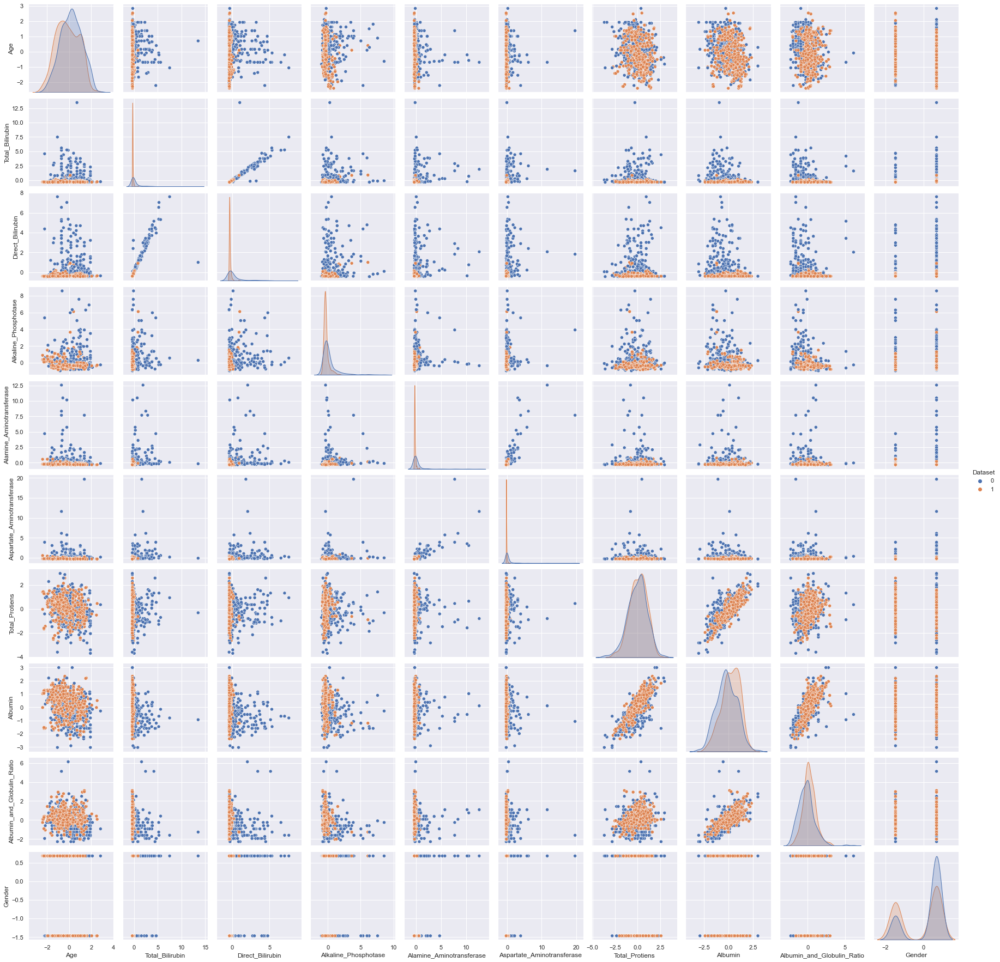

In [50]:
# Bivariate Visual Plot to See How DEFAULTER 1 & 0 is getting Seperated
Target=Liver[['Dataset']]
Variables=Continuous
Visual=concat([Variables,Target],axis=1)
pairplot(Visual,hue='Dataset')

In [51]:
# examine the duplicate rows (ignoring the first occurrence)
Liver.loc[Liver.duplicated(keep='first'), :]

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender,Dataset


In [52]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import VarianceThreshold
constant_filter = VarianceThreshold(threshold=0)
constant_filter.fit(X_train)
len(X_train.columns[constant_filter.get_support()])
constant_columns = [column for column in X_train.columns
                    if column not in X_train.columns[constant_filter.get_support()]]

print(len(constant_columns))
for column in constant_columns:
    print(column)
    
X_train = constant_filter.transform(X_train)
X_test = constant_filter.transform(X_test)

X_train.shape, X_test.shape

0


((649, 10), (163, 10))

In [53]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
qconstant_filter = VarianceThreshold(threshold=0.01)
qconstant_filter.fit(X_train)
len(X_train.columns[qconstant_filter.get_support()])
qconstant_columns = [column for column in X_train.columns
                    if column not in X_train.columns[qconstant_filter.get_support()]]

for column in qconstant_columns:
    print(column)
X_train = qconstant_filter.transform(X_train)
X_test = qconstant_filter.transform(X_test)

X_train.shape, X_test.shape

((649, 10), (163, 10))

In [54]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
X_train_T = X_train.T
X_train_T.shape
print(X_train_T.duplicated().sum())
unique_features = X_train_T.drop_duplicates(keep='first').T
unique_features.shape
duplicated_features = [dup_col for dup_col in X_train.columns if dup_col not in unique_features.columns]
duplicated_features

0


[]

In [55]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature
def correlation(dataset, threshold):
    col_corr = []  # Set of all the names of correlated columns
    corr_matrix = dataset.corr(method='pearson')
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.append(colname)
    return col_corr

X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
corr_features = Series(correlation(X_train, 0.8))
corr_features=corr_features.unique()
print(len(corr_features))
corr_features

2


array(['Direct_Bilirubin', 'Aspartate_Aminotransferase'], dtype=object)

In [56]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature

def correlation(dataset, threshold):
    col_corr = []  # Set of all the names of correlated columns
    corr_matrix = dataset.corr(method='spearman')
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.append(colname)
    return col_corr

X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
corr_features = Series(correlation(X_train, 0.8))
corr_features=corr_features.unique()
print(len(corr_features))
corr_features

1


array(['Direct_Bilirubin'], dtype=object)

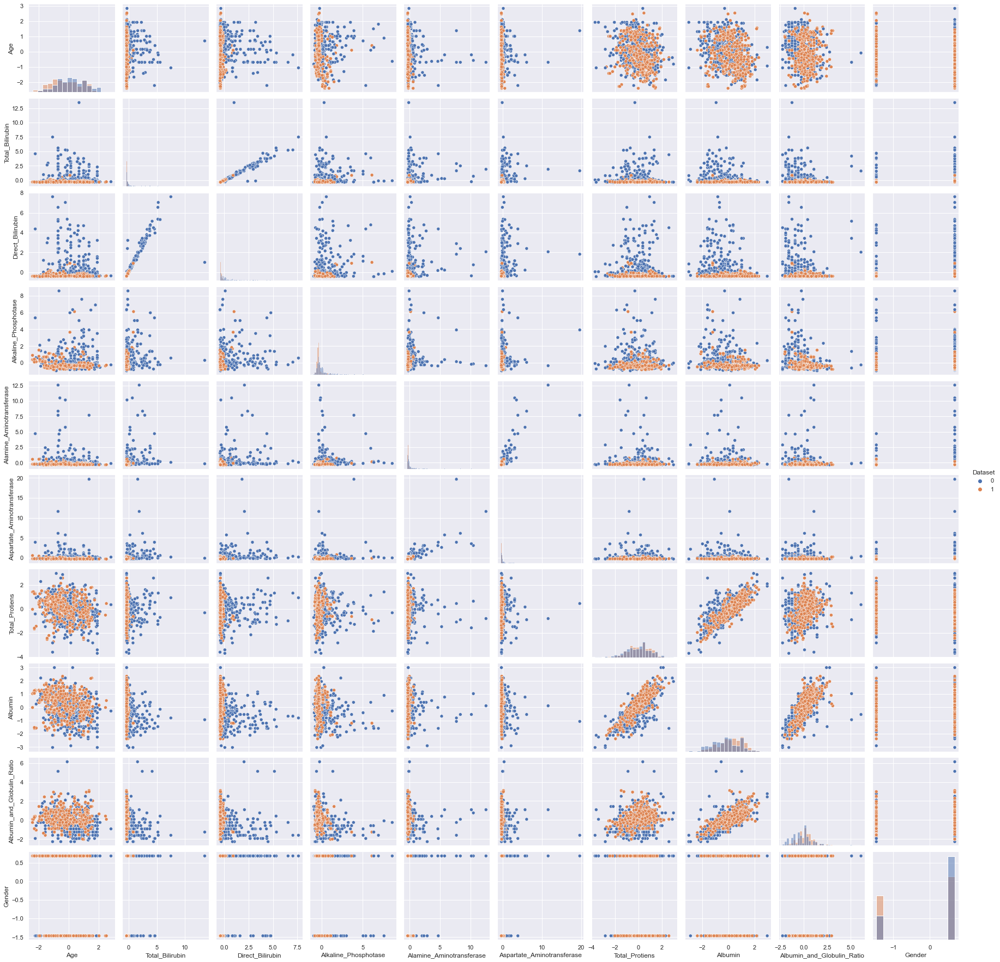

In [45]:
pairplot(Visual,hue='Dataset',diag_kind='hist');

<AxesSubplot:>

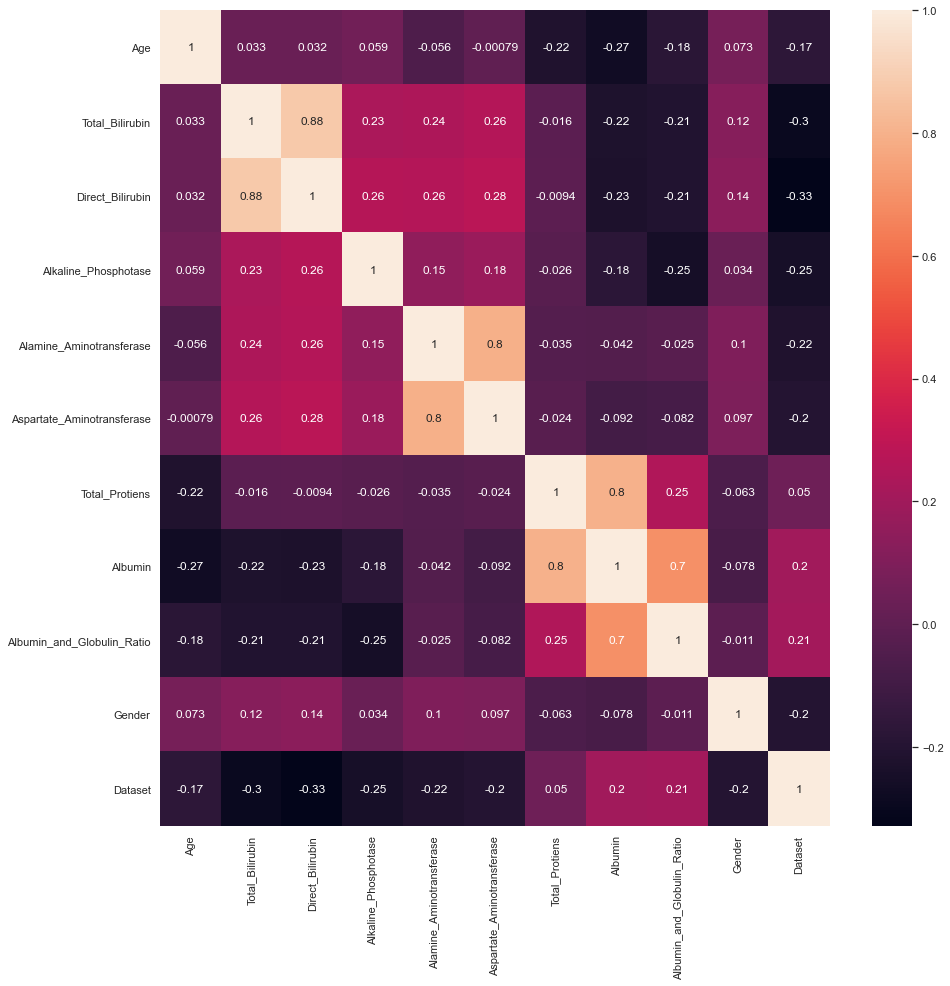

In [14]:
# Correlation plot by using heatmap
figure(figsize=(15,15)) # Assign the Plotting Figure Size of 8 by 8
heatmap(Liver.corr(method='pearson'), annot=True)

In [15]:
# Each Pair Combination of Feature & Label Correlation List
Liver.corr(method='pearson').Dataset.sort_values(ascending=False)

Dataset                       1.000000
Albumin_and_Globulin_Ratio    0.210072
Albumin                       0.202074
Total_Protiens                0.049915
Age                          -0.169404
Gender                       -0.201024
Aspartate_Aminotransferase   -0.203231
Alamine_Aminotransferase     -0.216582
Alkaline_Phosphotase         -0.249833
Total_Bilirubin              -0.295272
Direct_Bilirubin             -0.328412
Name: Dataset, dtype: float64

In [16]:
#Displaying correlation among all the columns
Liver.corr(method='pearson')

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender,Dataset
Age,1.000000,0.033094,0.031693,0.059046,-0.056357,-0.000790,-0.216332,-0.267738,-0.179667,0.072537,-0.169404
Total_Bilirubin,0.033094,1.000000,0.879695,0.234005,0.239729,0.258789,-0.015703,-0.221007,-0.212562,0.121261,-0.295272
Direct_Bilirubin,0.031693,0.879695,1.000000,0.263652,0.261049,0.279820,-0.009432,-0.228456,-0.209459,0.136134,-0.328412
Alkaline_Phosphotase,0.059046,0.234005,0.263652,1.000000,0.149213,0.184879,-0.025582,-0.176874,-0.252894,0.033885,-0.249833
Alamine_Aminotransferase,-0.056357,0.239729,0.261049,0.149213,1.000000,0.795574,-0.034791,-0.042477,-0.025209,0.101700,-0.216582
Aspartate_Aminotransferase,-0.000790,0.258789,0.279820,0.184879,0.795574,1.000000,-0.023910,-0.091835,-0.082299,0.096811,-0.203231
Total_Protiens,-0.216332,-0.015703,-0.009432,-0.025582,-0.034791,-0.023910,1.000000,0.798287,0.249267,-0.062703,0.049915
Albumin,-0.267738,-0.221007,-0.228456,-0.176874,-0.042477,-0.091835,0.798287,1.000000,0.698002,-0.078377,0.202074
Albumin_and_Globulin_Ratio,-0.179667,-0.212562,-0.209459,-0.252894,-0.025209,-0.082299,0.249267,0.698002,1.000000,-0.010896,0.210072
Gender,0.072537,0.121261,0.136134,0.033885,0.101700,0.096811,-0.062703,-0.078377,-0.010896,1.000000,-0.201024


# ANOVA F-Test Feature Selection

Train (649, 10) (649,)
Test (163, 10) (163,)
                            Corr_Score
Features                              
Direct_Bilirubin             78.626972
Total_Bilirubin              72.333673
Alkaline_Phosphotase         47.004263
Albumin_and_Globulin_Ratio   31.247810
Alamine_Aminotransferase     30.011703
Albumin                      28.033842
Gender                       27.995066
Aspartate_Aminotransferase   25.014319
Age                          15.677766
Total_Protiens                2.307946


<AxesSubplot:xlabel='Features'>

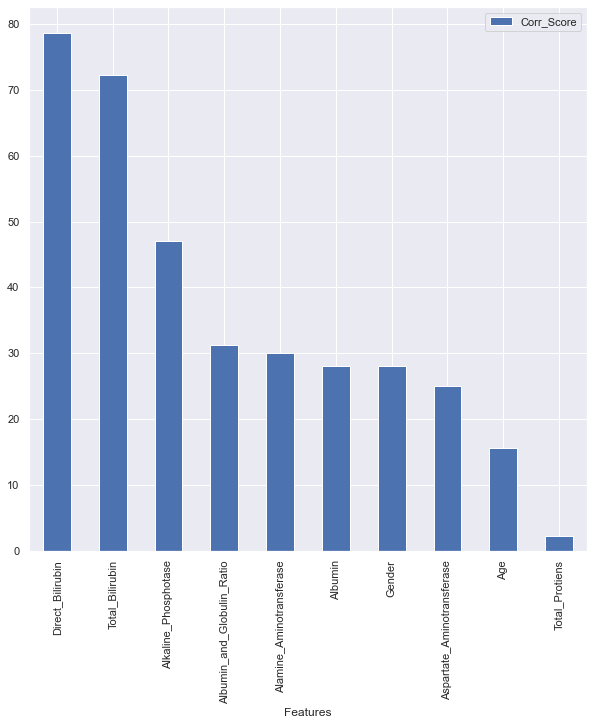

In [57]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif # f_classif represents ANOVA F-Test & justified here
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# feature selection
def select_features(X_train, Y_train, X_test):
    # configure to select all features
    fs = SelectKBest(score_func=f_classif, k='all')
    # learn relationship from training data
    fs.fit(X_train, Y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs
 
# split into train and test sets
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
# summarize
print('Train', X_train.shape, Y_train.shape)
print('Test', X_test.shape, Y_test.shape)
# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train, Y_train, X_test)
# what are scores for the features
# plot the scores
DataScores=DataFrame(fs.scores_,[i for i in range(len(fs.scores_))],columns=["Corr_Score"])
DataColumns=DataFrame(X_train.columns)
CorrRank=concat([DataColumns,DataScores],axis=1)
CorrRank.columns=['Features','Corr_Score']
# setting "Features" Column as index column
CorrRank.set_index("Features", inplace = True)
CorrRank.sort_values(by="Corr_Score",ascending=False, inplace=True)
print(CorrRank)
CorrRank.plot.bar() #neg_mean_squared_error

# Mutual Info Classification Feature Importance

Train (649, 10) (649,)
Test (163, 10) (163,)
                            Mutual_Info
Features                               
Total_Bilirubin                0.232341
Direct_Bilirubin               0.195381
Albumin                        0.189705
Albumin_and_Globulin_Ratio     0.183904
Total_Protiens                 0.128833
Alamine_Aminotransferase       0.111384
Alkaline_Phosphotase           0.105888
Aspartate_Aminotransferase     0.084057
Age                            0.078027
Gender                         0.017707


<AxesSubplot:xlabel='Features'>

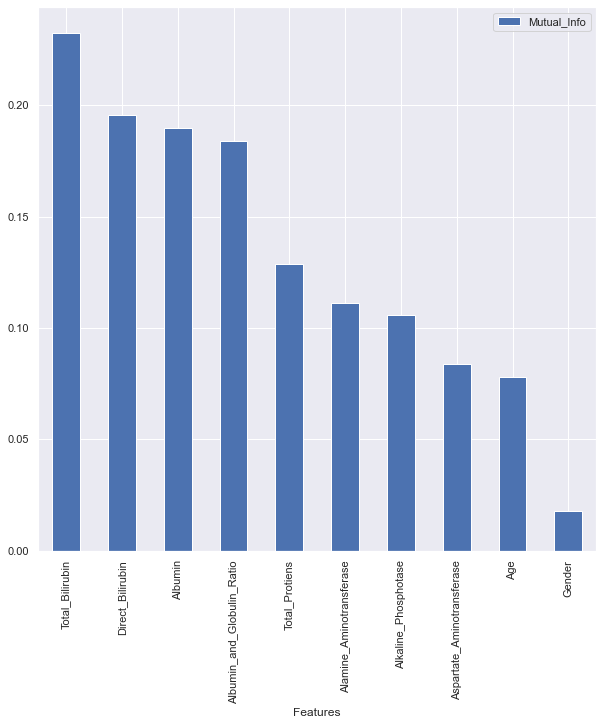

In [58]:
# https://pingouin-stats.org/
from sklearn.feature_selection import mutual_info_classif # is justified here in this classification problem
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# feature selection
def select_features(X_train, Y_train, X_test):
    # configure to select all features
    fs = SelectKBest(score_func=mutual_info_classif, k='all')
    # learn relationship from training data
    fs.fit(X_train, Y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs
 

# split into train and test sets
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
# summarize
print('Train', X_train.shape, Y_train.shape)
print('Test', X_test.shape, Y_test.shape)
# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train, Y_train, X_test)
# what are scores for the features
# plot the scores
DataScores=DataFrame(fs.scores_,[i for i in range(len(fs.scores_))],columns=["Mutual_Info"])
DataColumns=DataFrame(X_train.columns)
InfoRank=concat([DataColumns,DataScores],axis=1)
InfoRank.columns=['Features','Mutual_Info']
# setting "Features" Column as index column
InfoRank.set_index("Features", inplace = True)
InfoRank.sort_values(by="Mutual_Info",ascending=False, inplace=True)
print(InfoRank)
InfoRank.plot.bar()

## Mood's Median, Mann Whiteny U, Krushkal Wallis H, Wilcoxon Rank Sum, (Parametric) Point Biserial Correlation Coefficient, Eta Squared Test Feature Selection when Label is Categorical Nominal & Feature is Continuous Numerical
* https://www.youtube.com/watch?v=tWcEZSCNEuI
* https://www.youtube.com/watch?v=fEobVCV2TJE
* https://www.youtube.com/watch?v=At0NMw7HWMw
* https://www.youtube.com/watch?v=_S68TAmFw4U
* https://www.youtube.com/watch?v=BuJiv4-Kcu4

In [59]:
#"enginetype" is Nominal(Categorical) Independent Variable
# https://pingouin-stats.org/
#"Price" is Continuous(Ratio Scale) Dependent Variable
from pingouin import anova
from sklearn.model_selection import train_test_split
from scipy.stats import mannwhitneyu, kruskal, median_test, ranksums
#To find Correlation between "Price" & "enginetype" we will Perform Kruskal Wallis H Test
#It is Non Parametric Version of One-Way-Anova
#Correlation between CAR "Price" & CAR "enginetype"
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
Moods=concat([Y_train,X_train],axis=1)
#Sampling of "Price" for each category of "enginetype"
Bad=Moods[Moods.Dataset==1]
Good=Moods[Moods.Dataset==0]
# We will Remove 'Pclass_3',  from X_train
Biserial=concat([Y_train,X_train],axis=1)
Eta=concat([Y_train,X_train],axis=1)
Eta["Dataset"].replace({1: 'Bad', 0: 'Good'},inplace=True)
Point=Biserial["Dataset"] # Prepared for Point Biserial
X_train=X_train[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']]
#Each Sample Must have at least 5 measurements
#At least two or more samples work for this test
#The samples are not required to have the same length

#(Parametric) Point Biserial Correlation Coefficient Feature Selection
#When Label is Nominal Dichotomous Categorical & Feature is Continuous Numerical
#There Should Be No Outliers for the Continuous Variable ie "Faeture" for each category of the "Label" variable
#Continuous Variable Should be approximately normally distributed for each category of the "Label" variable
#Continuous Variable Should have equal Variances for Each Category of the "Label" variable
for i in X_train.columns:
    print('Feature:-',i)
    stat,pvalue,GrandMedian,ContigTable=median_test(Bad[i],Good[i])
    print(GrandMedian)
    print(ContigTable)
    if pvalue <= 0.05:
        print("Mood's Median Alternate Hypothesis (H1): Label and {} have some form of relationship.".format(i))
    else:
        print("Mood's Median Null Hypothesis (H0) : Label and {} are independent of each other.".format(i))
    print("Confidence Level : {} %".format(((1- pvalue)*100)))
    print('Statistics=%.3f, p=%.3f' % (stat, pvalue))
    stat,pvalue=mannwhitneyu(Bad[i],Good[i])
    if pvalue <= 0.05:
        print("Mannwhitneyu Alternate Hypothesis (H1): Label and {} have some form of relationship.".format(i))
    else:
        print("Mannwhitneyu Null Hypothesis (H0) : Label and {} are independent of each other.".format(i))
    print("Confidence Level : {} %".format(((1- pvalue)*100)))
    print('Statistics=%.3f, p=%.3f' % (stat, pvalue))
    stat,pvalue=kruskal(Bad[i],Good[i])
    if pvalue <= 0.05:
        print("Kruskal Alternate Hypothesis (H1): Label and {} have some form of relationship.".format(i))
    else:
        print("Kruskal Null Hypothesis (H0) : Label and {} are independent of each other.".format(i))
    print("Confidence Level : {} %".format(((1- pvalue)*100)))
    print('Statistics=%.3f, p=%.3f' % (stat, pvalue))
    correlation,pvalue = ranksums(Bad[i],Good[i])
    print("Wilcoxon Rank Sum correlation coefficient:%.3f" % correlation)
    print("Confidence Level : {} %".format(((1- pvalue)*100)))
    if pvalue <= 0.05:
        print("Wilcoxon Rank Sum Alternate Hypothesis (H1): Label and {} have non linear relationship.".format(i))
    else:
        print("Wilcoxon Rank Sum Null Hypothesis (H0) : Label and {} have no non linear relationship.".format(i))
    stat,pvalue=pointbiserialr(Point, X_train[i])
    if pvalue <= 0.05:
        print("Pointbiserialr Alternate Hypothesis (H1): Label and {} have some form of relationship.".format(i))
    else:
        print("Pointbiserialr Null Hypothesis (H0) : Label and {} are independent of each other.".format(i))
    print("Confidence Level : {} %".format(((1- pvalue)*100)))
    print('Statistics=%.3f, p=%.3f' % (stat, pvalue))
    aov=anova(dv=i,between='Dataset',data=Eta,detailed=True)
    print(aov)
    etaSq = aov.SS[0] / (aov.SS[0] + aov.SS[1])
    print(etaSq)
    if etaSq < .01:
        qual = 'Negligible'
    elif etaSq < .06:
        qual = 'Small'
    elif etaSq < .14:
        qual = 'Medium'
    else:
        qual = 'Large'
    print("Eta Squared Strength is:-",qual)
    print()

Feature:- Age
0.030664014089397503
[[138 184]
 [187 140]]
Mood's Median Alternate Hypothesis (H1): Label and Age have some form of relationship.
Confidence Level : 99.96455590375795 %
Statistics=12.758, p=0.000
Mannwhitneyu Alternate Hypothesis (H1): Label and Age have some form of relationship.
Confidence Level : 99.99081906487069 %
Statistics=43718.500, p=0.000
Kruskal Alternate Hypothesis (H1): Label and Age have some form of relationship.
Confidence Level : 99.98165342351366 %
Statistics=13.993, p=0.000
Wilcoxon Rank Sum correlation coefficient:-3.740
Confidence Level : 99.98158066720777 %
Wilcoxon Rank Sum Alternate Hypothesis (H1): Label and Age have non linear relationship.
Pointbiserialr Alternate Hypothesis (H1): Label and Age have some form of relationship.
Confidence Level : 99.9916568123506 %
Statistics=-0.154, p=0.000
    Source          SS   DF         MS          F     p-unc       np2
0  Dataset   15.630347    1  15.630347  15.677766  0.000083  0.023658
1   Within  645.0

In [60]:
X_train.corr(method='pearson')

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio
Age,1.000000,0.009541,0.015479,0.031821,-0.057129,0.004728,-0.215434,-0.277961,-0.185161
Total_Bilirubin,0.009541,1.000000,0.979090,0.245802,0.282658,0.301990,-0.009811,-0.234594,-0.256104
Direct_Bilirubin,0.015479,0.979090,1.000000,0.248983,0.268984,0.287094,-0.005813,-0.226483,-0.247523
Alkaline_Phosphotase,0.031821,0.245802,0.248983,1.000000,0.170226,0.203357,-0.009477,-0.168890,-0.272286
Alamine_Aminotransferase,-0.057129,0.282658,0.268984,0.170226,1.000000,0.808943,-0.050298,-0.064763,-0.036495
Aspartate_Aminotransferase,0.004728,0.301990,0.287094,0.203357,0.808943,1.000000,-0.024697,-0.099699,-0.089239
Total_Protiens,-0.215434,-0.009811,-0.005813,-0.009477,-0.050298,-0.024697,1.000000,0.797122,0.221447
Albumin,-0.277961,-0.234594,-0.226483,-0.168890,-0.064763,-0.099699,0.797122,1.000000,0.698565
Albumin_and_Globulin_Ratio,-0.185161,-0.256104,-0.247523,-0.272286,-0.036495,-0.089239,0.221447,0.698565,1.000000


In [61]:
X_train.corr(method='spearman')

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio
Age,1.000000,0.074334,0.071588,0.027173,-0.073967,-0.038944,-0.222565,-0.286088,-0.222048
Total_Bilirubin,0.074334,1.000000,0.937457,0.320849,0.386041,0.422660,0.009227,-0.168811,-0.241850
Direct_Bilirubin,0.071588,0.937457,1.000000,0.308652,0.339374,0.411578,-0.007621,-0.197852,-0.272599
Alkaline_Phosphotase,0.027173,0.320849,0.308652,1.000000,0.395813,0.385083,0.045951,-0.165887,-0.347975
Alamine_Aminotransferase,-0.073967,0.386041,0.339374,0.395813,1.000000,0.753922,0.004644,-0.047886,-0.082143
Aspartate_Aminotransferase,-0.038944,0.422660,0.411578,0.385083,0.753922,1.000000,-0.052884,-0.175655,-0.197601
Total_Protiens,-0.222565,0.009227,-0.007621,0.045951,0.004644,-0.052884,1.000000,0.790186,0.255096
Albumin,-0.286088,-0.168811,-0.197852,-0.165887,-0.047886,-0.175655,0.790186,1.000000,0.738574
Albumin_and_Globulin_Ratio,-0.222048,-0.241850,-0.272599,-0.347975,-0.082143,-0.197601,0.255096,0.738574,1.000000


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\outdated\utils.py:18: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.0, the latest is 0.2.1.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  **kwargs


## LogisticRegression Coefficients/Slope as Feature Importance (Upon Training Data)

Train (649, 10) (649,)
Test (163, 10) (163,)
                            Coefficient_Value
Features                                     
Albumin                              0.964233
Gender                              -0.220779
Alkaline_Phosphotase                -0.226819
Albumin_and_Globulin_Ratio          -0.273771
Total_Bilirubin                     -0.307155
Age                                 -0.347879
Total_Protiens                      -0.759945
Aspartate_Aminotransferase          -0.862628
Direct_Bilirubin                    -1.052692
Alamine_Aminotransferase            -1.373330


<AxesSubplot:xlabel='Features'>

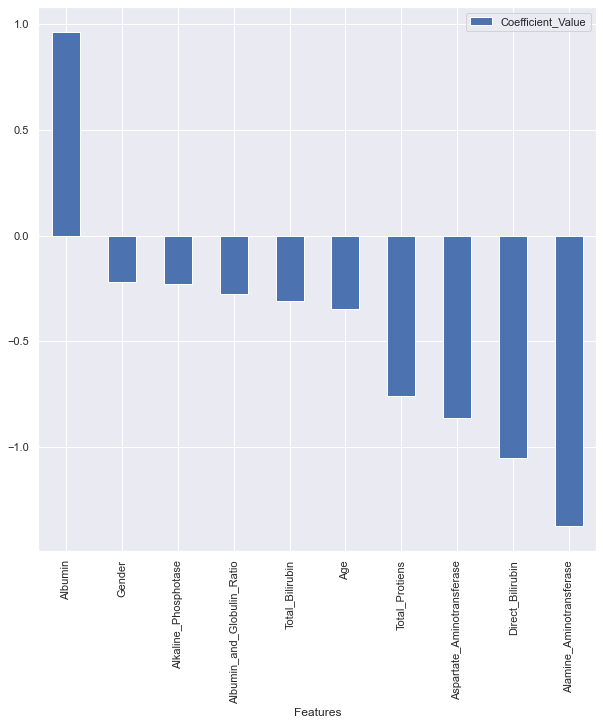

In [21]:
from sklearn.linear_model import LogisticRegression
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# define dataset
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3482)
# summarize
print('Train', X_train.shape, Y_train.shape)
print('Test', X_test.shape, Y_test.shape)
# define the model
model = LogisticRegression(random_state=999, class_weight='balanced')
# fit the model
model.fit(X_train, Y_train)
# get importance
importance = model.coef_[0]
# summarize feature importance
#for i,v in enumerate(importance):
    #print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
#pyplot.bar([x for x in range(len(importance))], importance)
#pyplot.show()
# plot the scores
DataScores=DataFrame(importance,[x for x in range(len(importance))],columns=["Coefficient_Value"])
DataColumns=DataFrame(X_train.columns)
CoefRank=concat([DataColumns,DataScores],axis=1)
CoefRank.columns=['Features','Coefficient_Value']
# setting "Features" Column as index column
CoefRank.set_index("Features", inplace = True)
CoefRank.sort_values(by="Coefficient_Value",ascending=False, inplace=True)
print(CoefRank)
CoefRank.plot.bar()

D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\yellowbrick\model_selection\importances.py:199: YellowbrickWarning: detected multi-dimensional feature importances but stack=False, using mean to aggregate them.
  YellowbrickWarning,


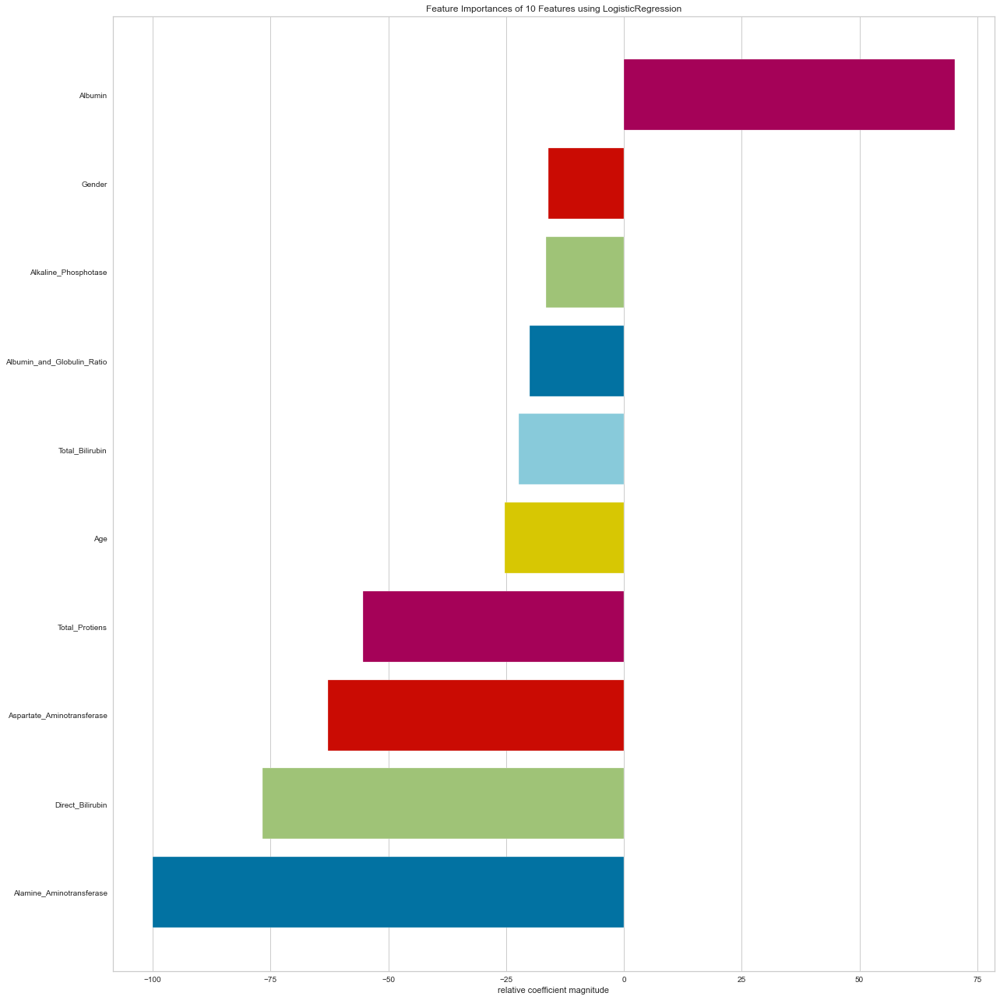

<AxesSubplot:title={'center':'Feature Importances of 10 Features using LogisticRegression'}, xlabel='relative coefficient magnitude'>

In [22]:
from yellowbrick.model_selection import FeatureImportances # Upon Training Data
# Changing default values for parameters individually
rcParams['figure.figsize'] = [18,18]
# Load the classification data set
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3482)
model = LogisticRegression(random_state=999, class_weight='balanced')
viz = FeatureImportances(model)
viz.fit(X_train, Y_train)
viz.show()

D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\yellowbrick\model_selection\importances.py:199: YellowbrickWarning: detected multi-dimensional feature importances but stack=False, using mean to aggregate them.
  YellowbrickWarning,


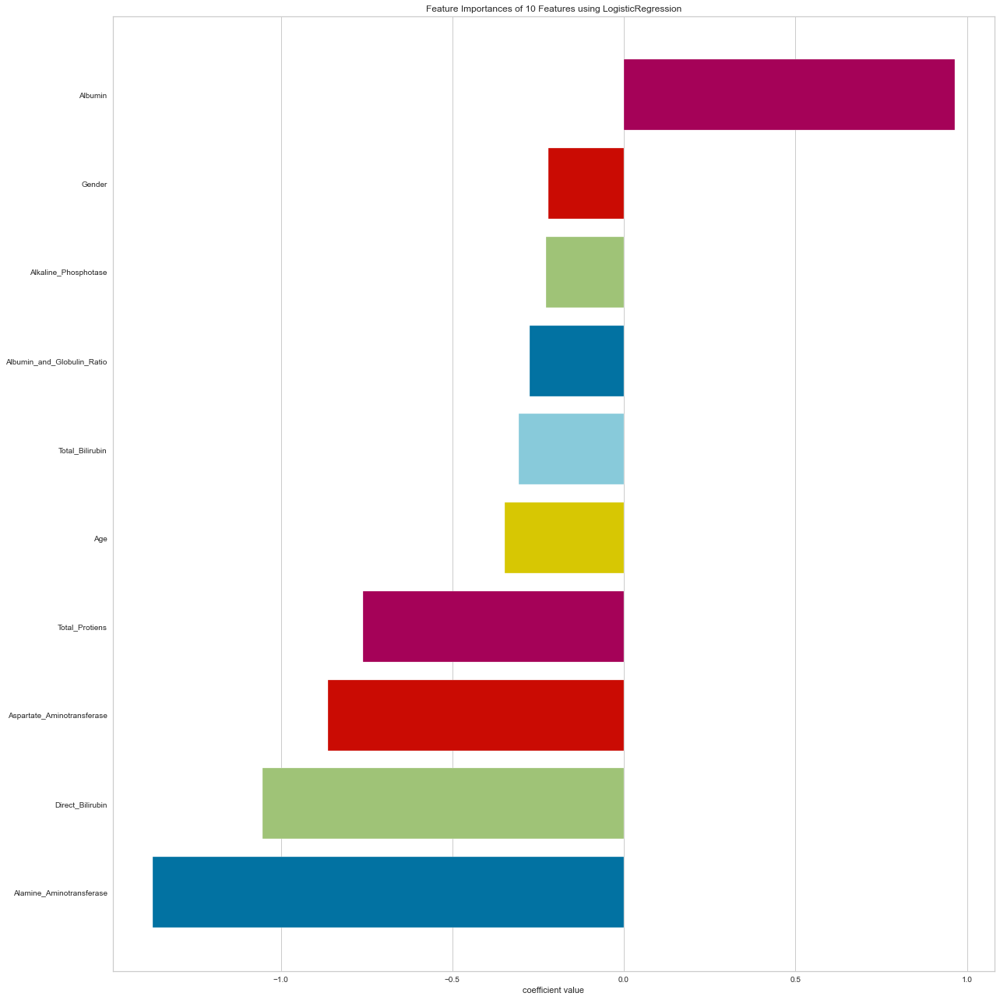

<AxesSubplot:title={'center':'Feature Importances of 10 Features using LogisticRegression'}, xlabel='coefficient value'>

In [23]:
from yellowbrick.model_selection import FeatureImportances # Relative Coefficient Feature Importance
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
# Changing default values for parameters individually
rcParams['figure.figsize'] = [18,18]
# Load the classification data set
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3482)
model = LogisticRegression(random_state=999, class_weight='balanced')
viz = FeatureImportances(model, relative=False)
viz.fit(X_train, Y_train)
viz.show()

## Standardized/Normalized LogisticRegression Coefficient Feature Selection

In [24]:
# Below link is for Scientific notation to Real Number Converter
# https://www.calculatorsoup.com/calculators/math/scientific-notation-converter.php
# Find out coefficients of the Features
# Label should be in 1D format
Features_Coeff = DataFrame(model.coef_[0],Features.columns,columns=['Coefficient'])
Features_Coeff

,Coefficient
Age,-0.347879
Total_Bilirubin,-0.307155
Direct_Bilirubin,-1.052692
Alkaline_Phosphotase,-0.226819
Alamine_Aminotransferase,-1.373330
Aspartate_Aminotransferase,-0.862628
Total_Protiens,-0.759945
Albumin,0.964233
Albumin_and_Globulin_Ratio,-0.273771
Gender,-0.220779


In [25]:
model.fit(X_train / std(X_train, 0), Y_train)
Logit_Coeff = DataFrame(model.coef_[0],Features.columns,columns=['Coefficient'])
Logit_Coeff

,Coefficient
Age,-0.342239
Total_Bilirubin,-0.296786
Direct_Bilirubin,-1.052890
Alkaline_Phosphotase,-0.240178
Alamine_Aminotransferase,-1.453879
Aspartate_Aminotransferase,-0.931884
Total_Protiens,-0.747325
Albumin,0.959471
Albumin_and_Globulin_Ratio,-0.281028
Gender,-0.219898


Age -> 0.9890176322305776
Total_Bilirubin -> 1.01222445819337
Direct_Bilirubin -> 0.9806167189366696
Alkaline_Phosphotase -> 1.0469183814736633
Alamine_Aminotransferase -> 1.0913628280860477
Aspartate_Aminotransferase -> 1.1027705513579722
Total_Protiens -> 0.9815357781344146
Albumin -> 0.9925476331893656
Albumin_and_Globulin_Ratio -> 1.0179600777517857
Gender -> 0.9938445906696582

Standardized/Normalized Regression Coefficient Feature Selection


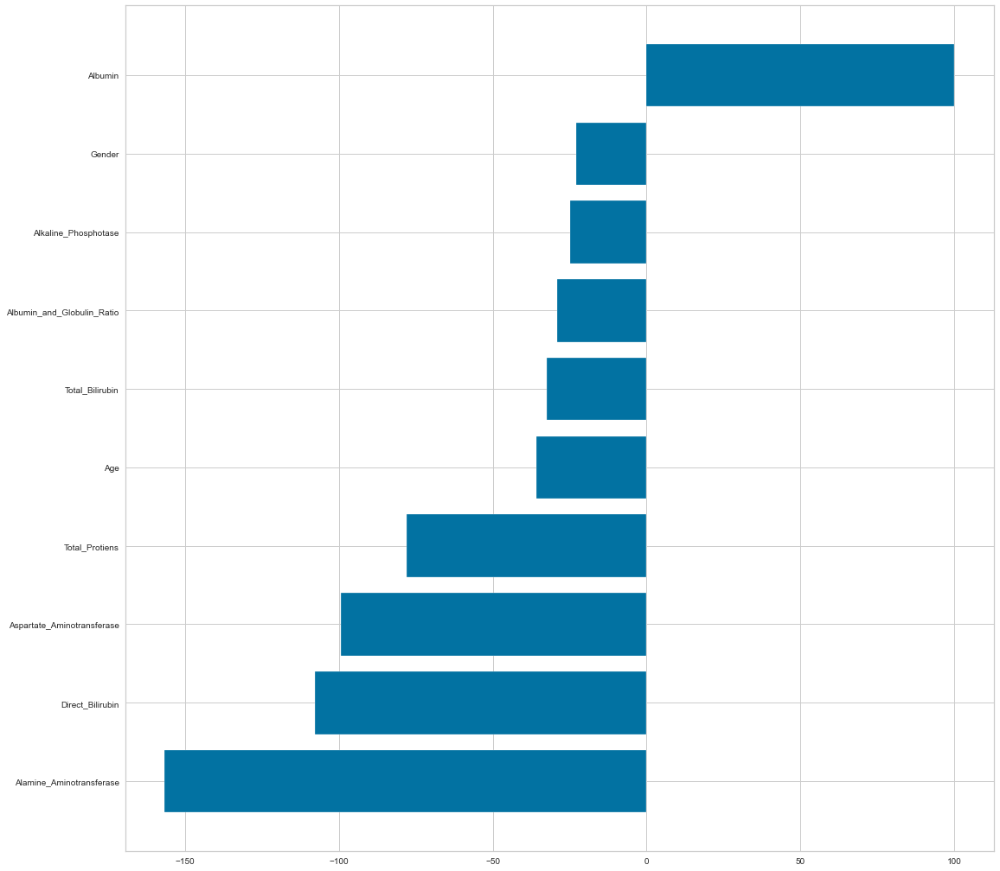

In [26]:
# Linear Regression Equation of My Model
# Standardized Coefficient of a Feature = (bi*Sxi)/Sy

# coefficients=model.coef_[0]
# print("Predicted Class = ",model.intercept_,"+ ",end="")
# for i in range(0, len(coefficients)):
#    print(coefficients[i],X_train.columns[i],"+ ",end="")
# print("E")
# print()
# print("Standard deviation of Each Feature Samples")

# Standard error of Each Feature Samples
# 'Series' object has no attribute 'stdev'
# We will use population std() instead of sample stdev()
# stdev() we use to find sample standard deviation with n-1 degree of freedom, but its doesn't work with series
# So we will use population Standard Deviation which is std()
# from statistics import stdev
from numpy import std
StdErrs = [] # blank list
for i in X_train.columns:
    StdErr = X_train[i].std()
    print(i,"->",StdErr)
    StdErrs.append(StdErr)
print()
print("Standardized/Normalized Regression Coefficient Feature Selection")
from numpy import array
Features_Coeff["Std"]=array(StdErrs).reshape(-1,1)
Features_Coeff["Importance"]=Features_Coeff["Std"]*Features_Coeff["Coefficient"]
Features_Coeff["Normalized_Importance"]=100*Features_Coeff["Importance"] / Features_Coeff["Importance"].max()
#pyplot.barh(Features_Coeff.index, Features_Coeff.Normalized_Importance)
Features_Coeff.sort_values(by="Normalized_Importance",ascending=True, inplace=True)
pyplot.barh(Features_Coeff.index, Features_Coeff.Normalized_Importance)
show()

In [27]:
## Feature Normalization
for i in X_train.columns:
    print(i)
    X_train[i] = X_train[i]/X_train[i].std()

Age
Total_Bilirubin
Direct_Bilirubin
Alkaline_Phosphotase
Alamine_Aminotransferase
Aspartate_Aminotransferase
Total_Protiens
Albumin
Albumin_and_Globulin_Ratio
Gender


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [28]:
X_train.head()

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender
617,0.092710,-0.330985,-0.354188,-0.401017,-0.220562,-0.166657,-0.667990,-0.454239,-0.133311,0.686652
142,0.401235,-0.190139,-0.145683,-0.218850,-0.280093,-0.247682,-0.611411,-0.420767,-0.052834,0.686652
262,-1.079687,-0.134861,-0.145683,-0.387688,-0.256281,-0.251365,1.649702,1.163184,0.079160,0.686652
143,0.154415,-0.337547,-0.396747,-0.378802,-0.268187,-0.174023,-0.513102,-0.420767,-0.250824,-1.474438
687,1.450221,-0.300695,-0.354903,-0.289940,-0.244375,-0.273462,-0.996325,-0.654892,-0.210359,-1.474438


In [29]:
model = LogisticRegression(random_state=999, class_weight='balanced').fit(X_train,Y_train)
model.score(X_train,Y_train)

0.7457627118644068

In [30]:
W = list(model.coef_[0])

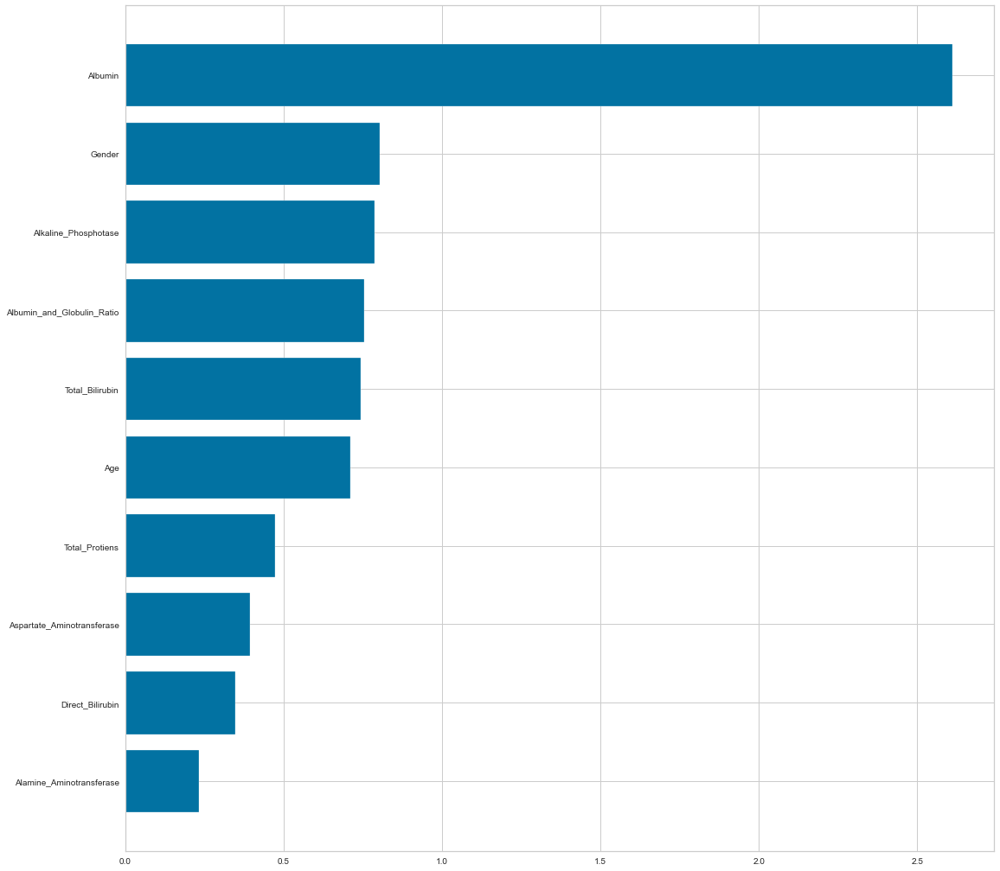

In [31]:
features_importance = DataFrame(X_train.columns,columns=['Features'])
features_importance['importance'] = pow(math.e, array(W))
features_importance.sort_values(by="importance",ascending=True, inplace=True)
pyplot.barh(features_importance.Features, features_importance.importance)
show()

# Sklearn Default Permutation Feature Importance by Using LogisticRegression, upon Training Data
* https://scikit-learn.org/stable/modules/permutation_importance.html#:~:text=The%20permutation%20feature%20importance%20is,model%20depends%20on%20the%20feature.

                            Mean Importance Score
Features                                         
Albumin                                  0.129176
Total_Protiens                           0.068886
Direct_Bilirubin                         0.043573
Age                                      0.039622
Alamine_Aminotransferase                 0.030564
Aspartate_Aminotransferase               0.025631
Albumin_and_Globulin_Ratio               0.022696
Alkaline_Phosphotase                     0.020223
Total_Bilirubin                          0.016385
Gender                                   0.015717


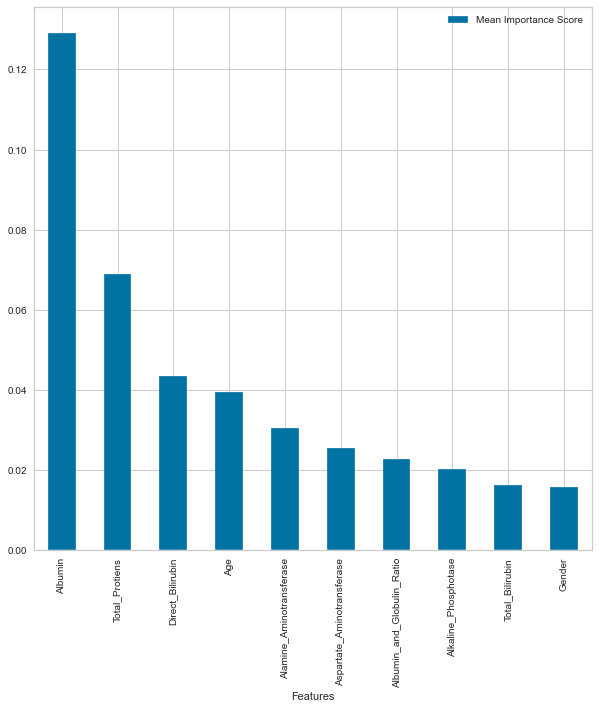

In [32]:
# Permutation Feature Importance by Using LinearRegression
from sklearn.inspection import permutation_importance
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# define dataset
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3482)
# define the model
model = LogisticRegression(random_state=999, class_weight='balanced')
# fit the model
model.fit(X_train, Y_train)
# perform permutation importance
results = permutation_importance(model, X_train, Y_train, scoring='balanced_accuracy', n_repeats=10, random_state=999)
# get importance
importance = results.importances_mean
# summarize feature importance
DataScores=DataFrame(importance,[x for x in range(len(importance))],columns=["Mean Importance Score"])
DataColumns=DataFrame(X_train.columns)
RMSERank=concat([DataColumns,DataScores],axis=1)
RMSERank.columns=['Features','Mean Importance Score']
# setting "Features" Column as index column
RMSERank.set_index("Features", inplace = True)
RMSERank.sort_values(by="Mean Importance Score",ascending=False, inplace=True)
print(RMSERank)
# plot feature importance
RMSERank.plot.bar()
show()

# eli5 Permutation Feature Importance by using Logistic Regression, upon Testing Data

In [33]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.2,random_state=3482)
model = LogisticRegression(random_state=999, class_weight='balanced').fit(X_train, Y_train)
perm = PermutationImportance(model, scoring='balanced_accuracy',n_iter=10,random_state=999).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1330 ± 0.0581,Albumin
0.0931 ± 0.0401,Total_Protiens
0.0710 ± 0.0325,Alamine_Aminotransferase
0.0399 ± 0.0176,Gender
0.0334 ± 0.0334,Aspartate_Aminotransferase
0.0208 ± 0.0276,Age
0.0201 ± 0.0245,Alkaline_Phosphotase
0.0185 ± 0.0383,Direct_Bilirubin
0.0176 ± 0.0335,Albumin_and_Globulin_Ratio
0.0121 ± 0.0226,Total_Bilirubin


eli5 Permutation Feature Importance:


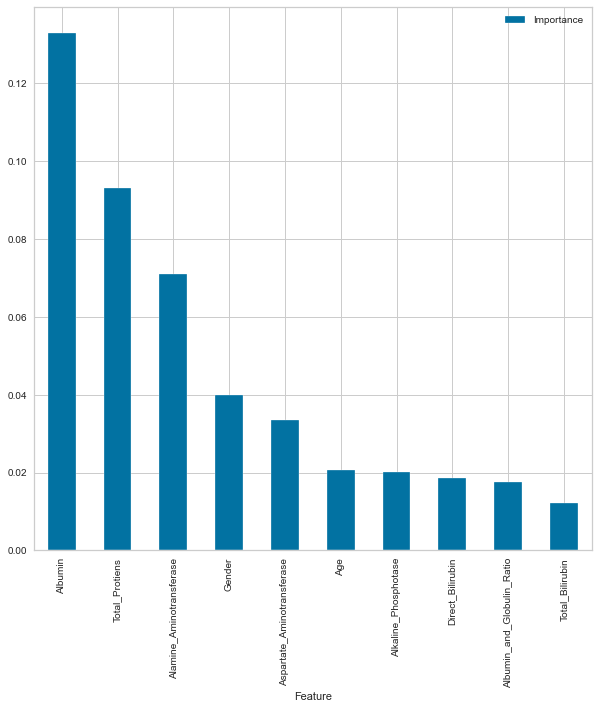

In [34]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.2,random_state=3482)
model = LogisticRegression(random_state=999, class_weight='balanced').fit(X_train, Y_train)
perm = PermutationImportance(model, scoring='balanced_accuracy',n_iter=10,random_state=999).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [35]:
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
from IPython.display import display
display(eli5.show_weights(model,top=None,feature_names=feature_names))

Weight?,Feature
+0.964,Albumin
-0.221,Gender
-0.227,Alkaline_Phosphotase
-0.274,Albumin_and_Globulin_Ratio
-0.307,Total_Bilirubin
-0.348,Age
-0.568,<BIAS>
-0.760,Total_Protiens
-0.863,Aspartate_Aminotransferase
-1.053,Direct_Bilirubin


In [36]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 4 # 4th row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(model, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

721    1
Name: Dataset, dtype: int64


# When we need to find eli5 permutation feature importance for non scikit-learn models, we use this method. (This is optional)

                            Mean Importance Score
Features                                         
Albumin                                  0.125170
Total_Protiens                           0.064581
Direct_Bilirubin                         0.040031
Age                                      0.038226
Alamine_Aminotransferase                 0.036732
Aspartate_Aminotransferase               0.025790
Albumin_and_Globulin_Ratio               0.020235
Alkaline_Phosphotase                     0.020225
Total_Bilirubin                          0.016999
Gender                                   0.014488


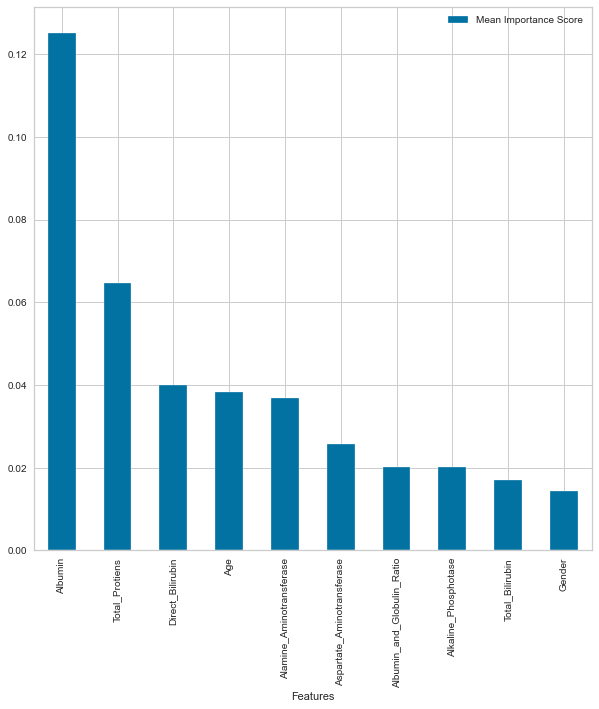

In [37]:
# We can also use eli5 to calculate feature importance for non scikit-learn models also. Here we train a LightGBM model.
from eli5.permutation_importance import get_score_importances
from sklearn.metrics import balanced_accuracy_score
from sklearn.linear_model import LogisticRegression
import numpy
#define a score function. In this case I use accuracy
model = LogisticRegression(class_weight='balanced',random_state=999).fit(X_train, Y_train)
# ... load data, define score function
def Bal_Accu(X_train, Y_train):
    Y_pred = model.predict(X_train)
    return balanced_accuracy_score(Y_train,Y_pred)
# This function takes only numpy arrays as inputs
base_score, score_decreases = get_score_importances(Bal_Accu, numpy.array(X_train), Y_train, n_iter=10, random_state=999)
feature_importances = numpy.mean(score_decreases, axis=0)
DataScores=DataFrame(feature_importances,[x for x in range(len(feature_importances))],columns=["Mean Importance Score"])
DataColumns=DataFrame(X_train.columns)
RMSERank=concat([DataColumns,DataScores],axis=1)
RMSERank.columns=['Features','Mean Importance Score']
# setting "Features" Column as index column
RMSERank.set_index("Features", inplace = True)
RMSERank.sort_values(by="Mean Importance Score",ascending=False, inplace=True)
print(RMSERank)
# plot feature importance
RMSERank.plot.bar()
show()

### rfpimp permutation feature importance
https://pypi.org/project/rfpimp/

rfpimp Permutation Feature Importance:


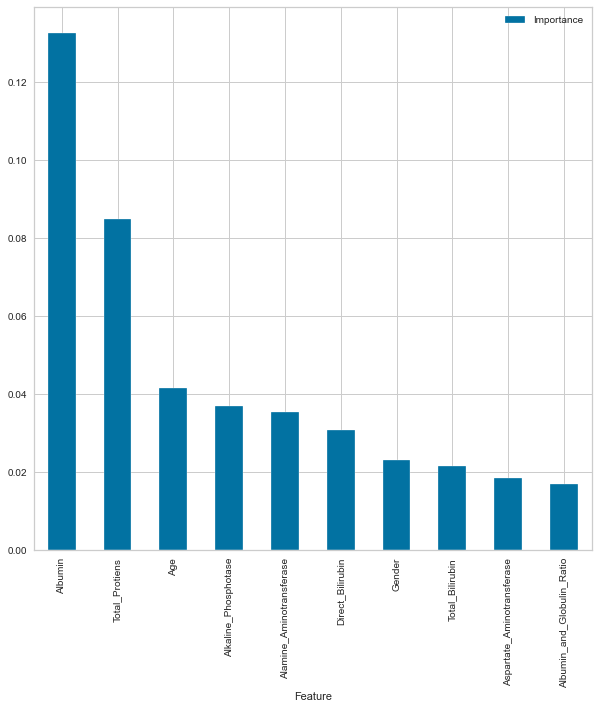

In [38]:
from sklearn.metrics import balanced_accuracy_score
from rfpimp import permutation_importances

def Bal_Accu(model, X_train, Y_train):
    return balanced_accuracy_score(Y_train,model.predict(X_train))
model = LogisticRegression(class_weight='balanced',random_state=999).fit(X_train, Y_train)
perm_imp_rfpimp = permutation_importances(model, X_train, Y_train, Bal_Accu)
perm_imp_rfpimp.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('rfpimp Permutation Feature Importance:')
perm_imp_rfpimp.plot.bar()
show()

# Drop Column Feature Importance @ balanced accuracy score, we will select all positive features as importance & remove all negative features step by step (based on training data)

In [62]:
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3482)
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Accuracy_score = balanced_accuracy_score(Y_train,model_clone.predict(X_train))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_train,model_clone2.predict(X_train.drop(col, axis = 1)))
        importances.append(Balanced_Accuracy_score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.038509
Gender                        0.021553
Alkaline_Phosphotase          0.020047
Total_Protiens                0.015423
Albumin                       0.013870
Aspartate_Aminotransferase    0.010793
Alamine_Aminotransferase      0.006140
Direct_Bilirubin              0.004639
Albumin_and_Globulin_Ratio    0.003082
Total_Bilirubin              -0.001543


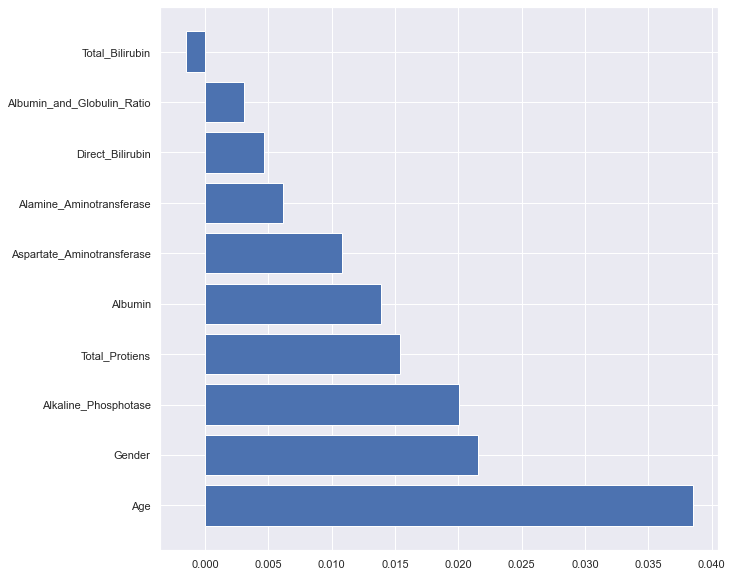

In [63]:
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
Logit=LogisticRegression(random_state=999, class_weight='balanced')
print('Drop-Col Feature Importance:')
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.2,random_state=3482)
print(drop_col_feat_imp(Logit, X_train, Y_train))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

# Logistic Regression

In [122]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

In [120]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

In [43]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    # Default LogisticRegression Model
    LiverModel=LogisticRegression(C=1.0, solver='lbfgs', class_weight='balanced', random_state=999, penalty='l2')
    
    LiverModel.fit(X_train,Y_train)
    
    train_score=LiverModel.score(X_train,Y_train)
    
    test_score=LiverModel.score(X_test,Y_test)
    
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverModel.predict(X_test))
    
    if test_score >= train_score:
        if Balanced_Accuracy_Score >= 0.82:
            print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8282208588957055 Train: 0.7257318952234206 Balanced_Accuracy: 0.8279132791327913 RandomState: 1364
Test: 0.8220858895705522 Train: 0.7257318952234206 Balanced_Accuracy: 0.82128876844324 RandomState: 1384
Test: 0.8220858895705522 Train: 0.7303543913713405 Balanced_Accuracy: 0.821364046973803 RandomState: 1747
Test: 0.8220858895705522 Train: 0.7288135593220338 Balanced_Accuracy: 0.821364046973803 RandomState: 1769
Test: 0.8220858895705522 Train: 0.7195685670261941 Balanced_Accuracy: 0.8226437819933754 RandomState: 1897
Test: 0.8282208588957055 Train: 0.7195685670261941 Balanced_Accuracy: 0.8285155073772961 RandomState: 2000
Test: 0.8282208588957055 Train: 0.7164869029275809 Balanced_Accuracy: 0.828440228846733 RandomState: 2268
Test: 0.8220858895705522 Train: 0.7211093990755008 Balanced_Accuracy: 0.8215146040349293 RandomState: 2476
Test: 0.8220858895705522 Train: 0.7272727272727273 Balanced_Accuracy: 0.8227943390545016 RandomState: 2862
Test: 0.8220858895705522 Train: 0.73189522

In [124]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='lbfgs', class_weight='balanced', random_state=999, penalty='l2') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7195685670261941
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5456513220121558
The Log Loss on Testing is:  0.45394772151439716


In [65]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7226502311248074
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5462523280588535
The Log Loss on Testing is:  0.4551169664080876


In [66]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='liblinear', class_weight='balanced', random_state=999, penalty='l2') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8224179464016863
Recall_Score: 0.8765432098765432
Precision_Score: 0.7888888888888889
              precision    recall  f1-score   support

           0       0.86      0.77      0.81        82
           1       0.79      0.88      0.83        81

    accuracy                           0.82       163
   macro avg       0.83      0.82      0.82       163
weighted avg       0.83      0.82      0.82       163

The Log Loss on Training is:  0.5457117130694354
The Log Loss on Testing is:  0.4542441228368371


In [67]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='lbfgs', class_weight='balanced', random_state=999, penalty='none') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7180277349768875
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8224179464016863
Recall_Score: 0.8765432098765432
Precision_Score: 0.7888888888888889
              precision    recall  f1-score   support

           0       0.86      0.77      0.81        82
           1       0.79      0.88      0.83        81

    accuracy                           0.82       163
   macro avg       0.83      0.82      0.82       163
weighted avg       0.83      0.82      0.82       163

The Log Loss on Training is:  0.5449651498677412
The Log Loss on Testing is:  0.447872980391908


In [68]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='sag', class_weight='balanced', random_state=999, penalty='none') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7195685670261941
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8224179464016863
Recall_Score: 0.8765432098765432
Precision_Score: 0.7888888888888889
              precision    recall  f1-score   support

           0       0.86      0.77      0.81        82
           1       0.79      0.88      0.83        81

    accuracy                           0.82       163
   macro avg       0.83      0.82      0.82       163
weighted avg       0.83      0.82      0.82       163

The Log Loss on Training is:  0.5450028424137363
The Log Loss on Testing is:  0.44844773235200663


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [69]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='sag', class_weight='balanced', random_state=999, penalty='l2') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7195685670261941
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5456580541645725
The Log Loss on Testing is:  0.4539841924640212


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [70]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='saga', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5461958685601096
The Log Loss on Testing is:  0.4553583267251224


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [71]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='saga', class_weight='balanced', random_state=999, penalty='l2') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7195685670261941
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5457084532489491
The Log Loss on Testing is:  0.45416904328357427


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [72]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='saga',class_weight='balanced',random_state=999,penalty='elasticnet',l1_ratio=0) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7195685670261941
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5457084532489491
The Log Loss on Testing is:  0.45416904328357427


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [73]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='saga',class_weight='balanced',random_state=999,penalty='elasticnet',l1_ratio=1) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5461958685601096
The Log Loss on Testing is:  0.4553583267251224


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [74]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='newton-cg',class_weight='balanced',random_state=999,penalty='none') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7180277349768875
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8224179464016863
Recall_Score: 0.8765432098765432
Precision_Score: 0.7888888888888889
              precision    recall  f1-score   support

           0       0.86      0.77      0.81        82
           1       0.79      0.88      0.83        81

    accuracy                           0.82       163
   macro avg       0.83      0.82      0.82       163
weighted avg       0.83      0.82      0.82       163

The Log Loss on Training is:  0.5449651546046355
The Log Loss on Testing is:  0.4478736836402039


In [75]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='newton-cg',class_weight='balanced',random_state=999,penalty='l2') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7195685670261941
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5456512753115228
The Log Loss on Testing is:  0.45394865022662745


# Best Hyper

In [76]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='saga',class_weight='balanced',random_state=999,penalty='elasticnet',l1_ratio=1) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5461958685601096
The Log Loss on Testing is:  0.4553583267251224


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [77]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='saga', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5461958685601096
The Log Loss on Testing is:  0.4553583267251224


D:\Anwesh\D_Program_Files\Miniconda3\envs\ML\lib\site-packages\sklearn\linear_model\_sag.py:329: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


In [78]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='liblinear', class_weight='balanced', random_state=999, penalty='l2') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8224179464016863
Recall_Score: 0.8765432098765432
Precision_Score: 0.7888888888888889
              precision    recall  f1-score   support

           0       0.86      0.77      0.81        82
           1       0.79      0.88      0.83        81

    accuracy                           0.82       163
   macro avg       0.83      0.82      0.82       163
weighted avg       0.83      0.82      0.82       163

The Log Loss on Training is:  0.5457117130694354
The Log Loss on Testing is:  0.4542441228368371


In [79]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7226502311248074
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8285155073772961
Recall_Score: 0.8765432098765432
Precision_Score: 0.797752808988764
              precision    recall  f1-score   support

           0       0.86      0.78      0.82        82
           1       0.80      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  0.5462523280588535
The Log Loss on Testing is:  0.4551169664080876


In [96]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    # Default LogisticRegression Model
    LiverModel=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
    
    LiverModel.fit(X_train,Y_train)
    
    train_score=LiverModel.score(X_train,Y_train)
    
    test_score=LiverModel.score(X_test,Y_test)
    
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverModel.predict(X_test))
    
    if test_score >= train_score:
        if Balanced_Accuracy_Score >= 0.82:
            print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8404907975460123 Train: 0.7211093990755008 Balanced_Accuracy: 0.8398072869617585 RandomState: 240
Test: 0.8282208588957055 Train: 0.7272727272727273 Balanced_Accuracy: 0.8273863294188497 RandomState: 1384
Test: 0.8220858895705522 Train: 0.7226502311248074 Balanced_Accuracy: 0.8215146040349293 RandomState: 1387
Test: 0.8282208588957055 Train: 0.7334360554699538 Balanced_Accuracy: 0.8275368864799759 RandomState: 1747
Test: 0.8220858895705522 Train: 0.7318952234206472 Balanced_Accuracy: 0.82128876844324 RandomState: 1769
Test: 0.8282208588957055 Train: 0.7226502311248074 Balanced_Accuracy: 0.8285155073772961 RandomState: 2000
Test: 0.8282208588957055 Train: 0.7180277349768875 Balanced_Accuracy: 0.828440228846733 RandomState: 2268
Test: 0.8282208588957055 Train: 0.7257318952234206 Balanced_Accuracy: 0.827612165010539 RandomState: 2476
Test: 0.8220858895705522 Train: 0.7272727272727273 Balanced_Accuracy: 0.8227943390545016 RandomState: 2862
Test: 0.8220858895705522 Train: 0.73651771

In [80]:
#Final Implmentation of Heart Logistic Regression
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=240)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8398072869617585
Recall_Score: 0.9512195121951219
Precision_Score: 0.78
              precision    recall  f1-score   support

           0       0.94      0.73      0.82        81
           1       0.78      0.95      0.86        82

    accuracy                           0.84       163
   macro avg       0.86      0.84      0.84       163
weighted avg       0.86      0.84      0.84       163

The Log Loss on Training is:  0.5441920578424071
The Log Loss on Testing is:  0.46061825417940605


In [81]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.061427
Gender                        0.049157
Alkaline_Phosphotase          0.042909
Total_Protiens                0.024466
Albumin                       0.018368
Direct_Bilirubin              0.018293
Aspartate_Aminotransferase    0.012270
Alamine_Aminotransferase      0.006173
Total_Bilirubin               0.000000
Albumin_and_Globulin_Ratio    0.000000


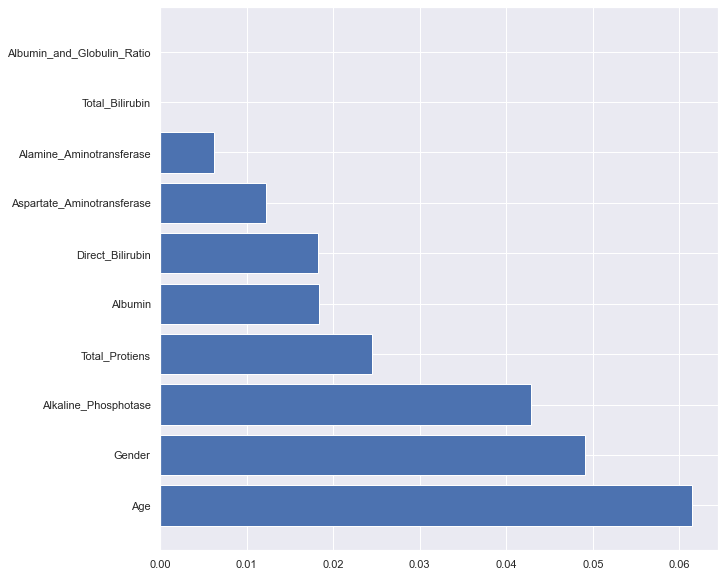

In [82]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=240)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

In [83]:
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=240)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7211093990755008
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8398072869617585
Recall_Score: 0.9512195121951219
Precision_Score: 0.78
              precision    recall  f1-score   support

           0       0.94      0.73      0.82        81
           1       0.78      0.95      0.86        82

    accuracy                           0.84       163
   macro avg       0.86      0.84      0.84       163
weighted avg       0.86      0.84      0.84       163

The Log Loss on Training is:  0.5441920578424071
The Log Loss on Testing is:  0.46061825417940605


In [84]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.048856
Gender                        0.042758
Alamine_Aminotransferase      0.030563
Aspartate_Aminotransferase    0.018443
Albumin_and_Globulin_Ratio    0.018293
Alkaline_Phosphotase          0.006173
Direct_Bilirubin              0.000075
Total_Bilirubin               0.000000
Albumin                       0.000000


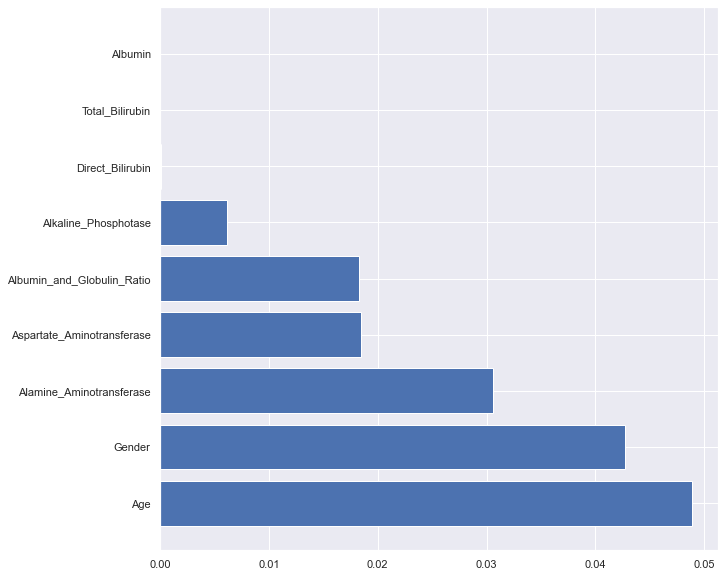

Train_Score: 0.7180277349768875
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8346130683529058
Recall_Score: 0.8765432098765432
Precision_Score: 0.8068181818181818
              precision    recall  f1-score   support

           0       0.87      0.79      0.83        82
           1       0.81      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.84      0.83      0.83       163

The Log Loss on Training is:  0.5493648512923482
The Log Loss on Testing is:  0.4606458294826607


In [85]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
        'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2000)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
# Check model
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

In [86]:
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
         'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7180277349768875
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8346130683529058
Recall_Score: 0.8765432098765432
Precision_Score: 0.8068181818181818
              precision    recall  f1-score   support

           0       0.87      0.79      0.83        82
           1       0.81      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.84      0.83      0.83       163

The Log Loss on Training is:  0.5494170787269574
The Log Loss on Testing is:  0.46035334613106554


In [113]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=i)
    # Default LogisticRegression Model
    LiverModel=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
    
    LiverModel.fit(X_train,Y_train)
    
    train_score=LiverModel.score(X_train,Y_train)
    
    test_score=LiverModel.score(X_test,Y_test)
    
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverModel.predict(X_test))
    
    if test_score >= train_score:
        if Balanced_Accuracy_Score >= 0.82:
            print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8220858895705522 Train: 0.724191063174114 Balanced_Accuracy: 0.8226437819933754 RandomState: 198
Test: 0.8404907975460123 Train: 0.7257318952234206 Balanced_Accuracy: 0.8398072869617585 RandomState: 240
Test: 0.8220858895705522 Train: 0.724191063174114 Balanced_Accuracy: 0.8218157181571816 RandomState: 1364
Test: 0.8282208588957055 Train: 0.724191063174114 Balanced_Accuracy: 0.8273863294188497 RandomState: 1384
Test: 0.8220858895705522 Train: 0.7226502311248074 Balanced_Accuracy: 0.8215146040349293 RandomState: 1387
Test: 0.8282208588957055 Train: 0.7334360554699538 Balanced_Accuracy: 0.8275368864799759 RandomState: 1747
Test: 0.8282208588957055 Train: 0.7226502311248074 Balanced_Accuracy: 0.8285155073772961 RandomState: 2000
Test: 0.8282208588957055 Train: 0.7180277349768875 Balanced_Accuracy: 0.828440228846733 RandomState: 2268
Test: 0.8282208588957055 Train: 0.7257318952234206 Balanced_Accuracy: 0.827612165010539 RandomState: 2476
Test: 0.8220858895705522 Train: 0.7272727272

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.067525
Gender                        0.043135
Alkaline_Phosphotase          0.042909
Total_Protiens                0.036811
Direct_Bilirubin              0.036360
Albumin                       0.030789
Aspartate_Aminotransferase    0.018368
Alamine_Aminotransferase      0.012195


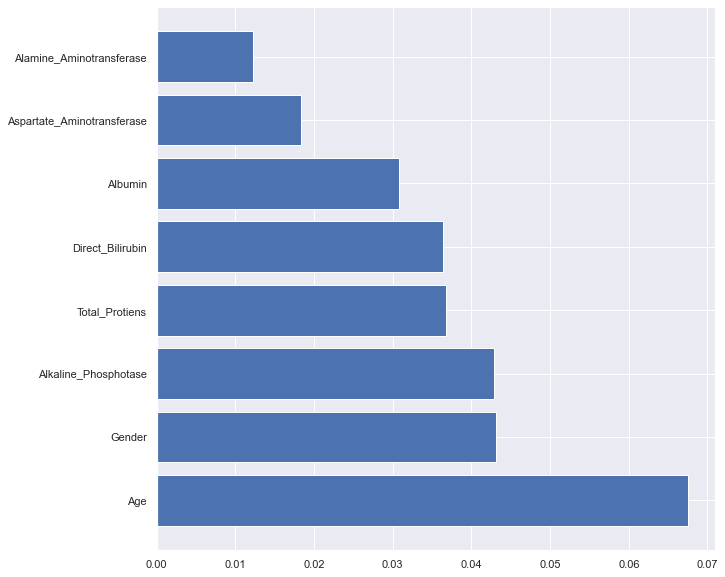

In [87]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2974)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

In [88]:
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=240)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7257318952234206
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8398072869617585
Recall_Score: 0.9512195121951219
Precision_Score: 0.78
              precision    recall  f1-score   support

           0       0.94      0.73      0.82        81
           1       0.78      0.95      0.86        82

    accuracy                           0.84       163
   macro avg       0.86      0.84      0.84       163
weighted avg       0.86      0.84      0.84       163

The Log Loss on Training is:  0.5451798483859005
The Log Loss on Testing is:  0.4601373855894895


In [89]:
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.736517719568567
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8212134899126768
Recall_Score: 0.9634146341463414
Precision_Score: 0.7523809523809524
              precision    recall  f1-score   support

           0       0.95      0.68      0.79        81
           1       0.75      0.96      0.84        82

    accuracy                           0.82       163
   macro avg       0.85      0.82      0.82       163
weighted avg       0.85      0.82      0.82       163

The Log Loss on Training is:  0.539616307350824
The Log Loss on Testing is:  0.4796500164212017


In [90]:
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=3660)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7272727272727273
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8288166214995483
Recall_Score: 0.9259259259259259
Precision_Score: 0.7731958762886598
              precision    recall  f1-score   support

           0       0.91      0.73      0.81        82
           1       0.77      0.93      0.84        81

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.84      0.83      0.83       163

The Log Loss on Training is:  0.5334236509749095
The Log Loss on Testing is:  0.5081340780850111


In [91]:
SFFS1.columns

Index(['Age', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.055254
Gender                        0.042984
Direct_Bilirubin              0.030488
Alkaline_Phosphotase          0.024541
Total_Protiens                0.024466
Albumin                       0.018443
Alamine_Aminotransferase      0.006173
Aspartate_Aminotransferase    0.006098


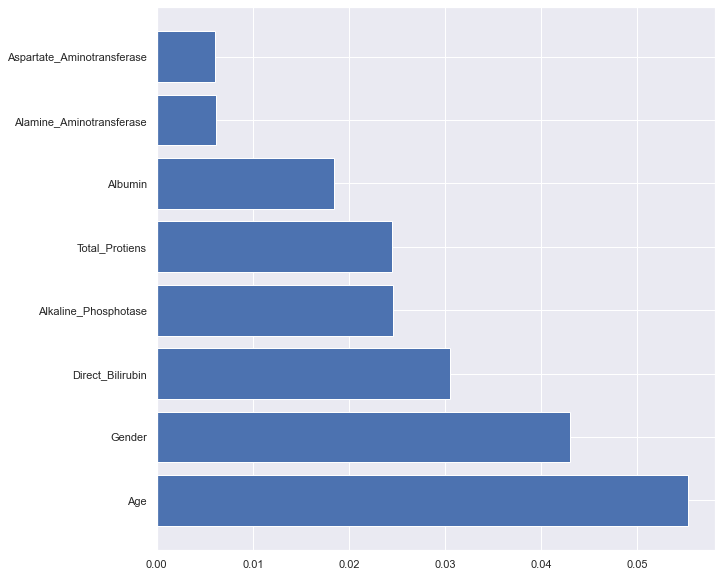

In [92]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=240)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.067525
Gender                        0.043135
Alkaline_Phosphotase          0.042909
Total_Protiens                0.036811
Direct_Bilirubin              0.036360
Albumin                       0.030789
Aspartate_Aminotransferase    0.018368
Alamine_Aminotransferase      0.012195


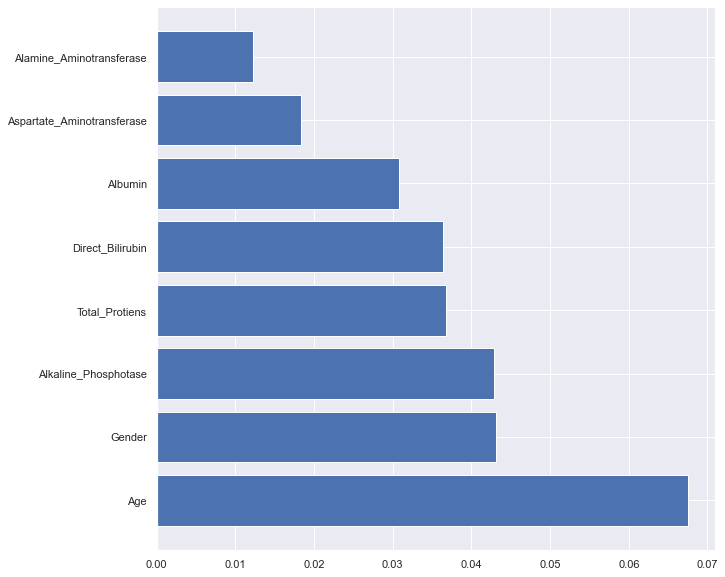

In [93]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2974)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

In [94]:
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
         'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2000)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7180277349768875
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8346130683529058
Recall_Score: 0.8765432098765432
Precision_Score: 0.8068181818181818
              precision    recall  f1-score   support

           0       0.87      0.79      0.83        82
           1       0.81      0.88      0.84        81

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.84      0.83      0.83       163

The Log Loss on Training is:  0.5494170787269574
The Log Loss on Testing is:  0.46035334613106554


In [95]:
# Coefficient of Features
coef = LiverModel.coef_[0]
DataFrame(coef, X_train.columns, columns=['coef'])

,coef
Age,-0.308181
Direct_Bilirubin,-1.342537
Alkaline_Phosphotase,-0.217263
Alamine_Aminotransferase,-1.107893
Aspartate_Aminotransferase,-1.061721
Albumin_and_Globulin_Ratio,0.225553
Gender,-0.233866


Random (chance) Prediction: AUROC = 0.500
LogisticRegression: AUROC = 0.867


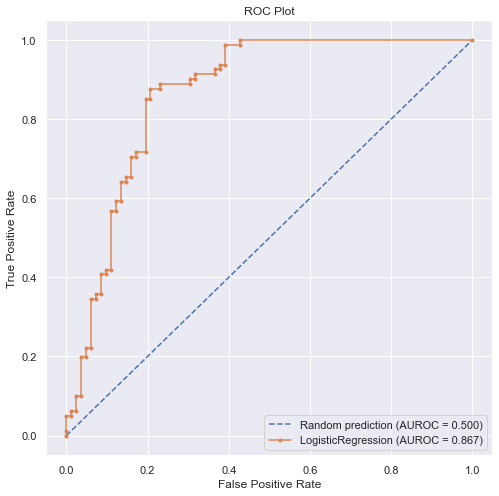

In [97]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
rcParams['figure.figsize'] = [8,8]
r_probs = [0 for _ in range(len(Y_test))]
LiverModel_probs = LiverModel.predict_proba(X_test)
LiverModel_probs = LiverModel_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverModel_auc = roc_auc_score(Y_test, LiverModel_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('LogisticRegression: AUROC = %.3f' % (LiverModel_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverModel_fpr, LiverModel_tpr, _ = roc_curve(Y_test, LiverModel_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverModel_fpr, LiverModel_tpr, marker='.', label='LogisticRegression (AUROC = %0.3f)' % LiverModel_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

In [98]:
#Final Implmentation of Heart Logistic Regression
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
SFFS1 = Features[['Age',  'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin',  'Gender']]
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.736517719568567
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8212134899126768
Recall_Score: 0.9634146341463414
Precision_Score: 0.7523809523809524
              precision    recall  f1-score   support

           0       0.95      0.68      0.79        81
           1       0.75      0.96      0.84        82

    accuracy                           0.82       163
   macro avg       0.85      0.82      0.82       163
weighted avg       0.85      0.82      0.82       163

The Log Loss on Training is:  0.539616307350824
The Log Loss on Testing is:  0.4796500164212017


In [126]:
# Looping Over The Parametres
from sklearn.metrics import log_loss
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
# Here we have selected geomspace range for C value because it is probably best for finding Global Minimum Loss
C_List = geomspace(0.01,100.0,num=100)
Balanced_Accuracy = []
Log_Loss = []
for c in C_List:
    LiverModel=LogisticRegression(C=c, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
    LiverModel.fit(X_train,Y_train)
    Balanced_Score=balanced_accuracy_score(Y_test,LiverModel.predict(X_test))
    Balanced_Accuracy.append(Balanced_Score)
    print("The Balanced Accuracy of C parameter {} is {}:".format(c,Balanced_Score))
    Predicted_Proba_Y = LiverModel.predict_proba(X_test)
    Log_Loss2 = log_loss(Y_test,Predicted_Proba_Y)
    Log_Loss.append(Log_Loss2)
    print("The Log Loss of C parameter {} is {}:".format(c, Log_Loss2))
    print("")

The Balanced Accuracy of C parameter 0.01 is 0.7039295392953929:
The Log Loss of C parameter 0.01 is 0.6927673309825131:

The Balanced Accuracy of C parameter 0.010974987654930561 is 0.7039295392953929:
The Log Loss of C parameter 0.010974987654930561 is 0.681676635141137:

The Balanced Accuracy of C parameter 0.012045035402587823 is 0.7039295392953929:
The Log Loss of C parameter 0.012045035402587823 is 0.6720955042266779:

The Balanced Accuracy of C parameter 0.013219411484660288 is 0.7039295392953929:
The Log Loss of C parameter 0.013219411484660288 is 0.6636162355615671:

The Balanced Accuracy of C parameter 0.014508287784959394 is 0.7101023788015658:
The Log Loss of C parameter 0.014508287784959394 is 0.6547241039671045:

The Balanced Accuracy of C parameter 0.015922827933410922 is 0.7101023788015658:
The Log Loss of C parameter 0.015922827933410922 is 0.6459982919321797:

The Balanced Accuracy of C parameter 0.01747528400007684 is 0.7162752183077385:
The Log Loss of C parameter 0

The Log Loss of C parameter 4.229242874389499 is 0.4772523111190651:

The Balanced Accuracy of C parameter 4.641588833612782 is 0.8151159289370671:
The Log Loss of C parameter 4.641588833612782 is 0.4771899434245771:

The Balanced Accuracy of C parameter 5.09413801481638 is 0.8151159289370671:
The Log Loss of C parameter 5.09413801481638 is 0.4771332954260679:

The Balanced Accuracy of C parameter 5.590810182512229 is 0.8151159289370671:
The Log Loss of C parameter 5.590810182512229 is 0.4770818293430771:

The Balanced Accuracy of C parameter 6.135907273413176 is 0.8151159289370671:
The Log Loss of C parameter 6.135907273413176 is 0.47703506002537016:

The Balanced Accuracy of C parameter 6.7341506577508286 is 0.8151159289370671:
The Log Loss of C parameter 6.7341506577508286 is 0.47699254949277664:

The Balanced Accuracy of C parameter 7.390722033525782 is 0.8151159289370671:
The Log Loss of C parameter 7.390722033525782 is 0.47695390209429084:

The Balanced Accuracy of C parameter 8.

In [127]:
# Putting the Outcomes in A Table & Reshaping
Balanced_Accuracy = array(Balanced_Accuracy).reshape(100,)
LoG_LoSs = array(Log_Loss).reshape(100,)
# Zip
Outcomes = zip(C_List,Balanced_Accuracy,LoG_LoSs)
# DataFrame
DF_Outcomes = DataFrame(Outcomes, columns=["C_List","Balanced_Accuracy","LoG_LoSs"])
# Print DF_Outcomes
DF_Outcomes
# Re-Ordering the DF_Outcomes
DF_Outcomes.sort_values("LoG_LoSs", ascending=True).reset_index()

,index,C_List,Balanced_Accuracy,LoG_LoSs
0,99,100.000000,0.815116,0.476591
1,98,91.116276,0.815116,0.476594
2,97,83.021757,0.815116,0.476597
3,96,75.646333,0.815116,0.476600
4,95,68.926121,0.815116,0.476604
5,94,62.802914,0.815116,0.476608
6,93,57.223677,0.815116,0.476612
7,92,52.140083,0.815116,0.476617
8,91,47.508102,0.815116,0.476623
9,90,43.287613,0.815116,0.476629


In [99]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

In [100]:
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data

LogisticRegression(class_weight='balanced', penalty='l1', random_state=999,
                   solver='liblinear')

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.067525
Albumin                       0.055179
Gender                        0.043135
Total_Protiens                0.042984
Alkaline_Phosphotase          0.042909
Direct_Bilirubin              0.018368
Aspartate_Aminotransferase    0.018368
Alamine_Aminotransferase      0.012195
Total_Bilirubin               0.000000
Albumin_and_Globulin_Ratio    0.000000


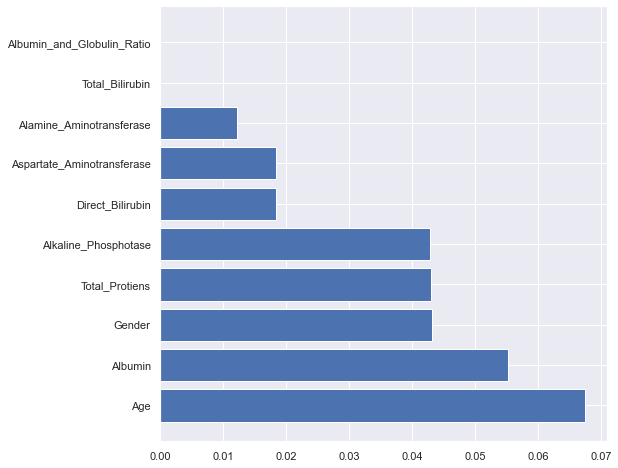

Train_Score: 0.736517719568567
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8212134899126768
Recall_Score: 0.9634146341463414
Precision_Score: 0.7523809523809524
              precision    recall  f1-score   support

           0       0.95      0.68      0.79        81
           1       0.75      0.96      0.84        82

    accuracy                           0.82       163
   macro avg       0.85      0.82      0.82       163
weighted avg       0.85      0.82      0.82       163

The Log Loss on Training is:  0.5395982572549598
The Log Loss on Testing is:  0.4796861717881929


In [101]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2974)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
# Check Model
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.067525
Albumin                       0.055179
Gender                        0.043135
Total_Protiens                0.042984
Alkaline_Phosphotase          0.042909
Direct_Bilirubin              0.018368
Aspartate_Aminotransferase    0.018368
Alamine_Aminotransferase      0.012195
Total_Bilirubin               0.000000
Albumin_and_Globulin_Ratio    0.000000


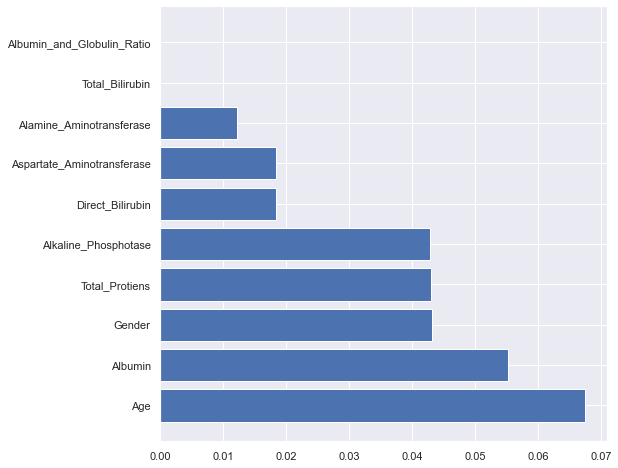

Train_Score: 0.736517719568567
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8212134899126768
Recall_Score: 0.9634146341463414
Precision_Score: 0.7523809523809524
              precision    recall  f1-score   support

           0       0.95      0.68      0.79        81
           1       0.75      0.96      0.84        82

    accuracy                           0.82       163
   macro avg       0.85      0.82      0.82       163
weighted avg       0.85      0.82      0.82       163

The Log Loss on Training is:  0.5395982572549598
The Log Loss on Testing is:  0.4796861717881929


In [102]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
#Final Implmentation of Heart Logistic Regression
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2974)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
Logit=LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1')
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(Logit, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
# Check Model
from sklearn.metrics import balanced_accuracy_score
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

In [103]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

In [125]:
from sklearn.linear_model import LogisticRegression
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.736517719568567
Test_Score: 0.8220858895705522
Balanced_Accuracy_Score: 0.8212134899126768
Recall_Score: 0.9634146341463414
Precision_Score: 0.7523809523809524
              precision    recall  f1-score   support

           0       0.95      0.68      0.79        81
           1       0.75      0.96      0.84        82

    accuracy                           0.82       163
   macro avg       0.85      0.82      0.82       163
weighted avg       0.85      0.82      0.82       163

The Log Loss on Training is:  0.5395982572549598
The Log Loss on Testing is:  0.4796861717881929


In [34]:
import shap
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
shap.initjs()
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
explainer = shap.KernelExplainer(LiverModel.predict_proba, X_train)
shap_values_all = explainer.shap_values(X_test) # Inserting Entire X_test Feature
# Force Plot of Entire Data
#shap.force_plot(CAR_explainer.expected_value[0],CAR_shap_values[0],X_test)
# shap.force_plot(Titanic_explainer.expected_value[prediction_class], shap_values[prediction_class][sample,:], attributes.iloc[sample])
shap.force_plot(explainer.expected_value[0], shap_values_all[0], X_test) #Predicting Entire X_test

Using 649 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/163 [00:00<?, ?it/s]

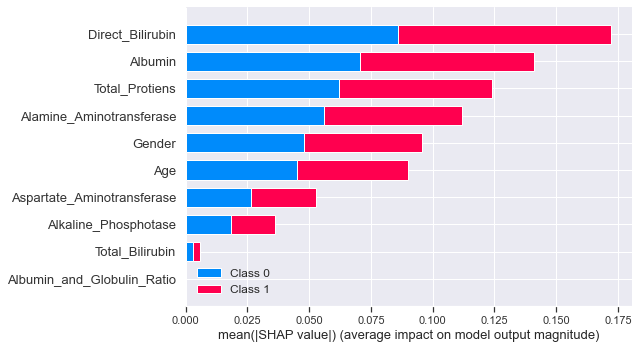

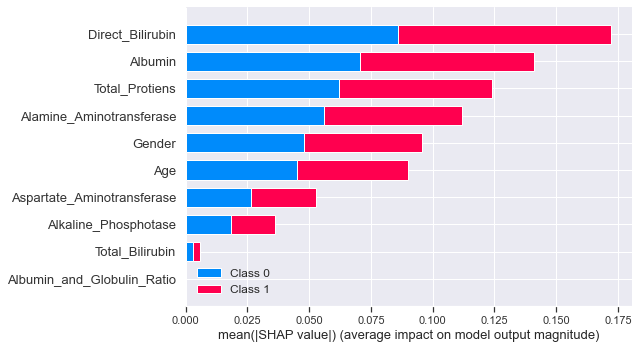

In [35]:
# Feature Importance upon Testing Data
# shap.summary_plot(Titanic_shap_values, X_train, plot_type="bar")
# shap.summary_plot(Titanic_shap_values, X_train)
# feature_names=list(X_train.columns)
shap.summary_plot(shap_values_all, X_test, plot_type="bar")
shap.summary_plot(shap_values_all, X_test)

In [36]:
X_test

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender
232,0.640938,-0.323022,-0.389057,0.105794,-0.325174,-0.281259,-0.407133,-0.548644,-0.591240,0.682425
319,-1.067829,0.833356,0.882963,-0.043056,0.097126,0.104577,-0.310639,-0.417631,-0.591240,0.682425
431,1.068130,-0.341674,-0.389057,-0.484954,-0.305683,-0.277197,-0.214145,-0.548644,-0.591240,0.682425
718,-0.823720,-0.281571,-0.324770,-0.489606,-0.325174,-0.277197,0.612493,0.368442,-0.059760,0.682425
560,-0.701665,0.199213,0.185404,1.603598,-0.097782,0.003041,-0.310639,-1.727754,-1.934885,0.682425
214,1.495322,-0.360325,-0.389057,-0.377968,-0.305683,-0.293443,-0.117651,0.761479,1.424227,-1.465362
139,0.396828,-0.323022,-0.389057,-0.303543,-0.292689,-0.248767,0.654301,1.678565,2.297596,0.682425
554,0.518883,0.012700,0.103338,-0.075617,-0.292689,-0.191907,-0.503628,-1.989779,-1.968476,0.682425
632,1.190185,-0.351327,-0.382459,-0.326801,-0.299186,-0.265013,-0.384833,0.351980,1.034298,0.682425
211,1.617376,-0.173812,-0.265958,0.617467,-0.058800,-0.175662,-0.793110,-0.155607,0.416493,0.682425


In [37]:
Y_test

232    0
319    0
431    1
718    1
560    0
214    0
139    0
554    0
632    1
211    0
693    1
19     0
603    1
82     0
612    1
321    0
766    1
6      0
729    1
782    1
352    1
300    1
326    0
647    1
748    1
5      0
570    1
414    0
689    1
559    0
171    0
10     0
150    0
308    0
259    0
161    0
50     0
675    1
92     0
486    0
556    0
412    0
280    1
84     0
791    1
535    0
742    1
569    1
118    1
430    0
314    1
608    1
597    1
511    1
13     0
237    0
584    1
752    1
255    0
539    0
648    1
217    1
196    0
721    1
112    0
550    0
295    0
563    0
222    0
616    1
0      0
231    0
631    1
479    0
726    1
101    1
713    1
794    1
384    0
715    1
279    0
21     0
180    0
682    1
600    1
767    1
365    0
667    1
809    1
432    1
484    0
575    1
771    1
236    0
131    0
571    1
31     1
151    0
613    1
665    1
546    0
227    1
620    1
557    0
111    0
276    0
177    1
517    1
381    0
268    1
690    1
1

In [38]:
# plot the SHAP values for the 10th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values=explainer.shap_values(X_test.iloc[10,:]) # First Row of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[10,:])

In [39]:
# plot the SHAP values for the 10th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values=explainer.shap_values(X_test.iloc[1,:]) # First Row of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[1,:])

In [63]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverModel, scoring='balanced_accuracy',n_iter=20,random_state=2649).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1292 ± 0.0532,Albumin
0.1001 ± 0.0331,Age
0.0833 ± 0.0546,Direct_Bilirubin
0.0737 ± 0.0347,Alamine_Aminotransferase
0.0566 ± 0.0251,Total_Protiens
0.0408 ± 0.0282,Aspartate_Aminotransferase
0.0407 ± 0.0249,Alkaline_Phosphotase
0.0270 ± 0.0222,Gender
0.0042 ± 0.0155,Total_Bilirubin
0 ± 0.0000,Albumin_and_Globulin_Ratio


eli5 Permutation Feature Importance:


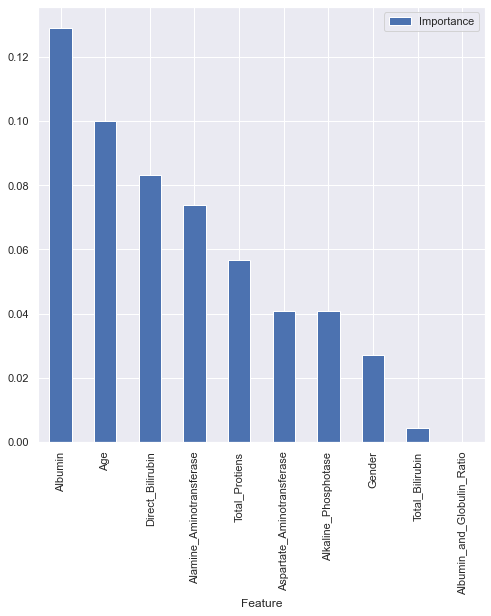

In [64]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
SFFS1 = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=2974)
LiverModel = LogisticRegression(C=1.0, solver='liblinear', class_weight='balanced', random_state=999, penalty='l1') #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverModel, scoring='balanced_accuracy',n_iter=20,random_state=2649).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [65]:
print(Label.unique())
Class_names = ["Good","Bad"]

[0 1]


In [66]:
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
from IPython.display import display
display(eli5.show_weights(LiverModel,top=None,feature_names=feature_names,target_names=Class_names))

Weight?,Feature
+0.494,Albumin
-0.045,Total_Bilirubin
-0.216,Alkaline_Phosphotase
-0.271,Age
-0.275,Gender
-0.491,Total_Protiens
-0.596,<BIAS>
-0.729,Aspartate_Aminotransferase
-1.338,Direct_Bilirubin
-1.589,Alamine_Aminotransferase


In [67]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 10 # 4th row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverModel, X_test.iloc[i], feature_names=feature_names, show_feature_values=True, target_names=Class_names)

693    1
Name: Dataset, dtype: int64


In [68]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 1 # 4th row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverModel, X_test.iloc[i], feature_names=feature_names, show_feature_values=True, target_names=Class_names)

319    0
Name: Dataset, dtype: int64


In [69]:
# Load our pkgs
import lime
import lime.lime_tabular
from numpy import array
# array(X_train) or X_train.values
explainer = lime.lime_tabular.LimeTabularExplainer(array(X_train), feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=2649,mode='classification')

In [70]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 10 # 21st row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverModel.predict_proba,num_features=10)
exp.show_in_notebook(show_table=True)

693    1
Name: Dataset, dtype: int64


In [71]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 1 # 21st row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverModel.predict_proba,num_features=10)
exp.show_in_notebook(show_table=True)

319    0
Name: Dataset, dtype: int64


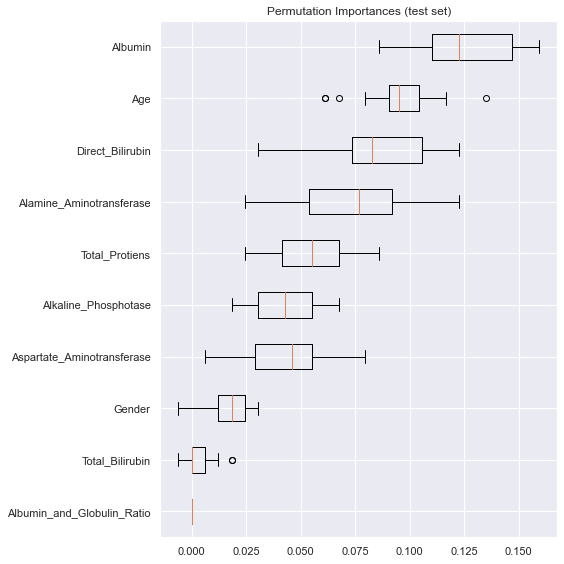

In [72]:
from matplotlib import pyplot
rcParams['figure.figsize'] = [8,8]
from sklearn.inspection import permutation_importance
result = permutation_importance(LiverModel, X_test, Y_test, n_repeats=20,
                                random_state=999)
sorted_idx = result.importances_mean.argsort()

fig, ax = pyplot.subplots()
ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X_test.columns[sorted_idx])
ax.set_title("Permutation Importances (test set)")
fig.tight_layout()
pyplot.show()

Elapsed time to compute the importances: 0.316 seconds


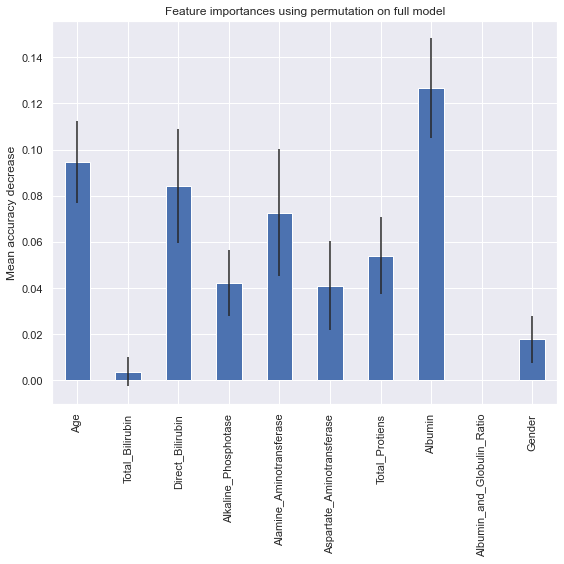

In [73]:
from sklearn.inspection import permutation_importance
start_time = time.time()
result = permutation_importance(
    LiverModel, X_test, Y_test, n_repeats=20, random_state=999)
elapsed_time = time.time() - start_time
print(f"Elapsed time to compute the importances: "
      f"{elapsed_time:.3f} seconds")

forest_importances = Series(result.importances_mean, index=X_train.columns)

fig, ax = pyplot.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
pyplot.show()

# Support Vector Classifier

In [ ]:
Liver=read_csv("DataFile\\Liver_Clean_Balanced.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver
#DataFrame Separation for Encoding
#label will be in 1D Series
#Continuous & Nominal will remain in 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Albumin','Albumin_and_Globulin_Ratio']]
Nominal=Liver[['Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Continuous=StandardScaler.fit_transform(Continuous) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Continuous=DataFrame(Continuous,columns=['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Albumin','Albumin_and_Globulin_Ratio']) #Converting Features into 2D DataFrame
type(Continuous),ndim(Continuous),Continuous.shape
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Features=concat([Continuous,Nominal],axis=1)
Features

In [ ]:
Liver=read_csv("DataFile\\Liver_Clean_Balanced.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver
#DataFrame Separation for Encoding
#label will be in 1D Series
#Continuous & Nominal will remain in 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio',]]
Nominal=Liver[['Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Continuous=StandardScaler.fit_transform(Continuous) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Continuous=DataFrame(Continuous,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']) #Converting Features into 2D DataFrame
type(Continuous),ndim(Continuous),Continuous.shape
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Features=concat([Continuous,Nominal],axis=1)
Features

In [239]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

## SVC kernel='linear' Coefficients/Slope as Feature Importance (Upon Training Data)
https://medium.com/@raj5287/effects-of-multi-collinearity-in-logistic-regression-svm-rf-af6766d91f1b

Train (649, 10) (649,)
Test (163, 10) (163,)
                            Coefficient_Value
Features                                     
Albumin                              0.259212
Albumin_and_Globulin_Ratio           0.078123
Gender                              -0.122965
Total_Protiens                      -0.201174
Age                                 -0.207377
Alkaline_Phosphotase                -0.397613
Total_Bilirubin                     -0.568761
Aspartate_Aminotransferase          -0.865026
Direct_Bilirubin                    -1.332620
Alamine_Aminotransferase            -1.455310


<AxesSubplot:xlabel='Features'>

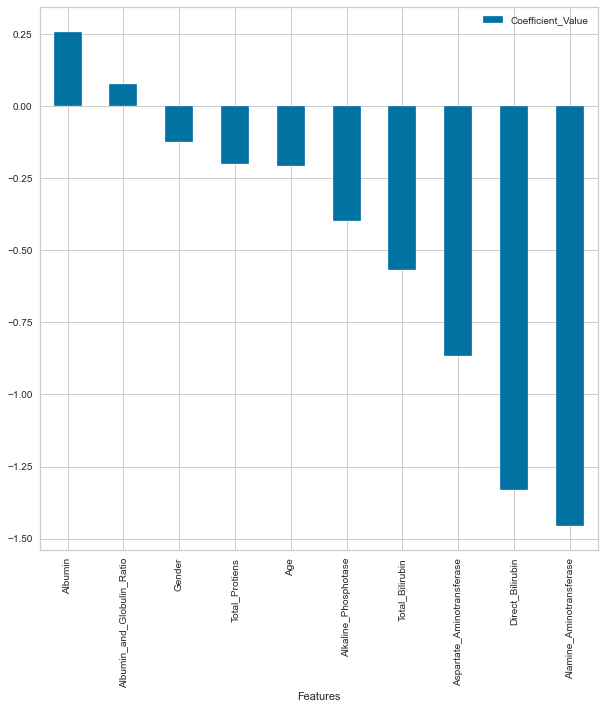

In [240]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# define dataset
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
# summarize
print('Train', X_train.shape, Y_train.shape)
print('Test', X_test.shape, Y_test.shape)
# define the model
model = SVC(kernel='linear',class_weight='balanced',random_state=999,probability=True)
# fit the model
model.fit(X_train, Y_train)
# get importance
importance = model.coef_[0]
# summarize feature importance
#for i,v in enumerate(importance):
    #print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
#pyplot.bar([x for x in range(len(importance))], importance)
#pyplot.show()
# plot the scores
DataScores=DataFrame(importance,[x for x in range(len(importance))],columns=["Coefficient_Value"])
DataColumns=DataFrame(X_train.columns)
CoefRank=concat([DataColumns,DataScores],axis=1)
CoefRank.columns=['Features','Coefficient_Value']
# setting "Features" Column as index column
CoefRank.set_index("Features", inplace = True)
CoefRank.sort_values(by="Coefficient_Value",ascending=False, inplace=True)
print(CoefRank)
CoefRank.plot.bar()

detected multi-dimensional feature importances but stack=False, using mean to aggregate them.


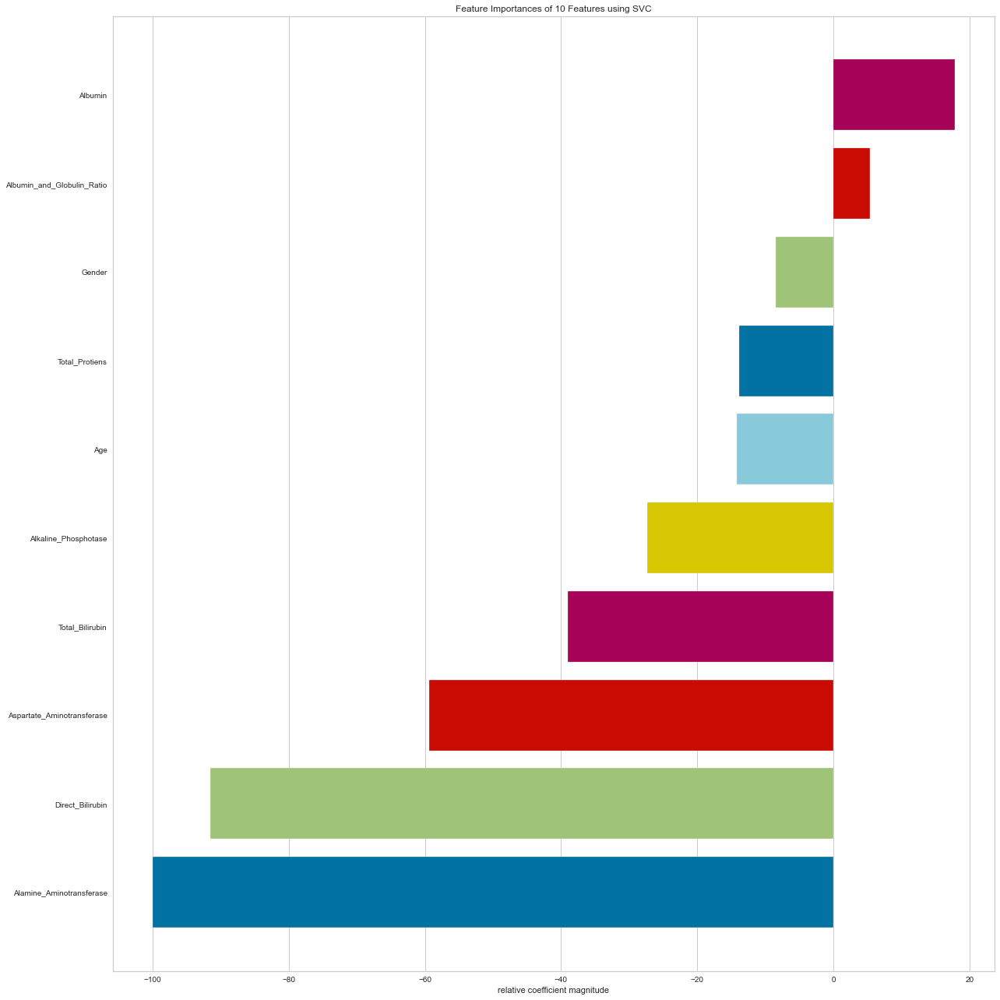

<AxesSubplot:title={'center':'Feature Importances of 10 Features using SVC'}, xlabel='relative coefficient magnitude'>

In [241]:
from yellowbrick.model_selection import FeatureImportances # Upon Training Data
# Changing default values for parameters individually
rcParams['figure.figsize'] = [18,18]
# Load the classification data set
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)

model = SVC(kernel='linear',class_weight='balanced',random_state=999,probability=True)
viz = FeatureImportances(model)
viz.fit(X_train, Y_train)
viz.show()

detected multi-dimensional feature importances but stack=False, using mean to aggregate them.


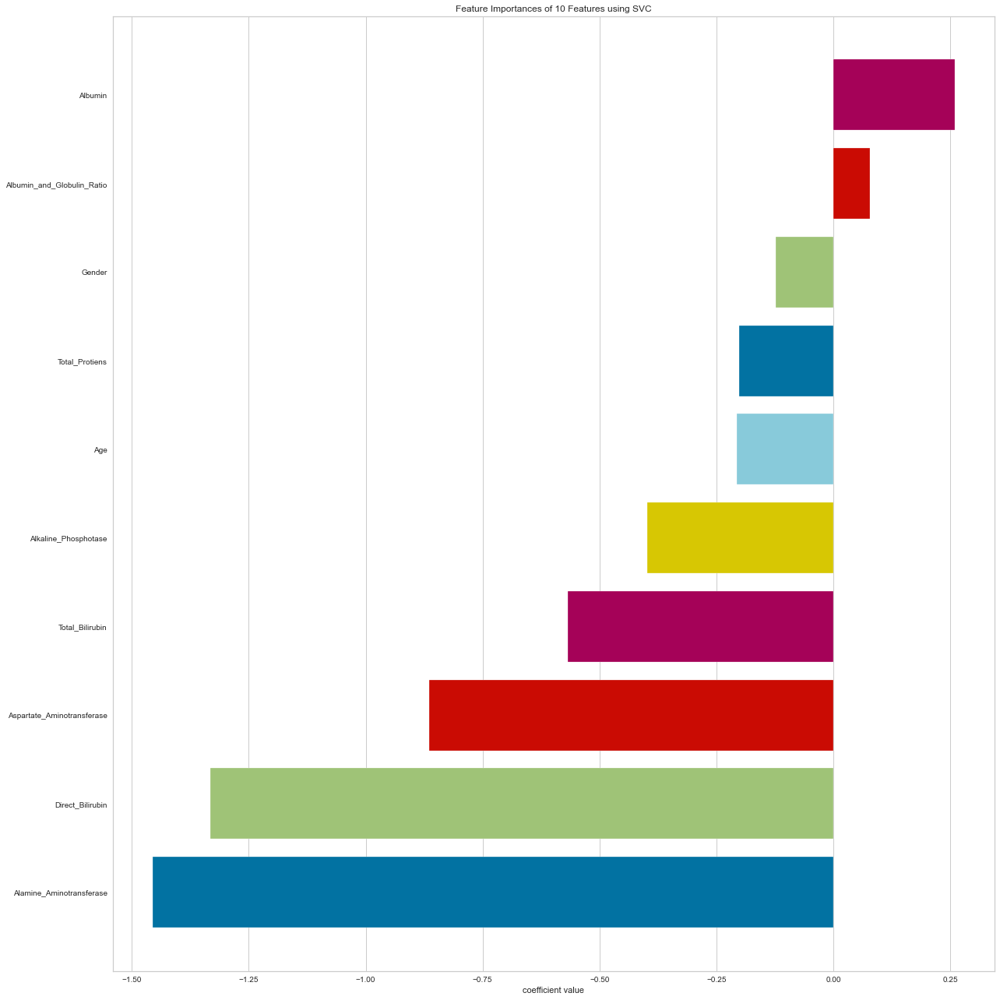

<AxesSubplot:title={'center':'Feature Importances of 10 Features using SVC'}, xlabel='coefficient value'>

In [242]:
from yellowbrick.model_selection import FeatureImportances # Upon Training Data
# Changing default values for parameters individually
rcParams['figure.figsize'] = [18,18]
# Load the classification data set
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)

model = SVC(kernel='linear',class_weight='balanced',random_state=999,probability=True)
viz = FeatureImportances(model,relative=False)
viz.fit(X_train, Y_train)
viz.show()

## Standardized/Normalized SVC(kernel='linear') Coefficient Feature Selection (also called beta coefficient, upon Training Data)

In [243]:
# Below link is for Scientific notation to Real Number Converter
# https://www.calculatorsoup.com/calculators/math/scientific-notation-converter.php
# Find out coefficients of the Features
# Label should be in 1D format
Features_Coeff = DataFrame(model.coef_[0],Features.columns,columns=['Coefficient'])
Features_Coeff

,Coefficient
Age,-0.207377
Total_Bilirubin,-0.568761
Direct_Bilirubin,-1.332620
Alkaline_Phosphotase,-0.397613
Alamine_Aminotransferase,-1.455310
Aspartate_Aminotransferase,-0.865026
Total_Protiens,-0.201174
Albumin,0.259212
Albumin_and_Globulin_Ratio,0.078123
Gender,-0.122965


Age -> 1.00973151621909
Total_Bilirubin -> 0.9251928048381977
Direct_Bilirubin -> 1.0440031326021078
Alkaline_Phosphotase -> 0.9801843889520498
Alamine_Aminotransferase -> 0.9837395218897538
Aspartate_Aminotransferase -> 1.067679497951141
Total_Protiens -> 1.0110675698238512
Albumin -> 1.00067385405028
Albumin_and_Globulin_Ratio -> 0.9882205568363719
Gender -> 1.0030726864261383

Standardized/Normalized Regression Coefficient Feature Selection


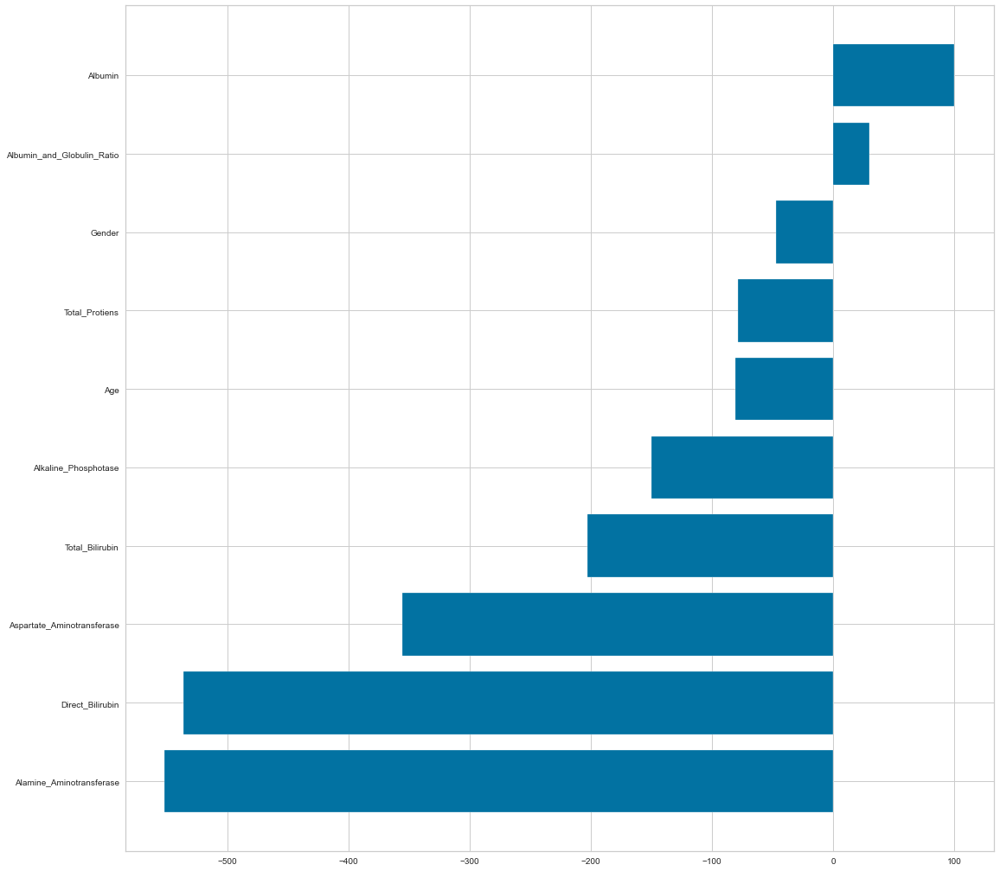

In [244]:
# Linear Regression Equation of My Model
# Standardized Coefficient of a Feature = (bi*Sxi)/Sy

# coefficients=model.coef_[0]
# print("Predicted Price = ",model.intercept_,"+ ",end="")
# for i in range(0, len(coefficients)):
#    print(coefficients[i],X_train.columns[i],"+ ",end="")
# print("E")
# print()
# print("Standard deviation of Each Feature Samples")

# Standard error of Each Feature Samples
# 'Series' object has no attribute 'stdev'
# We will use population std() instead of sample stdev()
# stdev() we use to find sample standard deviation with n-1 degree of freedom, but its doesn't work with series
# So we will use population Standard Deviation which is std()
# from statistics import stdev
from numpy import std
StdErrs = [] # blank list
for i in X_train.columns:
    StdErr = X_train[i].std()
    print(i,"->",StdErr)
    StdErrs.append(StdErr)
print()
print("Standardized/Normalized Regression Coefficient Feature Selection")
from numpy import array
Features_Coeff["Std"]=array(StdErrs).reshape(-1,1)
Features_Coeff["Importance"]=Features_Coeff["Std"]*Features_Coeff["Coefficient"]
Features_Coeff["Normalized_Importance"]=100*Features_Coeff["Importance"] / Features_Coeff["Importance"].max()
#pyplot.barh(Features_Coeff.index, Features_Coeff.Normalized_Importance)
Features_Coeff.sort_values(by="Normalized_Importance",ascending=True, inplace=True)
pyplot.barh(Features_Coeff.index, Features_Coeff.Normalized_Importance)
show()

# Sklearn Default Permutation Feature Importance by Using SVC for Classification, upon Training Data

                            Mean Importance Score
Features                                         
Alkaline_Phosphotase                     0.039537
Age                                      0.035277
Gender                                   0.032047
Direct_Bilirubin                         0.031803
Albumin                                  0.026899
Total_Bilirubin                          0.023191
Albumin_and_Globulin_Ratio               0.022457
Aspartate_Aminotransferase               0.018295
Alamine_Aminotransferase                 0.016449
Total_Protiens                           0.012132


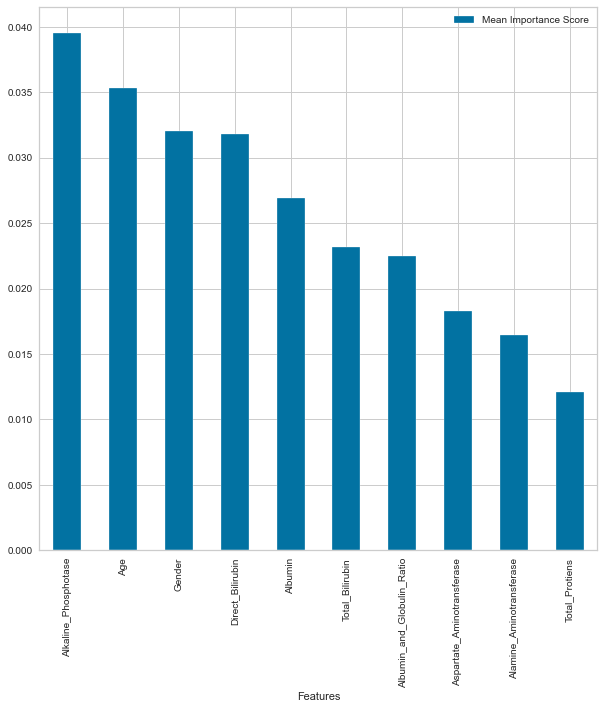

In [245]:
# Permutation Feature Importance by Using LinearRegression
from sklearn.inspection import permutation_importance
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# define dataset
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
# define the model
model = SVC(class_weight='balanced',random_state=3354,probability=True)
# fit the model
model.fit(X_train, Y_train)
# perform permutation importance
results = permutation_importance(model, X_train, Y_train, scoring='balanced_accuracy', n_repeats=10, random_state=3354)
# get importance
importance = results.importances_mean
# summarize feature importance
DataScores=DataFrame(importance,[x for x in range(len(importance))],columns=["Mean Importance Score"])
DataColumns=DataFrame(X_train.columns)
RMSERank=concat([DataColumns,DataScores],axis=1)
RMSERank.columns=['Features','Mean Importance Score']
# setting "Features" Column as index column
RMSERank.set_index("Features", inplace = True)
RMSERank.sort_values(by="Mean Importance Score",ascending=False, inplace=True)
print(RMSERank)
# plot feature importance
RMSERank.plot.bar()
show()

In [246]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
model = SVC(class_weight='balanced',random_state=3354,probability=True).fit(X_train, Y_train)
perm = PermutationImportance(model, scoring='balanced_accuracy',n_iter=20,random_state=3354).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.0244 ± 0.0312,Alkaline_Phosphotase
0.0199 ± 0.0438,Age
0.0128 ± 0.0286,Alamine_Aminotransferase
0.0088 ± 0.0227,Gender
0.0070 ± 0.0293,Direct_Bilirubin
0.0045 ± 0.0283,Aspartate_Aminotransferase
0.0044 ± 0.0291,Albumin_and_Globulin_Ratio
0.0042 ± 0.0286,Total_Bilirubin
-0.0029 ± 0.0423,Albumin
-0.0036 ± 0.0171,Total_Protiens


eli5 Permutation Feature Importance:


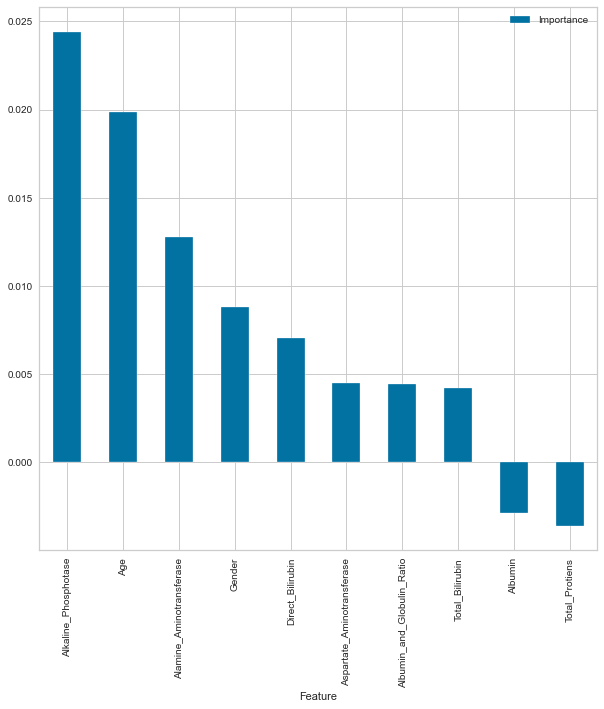

In [247]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
model = SVC(class_weight='balanced',random_state=3354,probability=True).fit(X_train, Y_train)
perm = PermutationImportance(model, scoring='balanced_accuracy',n_iter=20,random_state=3354).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [248]:
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
# only kernel='linear' is currently supported for libsvm-based classifiers
model = SVC(kernel='linear',class_weight='balanced',random_state=3354,probability=True).fit(X_train, Y_train)
from IPython.display import display
display(eli5.show_weights(model,top=None,feature_names=feature_names))

Weight?,Feature
+0.259,Albumin
+0.078,Albumin_and_Globulin_Ratio
-0.123,Gender
-0.201,Total_Protiens
-0.207,Age
-0.398,Alkaline_Phosphotase
-0.504,<BIAS>
-0.569,Total_Bilirubin
-0.865,Aspartate_Aminotransferase
-1.333,Direct_Bilirubin


                            Mean Importance Score
Features                                         
Alkaline_Phosphotase                     0.034921
Age                                      0.033267
Gender                                   0.031283
Albumin                                  0.026750
Direct_Bilirubin                         0.023328
Albumin_and_Globulin_Ratio               0.021919
Total_Bilirubin                          0.015333
Total_Protiens                           0.014522
Aspartate_Aminotransferase               0.013287
Alamine_Aminotransferase                 0.013136


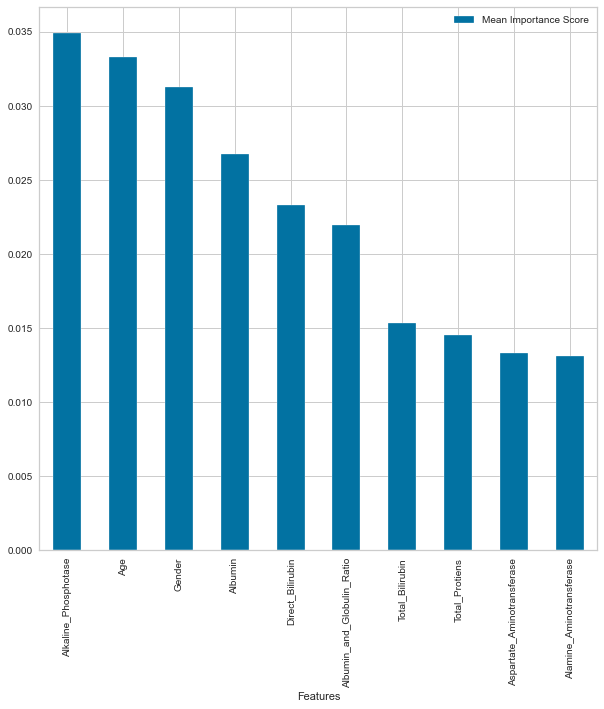

In [249]:
# We can also use eli5 to calculate feature importance for non scikit-learn models also. Here we train a LightGBM model.
from eli5.permutation_importance import get_score_importances
from sklearn.metrics import balanced_accuracy_score
import numpy
#define a score function. In this case I use accuracy
model = SVC(class_weight='balanced',random_state=3354,probability=True).fit(X_train, Y_train)
# ... load data, define score function
def Bal_Accu(X_train, Y_train):
    Y_pred = model.predict(X_train)
    return balanced_accuracy_score(Y_train,Y_pred)
# This function takes only numpy arrays as inputs
base_score, score_decreases = get_score_importances(Bal_Accu, numpy.array(X_train), Y_train, n_iter=20, random_state=3354)
feature_importances = numpy.mean(score_decreases, axis=0)
DataScores=DataFrame(feature_importances,[x for x in range(len(feature_importances))],columns=["Mean Importance Score"])
DataColumns=DataFrame(X_train.columns)
RMSERank=concat([DataColumns,DataScores],axis=1)
RMSERank.columns=['Features','Mean Importance Score']
# setting "Features" Column as index column
RMSERank.set_index("Features", inplace = True)
RMSERank.sort_values(by="Mean Importance Score",ascending=False, inplace=True)
print(RMSERank)
# plot feature importance
RMSERank.plot.bar()
show()

rfpimp Permutation Feature Importance:


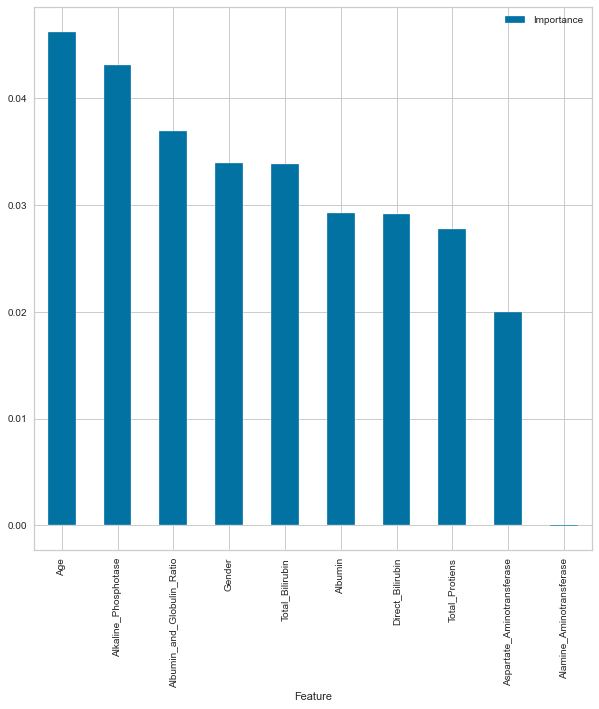

In [250]:
from sklearn.metrics import balanced_accuracy_score
from rfpimp import permutation_importances

def Bal_Accu(model, X_train, Y_train):
    return balanced_accuracy_score(Y_train,model.predict(X_train))
model = SVC(class_weight='balanced',random_state=3354,probability=True).fit(X_train, Y_train)
perm_imp_rfpimp = permutation_importances(model, X_train, Y_train, Bal_Accu)
perm_imp_rfpimp.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('rfpimp Permutation Feature Importance:')
perm_imp_rfpimp.plot.bar()
show()

In [251]:
from sklearn.metrics import balanced_accuracy_score
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Accuracy_score = balanced_accuracy_score(Y_train,model_clone.predict(X_train))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_train,model_clone2.predict(X_train.drop(col, axis = 1)))
        importances.append(Balanced_Accuracy_score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df

Drop-Col Feature Importance:
                            Importance
Feature                               
Gender                        0.015437
Age                           0.013841
Albumin                       0.009259
Alkaline_Phosphotase          0.007645
Albumin_and_Globulin_Ratio    0.003086
Direct_Bilirubin              0.003063
Total_Protiens               -0.000005
Aspartate_Aminotransferase   -0.001562
Alamine_Aminotransferase     -0.003096
Total_Bilirubin              -0.004634


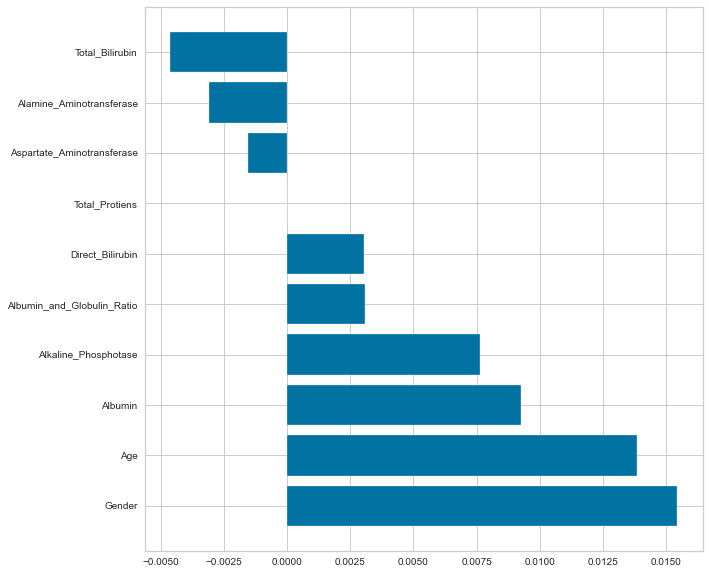

In [252]:
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
SVM=SVC(class_weight='balanced',random_state=3354,probability=True)
print('Drop-Col Feature Importance:')
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=3354)
print(drop_col_feat_imp(SVM, X_train, Y_train))
importances_df = drop_col_feat_imp(SVM, X_train, Y_train)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

In [238]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    # Default LogisticRegression Model
    SVMmodel=SVC(class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train)
    
    train_score=SVMmodel.score(X_train,Y_train)
    
    test_score=SVMmodel.score(X_test,Y_test)
    
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,SVMmodel.predict(X_test))
    
    if test_score >= train_score:
        if Balanced_Accuracy_Score >= 0.83:
            print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8343558282208589 Train: 0.7349768875192604 Balanced_Accuracy: 0.8350647395362842 RandomState: 44
Test: 0.8343558282208589 Train: 0.7426810477657936 Balanced_Accuracy: 0.8337097259861488 RandomState: 4341


In [253]:
#Final Implmentation of Titanic Logistic Regression
# https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
# https://towardsdatascience.com/the-5-classification-evaluation-metrics-you-must-know-aa97784ff226
# https://www.youtube.com/watch?v=QP-tAgF0LLw
# https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code/
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=44)
SVMmodel=SVC(class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7349768875192604
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8350647395362842
Recall_Score: 0.9506172839506173
Precision_Score: 0.77
              precision    recall  f1-score   support

           0       0.94      0.72      0.81        82
           1       0.77      0.95      0.85        81

    accuracy                           0.83       163
   macro avg       0.85      0.84      0.83       163
weighted avg       0.85      0.83      0.83       163

The Log Loss on Training is:  0.5172552591160104
The Log Loss on Testing is:  0.45051960988801815


In [254]:
#Final Implmentation of Titanic Logistic Regression
# https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
# https://towardsdatascience.com/the-5-classification-evaluation-metrics-you-must-know-aa97784ff226
# https://www.youtube.com/watch?v=QP-tAgF0LLw
# https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code/
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=4341)
SVMmodel=SVC(class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7426810477657936
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8337097259861488
Recall_Score: 0.9390243902439024
Precision_Score: 0.7777777777777778
              precision    recall  f1-score   support

           0       0.92      0.73      0.81        81
           1       0.78      0.94      0.85        82

    accuracy                           0.83       163
   macro avg       0.85      0.83      0.83       163
weighted avg       0.85      0.83      0.83       163

The Log Loss on Training is:  0.5145428894074922
The Log Loss on Testing is:  0.4555530839585519


In [255]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Gender                        0.055179
Alamine_Aminotransferase      0.018368
Albumin                       0.018368
Age                           0.012496
Direct_Bilirubin              0.006248
Alkaline_Phosphotase          0.006248
Albumin_and_Globulin_Ratio    0.006098
Total_Bilirubin               0.000075
Aspartate_Aminotransferase    0.000075
Total_Protiens                0.000000


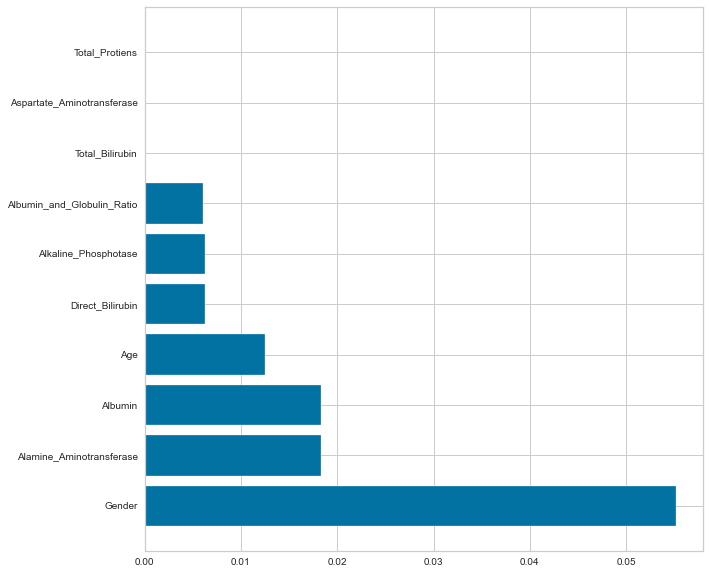

Train_Score: 0.7349768875192604
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8350647395362842
Recall_Score: 0.9506172839506173
Precision_Score: 0.77
              precision    recall  f1-score   support

           0       0.94      0.72      0.81        82
           1       0.77      0.95      0.85        81

    accuracy                           0.83       163
   macro avg       0.85      0.84      0.83       163
weighted avg       0.85      0.83      0.83       163

The Log Loss on Training is:  0.5172552591160104
The Log Loss on Testing is:  0.45051960988801815


In [256]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=44)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverModel=SVC(class_weight='balanced', random_state=999, probability=True)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverModel, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverModel, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Chk Model
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=44)
SVMmodel=SVC(class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

In [264]:
# Looping Over The Parametres
from sklearn.metrics import log_loss
import numpy
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=44)
# Here we have selected geomspace range for C value because it is probably best for finding Global Minimum Loss
C_List = numpy.geomspace(0.01,100.0,num=300)
Balanced_Accuracy = []
Log_Loss = []
for c in C_List:
    SVMmodel=SVC(C=c, kernel = 'rbf', class_weight='balanced', random_state=999, probability=True)
    SVMmodel.fit(X_train,Y_train)
    Balanced_Score=balanced_accuracy_score(Y_test,SVMmodel.predict(X_test))
    Balanced_Accuracy.append(Balanced_Score)
    print("The Balanced Accuracy of C parameter {} is {}:".format(c,Balanced_Score))
    Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
    Log_Loss2 = log_loss(Y_test,Predicted_Proba_Y)
    Log_Loss.append(Log_Loss2)
    print("The Log Loss of C parameter {} is {}:".format(c, Log_Loss2))
    print("")

The Balanced Accuracy of C parameter 0.01 is 0.5:
The Log Loss of C parameter 0.01 is 0.6931471805599454:

The Balanced Accuracy of C parameter 0.010312831606721848 is 0.5:
The Log Loss of C parameter 0.010312831606721848 is 0.6931471805599454:

The Balanced Accuracy of C parameter 0.010635449574860113 is 0.5:
The Log Loss of C parameter 0.010635449574860113 is 0.6931471805599454:

The Balanced Accuracy of C parameter 0.01096816005273138 is 0.5:
The Log Loss of C parameter 0.01096816005273138 is 0.6914656559063005:

The Balanced Accuracy of C parameter 0.011311278765939214 is 0.5:
The Log Loss of C parameter 0.011311278765939214 is 0.6894340765108955:

The Balanced Accuracy of C parameter 0.011665131316981962 is 0.5:
The Log Loss of C parameter 0.011665131316981962 is 0.6884789162004249:

The Balanced Accuracy of C parameter 0.012030053494233242 is 0.5:
The Log Loss of C parameter 0.012030053494233242 is 0.6876195238672792:

The Balanced Accuracy of C parameter 0.012406391590588319 is 

The Balanced Accuracy of C parameter 0.056125972559549715 is 0.7983288166214996:
The Log Loss of C parameter 0.056125972559549715 is 0.48909448386790405:

The Balanced Accuracy of C parameter 0.05788177037701274 is 0.7983288166214996:
The Log Loss of C parameter 0.05788177037701274 is 0.48873095689668283:

The Balanced Accuracy of C parameter 0.05969249509970734 is 0.8044263775971093:
The Log Loss of C parameter 0.05969249509970734 is 0.4877836075318995:

The Balanced Accuracy of C parameter 0.061559865014835076 is 0.810523938572719:
The Log Loss of C parameter 0.061559865014835076 is 0.4869945855360565:

The Balanced Accuracy of C parameter 0.06348565216305217 is 0.810523938572719:
The Log Loss of C parameter 0.06348565216305217 is 0.4861642236360365:

The Balanced Accuracy of C parameter 0.06547168402004737 is 0.8044263775971093:
The Log Loss of C parameter 0.06547168402004737 is 0.4857580231009232:

The Balanced Accuracy of C parameter 0.06751984523072502 is 0.8044263775971093:
The 

The Balanced Accuracy of C parameter 0.3150124795755328 is 0.8166214995483287:
The Log Loss of C parameter 0.3150124795755328 is 0.4606639856536206:

The Balanced Accuracy of C parameter 0.32486706558783746 is 0.8166214995483287:
The Log Loss of C parameter 0.32486706558783746 is 0.46074030420203566:

The Balanced Accuracy of C parameter 0.335029934197723 is 0.8166214995483287:
The Log Loss of C parameter 0.335029934197723 is 0.46082366881114906:

The Balanced Accuracy of C parameter 0.34551072945922184 is 0.8104486600421559:
The Log Loss of C parameter 0.34551072945922184 is 0.4607337227596644:

The Balanced Accuracy of C parameter 0.3563193971228586 is 0.8104486600421559:
The Log Loss of C parameter 0.3563193971228586 is 0.46049581106081977:

The Balanced Accuracy of C parameter 0.367466194073669 is 0.8104486600421559:
The Log Loss of C parameter 0.367466194073669 is 0.4599488814757101:

The Balanced Accuracy of C parameter 0.3789616980644718 is 0.8104486600421559:
The Log Loss of C 

The Log Loss of C parameter 1.7144061358519702 is 0.44258412905728783:

The Balanced Accuracy of C parameter 1.7680381784572068 is 0.841162300511894:
The Log Loss of C parameter 1.7680381784572068 is 0.44226035083139253:

The Balanced Accuracy of C parameter 1.8233480008684404 is 0.841162300511894:
The Log Loss of C parameter 1.8233480008684404 is 0.44212979304965694:

The Balanced Accuracy of C parameter 1.8803880893409146 is 0.841162300511894:
The Log Loss of C parameter 1.8803880893409146 is 0.44215517185794156:

The Balanced Accuracy of C parameter 1.939212572065829 is 0.841162300511894:
The Log Loss of C parameter 1.939212572065829 is 0.44219270674570804:

The Balanced Accuracy of C parameter 1.999877270535285 is 0.841162300511894:
The Log Loss of C parameter 1.999877270535285 is 0.44219924315018333:

The Balanced Accuracy of C parameter 2.0624397525140905 is 0.841162300511894:
The Log Loss of C parameter 2.0624397525140905 is 0.4419340067303879:

The Balanced Accuracy of C parame

The Log Loss of C parameter 9.923286228832545 is 0.4417633511341918:

The Balanced Accuracy of C parameter 10.233717986325193 is 0.8288919000301114:
The Log Loss of C parameter 10.233717986325193 is 0.44155472343262536:

The Balanced Accuracy of C parameter 10.55386103036523 is 0.8288919000301114:
The Log Loss of C parameter 10.55386103036523 is 0.44124501201196015:

The Balanced Accuracy of C parameter 10.884019160690055 is 0.8288919000301114:
The Log Loss of C parameter 10.884019160690055 is 0.4411123220612464:

The Balanced Accuracy of C parameter 11.224505680853058 is 0.8288919000301114:
The Log Loss of C parameter 11.224505680853058 is 0.4411387294693442:

The Balanced Accuracy of C parameter 11.575643695533035 is 0.8288919000301114:
The Log Loss of C parameter 11.575643695533035 is 0.4410479774622449:

The Balanced Accuracy of C parameter 11.937766417144358 is 0.8288919000301114:
The Log Loss of C parameter 11.937766417144358 is 0.4409964804607002:

The Balanced Accuracy of C par

The Balanced Accuracy of C parameter 55.6954090580013 is 0.8102228244504668:
The Log Loss of C parameter 55.6954090580013 is 0.4544497254644402:

The Balanced Accuracy of C parameter 57.43773748826581 is 0.804125263474857:
The Log Loss of C parameter 57.43773748826581 is 0.45544610288152365:

The Balanced Accuracy of C parameter 59.23457145875806 is 0.7918548629930744:
The Log Loss of C parameter 59.23457145875806 is 0.4561510312360354:

The Balanced Accuracy of C parameter 61.0876160750504 is 0.7918548629930744:
The Log Loss of C parameter 61.0876160750504 is 0.45710603351151313:

The Balanced Accuracy of C parameter 62.99862978380693 is 0.7918548629930744:
The Log Loss of C parameter 62.99862978380693 is 0.45805728877326607:

The Balanced Accuracy of C parameter 64.96942604146125 is 0.7979524239686842:
The Log Loss of C parameter 64.96942604146125 is 0.45892487509017277:

The Balanced Accuracy of C parameter 67.0018750350959 is 0.7979524239686842:
The Log Loss of C parameter 67.00187

In [265]:
# Putting the Outcomes in A Table & Reshaping
Balanced_Accuracy = array(Balanced_Accuracy).reshape(300,)
LoG_LoSs = array(Log_Loss).reshape(300,)
# Zip
Outcomes = zip(C_List,Balanced_Accuracy,LoG_LoSs)
# DataFrame
DF_Outcomes = DataFrame(Outcomes, columns=["C_List","Balanced_Accuracy","LoG_LoSs"])
# Print DF_Outcomes
DF_Outcomes
# Re-Ordering the DF_Outcomes
DF_Outcomes.sort_values("LoG_LoSs", ascending=True).reset_index()

,index,C_List,Balanced_Accuracy,LoG_LoSs
0,237,14.810460,0.828892,0.440151
1,239,15.751591,0.822719,0.440228
2,236,14.361197,0.828892,0.440291
3,238,15.273779,0.828892,0.440309
4,240,16.244350,0.822719,0.440348
5,235,13.925561,0.828892,0.440390
6,241,16.752525,0.822719,0.440434
7,242,17.276597,0.822719,0.440542
8,234,13.503140,0.828892,0.440546
9,243,17.817063,0.822719,0.440609


In [266]:
#Final Implmentation of Titanic Logistic Regression
# https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
# https://towardsdatascience.com/the-5-classification-evaluation-metrics-you-must-know-aa97784ff226
# https://www.youtube.com/watch?v=QP-tAgF0LLw
# https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code/
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=44)
SVMmodel=SVC(C=14.810460, class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7765793528505393
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8288919000301114
Recall_Score: 0.9382716049382716
Precision_Score: 0.7676767676767676
              precision    recall  f1-score   support

           0       0.92      0.72      0.81        82
           1       0.77      0.94      0.84        81

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.85      0.83      0.83       163

The Log Loss on Training is:  0.4714793524516249
The Log Loss on Testing is:  0.44013434601725226


In [267]:
# Looping Over The Parametres
from sklearn.metrics import log_loss
import numpy
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=44)
# Here we have selected geomspace range for C value because it is probably best for finding Global Minimum Loss
G_List = numpy.geomspace(0.01,100.0,num=300)
Balanced_Accuracy = []
Log_Loss = []
for g in G_List:
    SVMmodel=SVC(C=14.810460, kernel = 'rbf', gamma=g, class_weight='balanced', random_state=999, probability=True)
    SVMmodel.fit(X_train,Y_train)
    Balanced_Score=balanced_accuracy_score(Y_test,SVMmodel.predict(X_test))
    Balanced_Accuracy.append(Balanced_Score)
    print("The Balanced Accuracy of C parameter {} is {}:".format(g,Balanced_Score))
    Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
    Log_Loss2 = log_loss(Y_test,Predicted_Proba_Y)
    Log_Loss.append(Log_Loss2)
    print("The Log Loss of C parameter {} is {}:".format(g, Log_Loss2))
    print("")

The Balanced Accuracy of C parameter 0.01 is 0.7981782595603734:
The Log Loss of C parameter 0.01 is 0.47505863335905685:

The Balanced Accuracy of C parameter 0.010312831606721848 is 0.7981782595603734:
The Log Loss of C parameter 0.010312831606721848 is 0.47387646683630047:

The Balanced Accuracy of C parameter 0.010635449574860113 is 0.7981782595603734:
The Log Loss of C parameter 0.010635449574860113 is 0.47291361582131325:

The Balanced Accuracy of C parameter 0.01096816005273138 is 0.7981782595603734:
The Log Loss of C parameter 0.01096816005273138 is 0.47232568722640045:

The Balanced Accuracy of C parameter 0.011311278765939214 is 0.7981782595603734:
The Log Loss of C parameter 0.011311278765939214 is 0.47154455795849526:

The Balanced Accuracy of C parameter 0.011665131316981962 is 0.7981782595603734:
The Log Loss of C parameter 0.011665131316981962 is 0.47105579342593745:

The Balanced Accuracy of C parameter 0.012030053494233242 is 0.7981782595603734:
The Log Loss of C param

The Log Loss of C parameter 0.052772543524835375 is 0.4419428404044637:

The Balanced Accuracy of C parameter 0.054423435483002665 is 0.8288919000301114:
The Log Loss of C parameter 0.054423435483002665 is 0.44175503919425924:

The Balanced Accuracy of C parameter 0.056125972559549715 is 0.8288919000301114:
The Log Loss of C parameter 0.056125972559549715 is 0.4416827605304671:

The Balanced Accuracy of C parameter 0.05788177037701274 is 0.8166967780788918:
The Log Loss of C parameter 0.05788177037701274 is 0.4416866752827473:

The Balanced Accuracy of C parameter 0.05969249509970734 is 0.8166967780788918:
The Log Loss of C parameter 0.05969249509970734 is 0.4418303564850335:

The Balanced Accuracy of C parameter 0.061559865014835076 is 0.8166967780788918:
The Log Loss of C parameter 0.061559865014835076 is 0.44187755388828376:

The Balanced Accuracy of C parameter 0.06348565216305217 is 0.8166967780788918:
The Log Loss of C parameter 0.06348565216305217 is 0.441732446690971:

The Bala

The Balanced Accuracy of C parameter 0.29619103297725535 is 0.8100722673893406:
The Log Loss of C parameter 0.29619103297725535 is 0.4796005037545587:

The Balanced Accuracy of C parameter 0.30545682465154317 is 0.8100722673893406:
The Log Loss of C parameter 0.30545682465154317 is 0.4817763149440775:

The Balanced Accuracy of C parameter 0.3150124795755328 is 0.8100722673893406:
The Log Loss of C parameter 0.3150124795755328 is 0.48378573604142666:

The Balanced Accuracy of C parameter 0.32486706558783746 is 0.7978018669075579:
The Log Loss of C parameter 0.32486706558783746 is 0.4854096579064847:

The Balanced Accuracy of C parameter 0.335029934197723 is 0.7978018669075579:
The Log Loss of C parameter 0.335029934197723 is 0.48633190409285354:

The Balanced Accuracy of C parameter 0.34551072945922184 is 0.7916290274013851:
The Log Loss of C parameter 0.34551072945922184 is 0.48771539636565636:

The Balanced Accuracy of C parameter 0.3563193971228586 is 0.7916290274013851:
The Log Loss

The Balanced Accuracy of C parameter 1.6624009789266119 is 0.809545317675399:
The Log Loss of C parameter 1.6624009789266119 is 0.5301928935655561:

The Balanced Accuracy of C parameter 1.7144061358519702 is 0.809545317675399:
The Log Loss of C parameter 1.7144061358519702 is 0.5313539838894731:

The Balanced Accuracy of C parameter 1.7680381784572068 is 0.8157181571815718:
The Log Loss of C parameter 1.7680381784572068 is 0.532655565494301:

The Balanced Accuracy of C parameter 1.8233480008684404 is 0.8157181571815718:
The Log Loss of C parameter 1.8233480008684404 is 0.5340041970617506:

The Balanced Accuracy of C parameter 1.8803880893409146 is 0.7971996386630533:
The Log Loss of C parameter 1.8803880893409146 is 0.5358347104555197:

The Balanced Accuracy of C parameter 1.939212572065829 is 0.7971243601324902:
The Log Loss of C parameter 1.939212572065829 is 0.5373832335375098:

The Balanced Accuracy of C parameter 1.999877270535285 is 0.7910267991568805:
The Log Loss of C parameter

The Balanced Accuracy of C parameter 9.33038717262036 is 0.6982083709725986:
The Log Loss of C parameter 9.33038717262036 is 0.6084358267388349:

The Balanced Accuracy of C parameter 9.622271173675134 is 0.6982083709725986:
The Log Loss of C parameter 9.622271173675134 is 0.6094121974056064:

The Balanced Accuracy of C parameter 9.923286228832545 is 0.6920355314664257:
The Log Loss of C parameter 9.923286228832545 is 0.6103948207101401:

The Balanced Accuracy of C parameter 10.233717986325193 is 0.6920355314664257:
The Log Loss of C parameter 10.233717986325193 is 0.6113022454882556:

The Balanced Accuracy of C parameter 10.55386103036523 is 0.6920355314664257:
The Log Loss of C parameter 10.55386103036523 is 0.6122774319715573:

The Balanced Accuracy of C parameter 10.884019160690055 is 0.6796898524540801:
The Log Loss of C parameter 10.884019160690055 is 0.6131930233114666:

The Balanced Accuracy of C parameter 11.224505680853058 is 0.6673441734417345:
The Log Loss of C parameter 11.

The Balanced Accuracy of C parameter 50.77917243205398 is 0.5927431496537188:
The Log Loss of C parameter 50.77917243205398 is 0.6376118562580144:

The Balanced Accuracy of C parameter 52.3677054420465 is 0.5927431496537188:
The Log Loss of C parameter 52.3677054420465 is 0.6378450353096708:

The Balanced Accuracy of C parameter 54.00593278542368 is 0.5865703101475459:
The Log Loss of C parameter 54.00593278542368 is 0.6381377820437546:

The Balanced Accuracy of C parameter 55.6954090580013 is 0.5865703101475459:
The Log Loss of C parameter 55.6954090580013 is 0.6384181979376728:

The Balanced Accuracy of C parameter 57.43773748826581 is 0.5865703101475459:
The Log Loss of C parameter 57.43773748826581 is 0.6387032136318374:

The Balanced Accuracy of C parameter 59.23457145875806 is 0.5865703101475459:
The Log Loss of C parameter 59.23457145875806 is 0.6389750670825391:

The Balanced Accuracy of C parameter 61.0876160750504 is 0.5865703101475459:
The Log Loss of C parameter 61.08761607

In [268]:
# Putting the Outcomes in A Table & Reshaping
Balanced_Accuracy = array(Balanced_Accuracy).reshape(300,)
LoG_LoSs = array(Log_Loss).reshape(300,)
# Zip
Outcomes = zip(G_List,Balanced_Accuracy,LoG_LoSs)
# DataFrame
DF_Outcomes = DataFrame(Outcomes, columns=["G_List","Balanced_Accuracy","LoG_LoSs"])
# Print DF_Outcomes
DF_Outcomes
# Re-Ordering the DF_Outcomes
DF_Outcomes.sort_values("LoG_LoSs", ascending=True).reset_index()

,index,G_List,Balanced_Accuracy,LoG_LoSs
0,75,0.100773,0.828892,0.440157
1,76,0.103926,0.822719,0.440213
2,77,0.107177,0.822719,0.440287
3,79,0.113987,0.804276,0.440374
4,78,0.110530,0.816621,0.440432
5,80,0.117553,0.804276,0.440632
6,74,0.097716,0.828892,0.440672
7,69,0.083768,0.822719,0.440929
8,73,0.094752,0.828892,0.440934
9,68,0.081227,0.822719,0.441046


In [271]:
#Final Implmentation of Titanic Logistic Regression
# https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
# https://towardsdatascience.com/the-5-classification-evaluation-metrics-you-must-know-aa97784ff226
# https://www.youtube.com/watch?v=QP-tAgF0LLw
# https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code/
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=44)
SVMmodel=SVC(C=14.810460, gamma=0.100773, class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7765793528505393
Test_Score: 0.8282208588957055
Balanced_Accuracy_Score: 0.8288919000301114
Recall_Score: 0.9382716049382716
Precision_Score: 0.7676767676767676
              precision    recall  f1-score   support

           0       0.92      0.72      0.81        82
           1       0.77      0.94      0.84        81

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.85      0.83      0.83       163

The Log Loss on Training is:  0.4715579725338046
The Log Loss on Testing is:  0.44015292792941485


In [166]:
# Looping Over The Parametres
from sklearn.metrics import log_loss
import numpy
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2638)
# Here we have selected geomspace range for C value because it is probably best for finding Global Minimum Loss
C_List = numpy.geomspace(0.01,100.0,num=100)
Balanced_Accuracy = []
Log_Loss = []
for c in C_List:
    SVMmodel=SVC(C=c, kernel = 'rbf', class_weight='balanced', random_state=999, probability=True)
    SVMmodel.fit(X_train,Y_train)
    Balanced_Score=balanced_accuracy_score(Y_test,SVMmodel.predict(X_test))
    Balanced_Accuracy.append(Balanced_Score)
    print("The Balanced Accuracy of C parameter {} is {}:".format(c,Balanced_Score))
    Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
    Log_Loss2 = log_loss(Y_test,Predicted_Proba_Y)
    Log_Loss.append(Log_Loss2)
    print("The Log Loss of C parameter {} is {}:".format(c, Log_Loss2))
    print("")

The Balanced Accuracy of C parameter 0.01 is 0.7727272727272727:
The Log Loss of C parameter 0.01 is 0.6861975188204245:

The Balanced Accuracy of C parameter 0.010974987654930561 is 0.7727272727272727:
The Log Loss of C parameter 0.010974987654930561 is 0.682834986105955:

The Balanced Accuracy of C parameter 0.012045035402587823 is 0.7727272727272727:
The Log Loss of C parameter 0.012045035402587823 is 0.677610319870762:

The Balanced Accuracy of C parameter 0.013219411484660288 is 0.7727272727272727:
The Log Loss of C parameter 0.013219411484660288 is 0.6706032415869849:

The Balanced Accuracy of C parameter 0.014508287784959394 is 0.7727272727272727:
The Log Loss of C parameter 0.014508287784959394 is 0.661350689984866:

The Balanced Accuracy of C parameter 0.015922827933410922 is 0.7727272727272727:
The Log Loss of C parameter 0.015922827933410922 is 0.6486091297181859:

The Balanced Accuracy of C parameter 0.01747528400007684 is 0.7727272727272727:
The Log Loss of C parameter 0.0

The Balanced Accuracy of C parameter 1.8307382802953698 is 0.8506493506493507:
The Log Loss of C parameter 1.8307382802953698 is 0.4248223431897426:

The Balanced Accuracy of C parameter 2.0092330025650478 is 0.8506493506493507:
The Log Loss of C parameter 2.0092330025650478 is 0.4245887422820191:

The Balanced Accuracy of C parameter 2.2051307399030455 is 0.8506493506493507:
The Log Loss of C parameter 2.2051307399030455 is 0.42398242521735924:

The Balanced Accuracy of C parameter 2.4201282647943834 is 0.8441558441558441:
The Log Loss of C parameter 2.4201282647943834 is 0.4234963198060976:

The Balanced Accuracy of C parameter 2.656087782946687 is 0.8506493506493507:
The Log Loss of C parameter 2.656087782946687 is 0.42346032560687213:

The Balanced Accuracy of C parameter 2.9150530628251787 is 0.8376623376623377:
The Log Loss of C parameter 2.9150530628251787 is 0.42368884745622204:

The Balanced Accuracy of C parameter 3.1992671377973845 is 0.8376623376623377:
The Log Loss of C pa

In [167]:
# Putting the Outcomes in A Table & Reshaping
Balanced_Accuracy = array(Balanced_Accuracy).reshape(100,)
LoG_LoSs = array(Log_Loss).reshape(100,)
# Zip
Outcomes = zip(C_List,Balanced_Accuracy,LoG_LoSs)
# DataFrame
DF_Outcomes = DataFrame(Outcomes, columns=["C_List","Balanced_Accuracy","LoG_LoSs"])
# Print DF_Outcomes
DF_Outcomes
# Re-Ordering the DF_Outcomes
DF_Outcomes.sort_values("LoG_LoSs", ascending=True).reset_index()

,index,C_List,Balanced_Accuracy,LoG_LoSs
0,72,8.111308,0.844156,0.421710
1,73,8.902151,0.844156,0.422021
2,75,10.722672,0.837662,0.422078
3,74,9.770100,0.837662,0.422097
4,71,7.390722,0.837662,0.422196
5,76,11.768120,0.837662,0.422371
6,70,6.734151,0.837662,0.422816
7,77,12.915497,0.837662,0.422911
8,69,6.135907,0.837662,0.423311
9,60,2.656088,0.850649,0.423460


In [169]:
# Looping Over The Parametres
from sklearn.metrics import log_loss
import numpy
X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,stratify=Label,test_size=0.20,random_state=2638)
# Here we have selected geomspace range for C value because it is probably best for finding Global Minimum Loss
G_List = numpy.geomspace(0.01,100.0,num=100)
Balanced_Accuracy = []
Log_Loss = []
for g in G_List:
    SVMmodel=SVC(C=1.0, kernel = 'rbf', gamma=g, class_weight='balanced', random_state=999, probability=True)
    SVMmodel.fit(X_train,Y_train)
    Balanced_Score=balanced_accuracy_score(Y_test,SVMmodel.predict(X_test))
    Balanced_Accuracy.append(Balanced_Score)
    print("The Balanced Accuracy of C parameter {} is {}:".format(g,Balanced_Score))
    Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
    Log_Loss2 = log_loss(Y_test,Predicted_Proba_Y)
    Log_Loss.append(Log_Loss2)
    print("The Log Loss of C parameter {} is {}:".format(g, Log_Loss2))
    print("")

The Balanced Accuracy of C parameter 0.01 is 0.8376623376623377:
The Log Loss of C parameter 0.01 is 0.44718396185577514:

The Balanced Accuracy of C parameter 0.010974987654930561 is 0.8376623376623377:
The Log Loss of C parameter 0.010974987654930561 is 0.4453760815567903:

The Balanced Accuracy of C parameter 0.012045035402587823 is 0.8376623376623377:
The Log Loss of C parameter 0.012045035402587823 is 0.44359947749651635:

The Balanced Accuracy of C parameter 0.013219411484660288 is 0.8311688311688312:
The Log Loss of C parameter 0.013219411484660288 is 0.4417813210392688:

The Balanced Accuracy of C parameter 0.014508287784959394 is 0.8311688311688312:
The Log Loss of C parameter 0.014508287784959394 is 0.4395869575093227:

The Balanced Accuracy of C parameter 0.015922827933410922 is 0.8311688311688312:
The Log Loss of C parameter 0.015922827933410922 is 0.437521233879989:

The Balanced Accuracy of C parameter 0.01747528400007684 is 0.8311688311688312:
The Log Loss of C parameter

The Log Loss of C parameter 1.6681005372000592 is 0.4873529720418643:

The Balanced Accuracy of C parameter 1.8307382802953698 is 0.8181818181818182:
The Log Loss of C parameter 1.8307382802953698 is 0.4927943067948918:

The Balanced Accuracy of C parameter 2.0092330025650478 is 0.8116883116883118:
The Log Loss of C parameter 2.0092330025650478 is 0.4978327405412511:

The Balanced Accuracy of C parameter 2.2051307399030455 is 0.8116883116883118:
The Log Loss of C parameter 2.2051307399030455 is 0.5011357727549282:

The Balanced Accuracy of C parameter 2.4201282647943834 is 0.8181818181818182:
The Log Loss of C parameter 2.4201282647943834 is 0.5048762549991709:

The Balanced Accuracy of C parameter 2.656087782946687 is 0.8116883116883118:
The Log Loss of C parameter 2.656087782946687 is 0.5088065498665474:

The Balanced Accuracy of C parameter 2.9150530628251787 is 0.7922077922077922:
The Log Loss of C parameter 2.9150530628251787 is 0.512653825754595:

The Balanced Accuracy of C param

In [170]:
# Putting the Outcomes in A Table & Reshaping
Balanced_Accuracy = array(Balanced_Accuracy).reshape(100,)
LoG_LoSs = array(Log_Loss).reshape(100,)
# Zip
Outcomes = zip(G_List,Balanced_Accuracy,LoG_LoSs)
# DataFrame
DF_Outcomes = DataFrame(Outcomes, columns=["G_List","Balanced_Accuracy","LoG_LoSs"])
# Print DF_Outcomes
DF_Outcomes
# Re-Ordering the DF_Outcomes
DF_Outcomes.sort_values("LoG_LoSs", ascending=True).reset_index()

,index,G_List,Balanced_Accuracy,LoG_LoSs
0,24,0.093260,0.857143,0.423671
1,23,0.084975,0.857143,0.423894
2,22,0.077426,0.857143,0.424067
3,25,0.102353,0.857143,0.424245
4,21,0.070548,0.857143,0.424346
5,20,0.064281,0.857143,0.424954
6,19,0.058570,0.857143,0.425371
7,26,0.112332,0.857143,0.425798
8,18,0.053367,0.850649,0.426145
9,17,0.048626,0.850649,0.426574


In [171]:
#Final Implmentation of Titanic Logistic Regression
# https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
# https://towardsdatascience.com/the-5-classification-evaluation-metrics-you-must-know-aa97784ff226
# https://www.youtube.com/watch?v=QP-tAgF0LLw
# https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code/
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2638)
SVMmodel=SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7418300653594772
Test_Score: 0.8571428571428571
Balanced_Accuracy_Score: 0.8571428571428572
Recall_Score: 0.987012987012987
Precision_Score: 0.7835051546391752
              precision    recall  f1-score   support

           0       0.98      0.73      0.84        77
           1       0.78      0.99      0.87        77

    accuracy                           0.86       154
   macro avg       0.88      0.86      0.85       154
weighted avg       0.88      0.86      0.85       154

The Log Loss on Training is:  0.4966215984740171
The Log Loss on Testing is:  0.4236870367504593


In [172]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Age                           0.051948
Gender                        0.032468
Alkaline_Phosphotase          0.019481
Alamine_Aminotransferase      0.012987
Aspartate_Aminotransferase    0.012987
Albumin_and_Globulin_Ratio    0.012987
Total_Protiens                0.006494
Total_Bilirubin               0.000000
Direct_Bilirubin              0.000000
Albumin                       0.000000


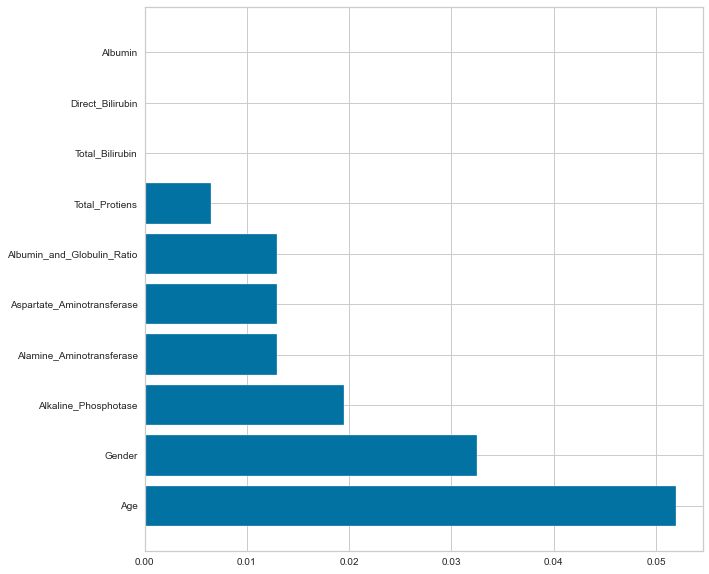

Train_Score: 0.7418300653594772
Test_Score: 0.8571428571428571
Balanced_Accuracy_Score: 0.8571428571428572
Recall_Score: 0.987012987012987
Precision_Score: 0.7835051546391752
              precision    recall  f1-score   support

           0       0.98      0.73      0.84        77
           1       0.78      0.99      0.87        77

    accuracy                           0.86       154
   macro avg       0.88      0.86      0.85       154
weighted avg       0.88      0.86      0.85       154

The Log Loss on Training is:  0.4966215984740171
The Log Loss on Testing is:  0.4236870367504593


In [173]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2638)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverModel=SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverModel, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverModel, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Chk Model
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=2638)
SVMmodel=SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

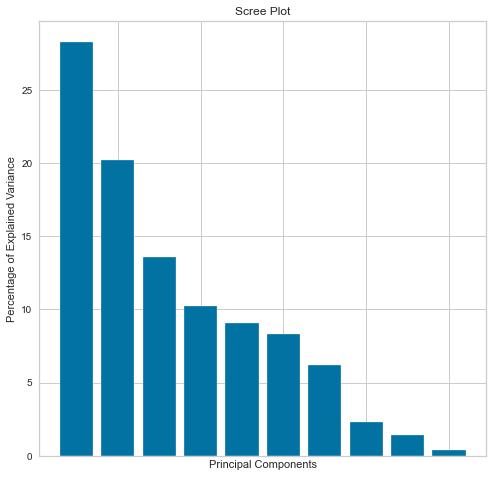

In [198]:
rcParams['figure.figsize'] = [8,8]
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
pca = PCA()
X_train_pca = pca.fit_transform(X_train)
per_var = numpy.round(pca.explained_variance_ratio_*100, decimals=1)
labels = [str(x) for x in range (1, len(per_var)+1)]

plt.bar(x=range(1, len(per_var)+1), height=per_var)
plt.tick_params(axis='x',which='both',bottom=False,top=False,labelbottom=False)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Components')
plt.title('Scree Plot')
plt.show()

In [199]:
import shap
shap.initjs()
Bestu = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(Bestu,Label,stratify=Label,test_size=0.20,random_state=2638)
LiverModel = SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
X_train_summary = shap.kmeans(X_train, 10)


shapexplainer = shap.KernelExplainer(LiverModel.predict_proba, X_train_summary)
shap_values_all = shapexplainer.shap_values(X_test) # Inserting Entire X_test Feature
# Force Plot of Entire Data
#shap.force_plot(CAR_explainer.expected_value[0],CAR_shap_values[0],X_test)
shap.force_plot(shapexplainer.expected_value[0], shap_values_all[0], X_test)

  0%|          | 0/163 [00:00<?, ?it/s]

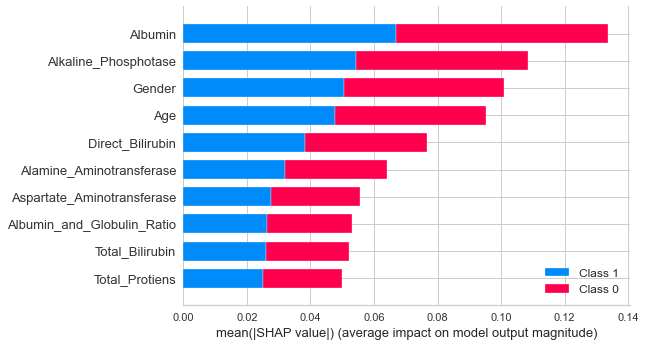

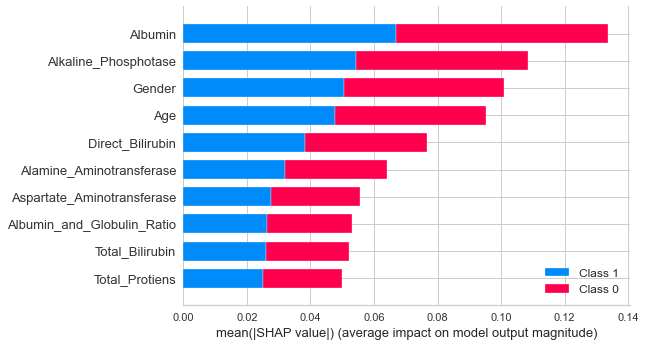

In [200]:
# Feature Importance upon Testing Data
# shap.summary_plot(Titanic_shap_values, X_train, plot_type="bar")
# shap.summary_plot(Titanic_shap_values, X_train)
#feature_names=list(X_train.columns)
shap.summary_plot(shap_values_all, X_test, plot_type="bar")
shap.summary_plot(shap_values_all, X_test)

In [202]:
Y_test

311    0
649    1
382    1
129    0
176    0
754    1
11     0
285    0
163    0
15     1
513    0
123    0
67     0
64     1
514    0
641    1
173    1
455    0
28     0
702    1
168    0
650    1
122    0
682    1
318    0
505    0
35     0
478    1
483    0
241    1
210    1
391    0
707    1
258    1
581    1
571    1
10     0
531    0
772    1
355    0
573    1
534    0
191    1
651    1
737    1
203    1
88     0
34     0
268    1
340    0
270    1
676    1
72     0
398    1
497    1
512    1
449    0
126    0
153    0
686    1
516    0
277    0
452    1
315    1
331    1
635    1
56     0
124    1
520    0
566    0
156    0
65     0
369    0
257    0
427    0
286    1
182    1
212    0
320    1
54     0
174    0
517    1
58     0
447    0
409    0
485    0
777    1
539    0
663    1
631    1
344    0
711    1
807    1
440    0
125    1
197    0
170    1
501    0
329    1
83     0
805    1
274    1
562    0
414    0
475    1
413    1
690    1
743    1
354    1
628    1
784    1
1

In [207]:
# plot the SHAP values for the 0th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values0=shapexplainer.shap_values(X_test.iloc[4,:]) # First Row index of X_test Input Feature DataFrame
shap.force_plot(shapexplainer.expected_value[1], shap_values0[1], X_test.iloc[4,:])

In [215]:
# plot the SHAP values for the 0th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values0=shapexplainer.shap_values(X_test.iloc[2,:]) # First Row index of X_test Input Feature DataFrame
shap.force_plot(shapexplainer.expected_value[1], shap_values0[1], X_test.iloc[2,:])

# Best 3 SVC Models For Liver Desease Detection

In [282]:
Liver=read_csv("DataFile\\Liver_Clean_Balanced.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver
#DataFrame Separation for Encoding
#label will be in 1D Series
#Continuous & Nominal will remain in 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Albumin','Albumin_and_Globulin_Ratio']]
Nominal=Liver[['Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Continuous=StandardScaler.fit_transform(Continuous) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Continuous=DataFrame(Continuous,columns=['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Albumin','Albumin_and_Globulin_Ratio']) #Converting Features into 2D DataFrame
type(Continuous),ndim(Continuous),Continuous.shape
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Features=concat([Continuous,Nominal],axis=1)
Features
Bestu = Features[['Age',  'Direct_Bilirubin', 
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase', 'Albumin',
       'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(Bestu,Label,stratify=Label,test_size=0.20,random_state=388)
LiverModel = SVC(C=1.519911, kernel = 'rbf', gamma=1.261857, class_weight='balanced', random_state=999, probability=True) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used to create equation of line #RegModel generation by feeding Training Data
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',LiverModel.score(X_train,Y_train))
print('Test_Score:',LiverModel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverModel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverModel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverModel.predict(X_test)))
print(classification_report(Y_test,LiverModel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = LiverModel.predict(X_train)
Predicted_Proba_Y = LiverModel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = LiverModel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.8316993464052288
Test_Score: 0.8766233766233766
Balanced_Accuracy_Score: 0.8766233766233766
Recall_Score: 0.948051948051948
Precision_Score: 0.8295454545454546
              precision    recall  f1-score   support

           0       0.94      0.81      0.87        77
           1       0.83      0.95      0.88        77

    accuracy                           0.88       154
   macro avg       0.88      0.88      0.88       154
weighted avg       0.88      0.88      0.88       154

The Log Loss on Training is:  0.41508590058110945
The Log Loss on Testing is:  0.43378947712708804


In [274]:
Liver=read_csv("DataFile\\Liver_Clean_Balanced.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver
#DataFrame Separation for Encoding
#label will be in 1D Series
#Continuous & Nominal will remain in 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio',]]
Nominal=Liver[['Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Continuous=StandardScaler.fit_transform(Continuous) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Continuous=DataFrame(Continuous,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']) #Converting Features into 2D DataFrame
type(Continuous),ndim(Continuous),Continuous.shape
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Features=concat([Continuous,Nominal],axis=1)
Features
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=2638)
SVMmodel=SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7418300653594772
Test_Score: 0.8571428571428571
Balanced_Accuracy_Score: 0.8571428571428572
Recall_Score: 0.987012987012987
Precision_Score: 0.7835051546391752
              precision    recall  f1-score   support

           0       0.98      0.73      0.84        77
           1       0.78      0.99      0.87        77

    accuracy                           0.86       154
   macro avg       0.88      0.86      0.85       154
weighted avg       0.88      0.86      0.85       154

The Log Loss on Training is:  0.4966215984740171
The Log Loss on Testing is:  0.4236870367504593


In [281]:
#Final Implmentation of Titanic Logistic Regression
# https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
# https://towardsdatascience.com/the-5-classification-evaluation-metrics-you-must-know-aa97784ff226
# https://www.youtube.com/watch?v=QP-tAgF0LLw
# https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code/
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape
from sklearn.metrics import balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=44)
SVMmodel=SVC(C=1.0, class_weight='balanced', random_state=999, probability=True).fit(X_train,Y_train) #Assign Regression model name
#Used to create equation of line #RegModel generation by feeding Training Data
print('Train_Score:',SVMmodel.score(X_train,Y_train))
print('Test_Score:',SVMmodel.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics  import classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,SVMmodel.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,SVMmodel.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,SVMmodel.predict(X_test)))
print(classification_report(Y_test,SVMmodel.predict(X_test)))
from sklearn.metrics import log_loss
# Running Logarithmic-Loss or Log-Loss or Binary-Cross-Entropy-Loss on training Data
# Multiclass-Entropy-Loss or Hinge-Loss
#Predicted_Proba_Y = SVMmodel.predict(X_train)
Predicted_Proba_Y = SVMmodel.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss or Hinge Loss on testing Data
Predicted_Proba_Y = SVMmodel.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good

Train_Score: 0.7349768875192604
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8350647395362842
Recall_Score: 0.9506172839506173
Precision_Score: 0.77
              precision    recall  f1-score   support

           0       0.94      0.72      0.81        82
           1       0.77      0.95      0.85        81

    accuracy                           0.83       163
   macro avg       0.85      0.84      0.83       163
weighted avg       0.85      0.83      0.83       163

The Log Loss on Training is:  0.5172552591160104
The Log Loss on Testing is:  0.45051960988801815


In [217]:
print(Label.unique())
Class_names = ["Good","Bad"]
import lime
import lime.lime_tabular
feature_names=list(X_train.columns)
Limeexplainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=115,mode='classification')

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 4 # 1st row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = Limeexplainer.explain_instance(X_test.iloc[i],LiverModel.predict_proba,num_features=10)
exp.show_in_notebook(show_table=True)

[0 1]
176    0
Name: Dataset, dtype: int64


In [218]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 2 # 2nd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = Limeexplainer.explain_instance(X_test.iloc[i],LiverModel.predict_proba,num_features=10)
exp.show_in_notebook(show_table=True)

382    1
Name: Dataset, dtype: int64


In [219]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance

Bestu = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(Bestu,Label,stratify=Label,test_size=0.20,random_state=2638)
LiverModel = SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used
 #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverModel, scoring='balanced_accuracy',n_iter=20,random_state=2644).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.0449 ± 0.0429,Age
0.0269 ± 0.0314,Direct_Bilirubin
0.0255 ± 0.0304,Gender
0.0174 ± 0.0297,Alkaline_Phosphotase
0.0164 ± 0.0327,Albumin_and_Globulin_Ratio
0.0142 ± 0.0243,Total_Bilirubin
0.0113 ± 0.0269,Total_Protiens
0.0099 ± 0.0480,Albumin
-0.0036 ± 0.0191,Alamine_Aminotransferase
-0.0119 ± 0.0225,Aspartate_Aminotransferase


eli5 Permutation Feature Importance:


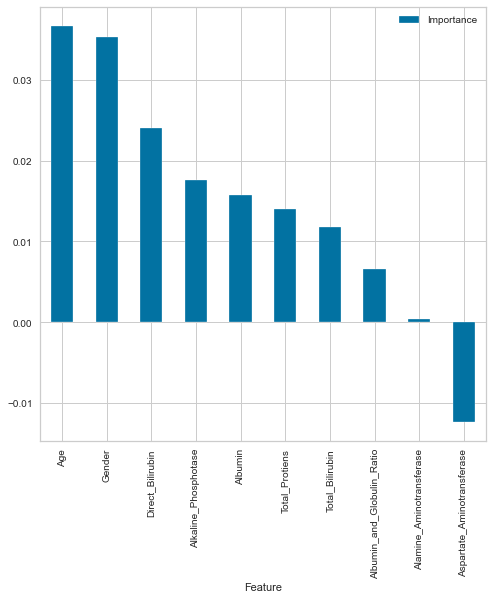

In [220]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
Bestu = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(Bestu,Label,stratify=Label,test_size=0.20,random_state=2638)
LiverModel = SVC(C=1.0,kernel = 'rbf', gamma=0.093260,class_weight='balanced', random_state=999, probability=True) #Assign Regression model name
LiverModel.fit(X_train,Y_train) #Used
perm = PermutationImportance(LiverModel, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

Random (chance) Prediction: AUROC = 0.500
Support Vector Classifier: AUROC = 0.914


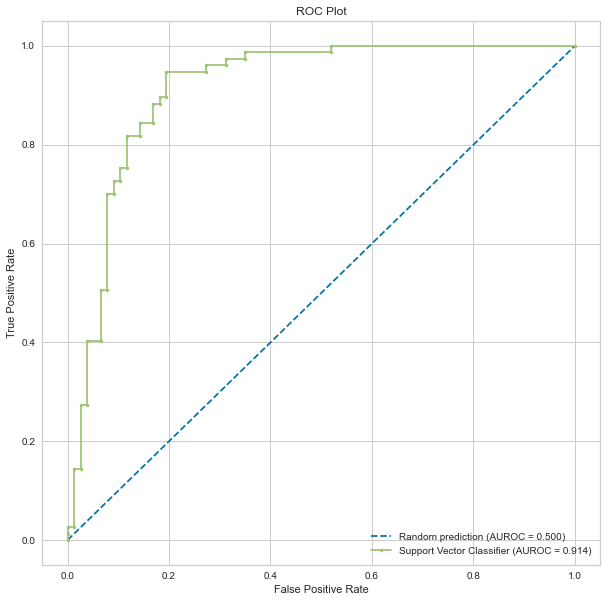

In [283]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
r_probs = [0 for _ in range(len(Y_test))]
LiverModel_probs = LiverModel.predict_proba(X_test)
LiverModel_probs = LiverModel_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverModel_auc = roc_auc_score(Y_test, LiverModel_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('Support Vector Classifier: AUROC = %.3f' % (LiverModel_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverModel_fpr, LiverModel_tpr, _ = roc_curve(Y_test, LiverModel_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverModel_fpr, LiverModel_tpr, marker='.', label='Support Vector Classifier (AUROC = %0.3f)' % LiverModel_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

# Decision Tree Classifier

In [3]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

                            Relative Feature Importance Scores
Features                                                      
Total_Bilirubin                                       0.250324
Alkaline_Phosphotase                                  0.145946
Alamine_Aminotransferase                              0.145008
Age                                                   0.132339
Total_Protiens                                        0.077053
Albumin_and_Globulin_Ratio                            0.070662
Albumin                                               0.064669
Aspartate_Aminotransferase                            0.057157
Direct_Bilirubin                                      0.039158
Gender                                                0.017683


<AxesSubplot:xlabel='Features'>

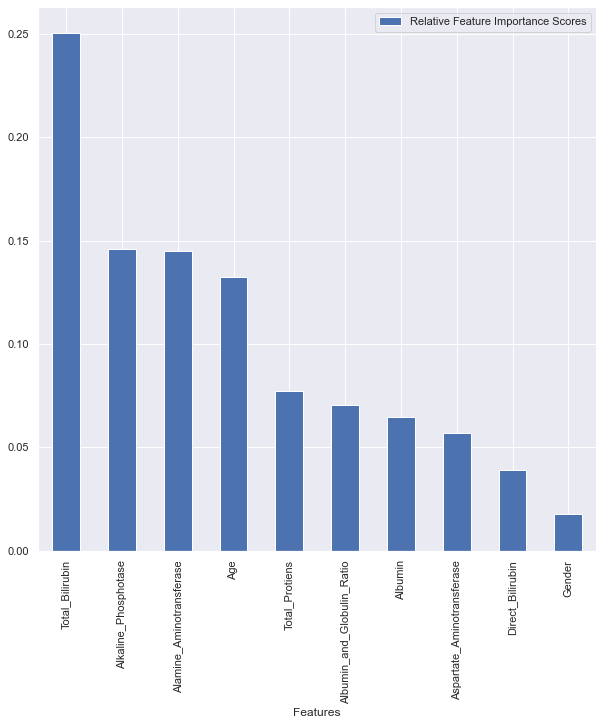

In [4]:
# LinearRegression for feature importance on a regression problem
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# define dataset
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=915)
# define the model
LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999).fit(X_train,Y_train)
# fit the model
# get importance
importance = LiverTree.feature_importances_
# summarize feature importance
DataScores=DataFrame(importance,[x for x in range(len(importance))],columns=["Relative Feature Importance Scores"])
DataColumns=DataFrame(X_train.columns)
CoefficientRank=concat([DataColumns,DataScores],axis=1)
CoefficientRank.columns=['Features','Relative Feature Importance Scores']
# setting "Features" Column as index column
CoefficientRank.set_index("Features", inplace = True)
CoefficientRank.sort_values(by="Relative Feature Importance Scores",ascending=False, inplace=True)
print(CoefficientRank)
# plot feature importance
CoefficientRank.plot.bar()

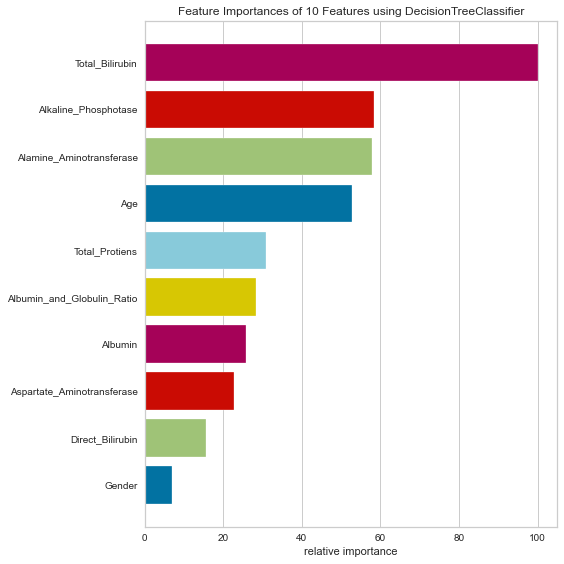

<AxesSubplot:title={'center':'Feature Importances of 10 Features using DecisionTreeClassifier'}, xlabel='relative importance'>

In [5]:
from yellowbrick.model_selection import FeatureImportances # Upon Training Data
# Changing default values for parameters individually
rcParams['figure.figsize'] = [8,8]
# Load the classification data set
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=915)

LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999)
viz = FeatureImportances(LiverTree)
viz.fit(X_train, Y_train)
viz.show()

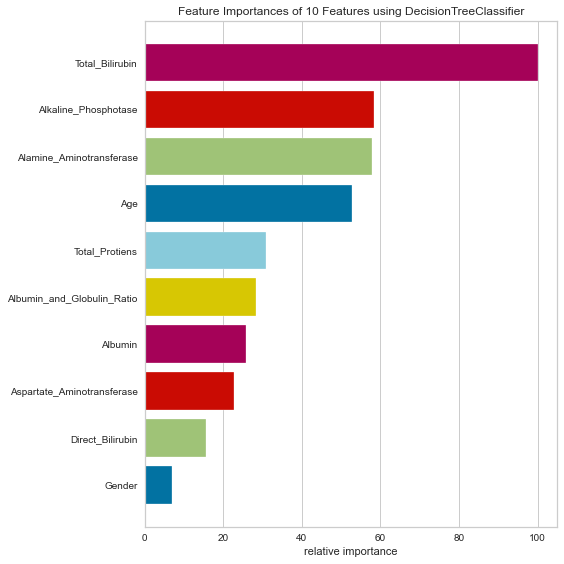

<AxesSubplot:title={'center':'Feature Importances of 10 Features using DecisionTreeClassifier'}, xlabel='relative importance'>

In [6]:
from yellowbrick.model_selection import FeatureImportances # Upon Training Data
# Changing default values for parameters individually
rcParams['figure.figsize'] = [8,8]
# Load the classification data set
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=915)

LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999)
viz = FeatureImportances(LiverTree,relative=True)
viz.fit(X_train, Y_train)
viz.show()

In [7]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Total_Protiens                0.043210
Direct_Bilirubin              0.042833
Gender                        0.030789
Total_Bilirubin               0.030488
Alkaline_Phosphotase          0.030488
Age                           0.024466
Albumin_and_Globulin_Ratio    0.024390
Alamine_Aminotransferase      0.018519
Aspartate_Aminotransferase    0.018293
Albumin                       0.012120


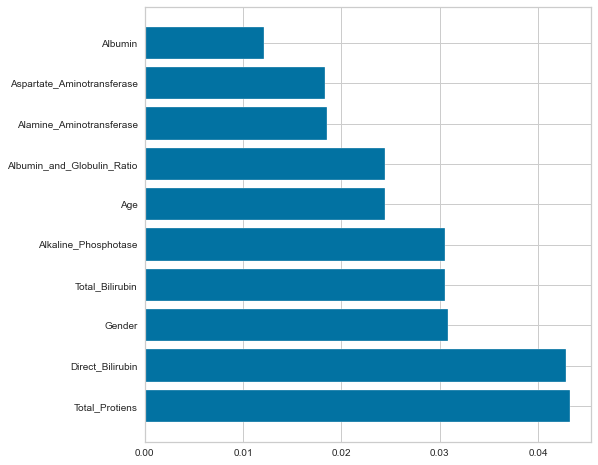

In [8]:
# Best Compatible with Random State 7091 with RMSE: 848 @ 31 features
Bestu = Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(Bestu, Label, stratify=Label, test_size=0.2, random_state=915)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

                            Mean Importance Score
Features                                         
Total_Bilirubin                          0.261992
Alkaline_Phosphotase                     0.218241
Alamine_Aminotransferase                 0.177115
Age                                      0.138960
Total_Protiens                           0.095807
Albumin_and_Globulin_Ratio               0.091368
Direct_Bilirubin                         0.065950
Aspartate_Aminotransferase               0.052699
Albumin                                  0.041900
Gender                                   0.015410


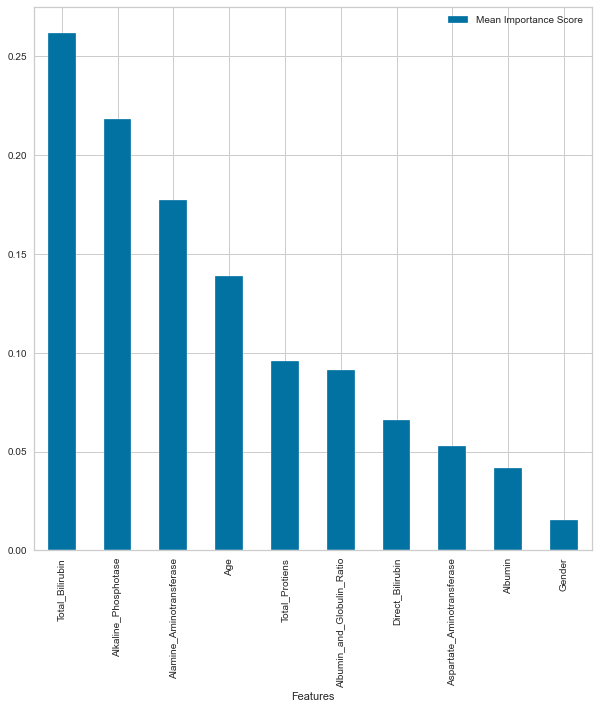

In [9]:
# Permutation Feature Importance by Using LinearRegression
from sklearn.inspection import permutation_importance
from matplotlib import pyplot
rcParams['figure.figsize'] = [10,10]
# define dataset
X_train,X_test,Y_train,Y_test = train_test_split(Bestu, Label, stratify=Label, test_size=0.20, random_state=915)
# define the model
LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999).fit(X_train,Y_train)
# fit the model
# perform permutation importance
results = permutation_importance(LiverTree, X_train, Y_train, scoring='balanced_accuracy', n_repeats=10, random_state=999)
# get importance
importance = results.importances_mean
# summarize feature importance
DataScores=DataFrame(importance,[x for x in range(len(importance))],columns=["Mean Importance Score"])
DataColumns=DataFrame(X_train.columns)
RMSERank=concat([DataColumns,DataScores],axis=1)
RMSERank.columns=['Features','Mean Importance Score']
# setting "Features" Column as index column
RMSERank.set_index("Features", inplace = True)
RMSERank.sort_values(by="Mean Importance Score",ascending=False, inplace=True)
print(RMSERank)
# plot feature importance
RMSERank.plot.bar()
show()

In [10]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance
X_train,X_test,Y_train,Y_test = train_test_split(Bestu, Label, stratify=Label, test_size=0.20, random_state=915)
LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999).fit(X_train, Y_train)
perm = PermutationImportance(LiverTree, scoring='balanced_accuracy',n_iter=20,random_state=999).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1854 ± 0.0584,Total_Bilirubin
0.0915 ± 0.0537,Alkaline_Phosphotase
0.0691 ± 0.0556,Alamine_Aminotransferase
0.0486 ± 0.0217,Direct_Bilirubin
0.0387 ± 0.0364,Albumin_and_Globulin_Ratio
0.0336 ± 0.0367,Total_Protiens
0.0311 ± 0.0366,Age
0.0157 ± 0.0158,Gender
0.0009 ± 0.0244,Aspartate_Aminotransferase
-0.0034 ± 0.0200,Albumin


eli5 Permutation Feature Importance:


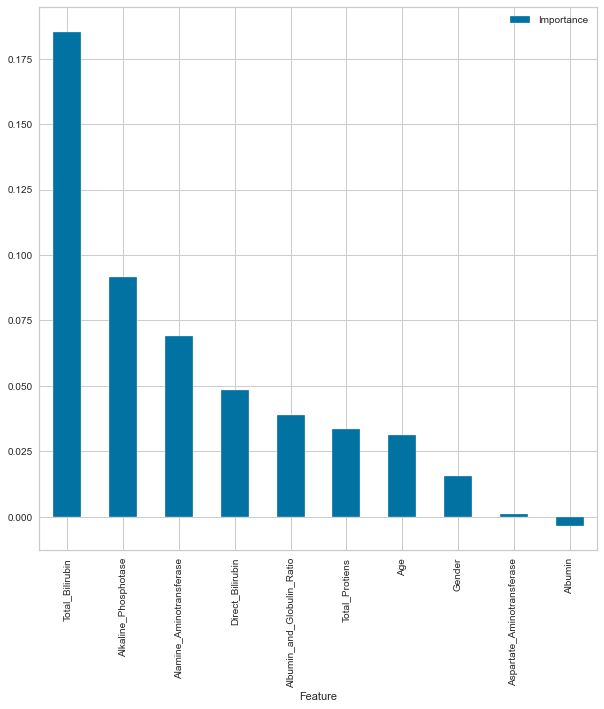

In [11]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
X_train,X_test,Y_train,Y_test = train_test_split(Bestu, Label, stratify=Label, test_size=0.20, random_state=915)
LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999).fit(X_train, Y_train)
perm = PermutationImportance(LiverTree, scoring='balanced_accuracy',n_iter=20,random_state=999).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [12]:
print(Label.unique())
Class_names = ["Good","Bad"]

[0 1]


In [13]:
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
from IPython.display import display
display(eli5.show_weights(LiverTree,top=None,feature_names=feature_names,target_names=Class_names))

Weight,Feature
0.2503,Total_Bilirubin
0.1459,Alkaline_Phosphotase
0.1450,Alamine_Aminotransferase
0.1323,Age
0.0771,Total_Protiens
0.0707,Albumin_and_Globulin_Ratio
0.0647,Albumin
0.0572,Aspartate_Aminotransferase
0.0392,Direct_Bilirubin
0.0177,Gender


In [14]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 9 # 9th row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverTree, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

701    1
Name: Dataset, dtype: int64


                            Mean Importance Score
Features                                         
Total_Bilirubin                          0.265068
Alkaline_Phosphotase                     0.218777
Alamine_Aminotransferase                 0.186125
Age                                      0.140110
Total_Protiens                           0.098967
Albumin_and_Globulin_Ratio               0.096986
Direct_Bilirubin                         0.069184
Aspartate_Aminotransferase               0.056702
Albumin                                  0.044595
Gender                                   0.013944


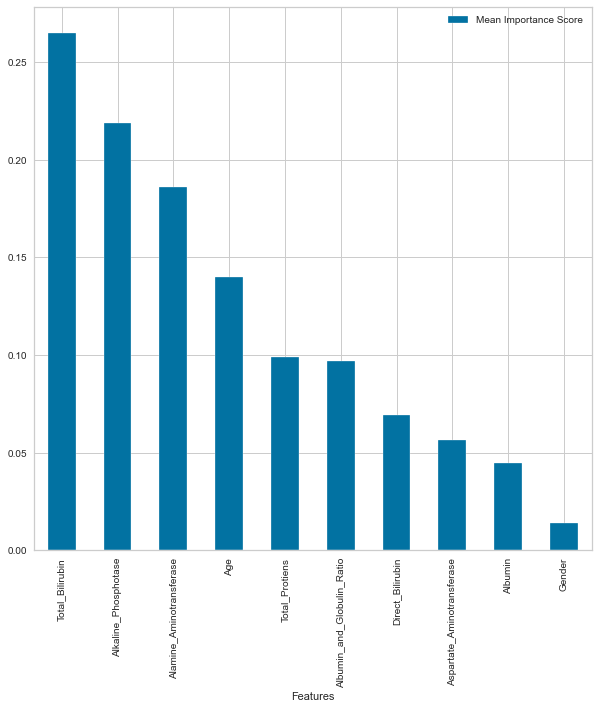

In [15]:
# We can also use eli5 to calculate feature importance for non scikit-learn models also. Here we train a LightGBM model.
from eli5.permutation_importance import get_score_importances
from sklearn.metrics import balanced_accuracy_score
import numpy
#define a score function. In this case I use accuracy
X_train,X_test,Y_train,Y_test = train_test_split(Bestu, Label, stratify=Label, test_size=0.20, random_state=915)
LiverTree = DecisionTreeClassifier(criterion='gini',class_weight='balanced', random_state=999).fit(X_train, Y_train)
# ... load data, define score function
def Bal_Accu(X_train, Y_train):
    Y_pred = LiverTree.predict(X_train)
    return balanced_accuracy_score(Y_train,Y_pred)
# This function takes only numpy arrays as inputs
base_score, score_decreases = get_score_importances(Bal_Accu, numpy.array(X_train), Y_train, n_iter=20, random_state=999)
feature_importances = numpy.mean(score_decreases, axis=0)
DataScores=DataFrame(feature_importances,[x for x in range(len(feature_importances))],columns=["Mean Importance Score"])
DataColumns=DataFrame(X_train.columns)
RMSERank=concat([DataColumns,DataScores],axis=1)
RMSERank.columns=['Features','Mean Importance Score']
# setting "Features" Column as index column
RMSERank.set_index("Features", inplace = True)
RMSERank.sort_values(by="Mean Importance Score",ascending=False, inplace=True)
print(RMSERank)
# plot feature importance
RMSERank.plot.bar()
show()

rfpimp Permutation Feature Importance:


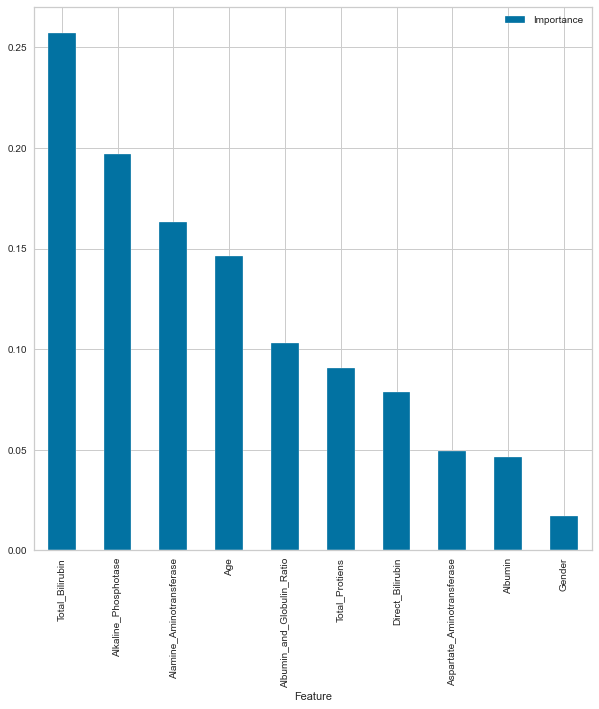

In [52]:
from sklearn.metrics import balanced_accuracy_score
from rfpimp import permutation_importances

def Bal_Accu(LiverTree, X_train, Y_train):
    return balanced_accuracy_score(Y_train,LiverTree.predict(X_train))
LiverTree = DecisionTreeClassifier(criterion='gini', class_weight='balanced', random_state=999).fit(X_train, Y_train)
perm_imp_rfpimp = permutation_importances(LiverTree, X_train, Y_train, Bal_Accu)
perm_imp_rfpimp.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('rfpimp Permutation Feature Importance:')
perm_imp_rfpimp.plot.bar()
show()

# DecisionTree feature_importances_ (Alternative way)

In [53]:
X_train,X_test,Y_train,Y_test = train_test_split(Bestu, Label, stratify=Label, test_size=0.20, random_state=915)
LiverTree = DecisionTreeClassifier(criterion='gini', class_weight='balanced', random_state=999).fit(X_train, Y_train)

In [54]:
for i, column in enumerate(X_train):
    print('Importance of feature {}:, {:.3f}'.format(column, LiverTree.feature_importances_[i]))
    fi = DataFrame({'Variable': [column], 'Feature Importance Score': [LiverTree.feature_importances_[i]]})
    try:
        final_fi = concat([final_fi,fi], ignore_index=True)
    except:
        final_fi = fi
# Ordering the data
final_fi = final_fi.sort_values('Feature Importance Score', ascending=False).reset_index()
final_fi

Importance of feature Age:, 0.132
Importance of feature Total_Bilirubin:, 0.250
Importance of feature Direct_Bilirubin:, 0.039
Importance of feature Alkaline_Phosphotase:, 0.146
Importance of feature Alamine_Aminotransferase:, 0.145
Importance of feature Aspartate_Aminotransferase:, 0.057
Importance of feature Total_Protiens:, 0.077
Importance of feature Albumin:, 0.065
Importance of feature Albumin_and_Globulin_Ratio:, 0.071
Importance of feature Gender:, 0.018


,level_0,index,Variable,Feature Importance Score
0,0,1.0,Total_Bilirubin,0.250324
1,11,NaN,Total_Bilirubin,0.250324
2,1,3.0,Alkaline_Phosphotase,0.145946
3,13,NaN,Alkaline_Phosphotase,0.145946
4,2,4.0,Alamine_Aminotransferase,0.145008
5,14,NaN,Alamine_Aminotransferase,0.145008
6,10,NaN,Age,0.132339
7,3,0.0,Age,0.132339
8,4,6.0,Total_Protiens,0.077053
9,16,NaN,Total_Protiens,0.077053


In [55]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='gini', class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.85:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8588957055214724 Train: 1.0 Balanced_Accuracy: 0.8587774766636556 RandomState: 1973


In [56]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini', class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.8588957055214724
Balanced_Accuracy_Score: 0.8587774766636556
Recall_Score: 0.8780487804878049
Precision_Score: 0.8470588235294118
              precision    recall  f1-score   support

           0       0.87      0.84      0.86        81
           1       0.85      0.88      0.86        82

    accuracy                           0.86       163
   macro avg       0.86      0.86      0.86       163
weighted avg       0.86      0.86      0.86       163

The Log Loss on Training is:  9.992007221626413e-16
The Log Loss on Testing is:  4.873569675355496


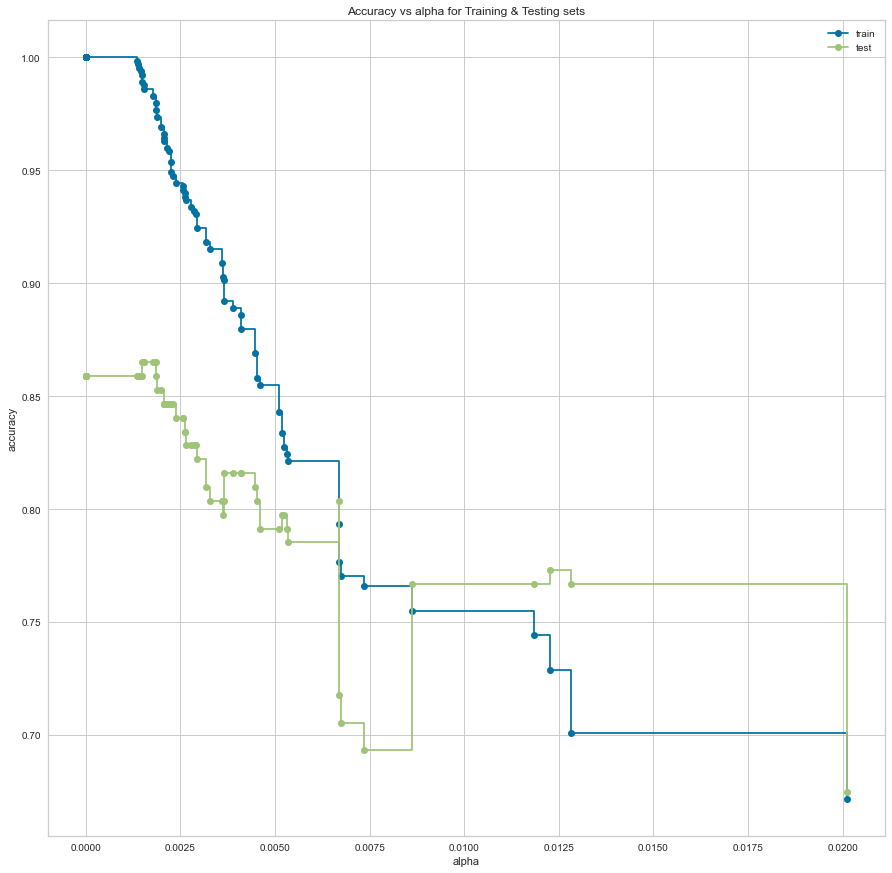

In [57]:
rcParams['figure.figsize'] = [15,15]
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree=DecisionTreeClassifier(criterion='gini',class_weight='balanced',random_state=999).fit(X_train,Y_train)
path=LiverTree.cost_complexity_pruning_path(X_train,Y_train)
ccp_alphas=path.ccp_alphas
ccp_alphas=ccp_alphas[:-1]
LiverTreeS=[]
for ccp_alpha in ccp_alphas:
    LiverTree=DecisionTreeClassifier(criterion='gini',class_weight='balanced',random_state=999,ccp_alpha=ccp_alpha)
    LiverTree.fit(X_train,Y_train)
    LiverTreeS.append(LiverTree)
train_scores=[LiverTree.score(X_train,Y_train) for LiverTree in LiverTreeS]
test_scores=[LiverTree.score(X_test,Y_test) for LiverTree in LiverTreeS]

fig, ax=pyplot.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for Training & Testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label='train', drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label='test', drawstyle="steps-post")
ax.legend()
pyplot.show()

In [58]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='entropy', class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.85:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8588957055214724 Train: 1.0 Balanced_Accuracy: 0.8587774766636556 RandomState: 4683


In [59]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=4683)
LiverTree = DecisionTreeClassifier(criterion='entropy', class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.8588957055214724
Balanced_Accuracy_Score: 0.8587774766636556
Recall_Score: 0.8780487804878049
Precision_Score: 0.8470588235294118
              precision    recall  f1-score   support

           0       0.87      0.84      0.86        81
           1       0.85      0.88      0.86        82

    accuracy                           0.86       163
   macro avg       0.86      0.86      0.86       163
weighted avg       0.86      0.86      0.86       163

The Log Loss on Training is:  9.992007221626413e-16
The Log Loss on Testing is:  4.873569675355496


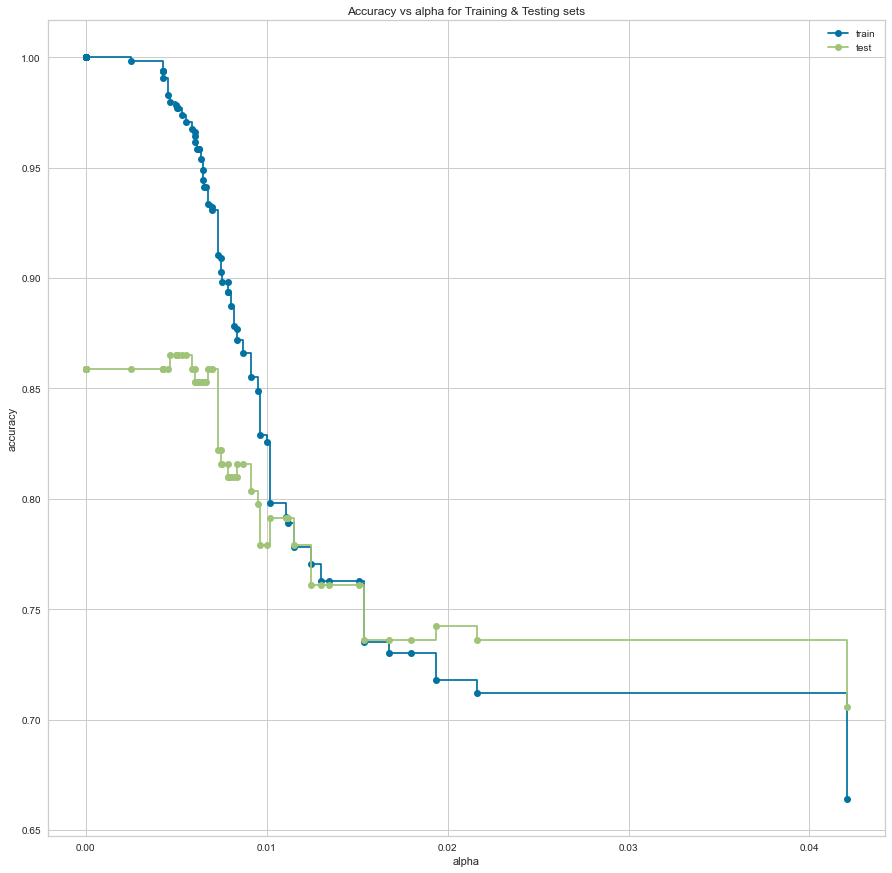

In [60]:
rcParams['figure.figsize'] = [15,15]
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=4683)
LiverTree=DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999).fit(X_train,Y_train)
path=LiverTree.cost_complexity_pruning_path(X_train,Y_train)
ccp_alphas=path.ccp_alphas
ccp_alphas=ccp_alphas[:-1]
LiverTreeS=[]
for ccp_alpha in ccp_alphas:
    LiverTree=DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=ccp_alpha)
    LiverTree.fit(X_train,Y_train)
    LiverTreeS.append(LiverTree)
train_scores=[LiverTree.score(X_train,Y_train) for LiverTree in LiverTreeS]
test_scores=[LiverTree.score(X_test,Y_test) for LiverTree in LiverTreeS]

fig, ax=pyplot.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for Training & Testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label='train', drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label='test', drawstyle="steps-post")
ax.legend()
pyplot.show()

In [65]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=16, class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 0.810477657935285
Test_Score: 0.8159509202453987
Balanced_Accuracy_Score: 0.8157934357121348
Recall_Score: 0.8414634146341463
Precision_Score: 0.8023255813953488
              precision    recall  f1-score   support

           0       0.83      0.79      0.81        81
           1       0.80      0.84      0.82        82

    accuracy                           0.82       163
   macro avg       0.82      0.82      0.82       163
weighted avg       0.82      0.82      0.82       163

The Log Loss on Training is:  0.4343384021384274
The Log Loss on Testing is:  0.4535093298855915


In [66]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Alkaline_Phosphotase          0.122629
Direct_Bilirubin              0.061277
Total_Protiens                0.043135
Aspartate_Aminotransferase    0.037112
Age                           0.036661
Total_Bilirubin               0.031316
Albumin                       0.000000
Albumin_and_Globulin_Ratio    0.000000
Gender                        0.000000


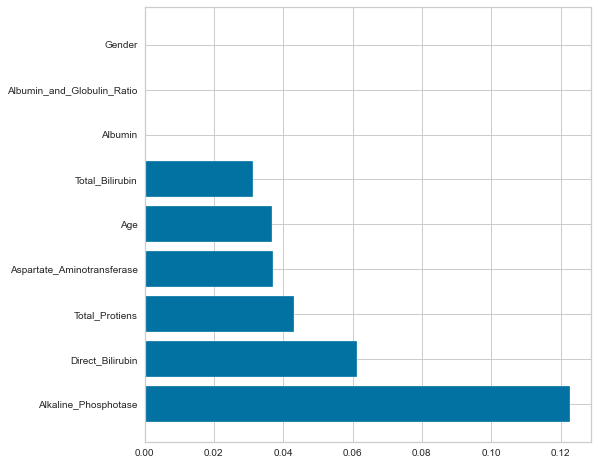

Train_Score: 0.8151001540832049
Test_Score: 0.8159509202453987
Balanced_Accuracy_Score: 0.8158687142426979
Recall_Score: 0.8292682926829268
Precision_Score: 0.8095238095238095
              precision    recall  f1-score   support

           0       0.82      0.80      0.81        81
           1       0.81      0.83      0.82        82

    accuracy                           0.82       163
   macro avg       0.82      0.82      0.82       163
weighted avg       0.82      0.82      0.82       163

The Log Loss on Training is:  0.43430842517644064
The Log Loss on Testing is:  0.4639369606986498


In [75]:
rcParams['figure.figsize'] = [8,8]
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
        'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=1973)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree=DecisionTreeClassifier(criterion='gini', max_leaf_nodes=16, class_weight='balanced', random_state=999)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=16, class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

In [72]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=4683)
LiverTree = DecisionTreeClassifier(criterion='entropy', max_leaf_nodes=19, class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 0.7950693374422187
Test_Score: 0.7975460122699386
Balanced_Accuracy_Score: 0.7974254742547425
Recall_Score: 0.8170731707317073
Precision_Score: 0.788235294117647
              precision    recall  f1-score   support

           0       0.81      0.78      0.79        81
           1       0.79      0.82      0.80        82

    accuracy                           0.80       163
   macro avg       0.80      0.80      0.80       163
weighted avg       0.80      0.80      0.80       163

The Log Loss on Training is:  0.4164049589079303
The Log Loss on Testing is:  0.6077724826385554


In [73]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Alamine_Aminotransferase      0.074300
Direct_Bilirubin              0.073848
Age                           0.048931
Total_Bilirubin               0.036811
Alkaline_Phosphotase          0.031316
Albumin                       0.006022
Aspartate_Aminotransferase    0.000000
Albumin_and_Globulin_Ratio    0.000000
Gender                        0.000000
Total_Protiens               -0.000075


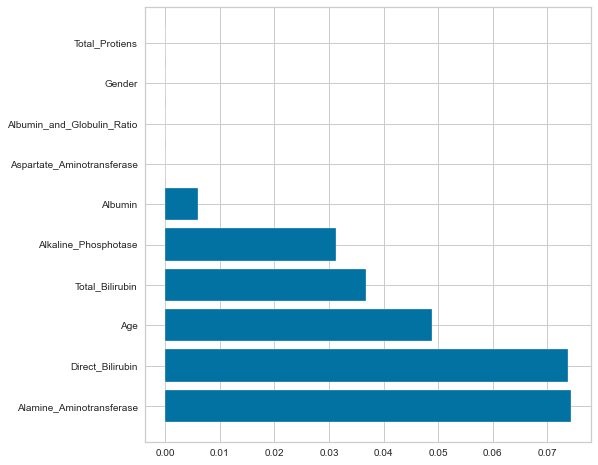

Train_Score: 0.7950693374422187
Test_Score: 0.7975460122699386
Balanced_Accuracy_Score: 0.7974254742547425
Recall_Score: 0.8170731707317073
Precision_Score: 0.788235294117647
              precision    recall  f1-score   support

           0       0.81      0.78      0.79        81
           1       0.79      0.82      0.80        82

    accuracy                           0.80       163
   macro avg       0.80      0.80      0.80       163
weighted avg       0.80      0.80      0.80       163

The Log Loss on Training is:  0.4164049589079303
The Log Loss on Testing is:  0.6077724826385554


In [79]:
rcParams['figure.figsize'] = [8,8]
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=4683)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree=DecisionTreeClassifier(criterion='entropy', max_leaf_nodes=19, class_weight='balanced', random_state=999)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Model Check
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=4683)
LiverTree = DecisionTreeClassifier(criterion='entropy', max_leaf_nodes=19, class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

In [113]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='entropy', max_leaf_nodes=22, class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.83:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8376623376623377 Train: 0.8088235294117647 Balanced_Accuracy: 0.8376623376623377 RandomState: 88
Test: 0.8311688311688312 Train: 0.8284313725490197 Balanced_Accuracy: 0.8311688311688312 RandomState: 1523
Test: 0.8311688311688312 Train: 0.8447712418300654 Balanced_Accuracy: 0.8311688311688312 RandomState: 2795


In [80]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='entropy', max_leaf_nodes=19, class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.83:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

In [82]:
# For loop to check ideal sample that will give generalized model
#Test1
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='entropy', max_leaf_nodes=19, class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.83:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

In [81]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=16, class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.83:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8466257668711656 Train: 0.7966101694915254 Balanced_Accuracy: 0.8468081903041252 RandomState: 2478


In [109]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.83:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8343558282208589 Train: 0.8952234206471494 Balanced_Accuracy: 0.8343119542306534 RandomState: 782
Test: 0.8588957055214724 Train: 0.8798151001540832 Balanced_Accuracy: 0.8589280337247817 RandomState: 2478


In [108]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2478)
LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 21

Train_Score: 0.8798151001540832
Test_Score: 0.8588957055214724
Balanced_Accuracy_Score: 0.8589280337247817
Recall_Score: 0.8536585365853658
Precision_Score: 0.8641975308641975
              precision    recall  f1-score   support

           0       0.85      0.86      0.86        81
           1       0.86      0.85      0.86        82

    accuracy                           0.86       163
   macro avg       0.86      0.86      0.86       163
weighted avg       0.86      0.86      0.86       163

The Log Loss on Training is:  0.2975535165246491
The Log Loss on Testing is:  1.3424620695918599


In [130]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2478)
LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999,ccp_alpha=0.0041).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good 21, 41

Train_Score: 0.8536209553158706
Test_Score: 0.8588957055214724
Balanced_Accuracy_Score: 0.8590785907859078
Recall_Score: 0.8292682926829268
Precision_Score: 0.8831168831168831
              precision    recall  f1-score   support

           0       0.84      0.89      0.86        81
           1       0.88      0.83      0.86        82

    accuracy                           0.86       163
   macro avg       0.86      0.86      0.86       163
weighted avg       0.86      0.86      0.86       163

The Log Loss on Training is:  0.3650931759023303
The Log Loss on Testing is:  1.1680431848022204


In [131]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Total_Bilirubin               0.080322
Alkaline_Phosphotase          0.074074
Age                           0.061954
Direct_Bilirubin              0.049533
Alamine_Aminotransferase      0.043059
Total_Protiens                0.031015
Gender                        0.024616
Aspartate_Aminotransferase    0.006173
Albumin_and_Globulin_Ratio    0.000000


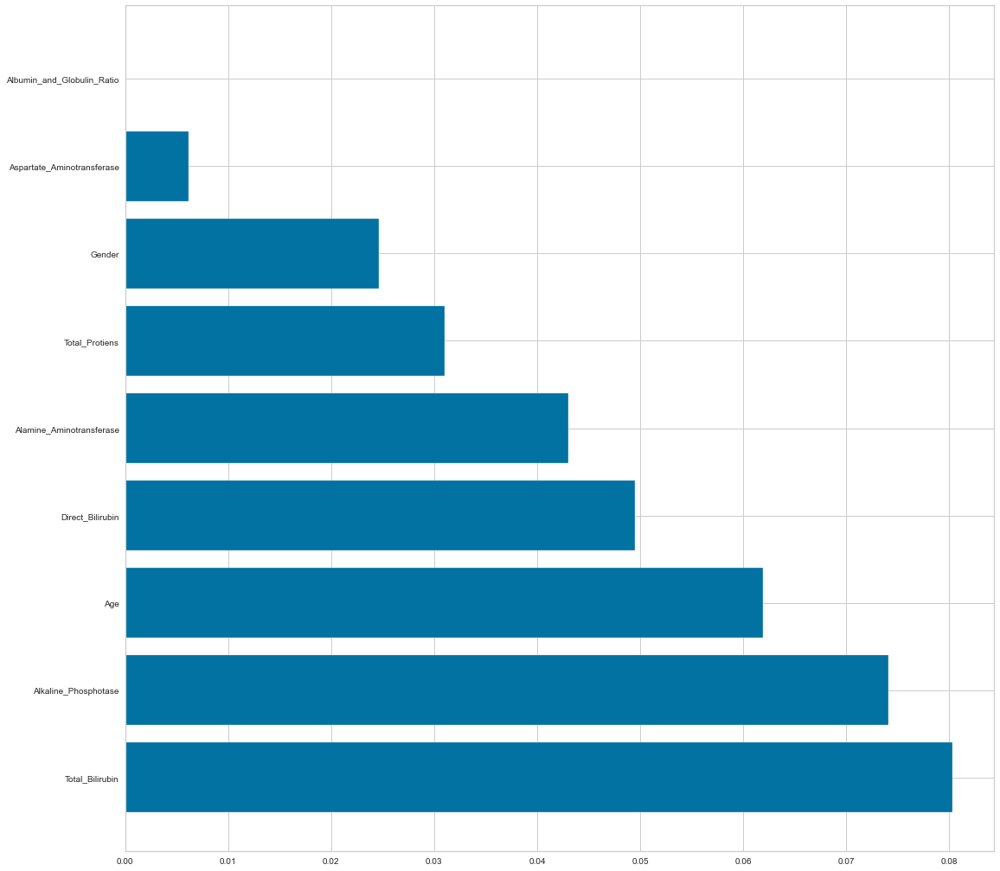

Train_Score: 0.8613251155624037
Test_Score: 0.8711656441717791
Balanced_Accuracy_Score: 0.8714242697982535
Recall_Score: 0.8292682926829268
Precision_Score: 0.9066666666666666
              precision    recall  f1-score   support

           0       0.84      0.91      0.88        81
           1       0.91      0.83      0.87        82

    accuracy                           0.87       163
   macro avg       0.87      0.87      0.87       163
weighted avg       0.87      0.87      0.87       163

The Log Loss on Training is:  0.3403033153081424
The Log Loss on Testing is:  1.3333057039403897


In [134]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens',  'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2478)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree=DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999,ccp_alpha=0.0041)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
# Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=2478)
LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999,ccp_alpha=0.0041).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                           # so our prediction is very good 21, 41

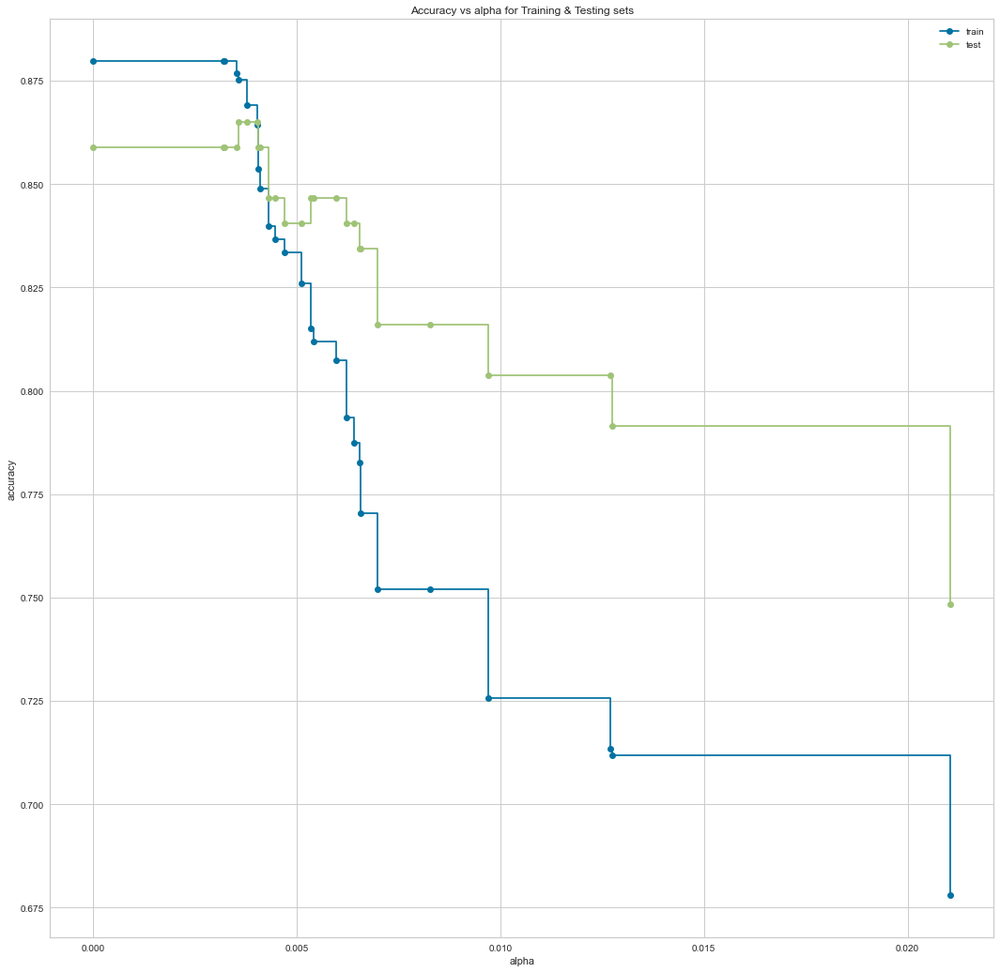

In [110]:
rcParams['figure.figsize'] = [18, 18]
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2478)
LiverTree=DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999).fit(X_train,Y_train)
path=LiverTree.cost_complexity_pruning_path(X_train,Y_train)
ccp_alphas=path.ccp_alphas
ccp_alphas=ccp_alphas[:-1]
LiverTreeS=[]
for ccp_alpha in ccp_alphas:
    LiverTree=DecisionTreeClassifier(criterion='gini', max_leaf_nodes=41, class_weight='balanced', random_state=999,ccp_alpha=ccp_alpha)
    LiverTree.fit(X_train,Y_train)
    LiverTreeS.append(LiverTree)
train_scores=[LiverTree.score(X_train,Y_train) for LiverTree in LiverTreeS]
test_scores=[LiverTree.score(X_test,Y_test) for LiverTree in LiverTreeS]

fig, ax=pyplot.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for Training & Testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label='train', drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label='test', drawstyle="steps-post")
ax.legend()
pyplot.show()

In [83]:
# For loop to check ideal sample that will give generalized model
#Test1
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
        'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverTree = DecisionTreeClassifier(criterion='gini', max_leaf_nodes=16, class_weight='balanced', random_state=999).fit(X_train,Y_train)
    train_score=LiverTree.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverTree.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverTree.predict(X_test))
    if test_score > 0.83:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

In [31]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=1523)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced', random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.7239263803680982
Balanced_Accuracy_Score: 0.7235772357723578
Recall_Score: 0.7804878048780488
Precision_Score: 0.7032967032967034
              precision    recall  f1-score   support

           0       0.75      0.67      0.71        81
           1       0.70      0.78      0.74        82

    accuracy                           0.72       163
   macro avg       0.73      0.72      0.72       163
weighted avg       0.73      0.72      0.72       163

The Log Loss on Training is:  9.992007221626413e-16
The Log Loss on Testing is:  9.535245016999882


In [32]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=1523)
LiverTree = DecisionTreeClassifier(criterion='entropy',max_leaf_nodes=22,class_weight='balanced',random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])# printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 0.8073959938366718
Test_Score: 0.7177914110429447
Balanced_Accuracy_Score: 0.7177055103884372
Recall_Score: 0.7317073170731707
Precision_Score: 0.7142857142857143
              precision    recall  f1-score   support

           0       0.72      0.70      0.71        81
           1       0.71      0.73      0.72        82

    accuracy                           0.72       163
   macro avg       0.72      0.72      0.72       163
weighted avg       0.72      0.72      0.72       163

The Log Loss on Training is:  0.3678847404324154
The Log Loss on Testing is:  1.1326469689689023


In [33]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])# printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.7055214723926381
Balanced_Accuracy_Score: 0.7055103884372177
Recall_Score: 0.7037037037037037
Precision_Score: 0.7037037037037037
              precision    recall  f1-score   support

           0       0.71      0.71      0.71        82
           1       0.70      0.70      0.70        81

    accuracy                           0.71       163
   macro avg       0.71      0.71      0.71       163
weighted avg       0.71      0.71      0.71       163

The Log Loss on Training is:  9.992007221626413e-16
The Log Loss on Testing is:  10.170928018133207


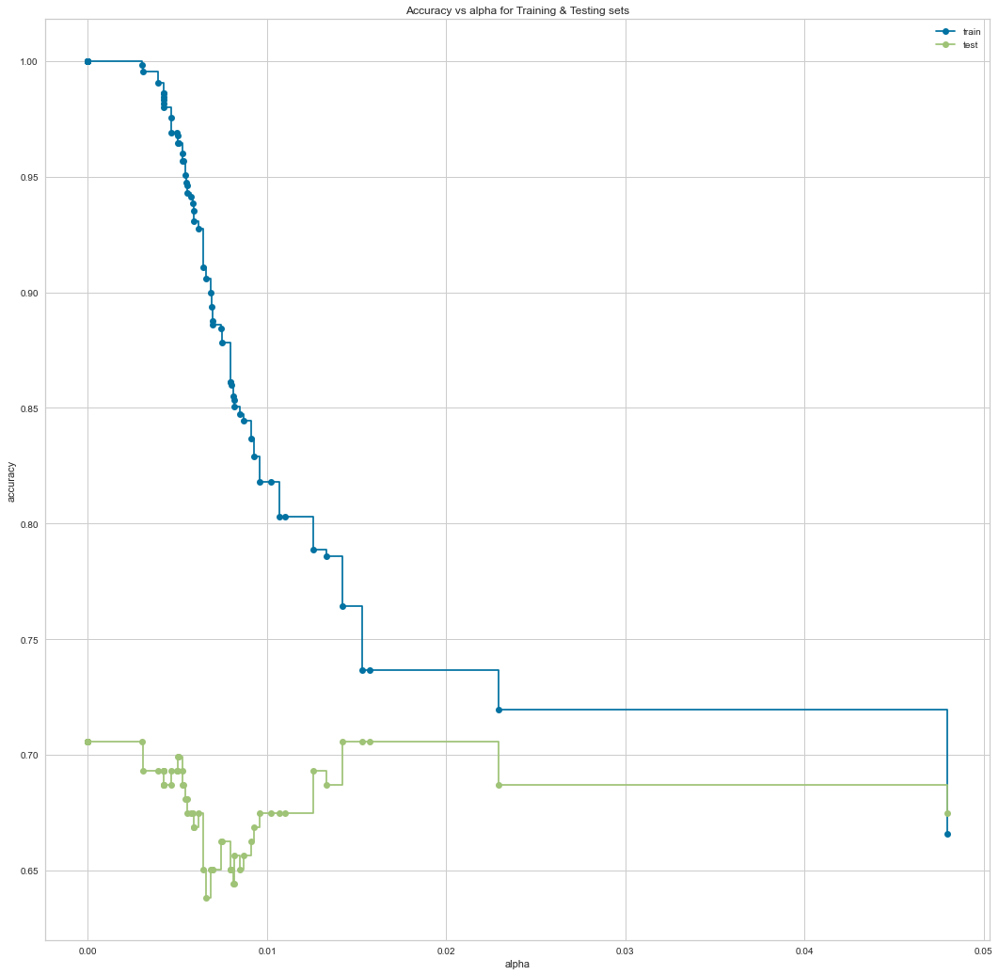

In [34]:
rcParams['figure.figsize'] = [18, 18]
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree=DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999).fit(X_train,Y_train)
path=LiverTree.cost_complexity_pruning_path(X_train,Y_train)
ccp_alphas=path.ccp_alphas
ccp_alphas=ccp_alphas[:-1]
LiverTreeS=[]
for ccp_alpha in ccp_alphas:
    LiverTree=DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=ccp_alpha)
    LiverTree.fit(X_train,Y_train)
    LiverTreeS.append(LiverTree)
train_scores=[LiverTree.score(X_train,Y_train) for LiverTree in LiverTreeS]
test_scores=[LiverTree.score(X_test,Y_test) for LiverTree in LiverTreeS]

fig, ax=pyplot.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for Training & Testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label='train', drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label='test', drawstyle="steps-post")
ax.legend()
pyplot.show()

In [35]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',max_leaf_nodes=22,class_weight='balanced',random_state=999).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])# printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 0.8212634822804314
Test_Score: 0.6871165644171779
Balanced_Accuracy_Score: 0.6871424269798254
Recall_Score: 0.691358024691358
Precision_Score: 0.6829268292682927
              precision    recall  f1-score   support

           0       0.69      0.68      0.69        82
           1       0.68      0.69      0.69        81

    accuracy                           0.69       163
   macro avg       0.69      0.69      0.69       163
weighted avg       0.69      0.69      0.69       163

The Log Loss on Training is:  0.3726392590189254
The Log Loss on Testing is:  0.7479792752046516


In [171]:
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.0102).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])# printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 0.8366013071895425
Test_Score: 0.8376623376623377
Balanced_Accuracy_Score: 0.8376623376623377
Recall_Score: 0.8181818181818182
Precision_Score: 0.8513513513513513
              precision    recall  f1-score   support

           0       0.82      0.86      0.84        77
           1       0.85      0.82      0.83        77

    accuracy                           0.84       154
   macro avg       0.84      0.84      0.84       154
weighted avg       0.84      0.84      0.84       154

The Log Loss on Training is:  0.3561113475359071
The Log Loss on Testing is:  0.7685306487551221


In [172]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase', 'Albumin',
       'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Alkaline_Phosphotase          0.090909
Alamine_Aminotransferase      0.071429
Age                           0.064935
Direct_Bilirubin              0.051948
Total_Bilirubin               0.032468
Albumin_and_Globulin_Ratio    0.012987
Gender                        0.000000


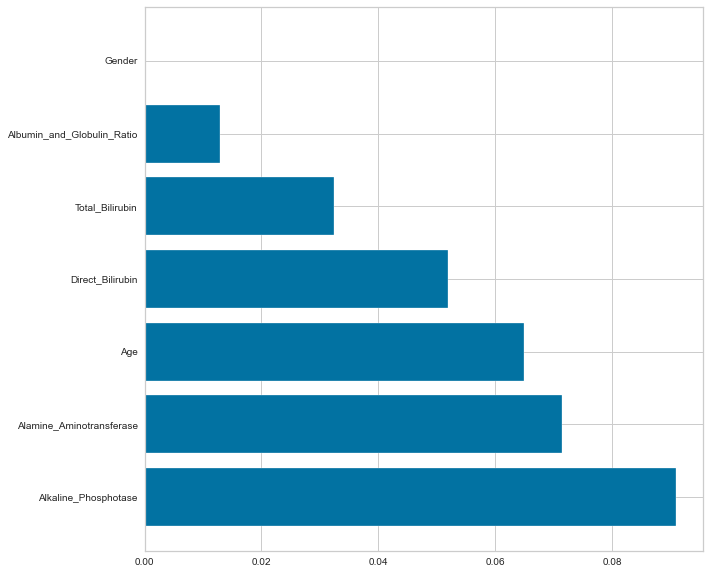

In [176]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase',  
       'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=88)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree=DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.0102)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverTree, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()

# The Best & Final Model for Liver Tree

In [344]:
Liver=read_csv("DataFile\\Liver_Clean_Balanced.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Liver
#DataFrame Separation for Encoding
#label will be in 1D Series
#Continuous & Nominal will remain in 2D DataFrame only
Label=Liver['Dataset']
Continuous=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio',]]
Nominal=Liver[['Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Continuous=StandardScaler.fit_transform(Continuous) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Continuous=DataFrame(Continuous,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']) #Converting Features into 2D DataFrame
type(Continuous),ndim(Continuous),Continuous.shape
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Features=concat([Continuous,Nominal],axis=1)
Features

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Gender
0,1.300310,-0.358488,-0.428685,-0.364146,-0.318104,-0.279887,0.270347,0.113164,-0.247019,0
1,1.118363,1.504558,1.750622,2.020559,-0.014523,0.044382,0.938995,-0.016733,-0.778668,1
2,1.118363,0.847012,1.185617,1.047115,-0.039822,-0.082162,0.461389,0.113164,-0.280247,1
3,0.875767,-0.303693,-0.307612,-0.387434,-0.330754,-0.271978,0.270347,0.243060,0.085261,1
4,1.724853,0.225997,0.338108,-0.326885,-0.248534,-0.117752,0.747953,-1.055906,-1.908421,1
5,0.147980,-0.157572,-0.186540,-0.266336,-0.299131,-0.295705,1.034516,1.542026,1.082102,1
6,-1.064999,-0.321958,-0.388328,-0.517848,-0.318104,-0.303614,0.461389,0.372957,0.085261,0
7,-0.883052,-0.321958,-0.347970,-0.294282,-0.330754,-0.307569,0.174826,0.502853,0.417541,0
8,-1.610839,-0.321958,-0.347970,-0.294282,-0.280157,-0.275933,0.843474,1.152336,0.749821,1
9,0.693821,-0.358488,-0.388328,0.115589,-0.084094,-0.121707,0.270347,0.243060,0.085261,1


In [25]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Albumin_and_Globulin_Ratio', 'Gender']]
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.009316440468435406).fit(X_train,Y_train)
print('Train_Score:',LiverTree.score(X_train,Y_train))
print('Test_Score:',LiverTree.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverTree.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverTree.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverTree.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverTree.predict(X_test)))
print(classification_report(Y_test,LiverTree.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverTree.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data 0.0102
Predicted_Proba_Y = LiverTree.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

Train_Score: 0.8349673202614379
Test_Score: 0.8701298701298701
Balanced_Accuracy_Score: 0.8701298701298701
Recall_Score: 0.8571428571428571
Precision_Score: 0.88
              precision    recall  f1-score   support

           0       0.86      0.88      0.87        77
           1       0.88      0.86      0.87        77

    accuracy                           0.87       154
   macro avg       0.87      0.87      0.87       154
weighted avg       0.87      0.87      0.87       154

The Log Loss on Training is:  0.33803554821864534
The Log Loss on Testing is:  1.3667478618841848


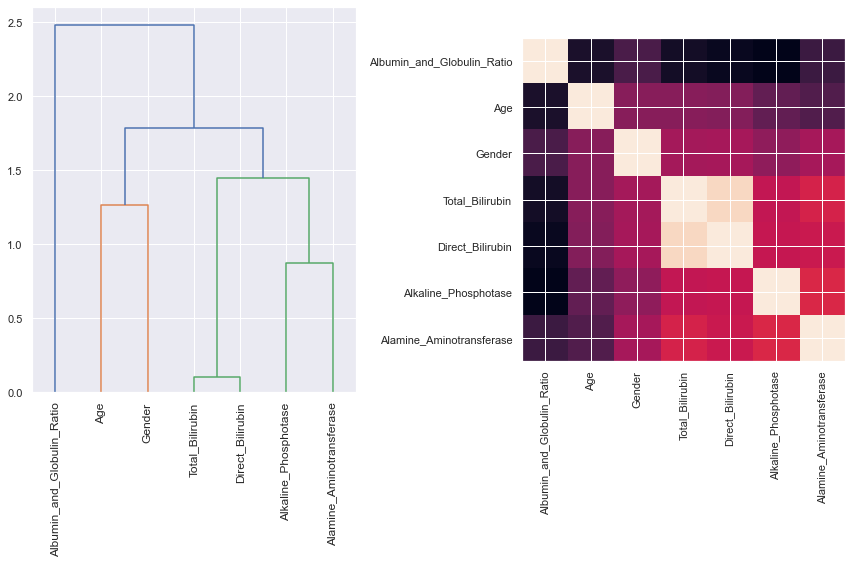

In [27]:
# https://scikit-learn.org/stable/auto_examples/inspection/plot_permutation_importance_multicollinear.html#sphx-glr-auto-examples-inspection-plot-permutation-importance-multicollinear-py
from matplotlib import pyplot
rcParams['figure.figsize'] = [8, 8]
from scipy.cluster import hierarchy
fig, (ax1, ax2) = pyplot.subplots(1, 2, figsize=(12, 8))
corr = spearmanr(X_train).correlation
corr_linkage = hierarchy.ward(corr)
dendro = hierarchy.dendrogram(
    corr_linkage, labels=X_train.columns.tolist(), ax=ax1, leaf_rotation=90
)
dendro_idx = np.arange(0, len(dendro['ivl']))

ax2.imshow(corr[dendro['leaves'], :][:, dendro['leaves']])
ax2.set_xticks(dendro_idx)
ax2.set_yticks(dendro_idx)
ax2.set_xticklabels(dendro['ivl'], rotation='vertical')
ax2.set_yticklabels(dendro['ivl'])
fig.tight_layout()
pyplot.show()

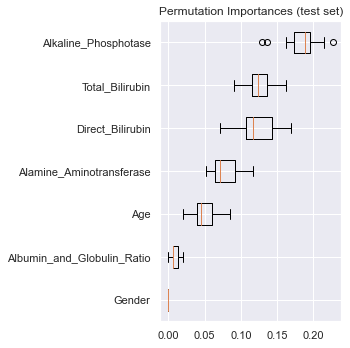

In [28]:
rcParams['figure.figsize'] = [5, 5]
from sklearn.inspection import permutation_importance
result = permutation_importance(LiverTree, X_test, Y_test, n_repeats=20,
                                random_state=999)
sorted_idx = result.importances_mean.argsort()

fig, ax = pyplot.subplots()
ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X_test.columns[sorted_idx])
ax.set_title("Permutation Importances (test set)")
fig.tight_layout()
pyplot.show()

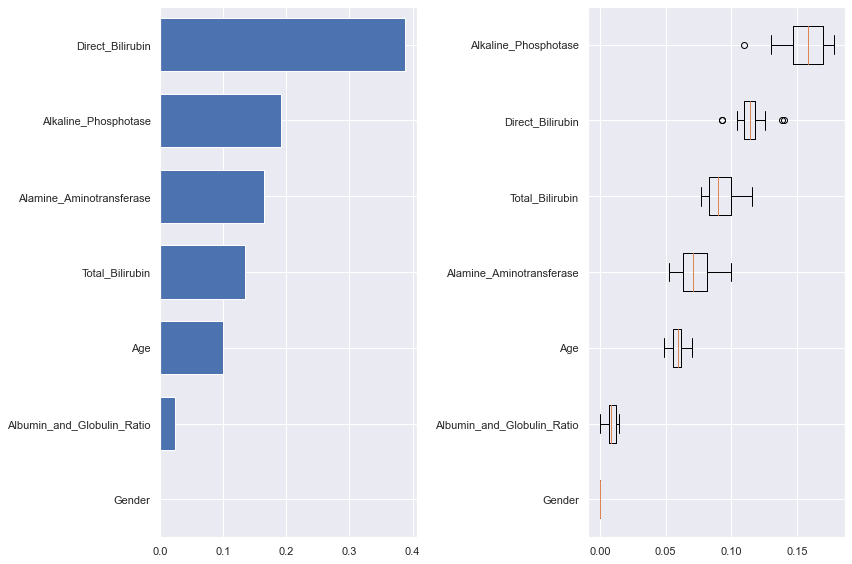

In [29]:
clf = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.009316440468435406).fit(X_train, Y_train)
result = permutation_importance(clf, X_train, Y_train, n_repeats=20,
                                random_state=999)
perm_sorted_idx = result.importances_mean.argsort()

tree_importance_sorted_idx = np.argsort(clf.feature_importances_)
tree_indices = np.arange(0, len(clf.feature_importances_)) + 0.5

fig, (ax1, ax2) = pyplot.subplots(1, 2, figsize=(12, 8))
ax1.barh(tree_indices,
         clf.feature_importances_[tree_importance_sorted_idx], height=0.7)
ax1.set_yticks(tree_indices)
ax1.set_yticklabels(X_train.columns[tree_importance_sorted_idx])
ax1.set_ylim((0, len(clf.feature_importances_)))
ax2.boxplot(result.importances[perm_sorted_idx].T, vert=False,
            labels=X_train.columns[perm_sorted_idx])
fig.tight_layout()
pyplot.show()

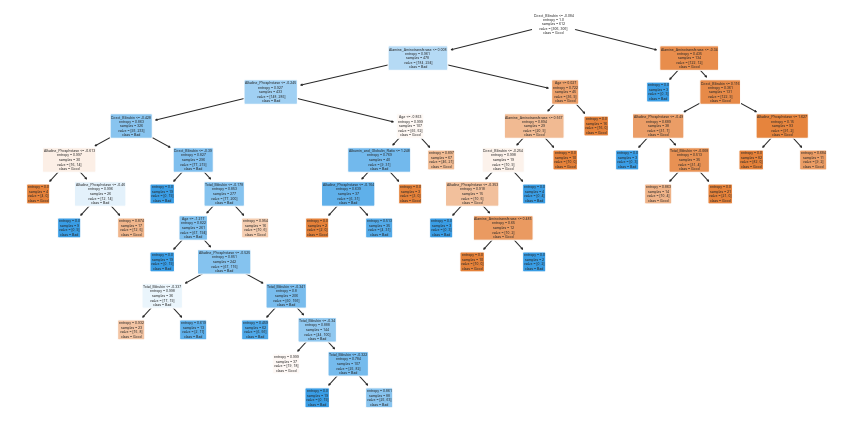

In [30]:
# Visualizing and Plotting the Primary TitanicTree Decision Tree
rcParams['figure.figsize'] = [10, 10]
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=88)
HeartTree=DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.009316440468435406).fit(X_train,Y_train)
from sklearn import tree
from sklearn.tree import plot_tree
figure(figsize=(15,7.5))
tree.plot_tree(HeartTree,
          filled=True,
          rounded=True,
          class_names=["Good", "Bad"],
          feature_names=SFFS1.columns);

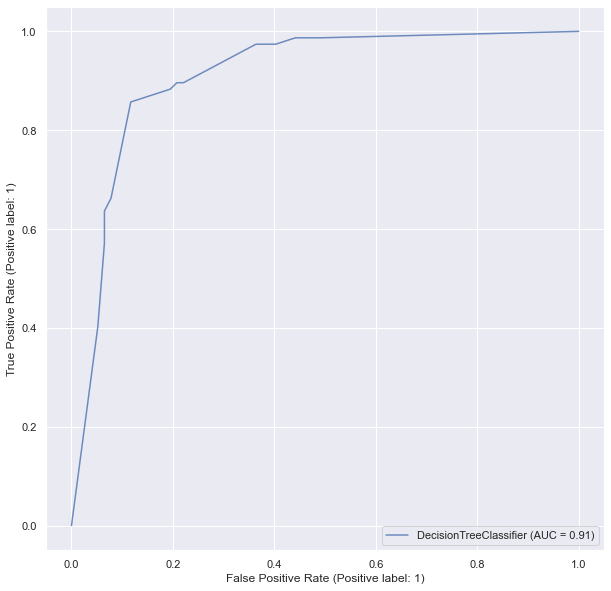

In [31]:
from sklearn.metrics import plot_roc_curve
#rfc = RandomForestClassifier(n_estimators = 450, criterion = 'entropy', random_state = 15).fit(X_train, Y_train)
ax = pyplot.gca()
LiverTree_disp = plot_roc_curve(LiverTree, X_test, Y_test, ax=ax, alpha=0.8)
#svc_disp.plot(ax=ax, alpha=0.8)
pyplot.show()

In [32]:
from sklearn.tree import export_text
r = export_text(LiverTree, feature_names=list(SFFS1.columns))
print(r)

|--- Direct_Bilirubin <= -0.08
|   |--- Alamine_Aminotransferase <= 0.01
|   |   |--- Alkaline_Phosphotase <= -0.25
|   |   |   |--- Direct_Bilirubin <= -0.43
|   |   |   |   |--- Alkaline_Phosphotase <= -0.61
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- Alkaline_Phosphotase >  -0.61
|   |   |   |   |   |--- Alkaline_Phosphotase <= -0.46
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- Alkaline_Phosphotase >  -0.46
|   |   |   |   |   |   |--- class: 0
|   |   |   |--- Direct_Bilirubin >  -0.43
|   |   |   |   |--- Direct_Bilirubin <= -0.39
|   |   |   |   |   |--- class: 1
|   |   |   |   |--- Direct_Bilirubin >  -0.39
|   |   |   |   |   |--- Total_Bilirubin <= -0.18
|   |   |   |   |   |   |--- Age <= -1.22
|   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |--- Age >  -1.22
|   |   |   |   |   |   |   |--- Alkaline_Phosphotase <= -0.52
|   |   |   |   |   |   |   |   |--- Total_Bilirubin <= -0.34
|   |   |   |   |   |   |   |   |   |--- class:

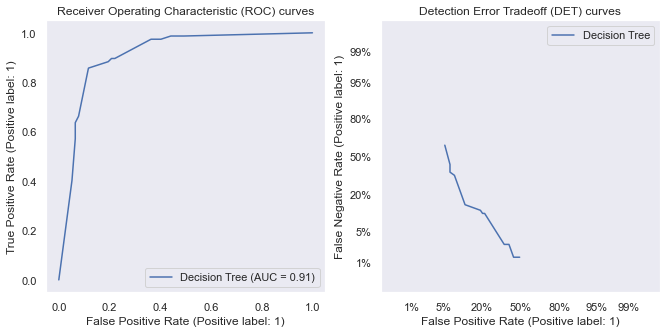

In [33]:
# prepare plots
from sklearn.metrics import plot_det_curve, plot_roc_curve
fig, [ax_roc, ax_det] = pyplot.subplots(1, 2, figsize=(11, 5))
# clf = RandomForestClassifier(n_estimators = 450, criterion = 'entropy', random_state = 15).fit(X_train, Y_train)
plot_roc_curve(LiverTree, X_test, Y_test, ax=ax_roc, name='Decision Tree')
plot_det_curve(LiverTree, X_test, Y_test, ax=ax_det, name='Decision Tree')

ax_roc.set_title('Receiver Operating Characteristic (ROC) curves')
ax_det.set_title('Detection Error Tradeoff (DET) curves')

ax_roc.grid(linestyle='--')
ax_det.grid(linestyle='--')

pyplot.legend()
pyplot.show()

Elapsed time to compute the importances: 0.211 seconds


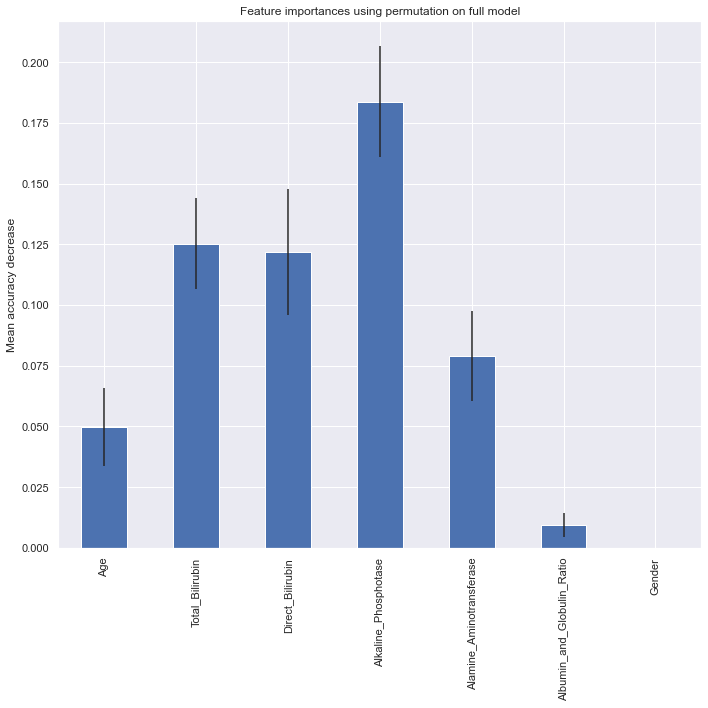

In [34]:
from sklearn.inspection import permutation_importance

start_time = time.time()
result = permutation_importance(
    LiverTree, X_test, Y_test, n_repeats=20, random_state=999)
elapsed_time = time.time() - start_time
print(f"Elapsed time to compute the importances: "
      f"{elapsed_time:.3f} seconds")

forest_importances = Series(result.importances_mean, index=X_train.columns)

fig, ax = pyplot.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
pyplot.show()

Random (chance) Prediction: AUROC = 0.500
Decision Tree: AUROC = 0.910


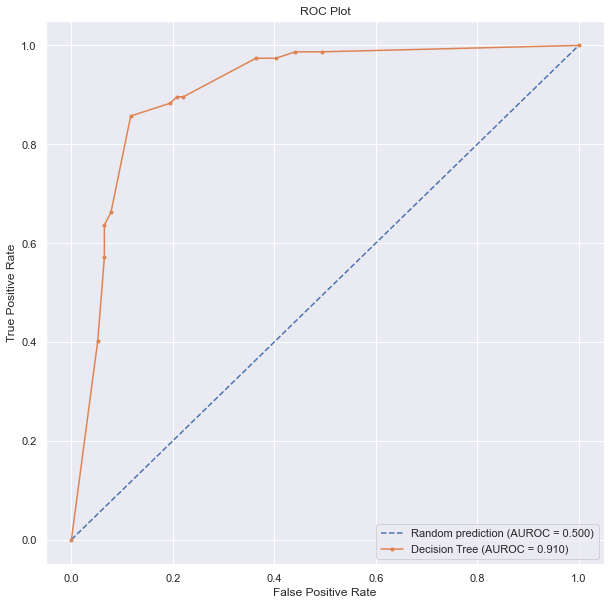

In [36]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
r_probs = [0 for _ in range(len(Y_test))]
LiverTree_probs = LiverTree.predict_proba(X_test)
LiverTree_probs = LiverTree_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverTree_auc = roc_auc_score(Y_test, LiverTree_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('Decision Tree: AUROC = %.3f' % (LiverTree_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverTree_fpr, LiverTree_tpr, _ = roc_curve(Y_test, LiverTree_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverTree_fpr, LiverTree_tpr, marker='.', label='Decision Tree (AUROC = %0.3f)' % LiverTree_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

In [37]:
import shap
explainer = shap.TreeExplainer(LiverTree)
shap_values_train = explainer.shap_values(X_train)
shap.force_plot(explainer.expected_value[0], shap_values_train[0], X_train)

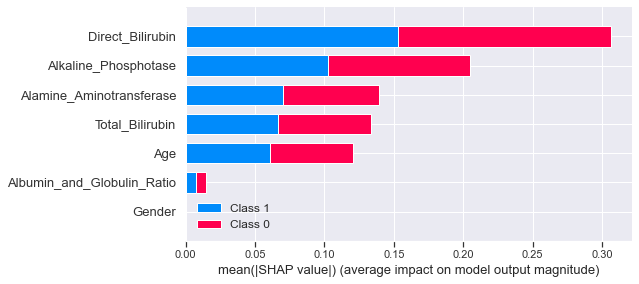

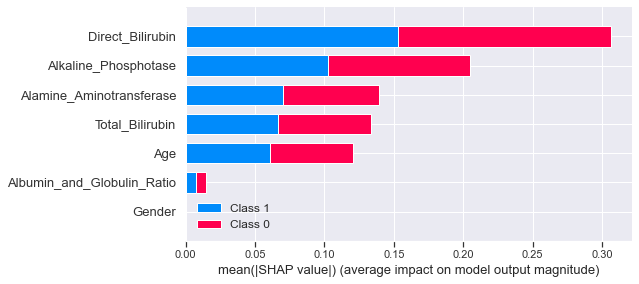

In [38]:
shap.summary_plot(shap_values_train, X_train, plot_type="bar",max_display=7)
#CARmodel_shap_values = shap.KernelExplainer(CARmodel.predict,X_test)
#CARmodel_shap_values.summary_plot(CARmodel_shap_values, X_test)
shap.summary_plot(shap_values_train,X_train,max_display=7)
# feature_names=list(X_test.columns)
# shap.summary_plot(shap_values_test, feature_names, plot_type="bar",max_display=23)
# shap.summary_plot(shap_values_test, feature_names,max_display=23)

In [39]:
Y_test

537    1
384    1
480    0
501    0
7      0
256    0
611    1
725    1
601    1
408    1
556    1
280    0
429    1
351    0
365    0
748    1
273    0
616    1
31     1
33     1
708    1
52     0
230    1
123    0
40     0
270    1
521    0
698    1
663    1
158    0
744    1
690    1
345    1
305    0
446    1
415    0
100    1
721    1
354    0
565    1
161    0
753    1
524    0
612    1
505    0
360    0
479    0
228    0
278    1
64     0
122    0
146    0
469    0
8      1
372    1
467    0
691    1
678    1
574    1
0      0
138    0
148    0
255    1
364    1
724    1
197    0
656    1
393    0
463    1
140    0
617    1
63     0
187    1
344    0
614    1
363    0
533    1
406    0
526    0
562    1
258    0
11     0
72     0
172    0
740    1
119    0
435    0
735    1
142    0
375    1
516    0
318    1
681    1
460    0
144    0
483    0
499    0
77     1
485    0
137    0
432    0
324    1
404    0
472    0
93     0
282    1
264    0
661    1
87     0
217    0
213    1
6

In [40]:
# plot the SHAP values for the 10th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values2=explainer.shap_values(X_test.iloc[0,:]) # First Row of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values2[1], X_test.iloc[0,:])

In [49]:
# plot the SHAP values for the 10th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values2=explainer.shap_values(X_test.iloc[13,:]) # First Row of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values2[1], X_test.iloc[13,:])

In [50]:
import eli5
from eli5.sklearn import PermutationImportance
perm = PermutationImportance(LiverTree, scoring='balanced_accuracy',n_iter=20,random_state=2644).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1929 ± 0.0659,Alkaline_Phosphotase
0.1295 ± 0.0371,Direct_Bilirubin
0.1240 ± 0.0432,Total_Bilirubin
0.0763 ± 0.0348,Alamine_Aminotransferase
0.0494 ± 0.0317,Age
0.0088 ± 0.0074,Albumin_and_Globulin_Ratio
0 ± 0.0000,Gender


eli5 Permutation Feature Importance:


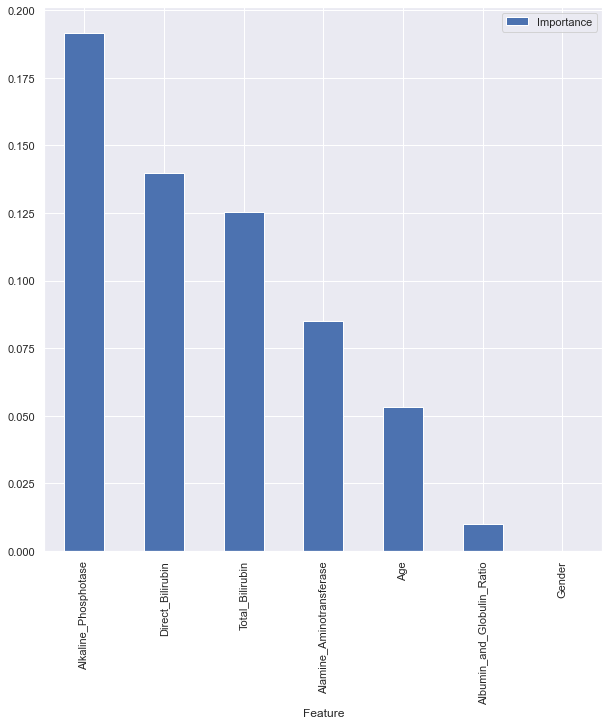

In [51]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df

perm = PermutationImportance(LiverTree, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [52]:
print(Label.unique())
Class_names = ["Good","Bad"]
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
from IPython.display import display
display(eli5.show_weights(LiverTree,top=None,feature_names=feature_names,target_names=Class_names))

[0 1]


Weight,Feature
0.3878,Direct_Bilirubin
0.1907,Alkaline_Phosphotase
0.1647,Alamine_Aminotransferase
0.1348,Total_Bilirubin
0.0993,Age
0.0227,Albumin_and_Globulin_Ratio
0,Gender


In [53]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 0 # 1st row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverTree, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

537    1
Name: Dataset, dtype: int64


In [54]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 13 # 1st row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverTree, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

351    0
Name: Dataset, dtype: int64


In [55]:
import lime
import lime.lime_tabular
feature_names=list(X_train.columns)
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=115,mode='classification')

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 0 # 2nd row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverTree.predict_proba)
exp.show_in_notebook(show_table=True)

537    1
Name: Dataset, dtype: int64


In [56]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 13 # 2nd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverTree.predict_proba)
exp.show_in_notebook(show_table=True)

351    0
Name: Dataset, dtype: int64


# Random Forest Classifier using Bagging (Forest of indivisual decision trees)

In [351]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

In [399]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Train_Score:',LiverForest.score(X_train,Y_train))
print('Test_Score:',LiverForest.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverForest.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverForest.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverForest.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverForest.predict(X_test)))
print(classification_report(Y_test,LiverForest.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverForest.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverForest.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

Train_Score: 0.8305084745762712
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.833935561577838
Recall_Score: 0.9024390243902439
Precision_Score: 0.7956989247311828
              precision    recall  f1-score   support

           0       0.89      0.77      0.82        81
           1       0.80      0.90      0.85        82

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.84      0.83      0.83       163

The Log Loss on Training is:  0.39510790304719934
The Log Loss on Testing is:  0.44545043397821704


In [ ]:
# For loop to check ideal sample that will give generalized model
#Test1
import numpy
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]

X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=i).fit(X_train,Y_train)
LiverForest = BaggingClassifier(LiverTree, n_estimators=2000, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
train_score=LiverForest.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
test_score=LiverForest.score(X_test,Y_test)
Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverForest.predict(X_test))
if test_score > train_score:
    print("Test: {} Train: {} Balanced_Accuracy: {} ccp_alpha: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

In [113]:
# For loop to check ideal sample that will give generalized model
#Test1
import numpy
from sklearn.metrics import balanced_accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Albumin_and_Globulin_Ratio', 'Gender']]
CCP = numpy.geomspace(0.0149,0.9,num=300)
for i in CCP:
    X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=88)
    LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=i).fit(X_train,Y_train)
    LiverForest = BaggingClassifier(LiverTree, n_estimators=2000, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
    train_score=LiverForest.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverForest.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverForest.predict(X_test))
    if test_score > train_score:
        print("Test: {} Train: {} Balanced_Accuracy: {} ccp_alpha: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8311688311688312 Train: 0.8300653594771242 Balanced_Accuracy: 0.8311688311688312 ccp_alpha: 0.015105773839680835
Test: 0.8311688311688312 Train: 0.8284313725490197 Balanced_Accuracy: 0.8311688311688312 ccp_alpha: 0.015314389482925234
Test: 0.8311688311688312 Train: 0.826797385620915 Balanced_Accuracy: 0.8311688311688312 ccp_alpha: 0.015525886175963443


KeyboardInterrupt: 

In [4]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.0150469)
LiverForest = BaggingClassifier(LiverTree, n_estimators=2000, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Train_Score:',LiverForest.score(X_train,Y_train))
print('Test_Score:',LiverForest.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverForest.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverForest.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverForest.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverForest.predict(X_test)))
print(classification_report(Y_test,LiverForest.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverForest.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverForest.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

Train_Score: 0.8300653594771242
Test_Score: 0.8311688311688312
Balanced_Accuracy_Score: 0.8311688311688312
Recall_Score: 0.8961038961038961
Precision_Score: 0.7931034482758621
              precision    recall  f1-score   support

           0       0.88      0.77      0.82        77
           1       0.79      0.90      0.84        77

    accuracy                           0.83       154
   macro avg       0.84      0.83      0.83       154
weighted avg       0.84      0.83      0.83       154

The Log Loss on Training is:  0.36164321661287174
The Log Loss on Testing is:  0.42718158948933826


Drop-Col Feature Importance:
                            Importance
Feature                               
Alkaline_Phosphotase          0.058442
Alamine_Aminotransferase      0.045455
Age                           0.038961
Total_Bilirubin               0.012987
Direct_Bilirubin              0.006494
Albumin_and_Globulin_Ratio    0.006494
Gender                        0.006494


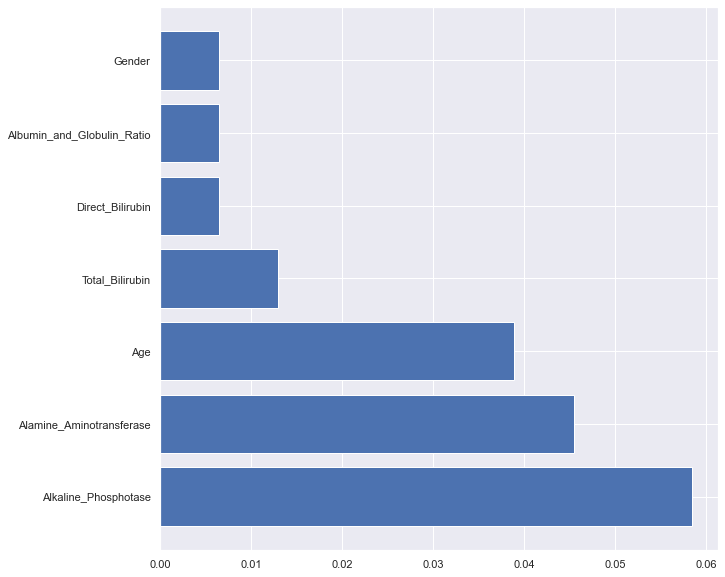

Train_Score: 0.8300653594771242
Test_Score: 0.8311688311688312
Balanced_Accuracy_Score: 0.8311688311688312
Recall_Score: 0.8961038961038961
Precision_Score: 0.7931034482758621
              precision    recall  f1-score   support

           0       0.88      0.77      0.82        77
           1       0.79      0.90      0.84        77

    accuracy                           0.83       154
   macro avg       0.84      0.83      0.83       154
weighted avg       0.84      0.83      0.83       154

The Log Loss on Training is:  0.36164321661287174
The Log Loss on Testing is:  0.42718158948933826


In [114]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase',  
       'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=88)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.0150469).fit(X_train,Y_train)
LiverForest = BaggingClassifier(LiverTree, n_estimators=2000, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverForest, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverForest, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=88)
LiverTree = DecisionTreeClassifier(criterion='entropy',class_weight='balanced',random_state=999,ccp_alpha=0.0150469).fit(X_train,Y_train)
LiverForest = BaggingClassifier(LiverTree, n_estimators=2000, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Train_Score:',LiverForest.score(X_train,Y_train))
print('Test_Score:',LiverForest.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverForest.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverForest.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverForest.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverForest.predict(X_test)))
print(classification_report(Y_test,LiverForest.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverForest.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverForest.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

In [441]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Train_Score:',LiverForest.score(X_train,Y_train))
print('Test_Score:',LiverForest.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverForest.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverForest.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverForest.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverForest.predict(X_test)))
print(classification_report(Y_test,LiverForest.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverForest.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverForest.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

Train_Score: 0.8305084745762712
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.833935561577838
Recall_Score: 0.9024390243902439
Precision_Score: 0.7956989247311828
              precision    recall  f1-score   support

           0       0.89      0.77      0.82        81
           1       0.80      0.90      0.85        82

    accuracy                           0.83       163
   macro avg       0.84      0.83      0.83       163
weighted avg       0.84      0.83      0.83       163

The Log Loss on Training is:  0.39510790304719934
The Log Loss on Testing is:  0.44545043397821704


Drop-Col Feature Importance:
                            Importance
Feature                               
Alamine_Aminotransferase      0.030864
Age                           0.030714
Total_Bilirubin               0.024917
Direct_Bilirubin              0.012346
Alkaline_Phosphotase          0.012346
Aspartate_Aminotransferase    0.012346
Total_Protiens                0.012346
Albumin_and_Globulin_Ratio    0.012346
Albumin                       0.012270


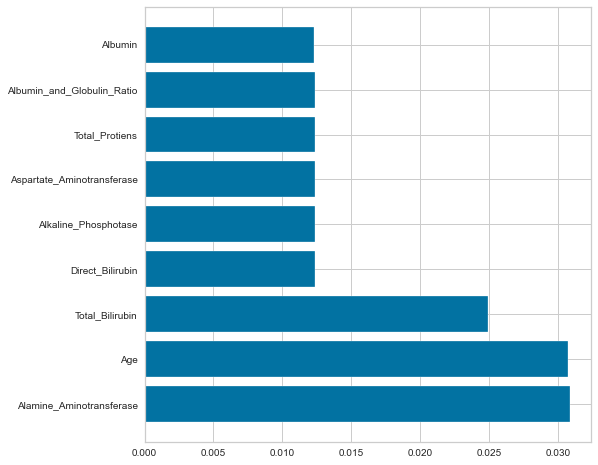

Train_Score: 0.8335901386748844
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8401084010840109
Recall_Score: 0.9024390243902439
Precision_Score: 0.8043478260869565
              precision    recall  f1-score   support

           0       0.89      0.78      0.83        81
           1       0.80      0.90      0.85        82

    accuracy                           0.84       163
   macro avg       0.85      0.84      0.84       163
weighted avg       0.85      0.84      0.84       163

The Log Loss on Training is:  0.3949818811199952
The Log Loss on Testing is:  0.44756540740791795


In [443]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=1973)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverTree = DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999).fit(X_train,Y_train)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverForest, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverForest, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999).fit(X_train,Y_train)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Train_Score:',LiverForest.score(X_train,Y_train))
print('Test_Score:',LiverForest.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverForest.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverForest.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverForest.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverForest.predict(X_test)))
print(classification_report(Y_test,LiverForest.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverForest.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverForest.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

# Final & best Random Forest Model for Liver Desease

In [449]:
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']]
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=1973)
LiverTree = DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
print('Train_Score:',LiverForest.score(X_train,Y_train))
print('Test_Score:',LiverForest.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverForest.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverForest.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverForest.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverForest.predict(X_test)))
print(classification_report(Y_test,LiverForest.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverForest.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverForest.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

Train_Score: 0.8335901386748844
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8401084010840109
Recall_Score: 0.9024390243902439
Precision_Score: 0.8043478260869565
              precision    recall  f1-score   support

           0       0.89      0.78      0.83        81
           1       0.80      0.90      0.85        82

    accuracy                           0.84       163
   macro avg       0.85      0.84      0.84       163
weighted avg       0.85      0.84      0.84       163

The Log Loss on Training is:  0.3949818811199952
The Log Loss on Testing is:  0.44756540740791795


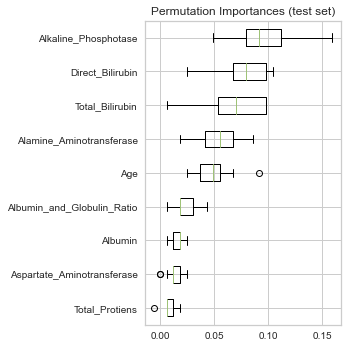

In [450]:
rcParams['figure.figsize'] = [5, 5]
from sklearn.inspection import permutation_importance
result = permutation_importance(LiverForest, X_test, Y_test, n_repeats=20,
                                random_state=999)
sorted_idx = result.importances_mean.argsort()

fig, ax = pyplot.subplots()
ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X_test.columns[sorted_idx])
ax.set_title("Permutation Importances (test set)")
fig.tight_layout()
pyplot.show()

In [451]:
LiverTree = DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
clf = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True).fit(X_train,Y_train)
result = permutation_importance(clf, X_train, Y_train, n_repeats=20,
                                random_state=999)
perm_sorted_idx = result.importances_mean.argsort()

tree_importance_sorted_idx = np.argsort(clf.feature_importances_)
tree_indices = np.arange(0, len(clf.feature_importances_)) + 0.5

fig, (ax1, ax2) = pyplot.subplots(1, 2, figsize=(12, 8))
ax1.barh(tree_indices,
         clf.feature_importances_[tree_importance_sorted_idx], height=0.7)
ax1.set_yticks(tree_indices)
ax1.set_yticklabels(X_train.columns[tree_importance_sorted_idx])
ax1.set_ylim((0, len(clf.feature_importances_)))
ax2.boxplot(result.importances[perm_sorted_idx].T, vert=False,
            labels=X_train.columns[perm_sorted_idx])
fig.tight_layout()
pyplot.show()

AttributeError: 'BaggingClassifier' object has no attribute 'feature_importances_'

In [452]:
# Visualizing Random State of Each Tree
LiverForest.estimators_, len(LiverForest.estimators_)

([DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=1276550613),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=1857334363),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=1032796505),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=1265280238),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=944334302),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=170919106),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=584413037),
  DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=15,
                         random_state=250819915),
  DecisionTreeClassifier(class_weight='balan

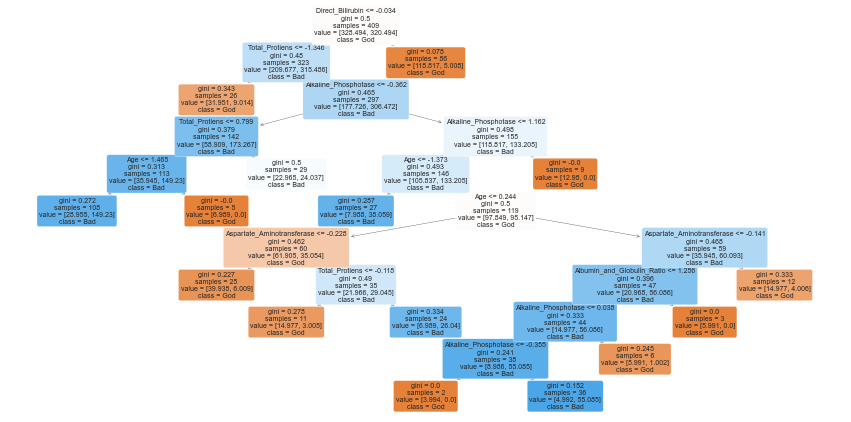

In [458]:
# Visualizing the 8th Tree of the Random Forest
from sklearn import tree
from sklearn.tree import plot_tree
figure(figsize=(15,7.5))
tree.plot_tree(LiverForest.estimators_[29],
          filled=True,
          rounded=True,
          class_names=["God", "Bad"],
          feature_names=SFFS1.columns);

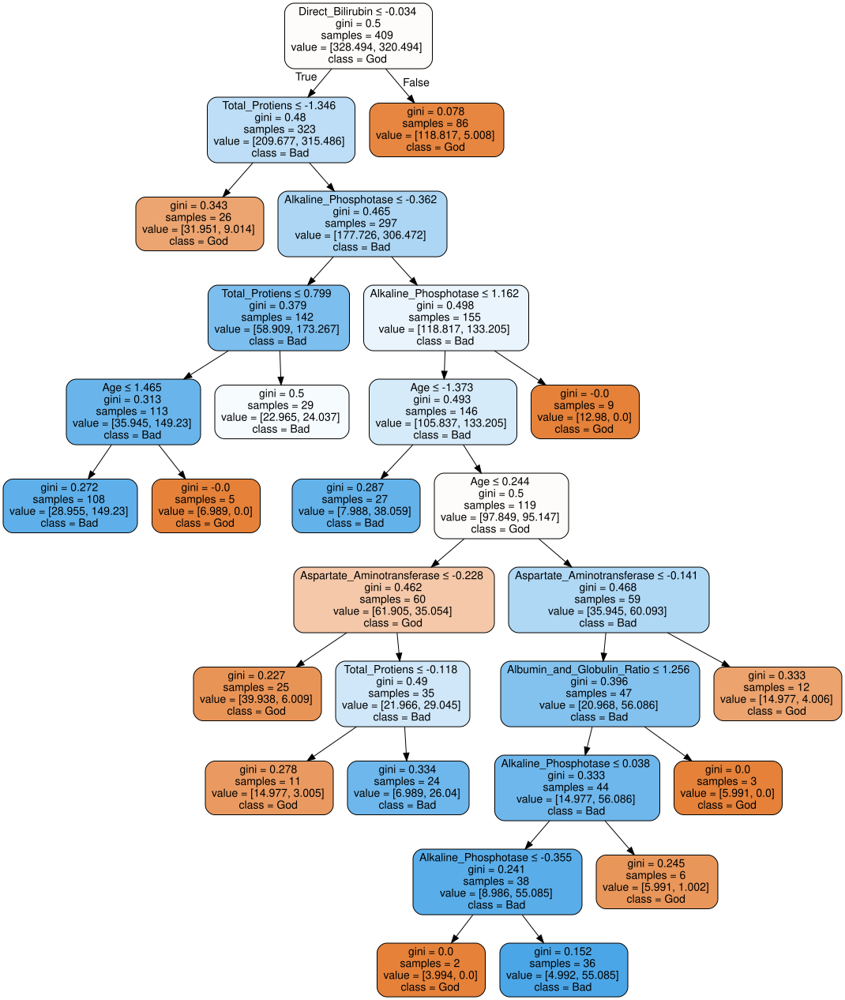

In [459]:
import graphviz
dot_data = tree.export_graphviz(LiverForest.estimators_[29], out_file=None, 
                                feature_names=SFFS1.columns,  
                                class_names=["God", "Bad"],  
                                filled=True, rounded=True,  
                                special_characters=True)  
graph = graphviz.Source(dot_data)  
graph 

In [460]:
# Visualizing Random Forest Diagram
for i in range(len(LiverForest.estimators_)):
      print(tree.export_text(LiverForest.estimators_[i]))

|--- feature_2 <= -0.04
|   |--- feature_3 <= -0.26
|   |   |--- feature_2 <= -0.43
|   |   |   |--- class: 0
|   |   |--- feature_2 >  -0.43
|   |   |   |--- feature_1 <= -0.18
|   |   |   |   |--- feature_1 <= -0.34
|   |   |   |   |   |--- feature_3 <= -0.57
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- feature_3 >  -0.57
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |--- feature_1 >  -0.34
|   |   |   |   |   |--- feature_2 <= -0.39
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- feature_2 >  -0.39
|   |   |   |   |   |   |--- class: 1
|   |   |   |--- feature_1 >  -0.18
|   |   |   |   |--- feature_6 <= -0.55
|   |   |   |   |   |--- class: 1
|   |   |   |   |--- feature_6 >  -0.55
|   |   |   |   |   |--- class: 0
|   |--- feature_3 >  -0.26
|   |   |--- feature_0 <= -0.98
|   |   |   |--- feature_4 <= 0.59
|   |   |   |   |--- class: 1
|   |   |   |--- feature_4 >  0.59
|   |   |   |   |--- class: 0
|   |   |--- feature_0 >  -0.98
|   |   

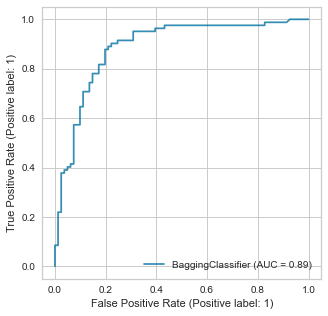

In [461]:
from matplotlib import pyplot
from sklearn.metrics import plot_roc_curve
#rfc = RandomForestClassifier(n_estimators = 450, criterion = 'entropy', random_state = 15).fit(X_train, Y_train)
ax = pyplot.gca()
LiverForest_disp = plot_roc_curve(LiverForest, X_test, Y_test, ax=ax, alpha=0.8)
#svc_disp.plot(ax=ax, alpha=0.8)
pyplot.show()

Random (chance) Prediction: AUROC = 0.500
Random Forest: AUROC = 0.887


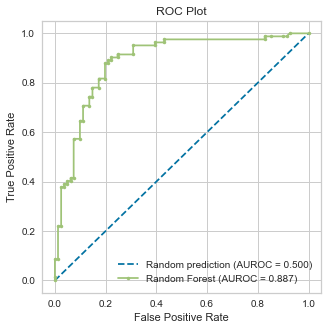

In [462]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
r_probs = [0 for _ in range(len(Y_test))]
LiverForest_probs = LiverForest.predict_proba(X_test)
LiverForest_probs = LiverForest_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverForest_auc = roc_auc_score(Y_test, LiverForest_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('Random Forest: AUROC = %.3f' % (LiverForest_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverForest_fpr, LiverForest_tpr, _ = roc_curve(Y_test, LiverForest_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverForest_fpr, LiverForest_tpr, marker='.', label='Random Forest (AUROC = %0.3f)' % LiverForest_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

In [463]:
# https://notebook.community/slundberg/shap/notebooks/tree_explainer/Front%20page%20example%20%28XGBoost%29
import shap
shap.initjs()
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=1973)
LiverTree=DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True)
LiverForest.fit(X_train, Y_train)

X_train_summary = shap.kmeans(X_train, 10)

explainer = shap.KernelExplainer(LiverForest.predict_proba, X_train_summary)
shap_values_all = explainer.shap_values(X_test) # Inserting Entire X_test Feature
# Force Plot of Entire Data
#shap.force_plot(CAR_explainer.expected_value[0],CAR_shap_values[0],X_test)
shap.force_plot(explainer.expected_value[0], shap_values_all[0], X_test, link='identity')

  0%|          | 0/163 [00:00<?, ?it/s]

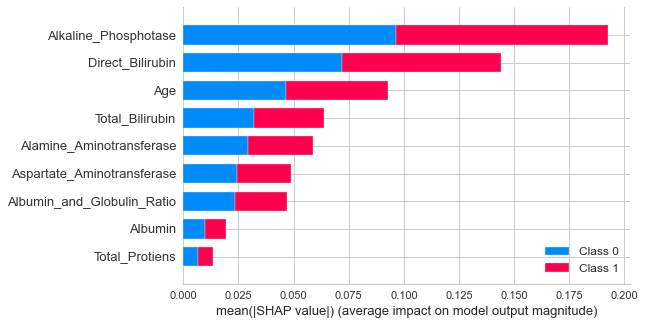

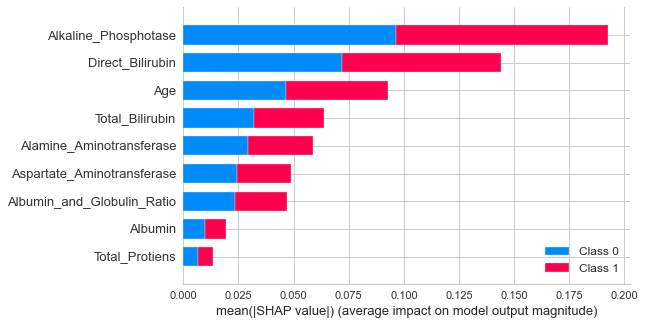

In [464]:
# Feature Importance upon Testing Data
# shap.summary_plot(Titanic_shap_values, X_train, plot_type="bar")
# shap.summary_plot(Titanic_shap_values, X_train)
#feature_names=list(X_train.columns)
shap.summary_plot(shap_values_all, X_test, plot_type="bar")
shap.summary_plot(shap_values_all, X_test,)

In [465]:
Y_test

53     1
374    0
331    1
411    0
783    1
295    0
18     0
690    1
501    0
398    1
40     0
141    1
507    0
682    1
231    0
798    1
192    0
23     1
282    0
11     0
267    0
759    1
329    1
133    0
800    1
598    1
387    1
782    1
527    1
28     0
481    0
601    1
640    1
274    1
242    0
164    0
62     0
383    0
639    1
536    0
93     0
148    0
573    1
562    0
122    0
225    1
434    0
456    0
246    0
779    1
424    0
353    1
606    1
419    0
661    1
686    1
112    0
86     0
597    1
574    1
644    1
3      0
247    0
49     0
157    0
293    0
706    1
742    1
318    0
605    1
556    0
568    0
611    1
451    1
168    0
806    1
678    1
4      0
377    0
691    1
29     0
125    1
634    1
299    1
802    1
647    1
344    0
753    1
403    0
695    1
181    1
744    1
494    0
371    0
422    1
347    0
22     0
319    0
183    0
721    1
405    0
469    0
654    1
95     1
7      0
541    0
130    0
614    1
236    0
604    1
659    1
4

In [466]:
# plot the SHAP values for the 10th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values2=explainer.shap_values(X_test.iloc[7,:]) # First Row of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values2[1], X_test.iloc[7,:])

In [472]:
# plot the SHAP values for the 10th observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values2=explainer.shap_values(X_test.iloc[10,:]) # First Row of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values2[1], X_test.iloc[10,:])

In [476]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=1973)
LiverTree=DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True)
LiverForest.fit(X_train, Y_train)
 #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverForest, scoring='balanced_accuracy',n_iter=20,random_state=2644).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.0934 ± 0.0466,Alkaline_Phosphotase
0.0792 ± 0.0389,Direct_Bilirubin
0.0745 ± 0.0393,Total_Bilirubin
0.0514 ± 0.0265,Age
0.0454 ± 0.0318,Alamine_Aminotransferase
0.0259 ± 0.0251,Albumin_and_Globulin_Ratio
0.0169 ± 0.0145,Albumin
0.0120 ± 0.0126,Aspartate_Aminotransferase
0.0108 ± 0.0116,Total_Protiens


eli5 Permutation Feature Importance:


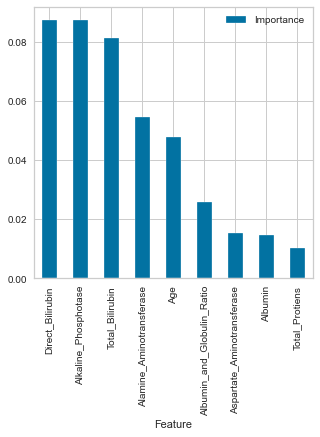

In [475]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=1973)
LiverTree=DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True)
LiverForest.fit(X_train, Y_train)
perm = PermutationImportance(LiverForest, scoring='balanced_accuracy', n_iter=20, random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [477]:
# Load our pkgs
print(Label.unique())
Class_names = ["Good","Bad"]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=1973)
LiverTree=DecisionTreeClassifier(criterion='gini',max_leaf_nodes=15,class_weight='balanced',random_state=999)
LiverForest = BaggingClassifier(LiverTree, n_estimators=200, max_samples=1.0, random_state=999, oob_score=True)
LiverForest.fit(X_train, Y_train)
import lime
import lime.lime_tabular
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1,Label,stratify=Label,test_size=0.20,random_state=1973)
feature_names=list(X_train.columns)
Limeexplainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=115,mode='classification')

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 7 # 2nd row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = Limeexplainer.explain_instance(X_test.iloc[i],LiverForest.predict_proba)
exp.show_in_notebook(show_table=True)

[0 1]
690    1
Name: Dataset, dtype: int64


In [478]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 10 # 2nd row input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = Limeexplainer.explain_instance(X_test.iloc[i],LiverForest.predict_proba)
exp.show_in_notebook(show_table=True)

40    0
Name: Dataset, dtype: int64


# AdaBoostClassifier (Forest of Stumps)

In [3]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

In [18]:
# For loop to check ideal sample that will give generalized model
#Test1
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverAdaB=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=1500, random_state=999, learning_rate=1.0, algorithm='SAMME.R').fit(X_train,Y_train)
    train_score=LiverAdaB.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverAdaB.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverAdaB.predict(X_test))
    if test_score > 0.79:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.7914110429447853 Train: 1.0 Balanced_Accuracy: 0.7914031918096959 RandomState: 6
Test: 0.803680981595092 Train: 0.9984591679506933 Balanced_Accuracy: 0.8040499849442939 RandomState: 11
Test: 0.7914110429447853 Train: 1.0 Balanced_Accuracy: 0.7913279132791329 RandomState: 12
Test: 0.803680981595092 Train: 1.0 Balanced_Accuracy: 0.8035983137609153 RandomState: 18
Test: 0.7914110429447853 Train: 0.9984591679506933 Balanced_Accuracy: 0.7913279132791329 RandomState: 26
Test: 0.7914110429447853 Train: 0.9984591679506933 Balanced_Accuracy: 0.7917043059319482 RandomState: 31
Test: 0.8343558282208589 Train: 1.0 Balanced_Accuracy: 0.8343872327612165 RandomState: 40
Test: 0.7975460122699386 Train: 1.0 Balanced_Accuracy: 0.7973501957241794 RandomState: 44
Test: 0.7914110429447853 Train: 1.0 Balanced_Accuracy: 0.7912526347485697 RandomState: 52
Test: 0.7914110429447853 Train: 1.0 Balanced_Accuracy: 0.791553748870822 RandomState: 67
Test: 0.803680981595092 Train: 1.0 Balanced_Accuracy: 0.803

Test: 0.7914110429447853 Train: 1.0 Balanced_Accuracy: 0.791478470340259 RandomState: 1046
Test: 0.7975460122699386 Train: 0.9984591679506933 Balanced_Accuracy: 0.7975007527853056 RandomState: 1077
Test: 0.7975460122699386 Train: 0.9984591679506933 Balanced_Accuracy: 0.7975760313158687 RandomState: 1084
Test: 0.803680981595092 Train: 0.9984591679506933 Balanced_Accuracy: 0.8034477566997892 RandomState: 1088
Test: 0.8098159509202454 Train: 0.9969183359013868 Balanced_Accuracy: 0.8099969888587775 RandomState: 1093
Test: 0.7975460122699386 Train: 1.0 Balanced_Accuracy: 0.7976513098464317 RandomState: 1104
Test: 0.7914110429447853 Train: 0.9953775038520801 Balanced_Accuracy: 0.7911773562180067 RandomState: 1151
Test: 0.803680981595092 Train: 1.0 Balanced_Accuracy: 0.8037488708220415 RandomState: 1153
Test: 0.8098159509202454 Train: 1.0 Balanced_Accuracy: 0.8099969888587775 RandomState: 1167
Test: 0.8098159509202454 Train: 1.0 Balanced_Accuracy: 0.8098464317976513 RandomState: 1169
Test: 0.

Test: 0.8282208588957055 Train: 0.9984591679506933 Balanced_Accuracy: 0.8282896717856068 RandomState: 2087
Test: 0.803680981595092 Train: 0.9984591679506933 Balanced_Accuracy: 0.8036735922914785 RandomState: 2120
Test: 0.803680981595092 Train: 1.0 Balanced_Accuracy: 0.8037488708220415 RandomState: 2121


KeyboardInterrupt: 

In [ ]:
1248,100,549,

In [5]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=1248)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=1500, random_state=999, learning_rate=1.0, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverAdab2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8405600722673894
Recall_Score: 0.8518518518518519
Precision_Score: 0.8313253012048193
              precision    recall  f1-score   support

           0       0.85      0.83      0.84        82
           1       0.83      0.85      0.84        81

    accuracy                           0.84       163
   macro avg       0.84      0.84      0.84       163
weighted avg       0.84      0.84      0.84       163

The Log Loss on Training is:  0.6882129565287609
The Log Loss on Testing is:  0.6882338198456313


In [6]:
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=100)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=1500, random_state=999, learning_rate=1.0, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverAdab2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 0.9984591679506933
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8404095152062632
Recall_Score: 0.8271604938271605
Precision_Score: 0.8481012658227848
              precision    recall  f1-score   support

           0       0.83      0.85      0.84        82
           1       0.85      0.83      0.84        81

    accuracy                           0.84       163
   macro avg       0.84      0.84      0.84       163
weighted avg       0.84      0.84      0.84       163

The Log Loss on Training is:  0.6891499724329719
The Log Loss on Testing is:  0.6898084055890503


In [11]:
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=1500, random_state=999, learning_rate=1.0, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverAdab2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8404847937368263
Recall_Score: 0.8395061728395061
Precision_Score: 0.8395061728395061
              precision    recall  f1-score   support

           0       0.84      0.84      0.84        82
           1       0.84      0.84      0.84        81

    accuracy                           0.84       163
   macro avg       0.84      0.84      0.84       163
weighted avg       0.84      0.84      0.84       163

The Log Loss on Training is:  0.6882189439273919
The Log Loss on Testing is:  0.6888344158768293


Drop-Col Feature Importance:
                            Importance
Feature                               
Albumin_and_Globulin_Ratio    0.036736
Aspartate_Aminotransferase    0.024691
Age                           0.024616
Total_Bilirubin               0.024616
Total_Protiens                0.024541
Alamine_Aminotransferase      0.012346
Alkaline_Phosphotase          0.012270
Albumin                       0.006173
Direct_Bilirubin              0.006098
Gender                        0.000000


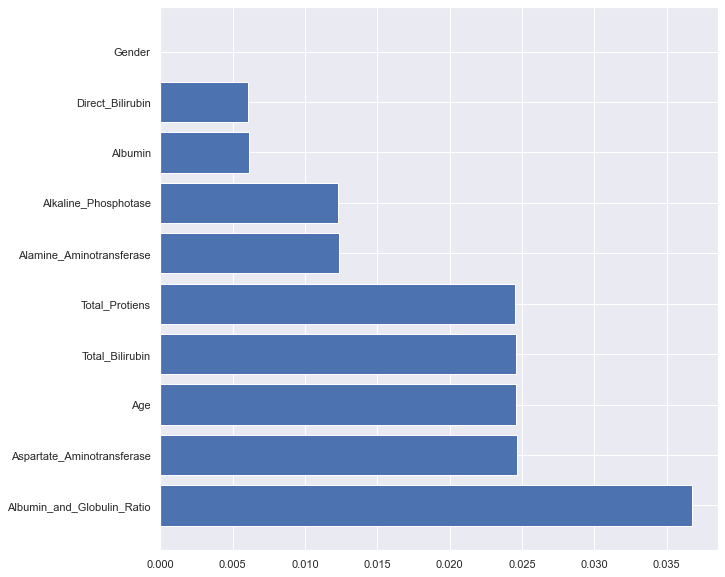

Train_Score: 1.0
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8404847937368263
Recall_Score: 0.8395061728395061
Precision_Score: 0.8395061728395061
              precision    recall  f1-score   support

           0       0.84      0.84      0.84        82
           1       0.84      0.84      0.84        81

    accuracy                           0.84       163
   macro avg       0.84      0.84      0.84       163
weighted avg       0.84      0.84      0.84       163

The Log Loss on Training is:  0.6882189439273919
The Log Loss on Testing is:  0.6888344158768293


In [63]:
from matplotlib import pyplot
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=549)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=1500, random_state=999, learning_rate=1.0, algorithm='SAMME.R').fit(X_train,Y_train)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverAdab, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverAdab, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=1500, random_state=999, learning_rate=1.0, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

In [54]:
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverAdab2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 1483

Train_Score: 0.7750385208012327
Test_Score: 0.7914110429447853
Balanced_Accuracy_Score: 0.7919301415236375
Recall_Score: 0.8765432098765432
Precision_Score: 0.7473684210526316
              precision    recall  f1-score   support

           0       0.85      0.71      0.77        82
           1       0.75      0.88      0.81        81

    accuracy                           0.79       163
   macro avg       0.80      0.79      0.79       163
weighted avg       0.80      0.79      0.79       163

The Log Loss on Training is:  0.6366255762667618
The Log Loss on Testing is:  0.6377086941079982


In [60]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Total_Bilirubin               0.037112
Albumin_and_Globulin_Ratio    0.030714
Age                           0.024466
Alkaline_Phosphotase          0.024315
Alamine_Aminotransferase      0.018519
Total_Protiens                0.006173
Gender                        0.006098
Aspartate_Aminotransferase    0.000000
Albumin                       0.000000


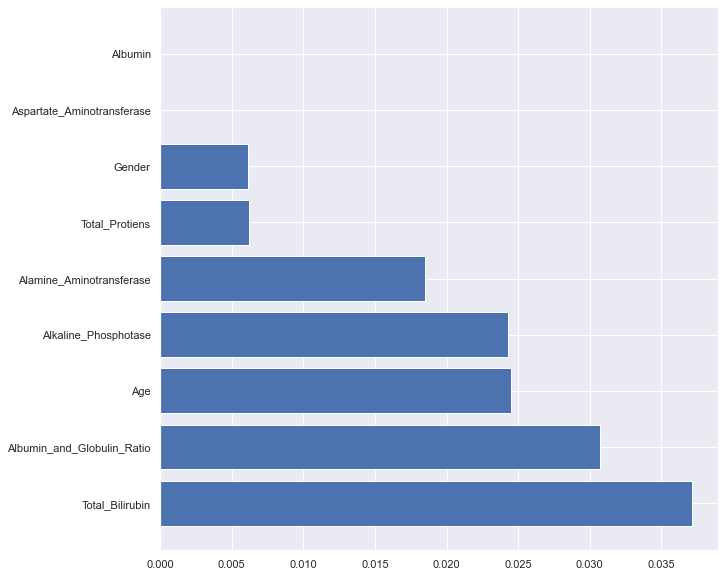

Train_Score: 0.7688751926040062
Test_Score: 0.8098159509202454
Balanced_Accuracy_Score: 0.8101475459199037
Recall_Score: 0.8641975308641975
Precision_Score: 0.7777777777777778
              precision    recall  f1-score   support

           0       0.85      0.76      0.80        82
           1       0.78      0.86      0.82        81

    accuracy                           0.81       163
   macro avg       0.81      0.81      0.81       163
weighted avg       0.81      0.81      0.81       163

The Log Loss on Training is:  0.6378207535923166
The Log Loss on Testing is:  0.6365524700700075


In [64]:
from matplotlib import pyplot
SFFS1=Features[['Age', 'Total_Bilirubin',  'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=549)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverAdab, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverAdab, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

In [68]:
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
SFFS1=Features[['Age', 'Total_Bilirubin',  'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
print('Train_Score:',LiverAdab.score(X_train,Y_train))
print('Test_Score:',LiverAdab.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverAdab.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverAdab.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverAdab.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverAdab.predict(X_test)))
print(classification_report(Y_test,LiverAdab.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverAdab2.predict(X_train)
Predicted_Proba_Y = LiverAdab.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverAdab.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 1483

Train_Score: 0.7688751926040062
Test_Score: 0.8098159509202454
Balanced_Accuracy_Score: 0.8101475459199037
Recall_Score: 0.8641975308641975
Precision_Score: 0.7777777777777778
              precision    recall  f1-score   support

           0       0.85      0.76      0.80        82
           1       0.78      0.86      0.82        81

    accuracy                           0.81       163
   macro avg       0.81      0.81      0.81       163
weighted avg       0.81      0.81      0.81       163

The Log Loss on Training is:  0.6378207535923166
The Log Loss on Testing is:  0.6365524700700075


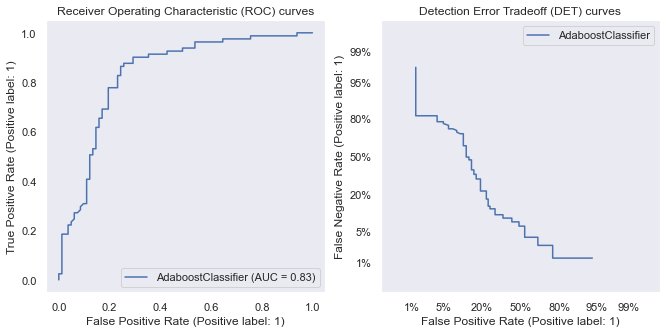

In [69]:
# prepare plots
from sklearn.metrics import plot_det_curve, plot_roc_curve
fig, [ax_roc, ax_det] = pyplot.subplots(1, 2, figsize=(11, 5))
plot_roc_curve(LiverAdab, X_test, Y_test, ax=ax_roc, name='AdaboostClassifier')
plot_det_curve(LiverAdab, X_test, Y_test, ax=ax_det, name='AdaboostClassifier')

ax_roc.set_title('Receiver Operating Characteristic (ROC) curves')
ax_det.set_title('Detection Error Tradeoff (DET) curves')

ax_roc.grid(linestyle='--')
ax_det.grid(linestyle='--')

pyplot.legend()
pyplot.show()

In [70]:
import shap
shap.initjs()
X_train_summary = shap.kmeans(X_train, 10)
explainer = shap.KernelExplainer(LiverAdab.predict_proba, X_train_summary)
shap_values_all = explainer.shap_values(X_test) # Inserting Entire X_test Feature
# Force Plot of Entire Data
#shap.force_plot(CAR_explainer.expected_value[0],CAR_shap_values[0],X_test)
shap.force_plot(explainer.expected_value[0], shap_values_all[0], X_test, link='identity')

  0%|          | 0/163 [00:00<?, ?it/s]

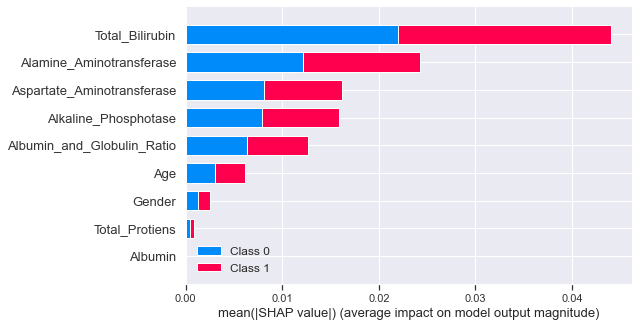

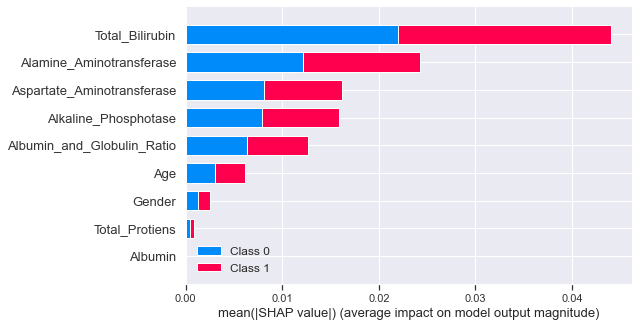

In [71]:
# Feature Importance upon Testing Data
# shap.summary_plot(Heart_shap_values, X_train, plot_type="bar")
# shap.summary_plot(Heart_shap_values, X_train)
#feature_names=list(X_train.columns)
shap.summary_plot(shap_values_all, X_test, plot_type="bar")
shap.summary_plot(shap_values_all, X_test,)

In [72]:
Y_test

49     0
297    0
283    0
244    0
580    1
67     0
259    0
372    0
671    1
461    1
64     1
399    0
705    1
291    0
128    0
151    0
325    0
107    1
369    0
380    0
217    1
578    1
233    0
742    1
493    0
750    1
123    0
37     0
790    1
522    0
503    0
321    0
215    1
720    1
726    1
62     0
345    0
806    1
576    1
73     1
378    0
330    0
26     1
292    1
319    0
65     0
119    0
411    0
571    1
662    1
773    1
476    1
10     0
117    1
353    1
731    1
728    1
795    1
665    1
370    1
74     0
787    1
302    1
180    0
752    1
231    0
147    0
532    1
357    0
739    1
777    1
150    0
464    0
612    1
754    1
305    0
756    1
783    1
452    1
197    0
388    0
645    1
368    0
135    0
740    1
641    1
690    1
112    0
647    1
626    1
364    1
717    1
374    0
527    1
264    0
477    0
376    0
269    0
440    0
514    0
320    1
313    1
721    1
781    1
175    0
516    0
582    1
735    1
25     0
496    0
9      0
8

In [77]:
# plot the SHAP values for the 3rd index observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values3=explainer.shap_values(X_test.iloc[0,:]) # 3rd Row index of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values3[1], X_test.iloc[0,:])

In [78]:
# plot the SHAP values for the 3rd index observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values3=explainer.shap_values(X_test.iloc[4,:]) # 3rd Row index of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values3[1], X_test.iloc[4,:])

eli5 Permutation Feature Importance:


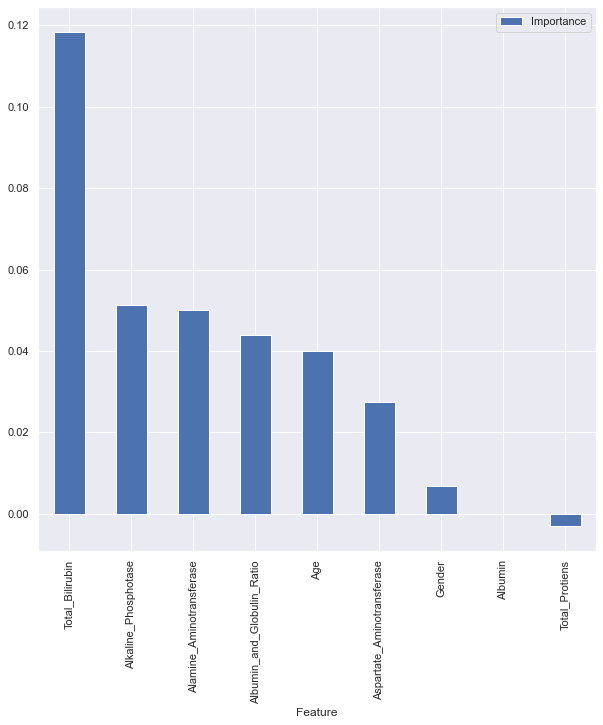

In [79]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
SFFS1=Features[['Age', 'Total_Bilirubin',  'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
perm = PermutationImportance(LiverAdab, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

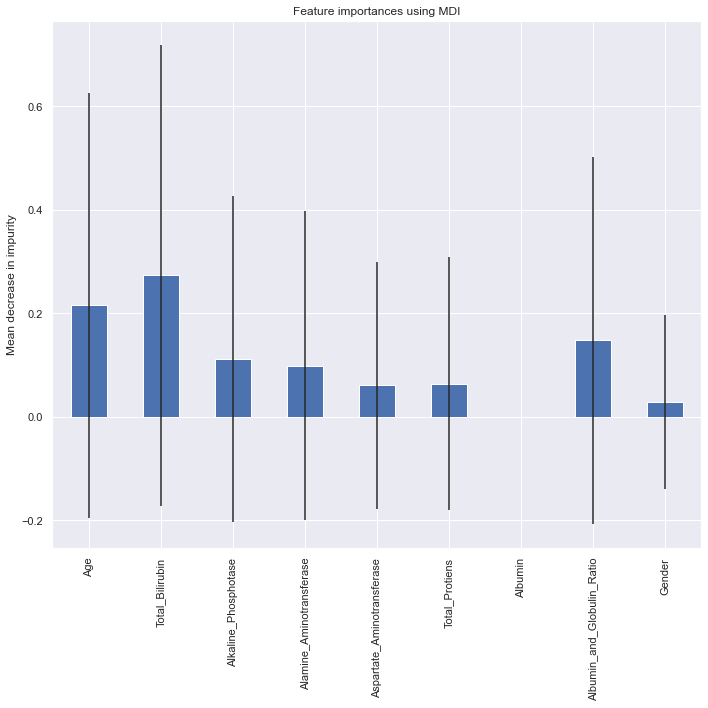

In [80]:
import numpy
importances = LiverAdab.feature_importances_
forest_importances = Series(importances, index=X_train.columns)
std = numpy.std([
    tree.feature_importances_ for tree in LiverAdab.estimators_], axis=0)
fig, ax = pyplot.subplots()
forest_importances.plot.bar(yerr=std, ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
fig.tight_layout()

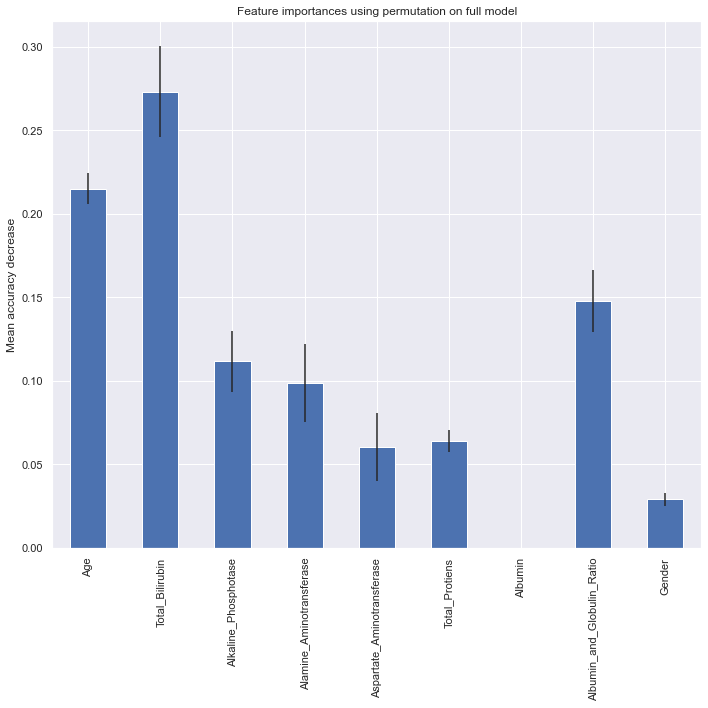

In [81]:
from sklearn.inspection import permutation_importance
result = permutation_importance(
    LiverAdab, X_test, Y_test, n_repeats=20, random_state=999)
fig, ax = pyplot.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
pyplot.show()

Random (chance) Prediction: AUROC = 0.500
AdaBoost: AUROC = 0.834


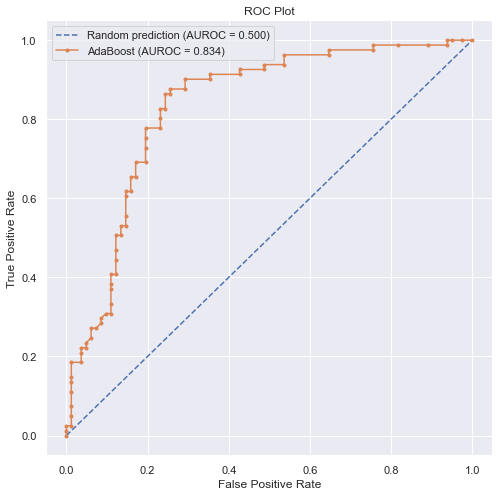

In [82]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
rcParams['figure.figsize'] = [8,8]
r_probs = [0 for _ in range(len(Y_test))]
LiverAdab_probs = LiverAdab.predict_proba(X_test)
LiverAdab_probs = LiverAdab_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverAdab_auc = roc_auc_score(Y_test, LiverAdab_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('AdaBoost: AUROC = %.3f' % (LiverAdab_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverAdab_fpr, LiverAdab_tpr, _ = roc_curve(Y_test, LiverAdab_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverAdab_fpr, LiverAdab_tpr, marker='.', label='AdaBoost (AUROC = %0.3f)' % LiverAdab_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

In [84]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance

X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
 #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverAdab, scoring='balanced_accuracy',n_iter=20,random_state=2644).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1255 ± 0.0443,Total_Bilirubin
0.0598 ± 0.0346,Alamine_Aminotransferase
0.0509 ± 0.0243,Albumin_and_Globulin_Ratio
0.0433 ± 0.0303,Alkaline_Phosphotase
0.0429 ± 0.0226,Age
0.0301 ± 0.0338,Aspartate_Aminotransferase
0.0080 ± 0.0110,Gender
0.0000 ± 0.0117,Total_Protiens
0 ± 0.0000,Albumin


eli5 Permutation Feature Importance:


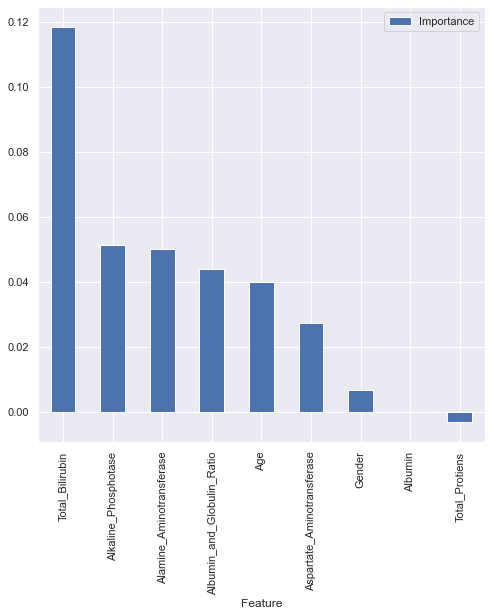

In [85]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)
perm = PermutationImportance(LiverAdab, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [86]:
# Load our pkgs
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=549)
LiverAdab=AdaBoostClassifier(DecisionTreeClassifier(max_depth=1,random_state=999),n_estimators=860, random_state=999, learning_rate=0.01115730870059814, algorithm='SAMME.R').fit(X_train,Y_train)

print(Label.unique())
Class_names = ["Good","Bad"]
feature_names = X_test.columns.tolist()
import lime
import lime.lime_tabular
feature_names=list(X_train.columns)
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=115,mode='classification')

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 0 # 3rd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverAdab.predict_proba)
exp.show_in_notebook(show_table=True)

[0 1]
49    0
Name: Dataset, dtype: int64


In [87]:
i = 4 # 3rd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverAdab.predict_proba)
exp.show_in_notebook(show_table=True)

580    1
Name: Dataset, dtype: int64


# GradientBoostingClassifier

In [3]:
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Features=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']]
# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Features=StandardScaler.fit_transform(Features) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Features=DataFrame(Features,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio','Gender']) #Converting Features into 2D DataFrame
type(Features),ndim(Features),Features.shape

(pandas.core.frame.DataFrame, 2, (812, 10))

In [159]:
# For loop to check ideal sample that will give generalized model
#Test1
# https://www.datacareer.de/blog/parameter-tuning-in-gradient-boosting-gbm/
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
for i in range(1,5000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    LiverGradB=GradientBoostingClassifier(max_depth=5,random_state=999).fit(X_train,Y_train)
    train_score=LiverGradB.score(X_train,Y_train) #Higher Value of C means Lower Missclassification
    test_score=LiverGradB.score(X_test,Y_test)
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverGradB.predict(X_test))
    if test_score >= 0.86:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.8650306748466258 Train: 1.0 Balanced_Accuracy: 0.8649503161698284 RandomState: 56
Test: 0.8711656441717791 Train: 0.9984591679506933 Balanced_Accuracy: 0.8709725986148751 RandomState: 240
Test: 0.8711656441717791 Train: 1.0 Balanced_Accuracy: 0.8711231556760012 RandomState: 265
Test: 0.8650306748466258 Train: 1.0 Balanced_Accuracy: 0.8649503161698284 RandomState: 498
Test: 0.8711656441717791 Train: 1.0 Balanced_Accuracy: 0.8713489912676904 RandomState: 782
Test: 0.8650306748466258 Train: 1.0 Balanced_Accuracy: 0.8649503161698284 RandomState: 979
Test: 0.8650306748466258 Train: 1.0 Balanced_Accuracy: 0.8647997591087022 RandomState: 1002
Test: 0.8834355828220859 Train: 1.0 Balanced_Accuracy: 0.883619391749473 RandomState: 1342
Test: 0.8650306748466258 Train: 1.0 Balanced_Accuracy: 0.8653267088226437 RandomState: 1531
Test: 0.8711656441717791 Train: 1.0 Balanced_Accuracy: 0.8709725986148751 RandomState: 1928
Test: 0.8650306748466258 Train: 1.0 Balanced_Accuracy: 0.8647997591087022

In [4]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=4331)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=5, n_estimators=100,learning_rate=0.1).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good

Train_Score: 1.0
Test_Score: 0.8650306748466258
Balanced_Accuracy_Score: 0.8648750376392653
Recall_Score: 0.8395061728395061
Precision_Score: 0.8831168831168831
              precision    recall  f1-score   support

           0       0.85      0.89      0.87        82
           1       0.88      0.84      0.86        81

    accuracy                           0.87       163
   macro avg       0.87      0.86      0.86       163
weighted avg       0.87      0.87      0.86       163

The Log Loss on Training is:  0.07266385869504101
The Log Loss on Testing is:  0.3082321775487039


In [4]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8895705521472392
Balanced_Accuracy_Score: 0.8895663956639566
Recall_Score: 0.8888888888888888
Precision_Score: 0.8888888888888888
              precision    recall  f1-score   support

           0       0.89      0.89      0.89        82
           1       0.89      0.89      0.89        81

    accuracy                           0.89       163
   macro avg       0.89      0.89      0.89       163
weighted avg       0.89      0.89      0.89       163

The Log Loss on Training is:  0.021610875672563406
The Log Loss on Testing is:  0.368880898502795


In [35]:
# Tuning
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
## setting param for param_grid in GridSearchCV.
Max_Depth = [4,5,6,7,8,9]
Trees = [150,200,600,800,1200]
LearningRate = [0.1,0.2,0.3,0.4]
param = {'n_estimators': Trees, 'max_depth': Max_Depth, 'learning_rate':LearningRate}
# param = {'n_estimators': Trees, 'max_depth': Max_Depth}
LiverGradB = GridSearchCV(estimator=GradientBoostingClassifier(random_state=999), param_grid = param, scoring = 'balanced_accuracy', n_jobs =-1, cv=cv,
                         return_train_score=True)
## Fitting the model
LiverGradB.fit(Features,Label)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=999, shuffle=True),
             estimator=GradientBoostingClassifier(random_state=999), n_jobs=-1,
             param_grid={'learning_rate': [0.1, 0.2, 0.3, 0.4],
                         'max_depth': [4, 5, 6, 7, 8, 9],
                         'n_estimators': [150, 200, 600, 800, 1200]},
             return_train_score=True, scoring='balanced_accuracy')

In [36]:
print(LiverGradB.best_score_)
print(LiverGradB.best_params_)
print(LiverGradB.best_estimator_)

0.8176452875639868
{'learning_rate': 0.3, 'max_depth': 9, 'n_estimators': 200}
GradientBoostingClassifier(learning_rate=0.3, max_depth=9, n_estimators=200,
                           random_state=999)


In [25]:
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
Max_Depth = [4,5,6,7,8,9]
Trees = [150,200,600,800,1200]
LearningRate = [0.1,0.2,0.3,0.4]
param = {'n_estimators': Trees, 'max_depth': Max_Depth, 'learning_rate':LearningRate}

num_combinations = 1
for k in param.keys(): num_combinations *= len(param[k])

print('Number of combinations = ', num_combinations)
param

Number of combinations =  120


{'n_estimators': [150, 200, 600, 800, 1200],
 'max_depth': [4, 5, 6, 7, 8, 9],
 'learning_rate': [0.1, 0.2, 0.3, 0.4]}

In [37]:
cv_results = DataFrame(LiverGradB.cv_results_)
cv_results = cv_results[['rank_test_score','mean_test_score','mean_train_score',
                           'param_learning_rate','param_max_depth','param_n_estimators']]
cv_results.sort_values('rank_test_score', inplace=True)
cv_results

,rank_test_score,mean_test_score,mean_train_score,param_learning_rate,param_max_depth,param_n_estimators
86,1,0.817645,1.000000,0.3,9,200
51,2,0.816456,1.000000,0.2,8,200
42,3,0.813957,1.000000,0.2,6,600
48,4,0.813957,1.000000,0.2,7,800
43,5,0.811488,1.000000,0.2,6,800
52,6,0.811488,1.000000,0.2,8,600
50,7,0.810298,1.000000,0.2,8,150
85,8,0.810283,1.000000,0.3,9,150
3,9,0.810238,1.000000,0.1,4,800
110,10,0.809079,1.000000,0.4,8,150


In [7]:
import numpy
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
Max_Depth = [4,5,6,7,8,9,12]
Trees = [118,150,200,600,800,1200,1900]
LearningRate = numpy.geomspace(0.0009,0.1,num=50)
param = {'n_estimators': Trees, 'max_depth': Max_Depth, 'learning_rate':LearningRate}

num_combinations = 1
for k in param.keys(): num_combinations *= len(param[k])

print('Number of combinations = ', num_combinations)
param

Number of combinations =  2450


{'n_estimators': [118, 150, 200, 600, 800, 1200, 1900],
 'max_depth': [4, 5, 6, 7, 8, 9, 12],
 'learning_rate': array([0.0009    , 0.00099082, 0.00109079, 0.00120086, 0.00132204,
        0.00145544, 0.0016023 , 0.00176398, 0.00194198, 0.00213793,
        0.00235366, 0.00259116, 0.00285262, 0.00314047, 0.00345736,
        0.00380623, 0.0041903 , 0.00461312, 0.00507861, 0.00559108,
        0.00615525, 0.00677635, 0.00746012, 0.00821289, 0.00904162,
        0.00995397, 0.01095838, 0.01206415, 0.01328149, 0.01462167,
        0.01609708, 0.01772137, 0.01950956, 0.02147818, 0.02364546,
        0.02603142, 0.02865814, 0.03154991, 0.03473348, 0.03823829,
        0.04209676, 0.04634456, 0.051021  , 0.05616931, 0.06183712,
        0.06807684, 0.07494619, 0.08250869, 0.09083429, 0.1       ])}

In [10]:
# Tuning
import numpy
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
## setting param for param_grid in GridSearchCV.
Max_Depth = [4,5,6,7,8,9,12]
Trees = [118,150,200,600,800,1200,1900]
LearningRate = numpy.geomspace(0.0009,0.1,num=50)
param = {'n_estimators': Trees, 'max_depth': Max_Depth, 'learning_rate':LearningRate}
# param = {'n_estimators': Trees, 'max_depth': Max_Depth}
LiverGradB = RandomizedSearchCV(estimator=GradientBoostingClassifier(random_state=999), param_distributions = param, n_iter=250, scoring = 'balanced_accuracy', n_jobs =-1, cv=cv,
                         return_train_score=True)
## Fitting the model
LiverGradB.fit(Features,Label)

RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=999, shuffle=True),
                   estimator=GradientBoostingClassifier(random_state=999),
                   n_iter=250, n_jobs=-1,
                   param_distributions={'learning_rate': array([0.0009    , 0.00099082, 0.00109079, 0.00120086, 0.00132204,
       0.00145544, 0.0016023 , 0.00176398, 0.00194198, 0.00213793,
       0.00235366, 0.00259116, 0.00285262, 0.00314047, 0...
       0.00995397, 0.01095838, 0.01206415, 0.01328149, 0.01462167,
       0.01609708, 0.01772137, 0.01950956, 0.02147818, 0.02364546,
       0.02603142, 0.02865814, 0.03154991, 0.03473348, 0.03823829,
       0.04209676, 0.04634456, 0.051021  , 0.05616931, 0.06183712,
       0.06807684, 0.07494619, 0.08250869, 0.09083429, 0.1       ]),
                                        'max_depth': [4, 5, 6, 7, 8, 9, 12],
                                        'n_estimators': [118, 150, 200, 600,
                                                         8

In [11]:
print(LiverGradB.best_score_)
print(LiverGradB.best_params_)
print(LiverGradB.best_estimator_)

0.811547726588377
{'n_estimators': 1900, 'max_depth': 6, 'learning_rate': 0.03823829076949604}
GradientBoostingClassifier(learning_rate=0.03823829076949604, max_depth=6,
                           n_estimators=1900, random_state=999)


In [12]:
cv_results = DataFrame(LiverGradB.cv_results_)
cv_results = cv_results[['rank_test_score','mean_test_score','mean_train_score',
                           'param_learning_rate','param_max_depth','param_n_estimators']]
cv_results.sort_values('rank_test_score', inplace=True)
cv_results

,rank_test_score,mean_test_score,mean_train_score,param_learning_rate,param_max_depth,param_n_estimators
177,1,0.811548,1.000000,0.0382383,6,1900
247,2,0.811518,1.000000,0.051021,9,800
22,3,0.810298,1.000000,0.0561693,7,800
137,4,0.810283,1.000000,0.0347335,7,800
57,5,0.810253,1.000000,0.0680768,9,1200
123,6,0.809079,1.000000,0.0315499,7,600
84,7,0.809048,1.000000,0.0146217,9,1900
148,8,0.809033,1.000000,0.00677635,7,1900
249,9,0.807829,1.000000,0.0908343,9,600
195,9,0.807829,1.000000,0.0825087,5,800


In [13]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=1900,learning_rate=0.0382383).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8466257668711656
Balanced_Accuracy_Score: 0.8467329117735621
Recall_Score: 0.8641975308641975
Precision_Score: 0.8333333333333334
              precision    recall  f1-score   support

           0       0.86      0.83      0.84        82
           1       0.83      0.86      0.85        81

    accuracy                           0.85       163
   macro avg       0.85      0.85      0.85       163
weighted avg       0.85      0.85      0.85       163

The Log Loss on Training is:  3.842332731818765e-08
The Log Loss on Testing is:  1.1775587921944504


In [14]:
# Tuning
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
## setting param for param_grid in GridSearchCV.
Max_Depth = [4,5,6,7,8,9]
Trees = [150,200,600,800,1200]
LearningRate = [0.1,0.2,0.3,0.4]
param = {'n_estimators': Trees, 'max_depth': Max_Depth, 'learning_rate':LearningRate}
# param = {'n_estimators': Trees, 'max_depth': Max_Depth}
LiverGradB = GridSearchCV(estimator=GradientBoostingClassifier(random_state=999), param_grid = param, scoring = 'balanced_accuracy', n_jobs =-1, cv=cv,
                         return_train_score=True)
## Fitting the model
LiverGradB.fit(X_train,Y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=999, shuffle=True),
             estimator=GradientBoostingClassifier(random_state=999), n_jobs=-1,
             param_grid={'learning_rate': [0.1, 0.2, 0.3, 0.4],
                         'max_depth': [4, 5, 6, 7, 8, 9],
                         'n_estimators': [150, 200, 600, 800, 1200]},
             return_train_score=True, scoring='balanced_accuracy')

In [15]:
print(LiverGradB.best_score_)
print(LiverGradB.best_params_)
print(LiverGradB.best_estimator_)

0.8166586538461539
{'learning_rate': 0.3, 'max_depth': 9, 'n_estimators': 200}
GradientBoostingClassifier(learning_rate=0.3, max_depth=9, n_estimators=200,
                           random_state=999)


In [16]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=9, n_estimators=200,learning_rate=0.03).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8159509202453987
Balanced_Accuracy_Score: 0.8160945498343872
Recall_Score: 0.8395061728395061
Precision_Score: 0.8
              precision    recall  f1-score   support

           0       0.83      0.79      0.81        82
           1       0.80      0.84      0.82        81

    accuracy                           0.82       163
   macro avg       0.82      0.82      0.82       163
weighted avg       0.82      0.82      0.82       163

The Log Loss on Training is:  0.01082164542711404
The Log Loss on Testing is:  0.4860828302340096


In [17]:
# Tuning
import numpy
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
## setting param for param_grid in GridSearchCV.
Max_Depth = [4,5,6,7,8,9,12]
Trees = [118,150,200,600,800,1200,1900]
LearningRate = numpy.geomspace(0.0009,0.1,num=50)
param = {'n_estimators': Trees, 'max_depth': Max_Depth, 'learning_rate':LearningRate}
# param = {'n_estimators': Trees, 'max_depth': Max_Depth}
LiverGradB = RandomizedSearchCV(estimator=GradientBoostingClassifier(random_state=999), param_distributions = param, n_iter=250, scoring = 'balanced_accuracy', n_jobs =-1, cv=cv,
                         return_train_score=True)
## Fitting the model
LiverGradB.fit(X_train,Y_train)

RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=999, shuffle=True),
                   estimator=GradientBoostingClassifier(random_state=999),
                   n_iter=250, n_jobs=-1,
                   param_distributions={'learning_rate': array([0.0009    , 0.00099082, 0.00109079, 0.00120086, 0.00132204,
       0.00145544, 0.0016023 , 0.00176398, 0.00194198, 0.00213793,
       0.00235366, 0.00259116, 0.00285262, 0.00314047, 0...
       0.00995397, 0.01095838, 0.01206415, 0.01328149, 0.01462167,
       0.01609708, 0.01772137, 0.01950956, 0.02147818, 0.02364546,
       0.02603142, 0.02865814, 0.03154991, 0.03473348, 0.03823829,
       0.04209676, 0.04634456, 0.051021  , 0.05616931, 0.06183712,
       0.06807684, 0.07494619, 0.08250869, 0.09083429, 0.1       ]),
                                        'max_depth': [4, 5, 6, 7, 8, 9, 12],
                                        'n_estimators': [118, 150, 200, 600,
                                                         8

In [18]:
print(LiverGradB.best_score_)
print(LiverGradB.best_params_)
print(LiverGradB.best_estimator_)

0.8042548076923076
{'n_estimators': 600, 'max_depth': 9, 'learning_rate': 0.05102099571075232}
GradientBoostingClassifier(learning_rate=0.05102099571075232, max_depth=9,
                           n_estimators=600, random_state=999)


In [22]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=9, n_estimators=600,learning_rate=0.05102099571075232).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8343558282208589
Balanced_Accuracy_Score: 0.8343872327612165
Recall_Score: 0.8395061728395061
Precision_Score: 0.8292682926829268
              precision    recall  f1-score   support

           0       0.84      0.83      0.83        82
           1       0.83      0.84      0.83        81

    accuracy                           0.83       163
   macro avg       0.83      0.83      0.83       163
weighted avg       0.83      0.83      0.83       163

The Log Loss on Training is:  1.576275627964812e-08
The Log Loss on Testing is:  0.943869614118477


In [20]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8895705521472392
Balanced_Accuracy_Score: 0.8895663956639566
Recall_Score: 0.8888888888888888
Precision_Score: 0.8888888888888888
              precision    recall  f1-score   support

           0       0.89      0.89      0.89        82
           1       0.89      0.89      0.89        81

    accuracy                           0.89       163
   macro avg       0.89      0.89      0.89       163
weighted avg       0.89      0.89      0.89       163

The Log Loss on Training is:  0.021610875672563406
The Log Loss on Testing is:  0.368880898502795


In [27]:
Liver.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 812 entries, 0 to 811
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         812 non-null    int64  
 1   Total_Bilirubin             812 non-null    float64
 2   Direct_Bilirubin            812 non-null    float64
 3   Alkaline_Phosphotase        812 non-null    int64  
 4   Alamine_Aminotransferase    812 non-null    int64  
 5   Aspartate_Aminotransferase  812 non-null    int64  
 6   Total_Protiens              812 non-null    float64
 7   Albumin                     812 non-null    float64
 8   Albumin_and_Globulin_Ratio  812 non-null    float64
 9   Gender                      812 non-null    int64  
 10  Dataset                     812 non-null    int64  
dtypes: float64(5), int64(6)
memory usage: 69.9 KB


In [29]:
Liver.shape

(812, 11)

In [34]:
import numpy
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
Max_Depth = [4,5,6,7,8,9,12]
#Trees = [118,150,200,600,800,1200,1900]
LearningRate = numpy.geomspace(0.0009,0.1,num=100)
param = {'max_depth': Max_Depth, 'learning_rate':LearningRate}

num_combinations = 1
for k in param.keys(): num_combinations *= len(param[k])

print('Number of combinations = ', num_combinations)
param

Number of combinations =  700


{'max_depth': [4, 5, 6, 7, 8, 9, 12],
 'learning_rate': array([0.0009    , 0.00094386, 0.00098985, 0.00103809, 0.00108868,
        0.00114173, 0.00119737, 0.00125572, 0.00131691, 0.00138109,
        0.00144839, 0.00151897, 0.00159299, 0.00167062, 0.00175203,
        0.00183741, 0.00192695, 0.00202085, 0.00211933, 0.00222261,
        0.00233092, 0.00244451, 0.00256363, 0.00268856, 0.00281958,
        0.00295698, 0.00310107, 0.00325219, 0.00341068, 0.00357688,
        0.00375119, 0.00393399, 0.0041257 , 0.00432675, 0.0045376 ,
        0.00475872, 0.00499062, 0.00523382, 0.00548887, 0.00575635,
        0.00603686, 0.00633105, 0.00663956, 0.00696312, 0.00730244,
        0.0076583 , 0.0080315 , 0.00842288, 0.00883334, 0.0092638 ,
        0.00971524, 0.01018867, 0.01068518, 0.01120588, 0.01175196,
        0.01232465, 0.01292524, 0.0135551 , 0.01421566, 0.01490841,
        0.01563492, 0.01639682, 0.01719586, 0.01803384, 0.01891265,
        0.01983429, 0.02080084, 0.02181449, 0.02287754, 0.023

In [35]:
# Tuning
import numpy
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
## setting param for param_grid in GridSearchCV.
Max_Depth = [4,5,6,7,8,9,12]
#Trees = [118,150,200,600,800,1200,1900]
LearningRate = numpy.geomspace(0.0009,0.1,num=100)
param = {'max_depth': Max_Depth, 'learning_rate':LearningRate}
# param = {'n_estimators': Trees, 'max_depth': Max_Depth}
LiverGradB = RandomizedSearchCV(estimator=GradientBoostingClassifier(n_estimators=812,random_state=999), param_distributions = param, n_iter=350, scoring = 'balanced_accuracy', n_jobs =-1, cv=cv,
                         return_train_score=True)
## Fitting the model
LiverGradB.fit(Features,Label)

RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=999, shuffle=True),
                   estimator=GradientBoostingClassifier(n_estimators=812,
                                                        random_state=999),
                   n_iter=350, n_jobs=-1,
                   param_distributions={'learning_rate': array([0.0009    , 0.00094386, 0.00098985, 0.00103809, 0.00108868,
       0.00114173, 0.00119737, 0.00125572, 0.00131691, 0.00138109,
       0.00144839, 0.00151897, 0.001...
       0.0319197 , 0.03347519, 0.03510647, 0.03681726, 0.03861141,
       0.04049299, 0.04246627, 0.0445357 , 0.04670598, 0.04898203,
       0.05136898, 0.05387226, 0.05649752, 0.05925072, 0.06213808,
       0.06516615, 0.06834178, 0.07167216, 0.07516483, 0.07882771,
       0.08266909, 0.08669765, 0.09092254, 0.09535331, 0.1       ]),
                                        'max_depth': [4, 5, 6, 7, 8, 9, 12]},
                   return_train_score=True, scoring='balanced_accuracy')

In [36]:
print(LiverGradB.best_score_)
print(LiverGradB.best_params_)
print(LiverGradB.best_estimator_)

0.8164257753688648
{'max_depth': 9, 'learning_rate': 0.09092254130469121}
GradientBoostingClassifier(learning_rate=0.09092254130469121, max_depth=9,
                           n_estimators=812, random_state=999)


In [37]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=9, n_estimators=118,learning_rate=0.09092254130469121).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8404907975460123
Balanced_Accuracy_Score: 0.8406353507979524
Recall_Score: 0.8641975308641975
Precision_Score: 0.8235294117647058
              precision    recall  f1-score   support

           0       0.86      0.82      0.84        82
           1       0.82      0.86      0.84        81

    accuracy                           0.84       163
   macro avg       0.84      0.84      0.84       163
weighted avg       0.84      0.84      0.84       163

The Log Loss on Training is:  0.0008768141026121547
The Log Loss on Testing is:  0.4633308648696603


In [38]:
# Tuning
import numpy
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, RandomizedSearchCV
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
## setting param for param_grid in GridSearchCV.
Max_Depth = [4,5,6,7,8,9,12]
#Trees = [118,150,200,600,800,1200,1900]
LearningRate = numpy.geomspace(0.0009,0.1,num=100)
param = {'max_depth': Max_Depth, 'learning_rate':LearningRate}
# param = {'n_estimators': Trees, 'max_depth': Max_Depth}
LiverGradB = RandomizedSearchCV(estimator=GradientBoostingClassifier(n_estimators=812,random_state=999), param_distributions = param, n_iter=350, scoring = 'balanced_accuracy', n_jobs =-1, cv=cv,
                         return_train_score=True)
## Fitting the model
LiverGradB.fit(X_train,Y_train)

RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=999, shuffle=True),
                   estimator=GradientBoostingClassifier(n_estimators=812,
                                                        random_state=999),
                   n_iter=350, n_jobs=-1,
                   param_distributions={'learning_rate': array([0.0009    , 0.00094386, 0.00098985, 0.00103809, 0.00108868,
       0.00114173, 0.00119737, 0.00125572, 0.00131691, 0.00138109,
       0.00144839, 0.00151897, 0.001...
       0.0319197 , 0.03347519, 0.03510647, 0.03681726, 0.03861141,
       0.04049299, 0.04246627, 0.0445357 , 0.04670598, 0.04898203,
       0.05136898, 0.05387226, 0.05649752, 0.05925072, 0.06213808,
       0.06516615, 0.06834178, 0.07167216, 0.07516483, 0.07882771,
       0.08266909, 0.08669765, 0.09092254, 0.09535331, 0.1       ]),
                                        'max_depth': [4, 5, 6, 7, 8, 9, 12]},
                   return_train_score=True, scoring='balanced_accuracy')

In [39]:
print(LiverGradB.best_score_)
print(LiverGradB.best_params_)
print(LiverGradB.best_estimator_)

0.8104326923076922
{'max_depth': 9, 'learning_rate': 0.040492992733524136}
GradientBoostingClassifier(learning_rate=0.040492992733524136, max_depth=9,
                           n_estimators=812, random_state=999)


In [40]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=9, n_estimators=118,learning_rate=0.040492992733524136).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.803680981595092
Balanced_Accuracy_Score: 0.8038994278831677
Recall_Score: 0.8395061728395061
Precision_Score: 0.7816091954022989
              precision    recall  f1-score   support

           0       0.83      0.77      0.80        82
           1       0.78      0.84      0.81        81

    accuracy                           0.80       163
   macro avg       0.81      0.80      0.80       163
weighted avg       0.81      0.80      0.80       163

The Log Loss on Training is:  0.020182793984747763
The Log Loss on Testing is:  0.4609715340380001


In [339]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=4, n_estimators=4000,learning_rate=0.00015790).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 0.7996918335901386
Test_Score: 0.7607361963190185
Balanced_Accuracy_Score: 0.7609153869316471
Recall_Score: 0.7901234567901234
Precision_Score: 0.7441860465116279
              precision    recall  f1-score   support

           0       0.78      0.73      0.75        82
           1       0.74      0.79      0.77        81

    accuracy                           0.76       163
   macro avg       0.76      0.76      0.76       163
weighted avg       0.76      0.76      0.76       163

The Log Loss on Training is:  0.549624445777676
The Log Loss on Testing is:  0.5704811890886338


In [ ]:
0.0001579053314474176

In [137]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)
print('Train_Score:',LiverGradB.score(X_train,Y_train))
print('Test_Score:',LiverGradB.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverGradB.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverGradB.predict(X_test)),\
          columns=["Predicted Not-Risky", "Predicted Risky"],\
          index=["Not-Risky", "Risky"])
print('Recall_Score:',recall_score(Y_test,LiverGradB.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverGradB.predict(X_test)))
print(classification_report(Y_test,LiverGradB.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverGradB2.predict(X_train)
Predicted_Proba_Y = LiverGradB.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverGradB.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 1.0
Test_Score: 0.8895705521472392
Balanced_Accuracy_Score: 0.8895663956639566
Recall_Score: 0.8888888888888888
Precision_Score: 0.8888888888888888
              precision    recall  f1-score   support

           0       0.89      0.89      0.89        82
           1       0.89      0.89      0.89        81

    accuracy                           0.89       163
   macro avg       0.89      0.89      0.89       163
weighted avg       0.89      0.89      0.89       163

The Log Loss on Training is:  0.021610875672563406
The Log Loss on Testing is:  0.368880898502795


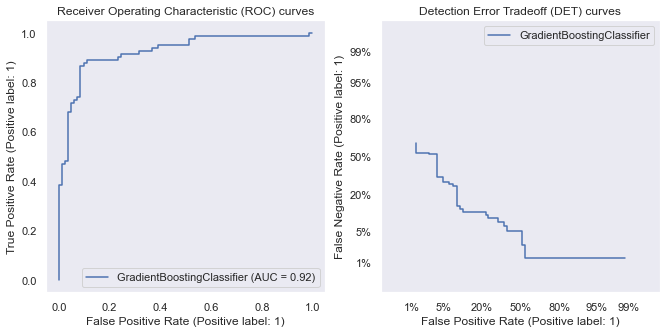

In [45]:
# prepare plots
from matplotlib import pyplot
from sklearn.metrics import plot_det_curve, plot_roc_curve
fig, [ax_roc, ax_det] = pyplot.subplots(1, 2, figsize=(11, 5))
plot_roc_curve(LiverGradB, X_test, Y_test, ax=ax_roc, name='GradientBoostingClassifier')
plot_det_curve(LiverGradB, X_test, Y_test, ax=ax_det, name='GradientBoostingClassifier')

ax_roc.set_title('Receiver Operating Characteristic (ROC) curves')
ax_det.set_title('Detection Error Tradeoff (DET) curves')

ax_roc.grid(linestyle='--')
ax_det.grid(linestyle='--')

pyplot.legend()
pyplot.show()

In [48]:
import shap
shap.initjs()
#X_train_summary = shap.kmeans(X_train, 10)
explainer = shap.KernelExplainer(LiverGradB.predict_proba, X_train)
shap_values_all = explainer.shap_values(X_test) # Inserting Entire X_test Feature
# Force Plot of Entire Data
#shap.force_plot(CAR_explainer.expected_value[0],CAR_shap_values[0],X_test)
shap.force_plot(explainer.expected_value[0], shap_values_all[0], X_test, link='identity')

Using 649 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/163 [00:00<?, ?it/s]

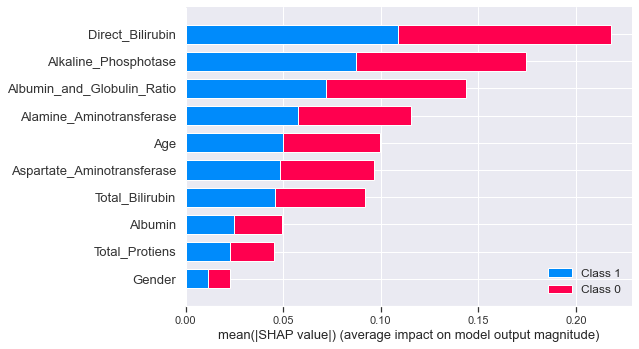

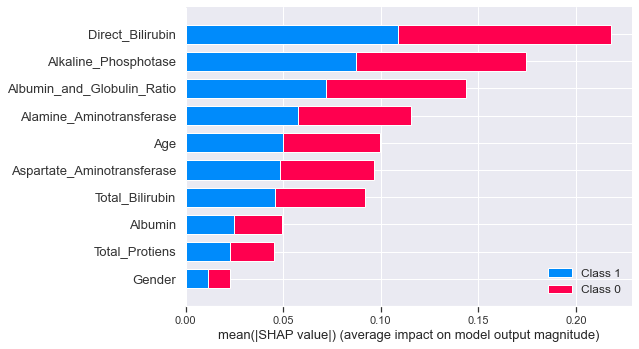

In [49]:
# Feature Importance upon Testing Data
# shap.summary_plot(Heart_shap_values, X_train, plot_type="bar")
# shap.summary_plot(Heart_shap_values, X_train)
#feature_names=list(X_train.columns)
shap.summary_plot(shap_values_all, X_test, plot_type="bar")
shap.summary_plot(shap_values_all, X_test,)

In [50]:
Y_test

683    1
92     0
497    1
227    1
554    0
274    1
534    0
518    0
52     1
385    0
137    0
141    1
558    0
620    1
57     0
614    1
379    0
371    0
205    1
804    1
386    0
493    0
672    1
263    1
91     0
725    1
86     0
114    0
472    0
603    1
257    0
69     0
395    0
687    1
526    1
28     0
727    1
66     0
453    1
11     0
651    1
278    1
363    0
6      0
800    1
404    1
565    1
740    1
729    1
217    1
323    0
680    1
522    0
732    1
228    0
193    0
625    1
454    1
455    0
302    1
282    0
473    0
27     1
428    0
415    1
265    0
361    1
100    1
354    1
656    1
290    1
70     1
362    0
618    1
613    1
223    1
13     0
438    0
624    1
252    1
83     0
698    1
219    0
241    1
106    0
220    0
393    1
75     0
806    1
435    0
89     0
377    0
166    0
203    1
135    0
535    0
581    1
661    1
310    1
222    0
283    0
717    1
645    1
173    1
95     1
779    1
186    1
40     0
739    1
488    0
249    0
2

In [58]:
# plot the SHAP values for the 3rd index observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values3=explainer.shap_values(X_test.iloc[0,:]) # 3rd Row index of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values3[1], X_test.iloc[0,:])

In [52]:
# plot the SHAP values for the 3rd index observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values3=explainer.shap_values(X_test.iloc[1,:]) # 3rd Row index of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values3[1], X_test.iloc[1,:])

In [59]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

eli5 Permutation Feature Importance:


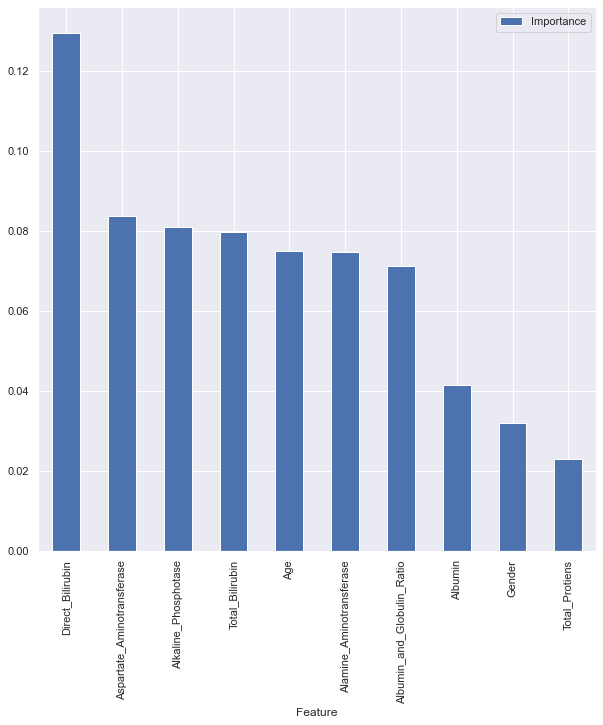

In [60]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)
perm = PermutationImportance(LiverGradB, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [65]:
import numpy
importances = LiverGradB.feature_importances_
forest_importances = Series(importances, index=X_train.columns)
std = numpy.std([
    tree.feature_importances_ for tree in LiverGradB.estimators_], axis=0)
fig, ax = pyplot.subplots()
forest_importances.plot.bar(yerr=std, ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
fig.tight_layout()

AttributeError: 'numpy.ndarray' object has no attribute 'feature_importances_'

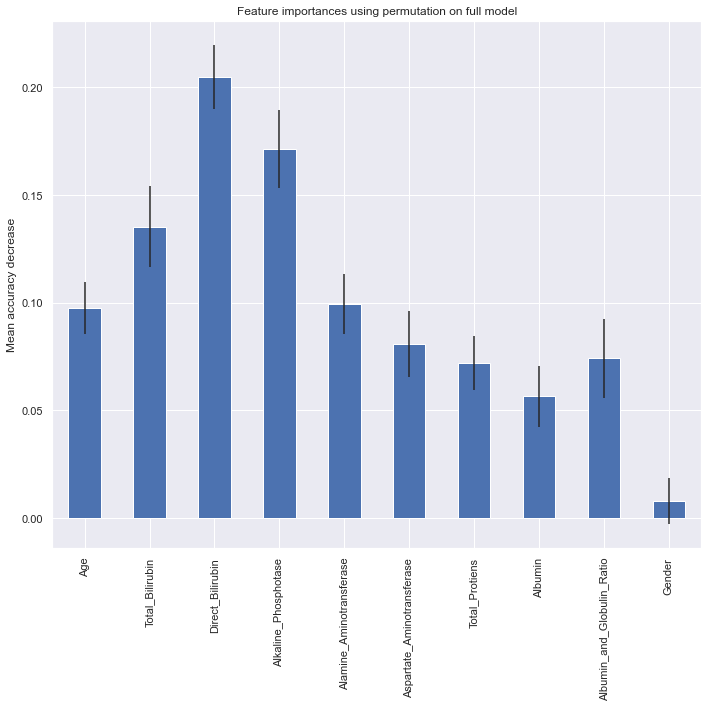

In [64]:
from sklearn.inspection import permutation_importance
result = permutation_importance(
    LiverGradB, X_test, Y_test, n_repeats=20, random_state=999)
fig, ax = pyplot.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
pyplot.show()

Random (chance) Prediction: AUROC = 0.500
GradientBoostingClassifier: AUROC = 0.924


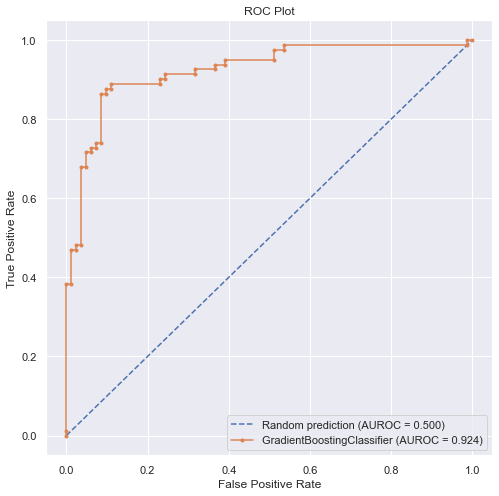

In [66]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
rcParams['figure.figsize'] = [8,8]
r_probs = [0 for _ in range(len(Y_test))]
LiverGradB_probs = LiverGradB.predict_proba(X_test)
LiverGradB_probs = LiverGradB_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverGradB_auc = roc_auc_score(Y_test, LiverGradB_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('GradientBoostingClassifier: AUROC = %.3f' % (LiverGradB_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverGradB_fpr, LiverGradB_tpr, _ = roc_curve(Y_test, LiverGradB_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverGradB_fpr, LiverGradB_tpr, marker='.', label='GradientBoostingClassifier (AUROC = %0.3f)' % LiverGradB_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

In [67]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance

X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)
 #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverGradB, scoring='balanced_accuracy',n_iter=20,random_state=2644).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1256 ± 0.0442,Direct_Bilirubin
0.0826 ± 0.0359,Alkaline_Phosphotase
0.0732 ± 0.0337,Total_Bilirubin
0.0722 ± 0.0368,Aspartate_Aminotransferase
0.0719 ± 0.0301,Age
0.0714 ± 0.0450,Alamine_Aminotransferase
0.0706 ± 0.0335,Albumin_and_Globulin_Ratio
0.0401 ± 0.0191,Gender
0.0400 ± 0.0326,Albumin
0.0181 ± 0.0196,Total_Protiens


eli5 Permutation Feature Importance:


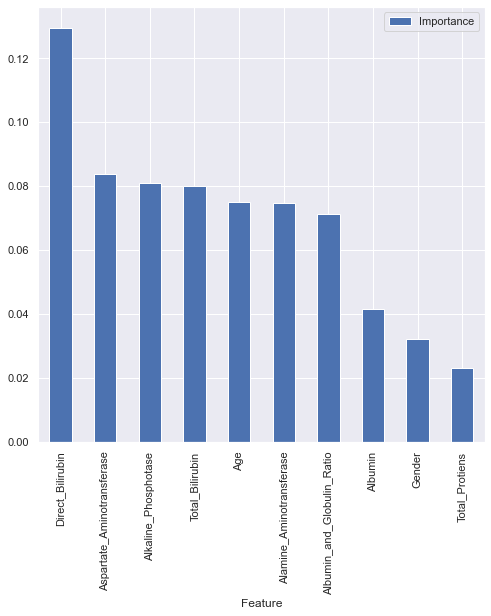

In [68]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)
perm = PermutationImportance(LiverGradB, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [69]:
print(Label.unique())
Class_names = ["Good","Bad"]
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
from IPython.display import display
display(eli5.show_weights(LiverGradB,top=None,feature_names=feature_names,target_names=Class_names))

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 0 # 1st row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverGradB, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

[0 1]


Weight,Feature
0.2050 ± 0.1844,Direct_Bilirubin
0.1714 ± 0.2080,Alkaline_Phosphotase
0.1352 ± 0.1777,Total_Bilirubin
0.0994 ± 0.1286,Alamine_Aminotransferase
0.0976 ± 0.1664,Age
0.0807 ± 0.1474,Aspartate_Aminotransferase
0.0742 ± 0.2005,Albumin_and_Globulin_Ratio
0.0720 ± 0.1364,Total_Protiens
0.0565 ± 0.1441,Albumin
0.0080 ± 0.0612,Gender


683    1
Name: Dataset, dtype: int64


In [70]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 1 # 1st row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverGradB, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

92    0
Name: Dataset, dtype: int64


In [71]:
# Load our pkgs
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=2570)
LiverGradB=GradientBoostingClassifier(random_state=999, max_depth=6, n_estimators=118,learning_rate=0.1).fit(X_train,Y_train)

print(Label.unique())
Class_names = ["Good","Bad"]
feature_names = X_test.columns.tolist()
import lime
import lime.lime_tabular
feature_names=list(X_train.columns)
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=115,mode='classification')

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 0 # 3rd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverGradB.predict_proba)
exp.show_in_notebook(show_table=True)

[0 1]
683    1
Name: Dataset, dtype: int64


In [72]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 1 # 3rd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverGradB.predict_proba)
exp.show_in_notebook(show_table=True)

92    0
Name: Dataset, dtype: int64


# K-Nearest Neighbours

In [3]:
#"Age","Fare","Average_Fare","Family_Size","Age_Group" Column Will Be Removed because they have very Low Correlation value with "Survived".
#"Family_Group"
#DataFrame Separation for Encoding
#CAR1 will be 1D Series
#CAR2 & CAR3 will remain 2D DataFrame only
#Test1
Liver=read_csv("DataFile\\Liver_Balanced_Clean.csv",sep=',',header='infer',na_values=None,keep_default_na=True,na_filter=True,index_col=None) #Write the file path & name inside ("")
Label=Liver['Dataset']
Continuous=Liver[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]

# Continuous Feature Scaling(Scaling of features)
# Continuous Features will be in 2D Array
from sklearn.preprocessing import StandardScaler
StandardScaler = StandardScaler()
Continuous=StandardScaler.fit_transform(Continuous) #Scaling of Features part for optimisation

# Check data type and dimention
# While Converting into DataFrame always provide columns name
Continuous=DataFrame(Continuous,columns=['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']) #Converting Features into 2D DataFrame
type(Continuous),ndim(Continuous),Continuous.shape
#Final ConCatination For Creating Features
#Features will be 2D DataFrame
Features=Continuous

In [4]:
# For loop to check ideal sample that will give generalized model
#Test1
#def Bal_Accu(X_train, Y_train):
#    Y_pred = model.predict(X_train)
#    return balanced_accuracy_score(Y_train,Y_pred)
from sklearn.metrics import balanced_accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
for i in range(1,1000):
    X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=i)
    
    LiverKNN=KNeighborsClassifier().fit(X_train,Y_train)
    
    train_score=LiverKNN.score(X_train,Y_train)
    
    test_score=LiverKNN.score(X_test,Y_test)
    
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverKNN.predict(X_test))
    
    if test_score >= train_score:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.7975460122699386 Train: 0.7935285053929122 Balanced_Accuracy: 0.7971243601324902 RandomState: 5
Test: 0.7791411042944786 Train: 0.7704160246533128 Balanced_Accuracy: 0.7785305630834086 RandomState: 56
Test: 0.7791411042944786 Train: 0.7750385208012327 Balanced_Accuracy: 0.7785305630834086 RandomState: 499
Test: 0.7914110429447853 Train: 0.7796610169491526 Balanced_Accuracy: 0.7918548629930744 RandomState: 866


## Elbow for Whole Data File using Cross Validation

Maximum balanced accuracy:- 0.7081451370069256 at K = 1


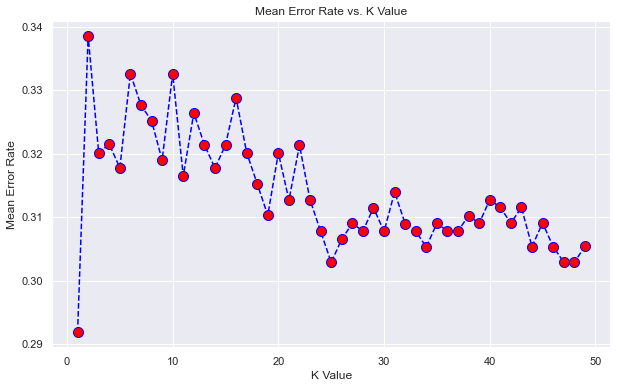

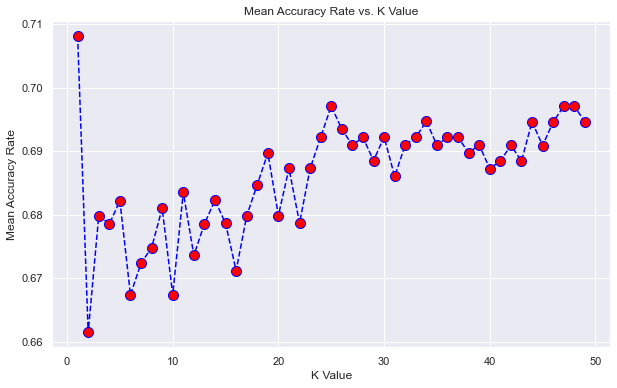

In [4]:
# Will take some time
from matplotlib import pyplot
from sklearn.model_selection import cross_val_score, StratifiedShuffleSplit, StratifiedKFold
#cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
#from sklearn.model_selection import cross_val_score, StratifiedShuffleSplit
from sklearn.neighbors import KNeighborsClassifier

# Will take some time
error_rate = []
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    score=cross_val_score(knn,Features,Label,scoring='balanced_accuracy',cv=cv)
    error_rate.append(1-score.mean())
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),error_rate,color='blue', linestyle='dashed', marker='o',
markerfacecolor='red', markersize=10)
pyplot.title('Mean Error Rate vs. K Value')
pyplot.xlabel('K Value')
pyplot.ylabel('Mean Error Rate')


# Will take some time
accuracy_rate = []
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    score=cross_val_score(knn,Features,Label,scoring='balanced_accuracy',cv=cv)
    accuracy_rate.append(score.mean())
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),accuracy_rate,color='blue', linestyle='dashed', marker='o',
markerfacecolor='red', markersize=10)
pyplot.title('Mean Accuracy Rate vs. K Value')
pyplot.xlabel('K Value')
pyplot.ylabel('Mean Accuracy Rate')
print("Maximum balanced accuracy:-",max(accuracy_rate),"at K =",accuracy_rate.index(max(accuracy_rate))+1)
#print('Error Rate Score values for k= ' , i , 'is:', error_rate)
#print('Accuracy Rate Score values for k= ' , i , 'is:', accuracy_rate)

## Elbow for specific Train & Test

Maximum balanced accuracy:- 0.7971243601324902 at K = 5


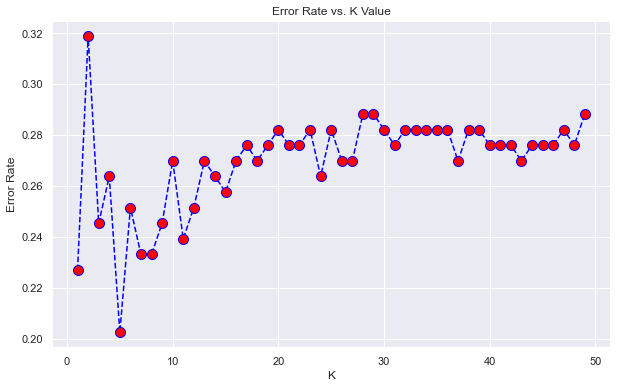

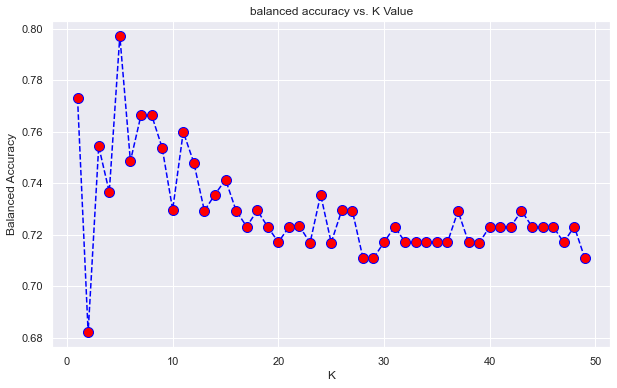

In [6]:
# https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
import numpy
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=5)
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.neighbors import KNeighborsClassifier
error_rate = []
# Will take some time
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,Y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(numpy.mean(pred_i != Y_test))
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),error_rate,color='blue', linestyle='dashed', marker='o',
markerfacecolor='red', markersize=10)
pyplot.title('Error Rate vs. K Value')
pyplot.xlabel('K')
pyplot.ylabel('Error Rate')

acc = []
# Will take some time
from sklearn import metrics
for i in range(1,50):
    neigh = KNeighborsClassifier(n_neighbors = i).fit(X_train,Y_train)
    Yhat = neigh.predict(X_test)
    acc.append(metrics.balanced_accuracy_score(Y_test, Yhat))
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),acc,color = 'blue',linestyle='dashed', 
         marker='o',markerfacecolor='red', markersize=10)
pyplot.title('balanced accuracy vs. K Value')
pyplot.xlabel('K')
pyplot.ylabel('Balanced Accuracy')
print("Maximum balanced accuracy:-",max(acc),"at K =",acc.index(max(acc))+1)

## Find Error list at per neighbour Value

In [7]:
from sklearn import neighbors
from sklearn.metrics import balanced_accuracy_score
from math import sqrt
from matplotlib import pyplot
#%matplotlib inline
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=5)
bal_accu = [] #to store balanced accuracy score values for different neighbour values of k
for K in range(1,50):
    model = KNeighborsClassifier(n_neighbors = K)

    model.fit(X_train, Y_train)  #fit the model
    pred=model.predict(X_test) #make prediction on test set
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,model.predict(X_test)) #calculate balanced accuracy
    bal_accu.append(Balanced_Accuracy_Score) #store balanced accuracy score values
    print('Balanced Accuracy Score value for k= ' , K , 'is:', Balanced_Accuracy_Score)

Balanced Accuracy Score value for k=  1 is: 0.7728846732911774
Balanced Accuracy Score value for k=  2 is: 0.6820987654320987
Balanced Accuracy Score value for k=  3 is: 0.7542908762420958
Balanced Accuracy Score value for k=  4 is: 0.7366004215597712
Balanced Accuracy Score value for k=  5 is: 0.7971243601324902
Balanced Accuracy Score value for k=  6 is: 0.7485697079193014
Balanced Accuracy Score value for k=  7 is: 0.7663354411321891
Balanced Accuracy Score value for k=  8 is: 0.7664859981933152
Balanced Accuracy Score value for k=  9 is: 0.7538392050587173
Balanced Accuracy Score value for k=  10 is: 0.7297500752785306
Balanced Accuracy Score value for k=  11 is: 0.759936766034327
Balanced Accuracy Score value for k=  12 is: 0.7479674796747967
Balanced Accuracy Score value for k=  13 is: 0.729298404095152
Balanced Accuracy Score value for k=  14 is: 0.7356218006624511
Balanced Accuracy Score value for k=  15 is: 0.7414182475158084
Balanced Accuracy Score value for k=  16 is: 0.7293

In [8]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
# from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(Features, Label, stratify=Label, test_size=0.20, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
print('Train_Score:',LiverKNN.score(X_train,Y_train))
print('Test_Score:',LiverKNN.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverKNN.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverKNN.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverKNN.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverKNN.predict(X_test)))
print(classification_report(Y_test,LiverKNN.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverKNN2.predict(X_train)
Predicted_Proba_Y = LiverKNN.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverKNN.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 0.7935285053929122
Test_Score: 0.7975460122699386
Balanced_Accuracy_Score: 0.7971243601324902
Recall_Score: 0.8658536585365854
Precision_Score: 0.7634408602150538
              precision    recall  f1-score   support

           0       0.84      0.73      0.78        81
           1       0.76      0.87      0.81        82

    accuracy                           0.80       163
   macro avg       0.80      0.80      0.80       163
weighted avg       0.80      0.80      0.80       163

The Log Loss on Training is:  0.4153419193425663
The Log Loss on Testing is:  0.8480765331928961


In [9]:
Features.columns

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase',
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender'],
      dtype='object')

Drop-Col Feature Importance:
                            Importance
Feature                               
Gender                        0.085968
Age                           0.055179
Albumin_and_Globulin_Ratio    0.049006
Albumin                       0.030413
Alkaline_Phosphotase          0.024390
Total_Bilirubin               0.012270
Alamine_Aminotransferase      0.012120
Direct_Bilirubin              0.006022
Total_Protiens                0.006022


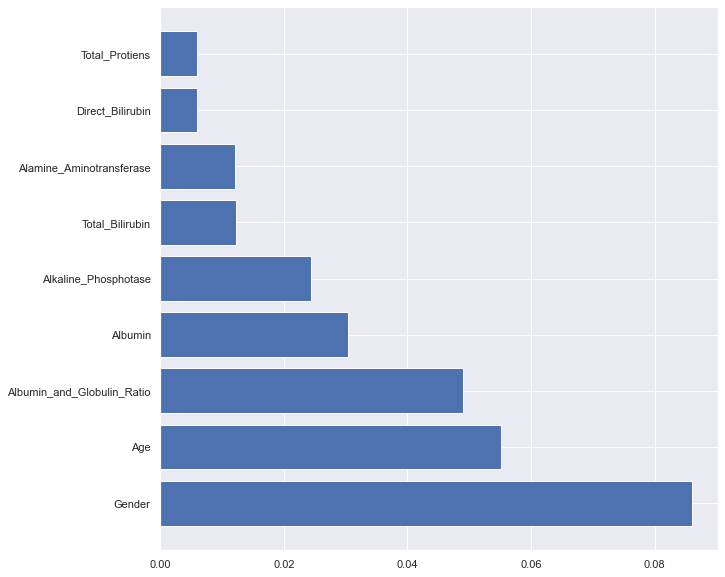

Train_Score: 0.8012326656394453
Test_Score: 0.803680981595092
Balanced_Accuracy_Score: 0.8032971996386631
Recall_Score: 0.8658536585365854
Precision_Score: 0.7717391304347826
              precision    recall  f1-score   support

           0       0.85      0.74      0.79        81
           1       0.77      0.87      0.82        82

    accuracy                           0.80       163
   macro avg       0.81      0.80      0.80       163
weighted avg       0.81      0.80      0.80       163

The Log Loss on Training is:  0.41695987114850425
The Log Loss on Testing is:  0.8504878374144275


In [10]:
from matplotlib import pyplot
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=5)
# RMSE Drop Column Feature Importance @ Testing Data
from numpy.lib.scimath import sqrt
from sklearn.base import clone
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df


def drop_col_feat_imp(model, X_train, Y_train, X_test, Y_test):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    # training and scoring the benchmark model
    model_clone.fit(X_train, Y_train)
    Balanced_Score = balanced_accuracy_score(Y_test,model_clone.predict(X_test))
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        model_clone2 = clone(model)
        model_clone2.fit(X_train.drop(col, axis = 1), Y_train)
        drop_col_score = balanced_accuracy_score(Y_test,model_clone2.predict(X_test.drop(col, axis = 1)))
        importances.append(Balanced_Score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
print('Drop-Col Feature Importance:')
print(drop_col_feat_imp(LiverKNN, X_train, Y_train, X_test, Y_test))
importances_df = drop_col_feat_imp(LiverKNN, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
print('Train_Score:',LiverKNN.score(X_train,Y_train))
print('Test_Score:',LiverKNN.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverKNN.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
DataFrame(confusion_matrix(Y_test,LiverKNN.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["God", "Bad"])                # printing confusion matrix
print('Recall_Score:',recall_score(Y_test,LiverKNN.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverKNN.predict(X_test)))
print(classification_report(Y_test,LiverKNN.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverTree2.predict(X_train)
Predicted_Proba_Y = LiverKNN.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))
# Running Logarithmic Loss-or Log Loss-or Binary Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverKNN.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 0.009316440468435406

Maximum balanced accuracy:- 0.8032971996386631 at K = 5


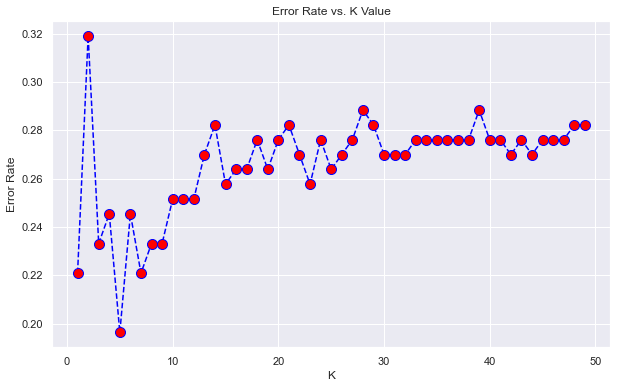

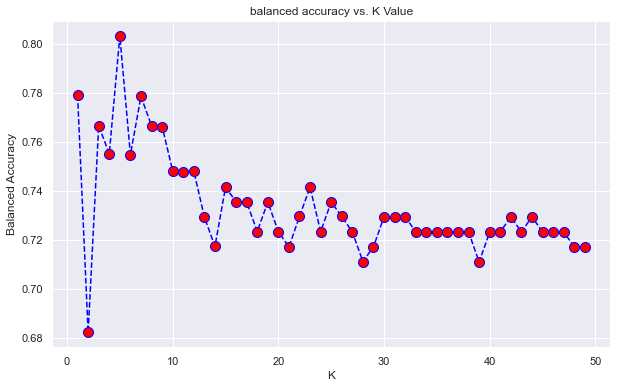

In [11]:
# https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
import numpy
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
error_rate = []
# Will take some time
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,Y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(numpy.mean(pred_i != Y_test))
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),error_rate,color='blue', linestyle='dashed', marker='o',
markerfacecolor='red', markersize=10)
pyplot.title('Error Rate vs. K Value')
pyplot.xlabel('K')
pyplot.ylabel('Error Rate')

acc = []
# Will take some time
from sklearn import metrics
for i in range(1,50):
    neigh = KNeighborsClassifier(n_neighbors = i).fit(X_train,Y_train)
    Yhat = neigh.predict(X_test)
    acc.append(metrics.balanced_accuracy_score(Y_test, Yhat))
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),acc,color = 'blue',linestyle='dashed', 
         marker='o',markerfacecolor='red', markersize=10)
pyplot.title('balanced accuracy vs. K Value')
pyplot.xlabel('K')
pyplot.ylabel('Balanced Accuracy')
print("Maximum balanced accuracy:-",max(acc),"at K =",acc.index(max(acc))+1)

In [5]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
print('Train_Score:',LiverKNN.score(X_train,Y_train))
print('Test_Score:',LiverKNN.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverKNN.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverKNN.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverKNN.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverKNN.predict(X_test)))
print(classification_report(Y_test,LiverKNN.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverKNN2.predict(X_train)
Predicted_Proba_Y = LiverKNN.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverKNN.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 0.8012326656394453
Test_Score: 0.803680981595092
Balanced_Accuracy_Score: 0.8032971996386631
Recall_Score: 0.8658536585365854
Precision_Score: 0.7717391304347826
              precision    recall  f1-score   support

           0       0.85      0.74      0.79        81
           1       0.77      0.87      0.82        82

    accuracy                           0.80       163
   macro avg       0.81      0.80      0.80       163
weighted avg       0.81      0.80      0.80       163

The Log Loss on Training is:  0.41695987114850425
The Log Loss on Testing is:  0.8504878374144275


In [13]:
# For loop to check ideal sample that will give generalized model
#Test1
#def Bal_Accu(X_train, Y_train):
#    Y_pred = model.predict(X_train)
#    return balanced_accuracy_score(Y_train,Y_pred)
from sklearn.metrics import balanced_accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
for i in range(1,1000):
    X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=i)
    
    LiverKNN=KNeighborsClassifier().fit(X_train,Y_train)
    
    train_score=LiverKNN.score(X_train,Y_train)
    
    test_score=LiverKNN.score(X_test,Y_test)
    
    Balanced_Accuracy_Score=balanced_accuracy_score(Y_test,LiverKNN.predict(X_test))
    
    if test_score >= train_score:
        print("Test: {} Train: {} Balanced_Accuracy: {} RandomState: {}".format(test_score,train_score,Balanced_Accuracy_Score,i))

Test: 0.803680981595092 Train: 0.8012326656394453 Balanced_Accuracy: 0.8032971996386631 RandomState: 5


Maximum balanced accuracy:- 0.7179915688045769 at K = 1


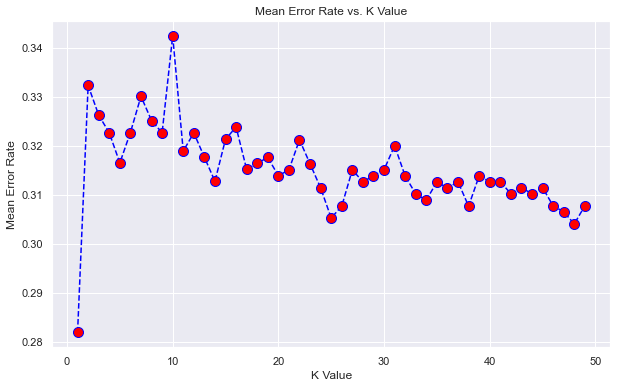

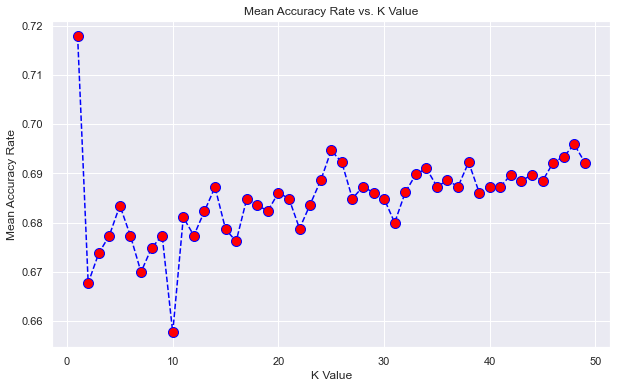

In [14]:
# Will take some time
from matplotlib import pyplot
from sklearn.model_selection import cross_val_score, StratifiedShuffleSplit, StratifiedKFold
#cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
#from sklearn.model_selection import cross_val_score, StratifiedShuffleSplit
from sklearn.neighbors import KNeighborsClassifier

# Will take some time
error_rate = []
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    score=cross_val_score(knn,SFFS1,Label,scoring='balanced_accuracy',cv=cv)
    error_rate.append(1-score.mean())
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),error_rate,color='blue', linestyle='dashed', marker='o',
markerfacecolor='red', markersize=10)
pyplot.title('Mean Error Rate vs. K Value')
pyplot.xlabel('K Value')
pyplot.ylabel('Mean Error Rate')


# Will take some time
accuracy_rate = []
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    score=cross_val_score(knn,SFFS1,Label,scoring='balanced_accuracy',cv=cv)
    accuracy_rate.append(score.mean())
pyplot.figure(figsize=(10,6))
pyplot.plot(range(1,50),accuracy_rate,color='blue', linestyle='dashed', marker='o',
markerfacecolor='red', markersize=10)
pyplot.title('Mean Accuracy Rate vs. K Value')
pyplot.xlabel('K Value')
pyplot.ylabel('Mean Accuracy Rate')
print("Maximum balanced accuracy:-",max(accuracy_rate),"at K =",accuracy_rate.index(max(accuracy_rate))+1)
#print('Error Rate Score values for k= ' , i , 'is:', error_rate)
#print('Accuracy Rate Score values for k= ' , i , 'is:', accuracy_rate)

>1, train: 1.000, test: 0.779
>2, train: 0.884, test: 0.682
>3, train: 0.848, test: 0.767
>4, train: 0.817, test: 0.755
>5, train: 0.801, test: 0.803
>6, train: 0.789, test: 0.755
>7, train: 0.757, test: 0.779
>8, train: 0.740, test: 0.767
>9, train: 0.734, test: 0.766
>10, train: 0.729, test: 0.748
>11, train: 0.726, test: 0.748
>12, train: 0.724, test: 0.748
>13, train: 0.720, test: 0.729
>14, train: 0.709, test: 0.717
>15, train: 0.721, test: 0.741
>16, train: 0.721, test: 0.736
>17, train: 0.729, test: 0.735
>18, train: 0.724, test: 0.723
>19, train: 0.726, test: 0.735
>20, train: 0.717, test: 0.723
>21, train: 0.720, test: 0.717
>22, train: 0.714, test: 0.730
>23, train: 0.720, test: 0.741
>24, train: 0.712, test: 0.723
>25, train: 0.715, test: 0.735
>26, train: 0.708, test: 0.730
>27, train: 0.712, test: 0.723
>28, train: 0.711, test: 0.711
>29, train: 0.703, test: 0.717
>30, train: 0.712, test: 0.729
>31, train: 0.708, test: 0.729
>32, train: 0.715, test: 0.729
>33, train: 0.709

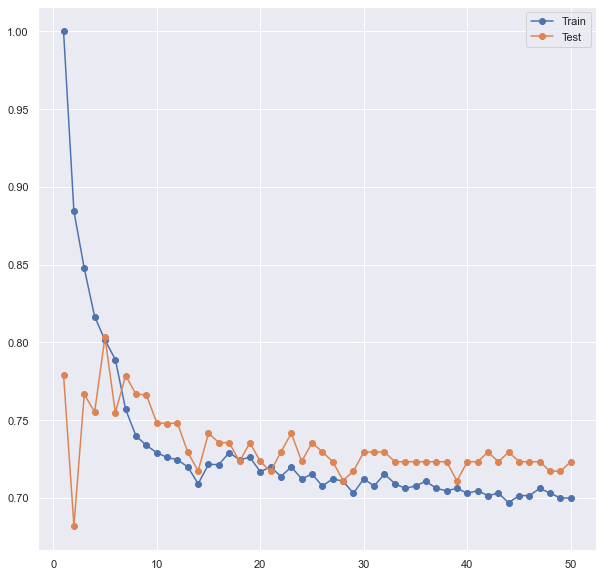

In [8]:
# evaluate knn performance on train and test sets with different numbers of neighbors
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from matplotlib import pyplot
# create dataset
# X, y = make_classification(n_samples=10000, n_features=20, n_informative=5, n_redundant=15, random_state=1)
# split into train test sets
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
# define lists to collect scores
train_scores, test_scores = list(), list()
# define the tree depths to evaluate
values = [i for i in range(1, 51)]
# evaluate a decision tree for each depth
for i in values:
	# configure the model
	model = KNeighborsClassifier(n_neighbors=i)
	# fit model on the training dataset
	model.fit(X_train, Y_train)
	# evaluate on the train dataset
	train_Yhat = model.predict(X_train)
	train_acc = balanced_accuracy_score(Y_train, train_Yhat)
	train_scores.append(train_acc)
	# evaluate on the test dataset
	test_Yhat = model.predict(X_test)
	test_acc = balanced_accuracy_score(Y_test, test_Yhat)
	test_scores.append(test_acc)
	# summarize progress
	print('>%d, train: %.3f, test: %.3f' % (i, train_acc, test_acc))
# plot of train and test scores vs number of neighbors
pyplot.plot(values, train_scores, '-o', label='Train')
pyplot.plot(values, test_scores, '-o', label='Test')
pyplot.legend()

# ExtraTreesClassifier Feature Importance

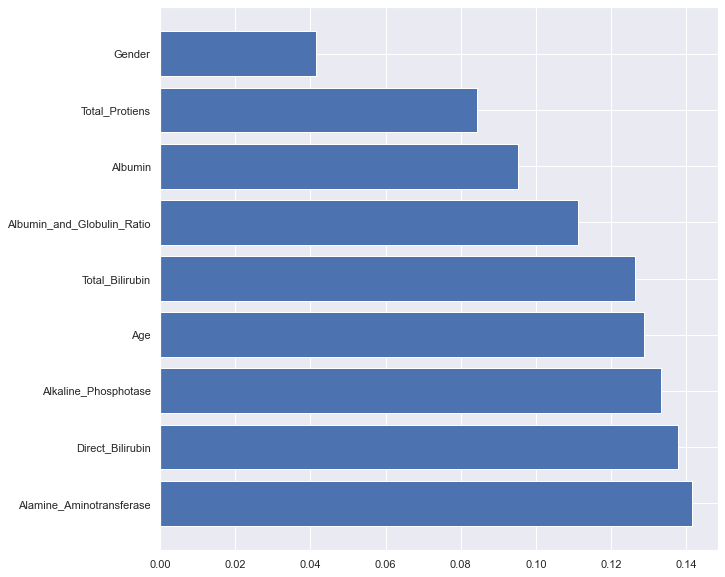

In [11]:
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
# Feature Importance with Extra Trees Classifier
#from pandas import read_csv
from sklearn.ensemble import ExtraTreesClassifier
# feature extraction
model = ExtraTreesClassifier(class_weight='balanced')
model.fit(X_train, Y_train)
#print(model.feature_importances_)

importances_df = imp_df(X_train.columns, model.feature_importances_)
#LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
#print('Drop-Col Feature Importance:')
#print(drop_col_feat_imp(LiverKNN, X_train, Y_train, X_test, Y_test))
#importances_df = drop_col_feat_imp(LiverKNN, X_train, Y_train, X_test, Y_test)
importances_df.sort_values(by="Importance",ascending=False, inplace=True)
#importances_df.plot.bar()
#show()
pyplot.barh(importances_df.index, importances_df.Importance)
show()
#Check Model

In [6]:
#Max depth increase koro for 100% training accuracy reaching, then n_estimators= decrease koro for optimum higher Testing
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
from sklearn.tree import DecisionTreeClassifier # n_estimators=120, 35, depth 3
from sklearn.metrics import balanced_accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
print('Train_Score:',LiverKNN.score(X_train,Y_train))
print('Test_Score:',LiverKNN.score(X_test,Y_test))
print('Balanced_Accuracy_Score:',balanced_accuracy_score(Y_test,LiverKNN.predict(X_test)))
from sklearn.metrics  import log_loss, classification_report, confusion_matrix, recall_score, precision_score, balanced_accuracy_score
# printing confusion matrix
DataFrame(confusion_matrix(Y_test,LiverKNN.predict(X_test)),\
          columns=["Predicted Good", "Predicted Bad"],\
          index=["Good", "Bad"])
print('Recall_Score:',recall_score(Y_test,LiverKNN.predict(X_test)))
print('Precision_Score:',precision_score(Y_test,LiverKNN.predict(X_test)))
print(classification_report(Y_test,LiverKNN.predict(X_test)))
# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on training Data
#Predicted_Proba_Y = LiverKNN2.predict(X_train)
Predicted_Proba_Y = LiverKNN.predict_proba(X_train)
print("The Log Loss on Training is: ", log_loss(Y_train, Predicted_Proba_Y))

# Running Logarithmic Loss-or Log Loss-or Cross Entropy Loss on testing Data
Predicted_Proba_Y = LiverKNN.predict_proba(X_test)
print("The Log Loss on Testing is: ", log_loss(Y_test, Predicted_Proba_Y)) # Log-Loss has been Down
                                                                     # so our prediction is very good 115, 0.1

Train_Score: 0.8012326656394453
Test_Score: 0.803680981595092
Balanced_Accuracy_Score: 0.8032971996386631
Recall_Score: 0.8658536585365854
Precision_Score: 0.7717391304347826
              precision    recall  f1-score   support

           0       0.85      0.74      0.79        81
           1       0.77      0.87      0.82        82

    accuracy                           0.80       163
   macro avg       0.81      0.80      0.80       163
weighted avg       0.81      0.80      0.80       163

The Log Loss on Training is:  0.41695987114850425
The Log Loss on Testing is:  0.8504878374144275


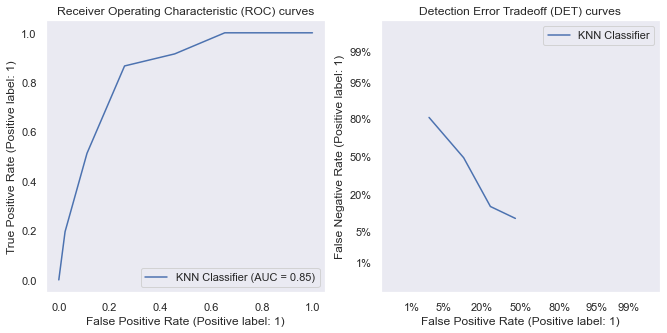

In [16]:
# prepare plots
from matplotlib import pyplot
from sklearn.metrics import plot_det_curve, plot_roc_curve
fig, [ax_roc, ax_det] = pyplot.subplots(1, 2, figsize=(11, 5))
plot_roc_curve(LiverKNN, X_test, Y_test, ax=ax_roc, name='KNN Classifier')
plot_det_curve(LiverKNN, X_test, Y_test, ax=ax_det, name='KNN Classifier')

ax_roc.set_title('Receiver Operating Characteristic (ROC) curves')
ax_det.set_title('Detection Error Tradeoff (DET) curves')

ax_roc.grid(linestyle='--')
ax_det.grid(linestyle='--')

pyplot.legend()
pyplot.show()

In [17]:
import shap
shap.initjs()
X_train_summary = shap.kmeans(X_train, 10)
explainer = shap.KernelExplainer(LiverKNN.predict_proba, X_train_summary)
shap_values_all = explainer.shap_values(X_test) # Inserting Entire X_test Feature
# Force Plot of Entire Data
#shap.force_plot(CAR_explainer.expected_value[0],CAR_shap_values[0],X_test)
shap.force_plot(explainer.expected_value[0], shap_values_all[0], X_test, link='identity')

  0%|          | 0/163 [00:00<?, ?it/s]

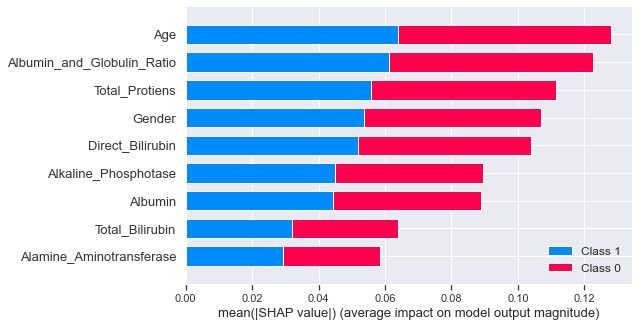

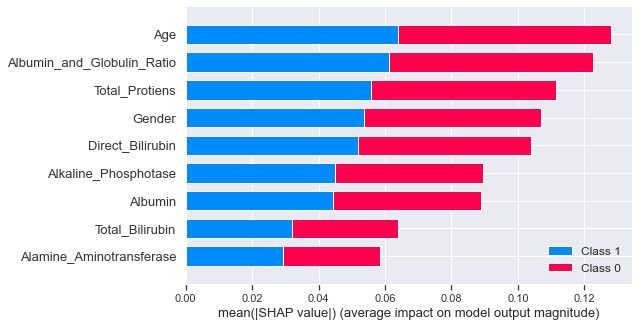

In [18]:
# Feature Importance upon Testing Data
# shap.summary_plot(Heart_shap_values, X_train, plot_type="bar")
# shap.summary_plot(Heart_shap_values, X_train)
#feature_names=list(X_train.columns)
shap.summary_plot(shap_values_all, X_test, plot_type="bar")
shap.summary_plot(shap_values_all, X_test,)

In [19]:
Y_test

595    1
796    1
733    1
320    1
329    1
45     0
177    1
627    1
655    1
744    1
682    1
429    0
143    0
798    1
287    1
46     0
727    1
9      0
252    1
277    0
770    1
179    0
44     0
662    1
170    1
339    0
61     0
490    0
550    0
5      0
640    1
154    0
108    1
194    0
460    1
677    1
780    1
536    0
513    0
482    1
591    1
529    1
97     0
756    1
709    1
322    0
210    1
624    1
296    0
723    1
323    0
107    1
565    1
400    1
268    1
703    1
110    0
533    0
189    1
445    0
665    1
551    1
293    0
594    1
373    1
58     0
611    1
364    1
758    1
416    0
105    1
285    0
150    0
292    1
247    0
398    1
37     0
186    1
270    1
620    1
632    1
282    0
196    0
87     0
558    0
275    0
151    0
491    0
136    1
805    1
159    0
528    1
20     0
242    0
612    1
153    0
377    0
146    0
652    1
510    0
197    0
326    0
166    0
739    1
350    1
18     0
779    1
233    0
601    1
516    0
695    1
5

In [20]:
# plot the SHAP values for the 3rd index observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values3=explainer.shap_values(X_test.iloc[2,:]) # 3rd Row index of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values3[1], X_test.iloc[2,:])

In [21]:
# plot the SHAP values for the 3rd index observation from Testing Data
# Red Colour Will Increase the Prediction & having higher arrow
# Blue Colour Will Reduce the Prediction & having lower arrow
shap_values3=explainer.shap_values(X_test.iloc[15,:]) # 3rd Row index of X_test Input Feature DataFrame
shap.force_plot(explainer.expected_value[1], shap_values3[1], X_test.iloc[15,:])

eli5 Permutation Feature Importance:


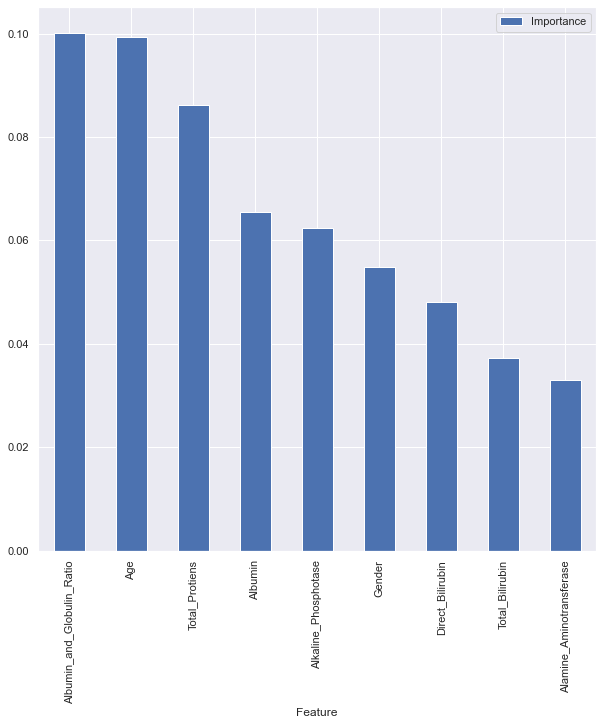

In [22]:
# Transforming the Result into DataFrame
# Graphically Visualize the Permutation feature Importance of eli5 upon LinearRegression() Algo
import eli5
from eli5.sklearn import PermutationImportance
# defining the imp_df
def imp_df(column_names, importances):
    data = {
        'Feature': column_names,
        'Importance': importances,
    }
    df = DataFrame(data) \
        .set_index('Feature') \
        .sort_values('Importance', ascending=False)

    return df
SFFS1=Features[['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 
       'Total_Protiens', 'Albumin', 'Albumin_and_Globulin_Ratio', 'Gender']]
X_train, X_test, Y_train, Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.2, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
perm = PermutationImportance(LiverKNN, scoring='balanced_accuracy',n_iter=20,random_state=3554).fit(X_test, Y_test)
perm_imp_eli5 = imp_df(X_train.columns, perm.feature_importances_)
# Graphically Visualize the Permutation feature Importance
perm_imp_eli5.sort_values(by="Importance",ascending=False, inplace=True)
# pyplot.barh(perm_imp_eli5.index, perm_imp_eli5.Importance)
# show()
print('eli5 Permutation Feature Importance:')
perm_imp_eli5.plot.bar()
show()

In [23]:
# Permutation Models is a way to understand blackbox models. It only works for Global Interpretation.
# As output it gives weight values similar to feature importance that you get with algorithms by default, this shows relative importance among the features .
import eli5
from eli5.sklearn import PermutationImportance
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)
 #Used to create equation of line #RegModel generation by feeding Training Data
# X_train, X_test, Y_train, Y_test = train_test_split(Features,Label,test_size=0.2,random_state=6195)
# model = LinearRegression().fit(X_train, Y_train)
perm = PermutationImportance(LiverKNN, scoring='balanced_accuracy',n_iter=20,random_state=2644).fit(X_test, Y_test)
feature_names = X_test.columns.tolist()
eli5.show_weights(perm, top=None, feature_names=feature_names)

Weight,Feature
0.1078 ± 0.0539,Albumin_and_Globulin_Ratio
0.0887 ± 0.0377,Age
0.0815 ± 0.0530,Total_Protiens
0.0633 ± 0.0360,Alkaline_Phosphotase
0.0611 ± 0.0576,Albumin
0.0543 ± 0.0347,Direct_Bilirubin
0.0490 ± 0.0371,Gender
0.0366 ± 0.0242,Total_Bilirubin
0.0296 ± 0.0255,Alamine_Aminotransferase


In [24]:
print(Label.unique())
Class_names = ["Good","Bad"]
# visualise the weights of my model (Global Interpretation), upon Training Data
# Global Interpretation : inspect model parameters and try to figure out how the model works globally.
from IPython.display import display
display(eli5.show_weights(LiverKNN,top=None,feature_names=feature_names,target_names=Class_names))

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 2 # 1st row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverKNN, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

[0 1]


733    1
Name: Dataset, dtype: int64


In [25]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 15 # 1st row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
eli5.show_prediction(LiverKNN, X_test.iloc[i], feature_names=feature_names, show_feature_values=True)

46    0
Name: Dataset, dtype: int64


In [26]:
# Load our pkgs
X_train,X_test,Y_train,Y_test = train_test_split(SFFS1, Label, stratify=Label, test_size=0.20, random_state=5)
LiverKNN=KNeighborsClassifier(n_neighbors=5).fit(X_train,Y_train)

print(Label.unique())
Class_names = ["Good","Bad"]
feature_names = X_test.columns.tolist()
import lime
import lime.lime_tabular
feature_names=list(X_train.columns)
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=feature_names,
                                                   class_names=Class_names, discretize_continuous=True,random_state=115,mode='classification')

# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 2 # 3rd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverKNN.predict_proba)
exp.show_in_notebook(show_table=True)

[0 1]
733    1
Name: Dataset, dtype: int64


In [27]:
# Local Interpretation : inspect an individual prediction of a model
# try to figure out why the model makes the decision it makes.
i = 15 # 3rd row index input of X_test data
X_test.iloc[[i]]
print(Y_test.iloc[[i]])
exp = explainer.explain_instance(X_test.iloc[i],LiverKNN.predict_proba)
exp.show_in_notebook(show_table=True)

46    0
Name: Dataset, dtype: int64


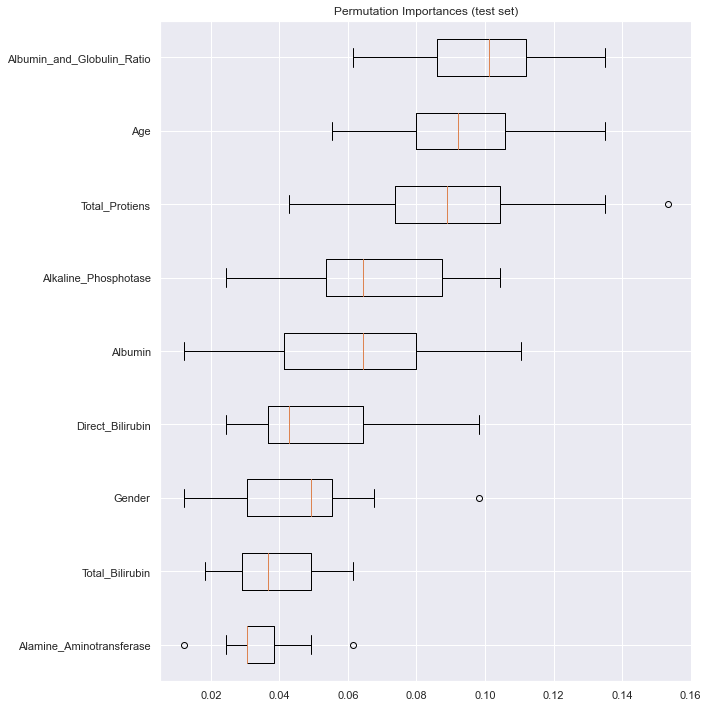

In [11]:
from sklearn.inspection import permutation_importance
result = permutation_importance(LiverKNN, X_test, Y_test, n_repeats=20,
                                random_state=999)
sorted_idx = result.importances_mean.argsort()

fig, ax = pyplot.subplots()
ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X_test.columns[sorted_idx])
ax.set_title("Permutation Importances (test set)")
fig.tight_layout()
pyplot.show()

Elapsed time to compute the importances: 1.932 seconds


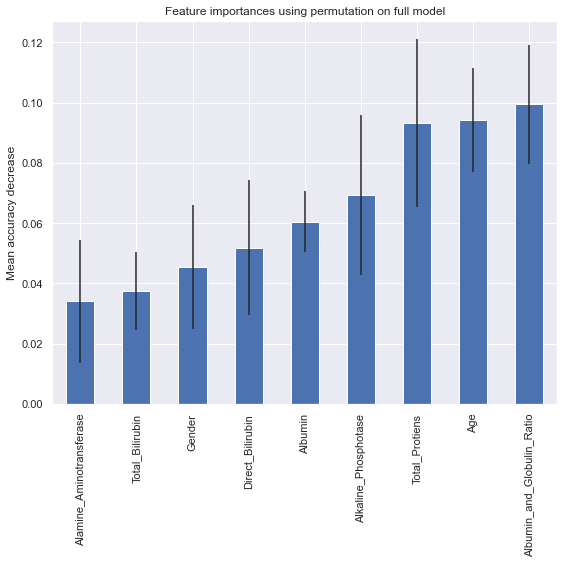

In [28]:
from sklearn.inspection import permutation_importance
rcParams['figure.figsize'] = [8,8]
start_time = time.time()
result = permutation_importance(
    LiverKNN, X_test, Y_test, n_repeats=20, random_state=999)
elapsed_time = time.time() - start_time
print(f"Elapsed time to compute the importances: "
      f"{elapsed_time:.3f} seconds")

forest_importances = Series(result.importances_mean, index=X_train.columns)

fig, ax = pyplot.subplots()
forest_importances.sort_values().plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
pyplot.show()

Random (chance) Prediction: AUROC = 0.500
KNNClassifier: AUROC = 0.846


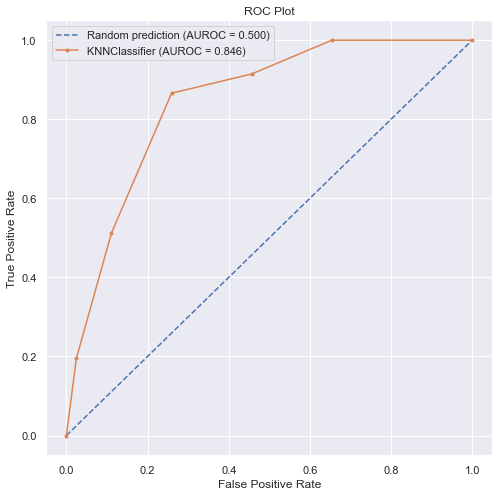

In [29]:
# https://github.com/dataprofessor/code/blob/master/python/ROC_curve.ipynb
# https://www.youtube.com/watch?v=uVJXPPrWRJ0
# https://www.youtube.com/watch?v=afQ_DyKMxUo
# https://sefiks.com/2020/12/10/a-gentle-introduction-to-roc-curve-and-auc/
rcParams['figure.figsize'] = [8,8]
r_probs = [0 for _ in range(len(Y_test))]
LiverKNN_probs = LiverKNN.predict_proba(X_test)
LiverKNN_probs = LiverKNN_probs[:, 1]
from sklearn.metrics import roc_curve, roc_auc_score
r_auc = roc_auc_score(Y_test, r_probs)
LiverKNN_auc = roc_auc_score(Y_test, LiverKNN_probs)
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('KNNClassifier: AUROC = %.3f' % (LiverKNN_auc))
r_fpr, r_tpr, _ = roc_curve(Y_test, r_probs)
LiverKNN_fpr, LiverKNN_tpr, _ = roc_curve(Y_test, LiverKNN_probs)
import matplotlib.pyplot as plt
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(LiverKNN_fpr, LiverKNN_tpr, marker='.', label='KNNClassifier (AUROC = %0.3f)' % LiverKNN_auc)
# Title
plt.title('ROC Plot')
# Axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend
plt.legend() # 
# Show plot
plt.show()

In [102]:
# Phi_K is a new and practical correlation coefficient based on several refinements to Pearson’s hypothesis test of independence of two variables.
# The combined features of Phi_K form an advantage over existing coefficients. First, it works consistently between
# categorical, ordinal and interval variables. Second, it captures non-linear dependency. Third, it reverts to the Pearson
# correlation coefficient in case of a bi-variate normal input distribution. These are useful features when studying the
# correlation matrix of variables with mixed types.
# Phi-Correlation plot by using Heatmap
# All Categorical Columns
import phik
from phik import report
# get the phi-K correlation matrix between all variables
Liver.phik_matrix(interval_cols=['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Total_Protiens','Albumin','Albumin_and_Globulin_Ratio'])

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
Age,1.000000,0.204914,0.000000,0.000000,0.381793,0.000000,0.074735,0.357698,0.323393,0.195570,0.316711
Gender,0.204914,1.000000,0.085368,0.163304,0.148203,0.000000,0.000000,0.140415,0.017500,0.091780,0.340404
Total_Bilirubin,0.000000,0.085368,1.000000,0.897009,0.346292,0.346401,0.319249,0.000000,0.106646,0.336233,0.250029
Direct_Bilirubin,0.000000,0.163304,0.897009,1.000000,0.463233,0.382617,0.450104,0.134323,0.153573,0.411807,0.450425
Alkaline_Phosphotase,0.381793,0.148203,0.346292,0.463233,1.000000,0.383024,0.528689,0.000000,0.152625,0.189422,0.390637
Alamine_Aminotransferase,0.000000,0.000000,0.346401,0.382617,0.383024,1.000000,0.864297,0.000000,0.123599,0.000000,0.248443
Aspartate_Aminotransferase,0.074735,0.000000,0.319249,0.450104,0.528689,0.864297,1.000000,0.000000,0.000000,0.030585,0.218002
Total_Protiens,0.357698,0.140415,0.000000,0.134323,0.000000,0.000000,0.000000,1.000000,0.837878,0.209916,0.034989
Albumin,0.323393,0.017500,0.106646,0.153573,0.152625,0.123599,0.000000,0.837878,1.000000,0.614837,0.285603
Albumin_and_Globulin_Ratio,0.195570,0.091780,0.336233,0.411807,0.189422,0.000000,0.030585,0.209916,0.614837,1.000000,0.267470


In [103]:
# get global correlations based on phi_K correlation matrix
Liver.global_phik(interval_cols=['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Total_Protiens','Albumin','Albumin_and_Globulin_Ratio'])

D:\D Program Files\Anaconda\lib\site-packages\phik\phik.py:248: RuntimeWarning: invalid value encountered in sqrt
  global_correlations = np.array([[np.sqrt(1 - 1/(V[i][i] * Vinv[i][i]))] for i in range(V.shape[0])])


(array([[0.50753145],
        [0.24021133],
        [0.91239021],
        [0.88488223],
        [0.59539082],
        [0.92300265],
        [0.93749835],
        [1.13905437],
        [1.12748838],
        [       nan],
        [       nan]]),
 array(['Age', 'Gender', 'Total_Bilirubin', 'Direct_Bilirubin',
        'Alkaline_Phosphotase', 'Alamine_Aminotransferase',
        'Aspartate_Aminotransferase', 'Total_Protiens', 'Albumin',
        'Albumin_and_Globulin_Ratio', 'Dataset'], dtype=object))

In [104]:
# get the significance matrix (expressed as one-sided Z)
# of the hypothesis test of each variable-pair dependency
Liver.significance_matrix(interval_cols=['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Total_Protiens','Albumin','Albumin_and_Globulin_Ratio'])

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Dataset
Age,52.646518,2.935776,0.901601,1.701614,5.908370,0.346852,1.012064,4.046046,5.422925,3.850943,5.747608
Gender,2.935776,30.731578,2.157049,2.719723,2.046273,0.538339,0.334470,1.766723,0.048437,1.625263,6.122883
Total_Bilirubin,0.901601,2.157049,22.215718,19.255139,6.557425,5.472475,5.203050,0.765542,3.112940,6.170990,7.876185
Direct_Bilirubin,1.701614,2.719723,19.255139,27.692178,6.774197,6.151804,6.048592,1.037166,2.271742,6.193686,9.785275
Alkaline_Phosphotase,5.908370,2.046273,6.557425,6.774197,34.422790,5.435039,4.242605,-0.198933,2.543936,4.473179,7.646125
Alamine_Aminotransferase,0.346852,0.538339,5.472475,6.151804,5.435039,18.198144,11.875697,1.108073,1.341780,0.875740,5.018452
Aspartate_Aminotransferase,1.012064,0.334470,5.203050,6.048592,4.242605,11.875697,15.349957,1.629733,1.115452,1.216857,4.407763
Total_Protiens,4.046046,1.766723,0.765542,1.037166,-0.198933,1.108073,1.629733,49.254278,23.511648,4.971263,0.394784
Albumin,5.422925,0.048437,3.112940,2.271742,2.543936,1.341780,1.115452,23.511648,50.799979,20.881334,4.942248
Albumin_and_Globulin_Ratio,3.850943,1.625263,6.170990,6.193686,4.473179,0.875740,1.216857,4.971263,20.881334,46.208890,6.476211


D:\D Program Files\Anaconda\lib\site-packages\phik\phik.py:248: RuntimeWarning: invalid value encountered in sqrt
  global_correlations = np.array([[np.sqrt(1 - 1/(V[i][i] * Vinv[i][i]))] for i in range(V.shape[0])])
D:\D Program Files\Anaconda\lib\site-packages\phik\outliers.py:198: RuntimeWarning: invalid value encountered in double_scalars
  logmidp = np.log(0.5) + lp + np.log( 1 + np.exp(lp1-lp) )
D:\D Program Files\Anaconda\lib\site-packages\scipy\stats\_distn_infrastructure.py:2017: RuntimeWarning: invalid value encountered in greater
  cond1 = (0 < q) & (q < 1)
D:\D Program Files\Anaconda\lib\site-packages\scipy\stats\_distn_infrastructure.py:2017: RuntimeWarning: invalid value encountered in less
  cond1 = (0 < q) & (q < 1)


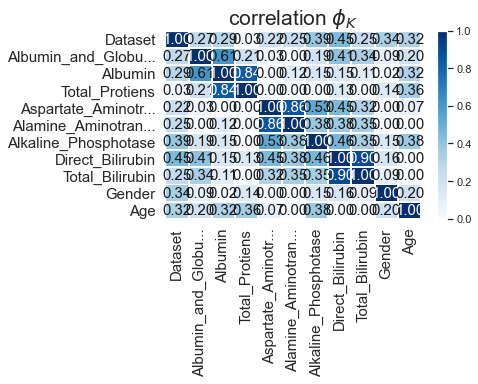

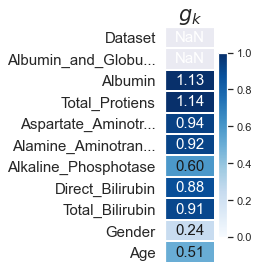

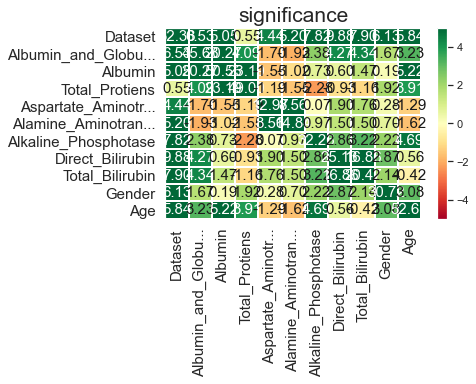

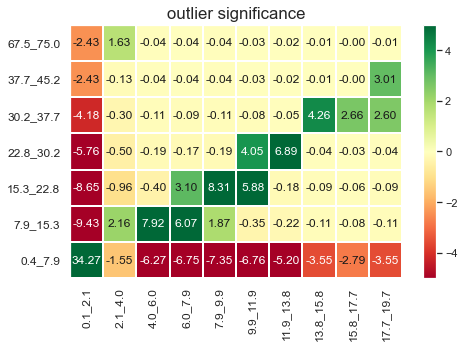

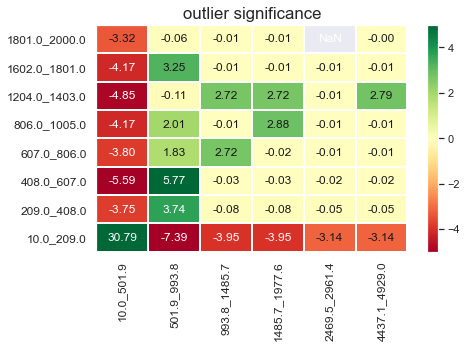

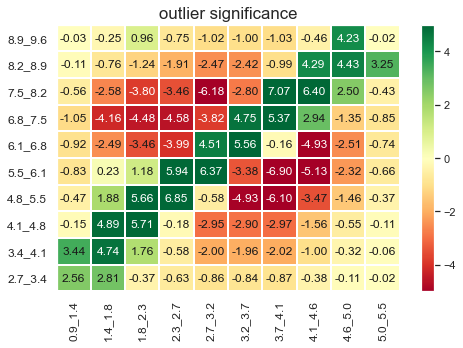

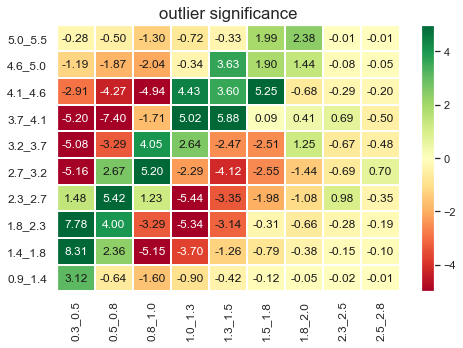

In [105]:
# generate a phik correlation report and save as test.pdf
report.correlation_report(data=Liver,interval_cols=['Age','Total_Bilirubin','Direct_Bilirubin','Alkaline_Phosphotase','Alamine_Aminotransferase','Aspartate_Aminotransferase','Total_Protiens','Albumin','Albumin_and_Globulin_Ratio'])
show()

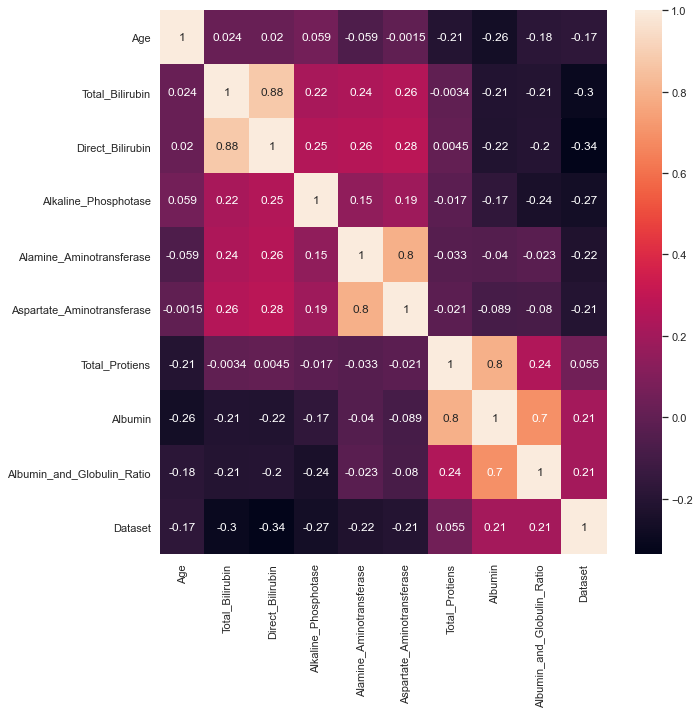

In [106]:
# Correlation plot by using heatmap
figure(figsize=(10,10)) # Assign the Plotting Figure Size of 10 by 10
heatmap(Liver.corr(), annot=True)
show()

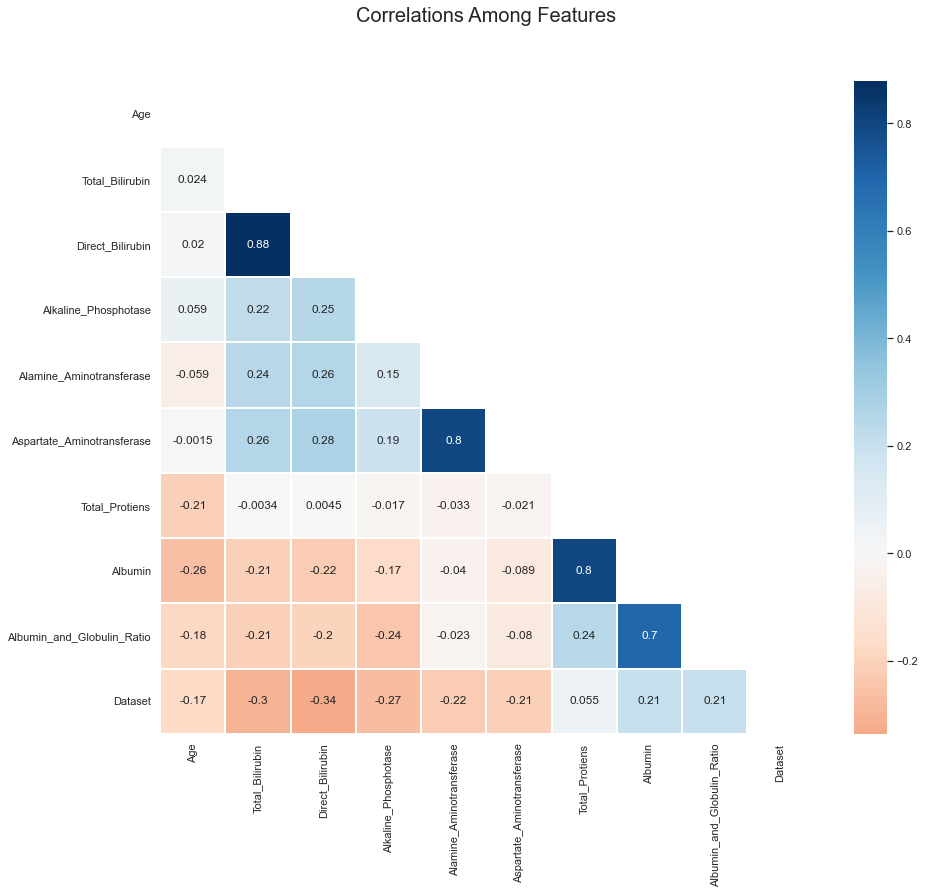

In [107]:
## heatmeap to see the correlation between features.
# Generate a mask for the upper triangle (taken from seaborn example gallery)
mask = zeros_like(Liver.corr(), dtype=bool)
mask[triu_indices_from(mask)] = True
set_style('whitegrid')
subplots(figsize = (15,12))
heatmap(Liver.corr(), 
            annot=True,
            mask = mask,
            cmap = 'RdBu', ## in order to reverse the bar replace "RdBu" with "RdBu_r"
            linewidths=.9, 
            linecolor='white',
            fmt='.2g',
            center = 0,
            square=True)
title("Correlations Among Features", y = 1.03,fontsize = 20, pad = 40);

In [111]:
Liver.Dataset = Liver.Dataset.astype('category')
Liver.Gender = Liver.Gender.astype('category')

In [112]:
# drop the duplicate rows (inplace=False by default)
Liver.drop_duplicates(keep='first', inplace=True)
Liver.shape

(766, 11)

In [113]:
# Now we will remove these Rows filled with NaN
# If any cell of a Row/Rows having a NaN value then remove that Row/Rows
# Removal will be not original
# .shape will show the remaining no of rows after dropping the NaN rows
Liver.dropna(how="any",inplace=True)
Liver.shape

(766, 11)

# Logistic Regression

The Accuracy of C parameter 1e-05 is 0.8051948051948052:
The Log Loss of C parameter 1e-05 is 0.6926588388259851:



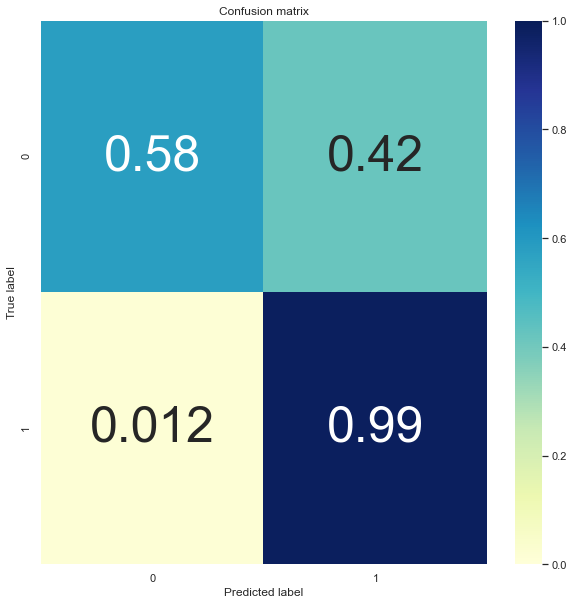

The Accuracy of C parameter 1.968419447286611e-05 is 0.8116883116883117:
The Log Loss of C parameter 1.968419447286611e-05 is 0.6921969703842291:



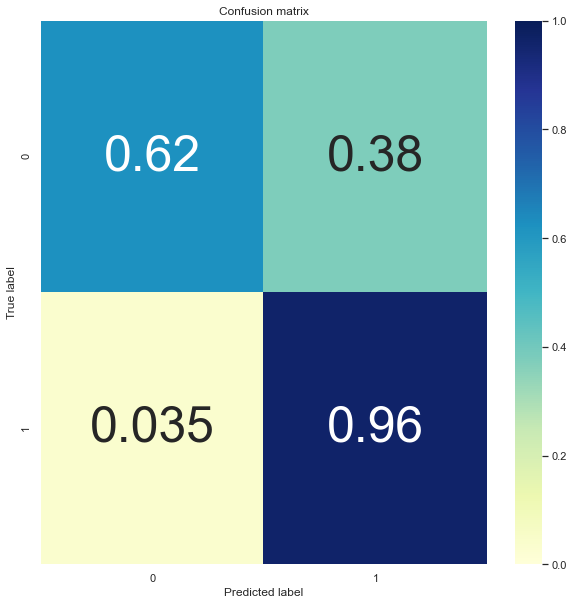

The Accuracy of C parameter 3.874675120456128e-05 is 0.8181818181818182:
The Log Loss of C parameter 3.874675120456128e-05 is 0.6912992526161471:



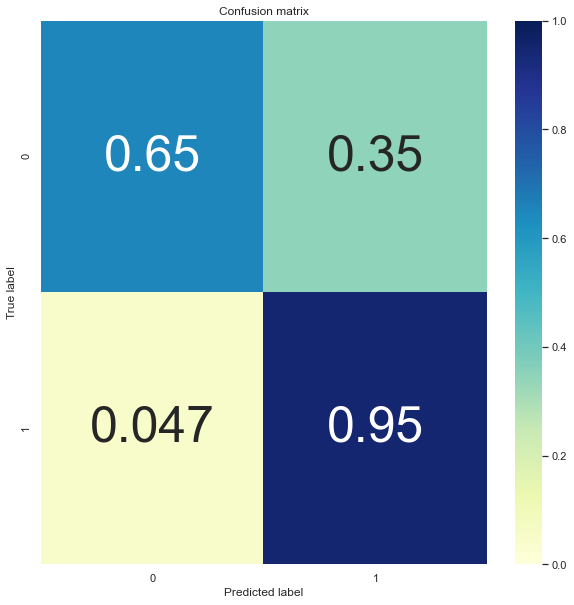

The Accuracy of C parameter 7.626985859023451e-05 is 0.8181818181818182:
The Log Loss of C parameter 7.626985859023451e-05 is 0.6895487488814275:



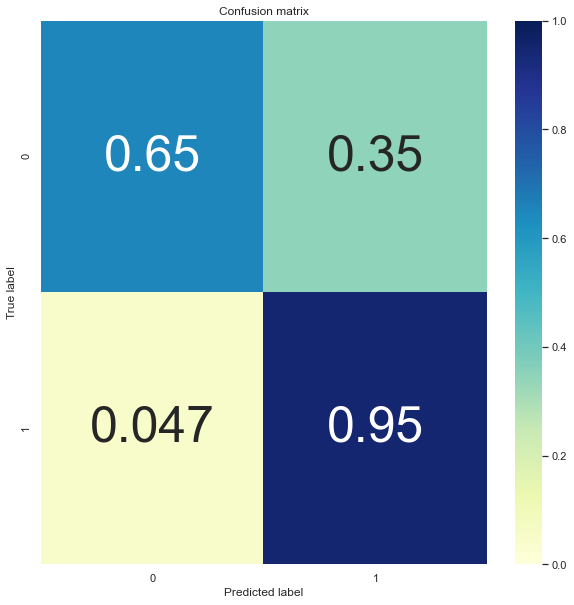

The Accuracy of C parameter 0.00015013107289081742 is 0.8246753246753247:
The Log Loss of C parameter 0.00015013107289081742 is 0.686210558882694:



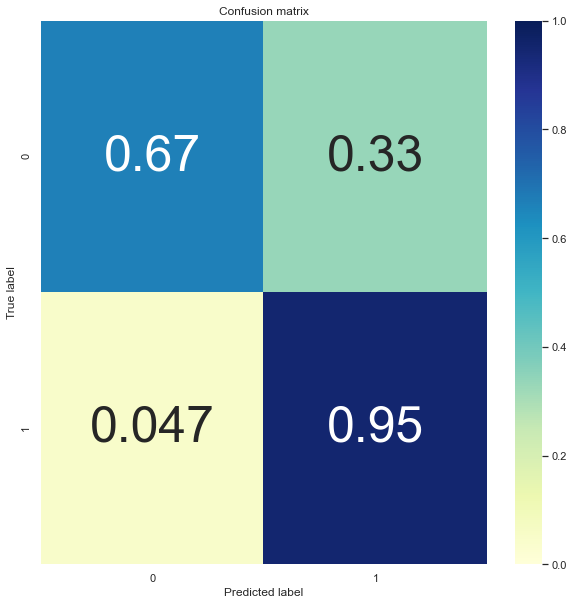

The Accuracy of C parameter 0.0002955209235202888 is 0.8246753246753247:
The Log Loss of C parameter 0.0002955209235202888 is 0.6800190887587124:



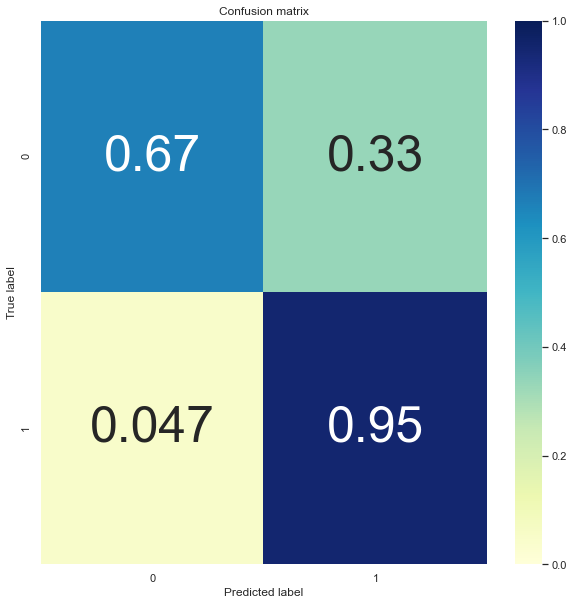

The Accuracy of C parameter 0.0005817091329374358 is 0.8311688311688312:
The Log Loss of C parameter 0.0005817091329374358 is 0.6691258875276159:



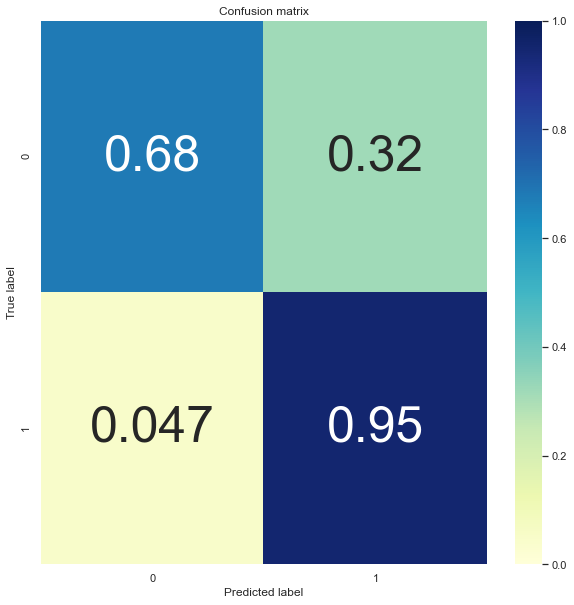

The Accuracy of C parameter 0.0011450475699382823 is 0.8311688311688312:
The Log Loss of C parameter 0.0011450475699382823 is 0.6515879519473948:



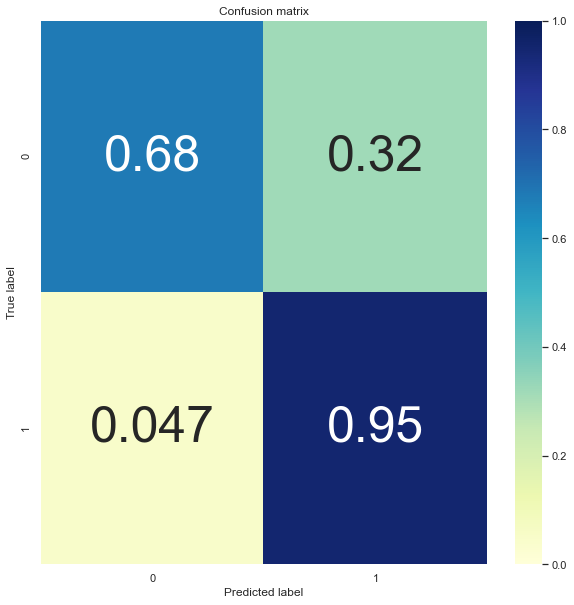

The Accuracy of C parameter 0.002253933904734791 is 0.8246753246753247:
The Log Loss of C parameter 0.002253933904734791 is 0.6267755906682335:



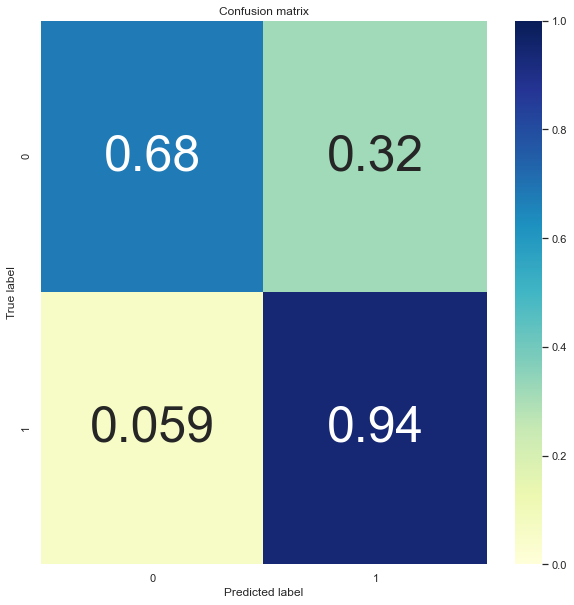

The Accuracy of C parameter 0.004436687330978612 is 0.8376623376623377:
The Log Loss of C parameter 0.004436687330978612 is 0.5966171430475969:



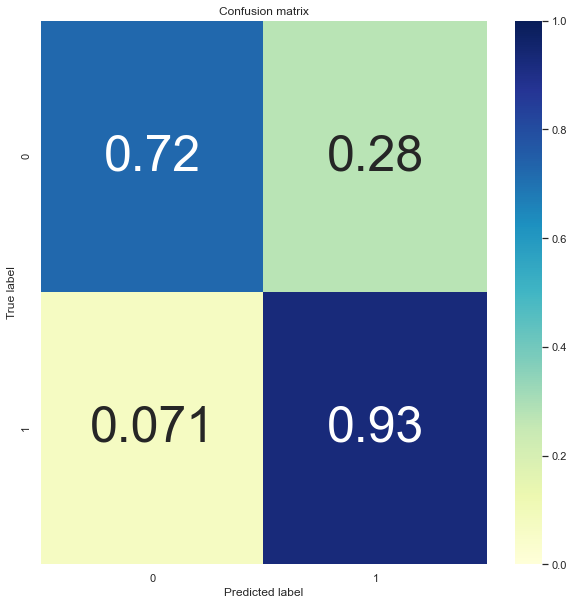

The Accuracy of C parameter 0.008733261623828438 is 0.8506493506493507:
The Log Loss of C parameter 0.008733261623828438 is 0.5647612400744894:



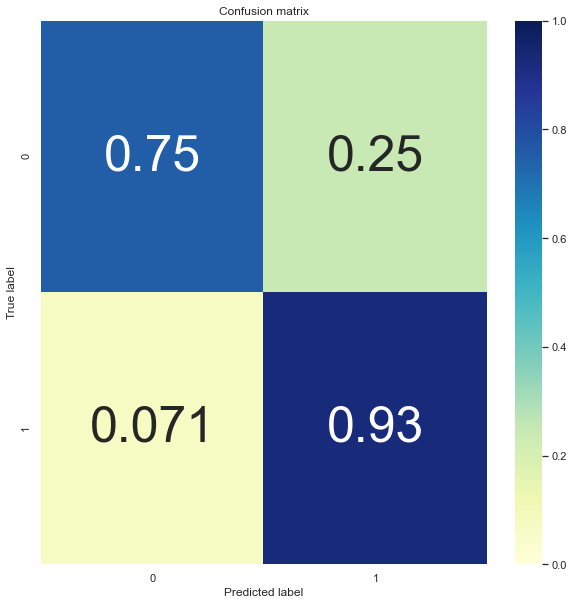

The Accuracy of C parameter 0.017190722018585746 is 0.8376623376623377:
The Log Loss of C parameter 0.017190722018585746 is 0.5344939437597368:



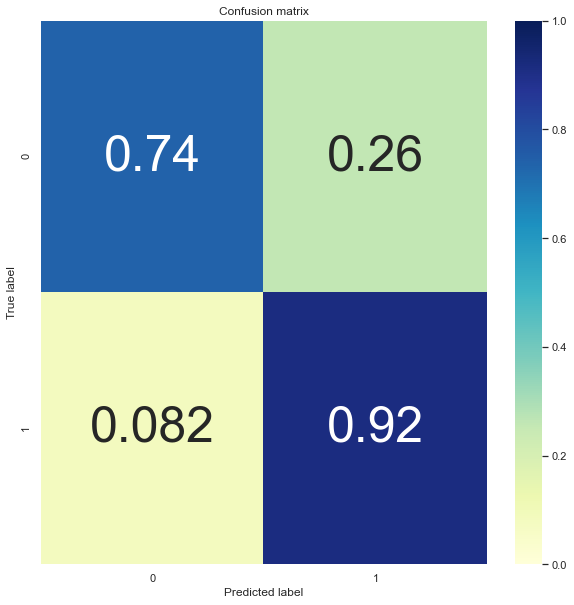

The Accuracy of C parameter 0.033838551534282335 is 0.8376623376623377:
The Log Loss of C parameter 0.033838551534282335 is 0.5077746466321416:



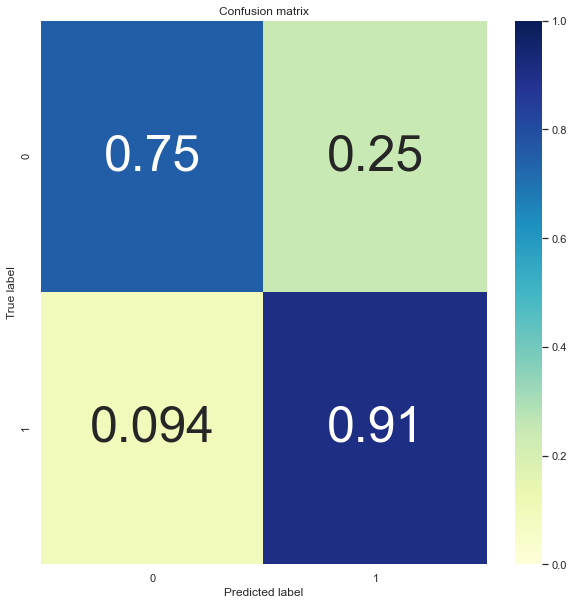

The Accuracy of C parameter 0.06660846290809161 is 0.8311688311688312:
The Log Loss of C parameter 0.06660846290809161 is 0.48555074783475033:



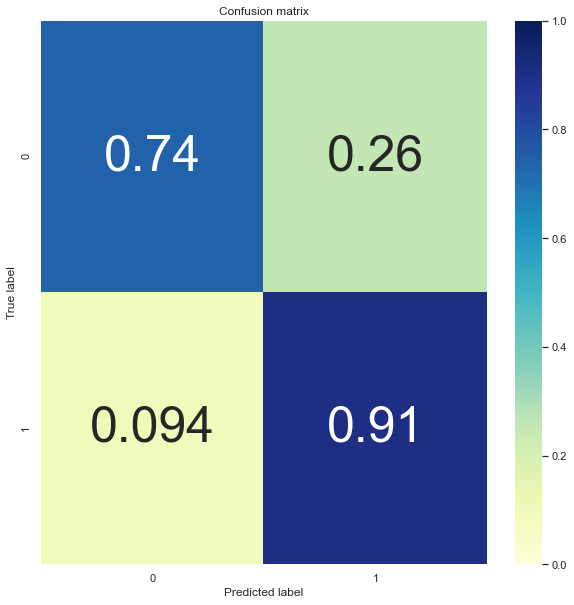

The Accuracy of C parameter 0.13111339374215658 is 0.8311688311688312:
The Log Loss of C parameter 0.13111339374215658 is 0.4681213100963695:



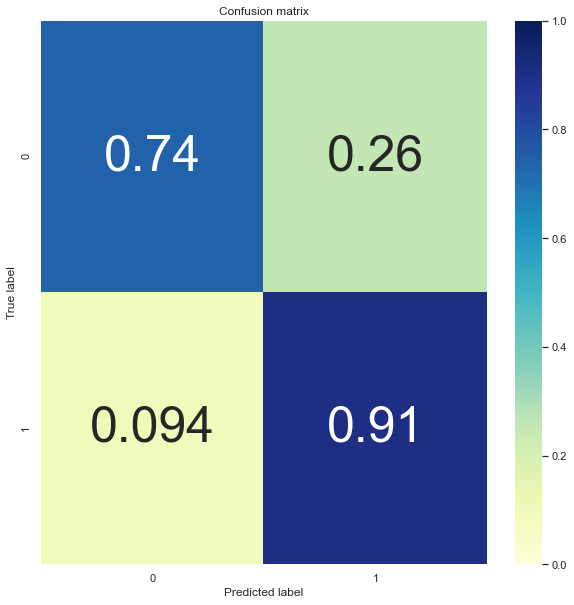

The Accuracy of C parameter 0.2580861540418077 is 0.8311688311688312:
The Log Loss of C parameter 0.2580861540418077 is 0.45534102299012696:



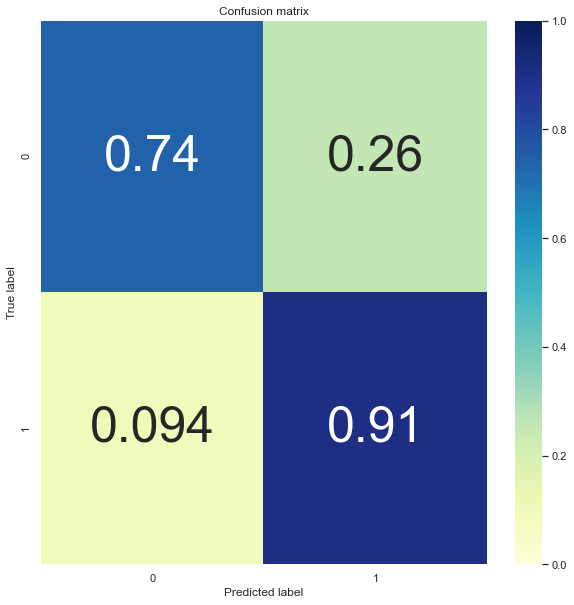

The Accuracy of C parameter 0.5080218046913023 is 0.8311688311688312:
The Log Loss of C parameter 0.5080218046913023 is 0.4467285198760041:



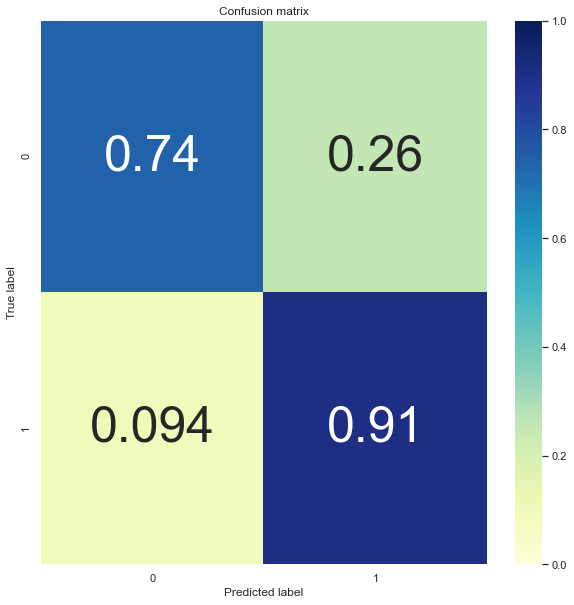

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 1.0 is 0.8376623376623377:
The Log Loss of C parameter 1.0 is 0.4414934644139577:



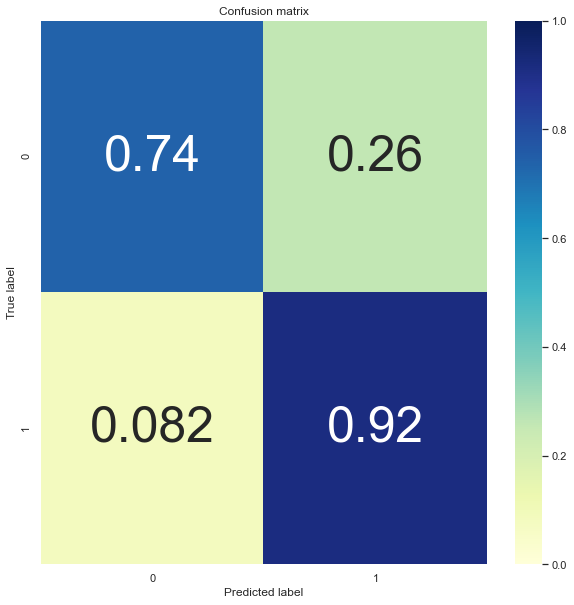

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 1.9684194472866112 is 0.8376623376623377:
The Log Loss of C parameter 1.9684194472866112 is 0.4386236792102158:



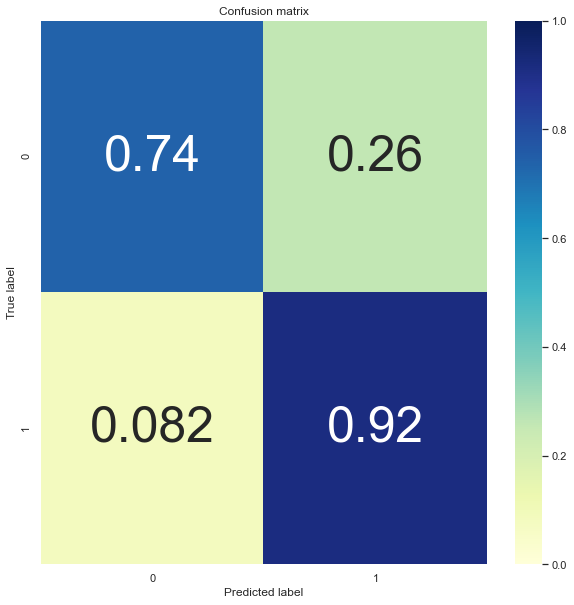

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 3.874675120456136 is 0.8441558441558441:
The Log Loss of C parameter 3.874675120456136 is 0.4371461857675279:



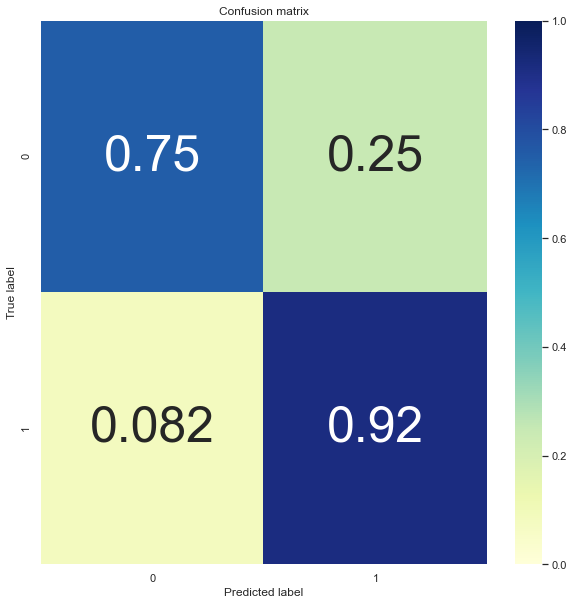

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 7.626985859023452 is 0.8441558441558441:
The Log Loss of C parameter 7.626985859023452 is 0.436403911498307:



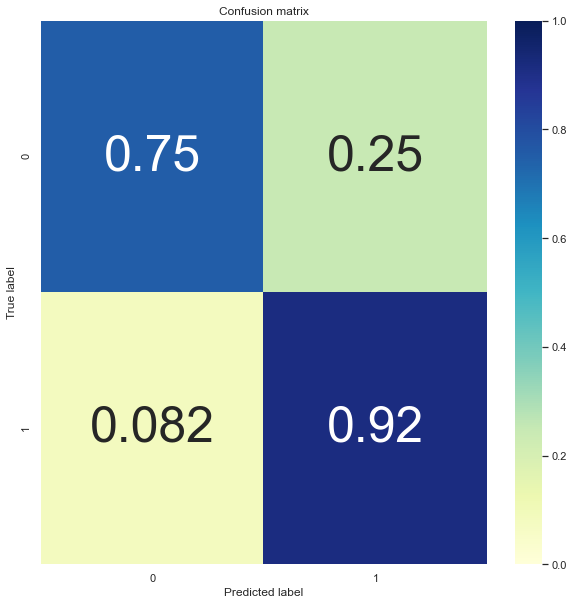

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 15.013107289081743 is 0.8441558441558441:
The Log Loss of C parameter 15.013107289081743 is 0.4360319589014405:



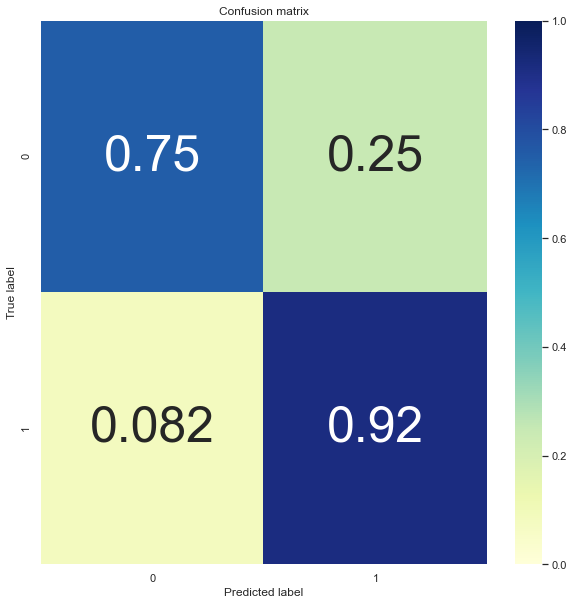

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 29.55209235202888 is 0.8441558441558441:
The Log Loss of C parameter 29.55209235202888 is 0.43584484274648183:



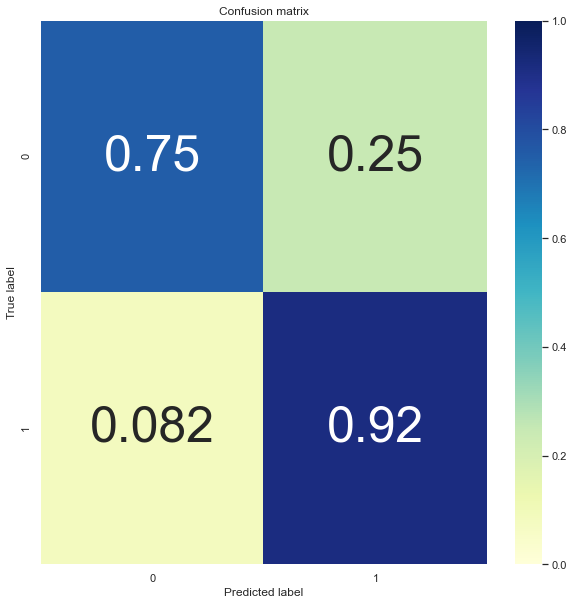

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 58.170913293743574 is 0.8441558441558441:
The Log Loss of C parameter 58.170913293743574 is 0.4357503378731018:



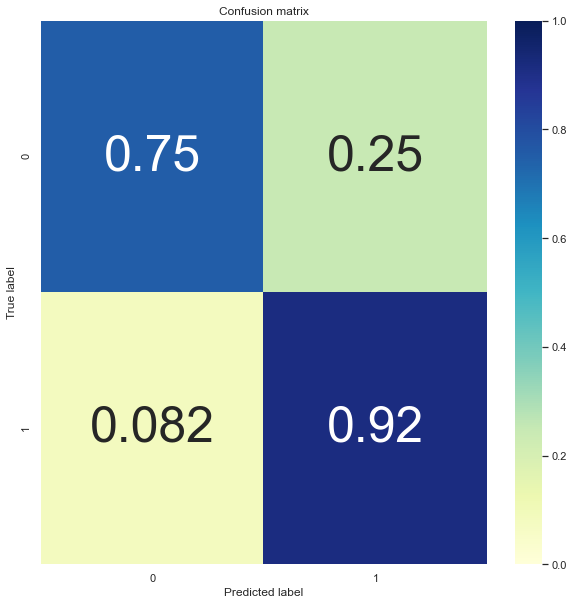

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 114.50475699382812 is 0.8441558441558441:
The Log Loss of C parameter 114.50475699382812 is 0.4357024814269006:



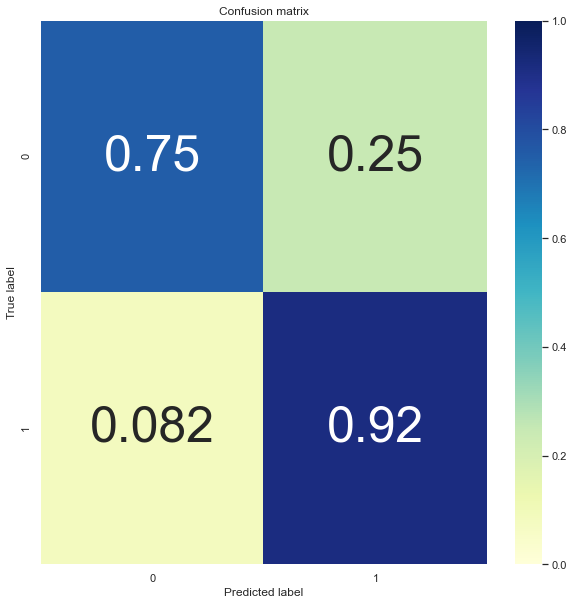

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 225.39339047347934 is 0.8441558441558441:
The Log Loss of C parameter 225.39339047347934 is 0.4356782105822807:



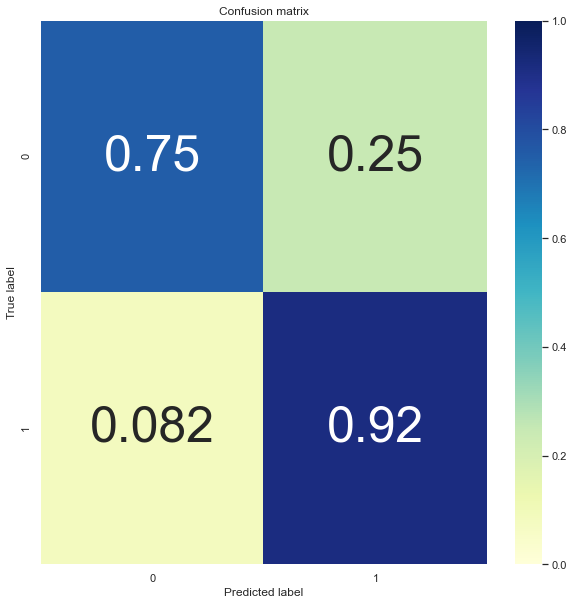

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 443.66873309786155 is 0.8441558441558441:
The Log Loss of C parameter 443.66873309786155 is 0.43566589131729666:



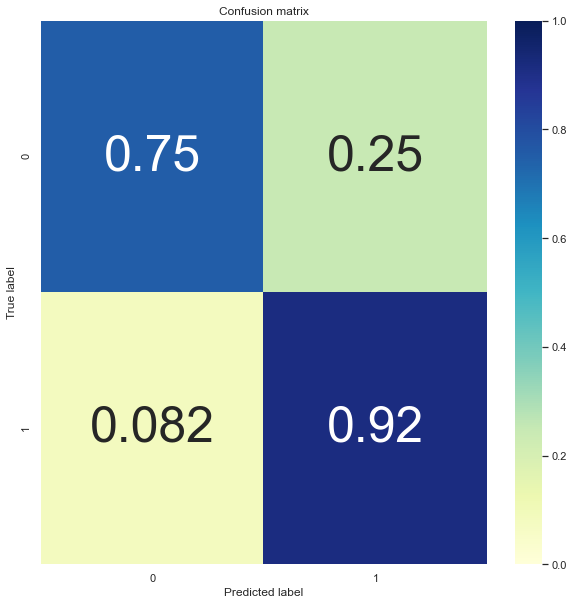

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 873.3261623828438 is 0.8441558441558441:
The Log Loss of C parameter 873.3261623828438 is 0.43565963568975197:



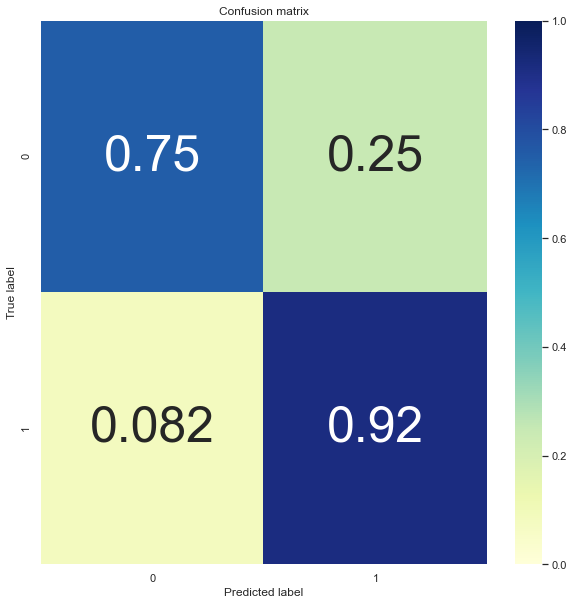

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 1719.0722018585782 is 0.8441558441558441:
The Log Loss of C parameter 1719.0722018585782 is 0.4356564584278595:



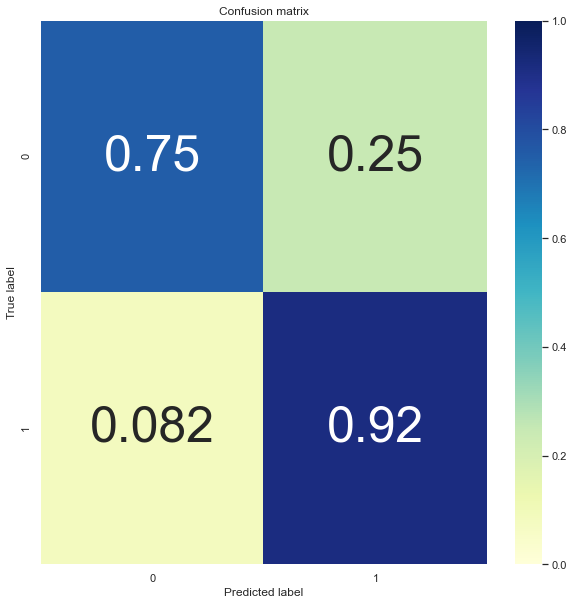

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 3383.8551534282333 is 0.8441558441558441:
The Log Loss of C parameter 3383.8551534282333 is 0.43565484449925906:



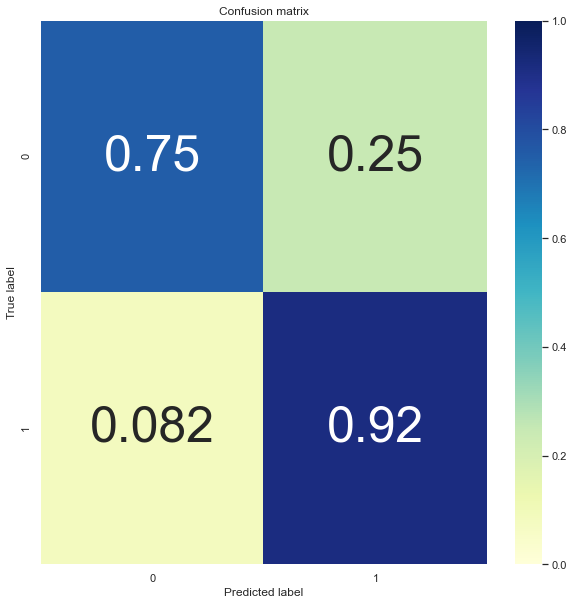

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 6660.846290809168 is 0.8441558441558441:
The Log Loss of C parameter 6660.846290809168 is 0.435654024637383:



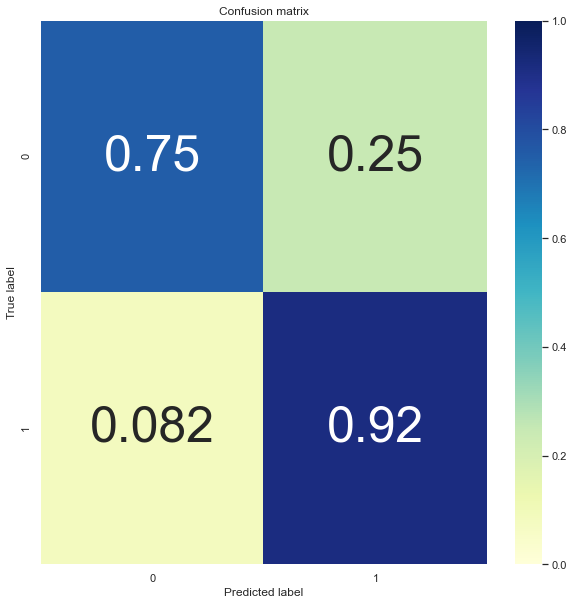

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 13111.33937421563 is 0.8441558441558441:
The Log Loss of C parameter 13111.33937421563 is 0.4356536081423111:



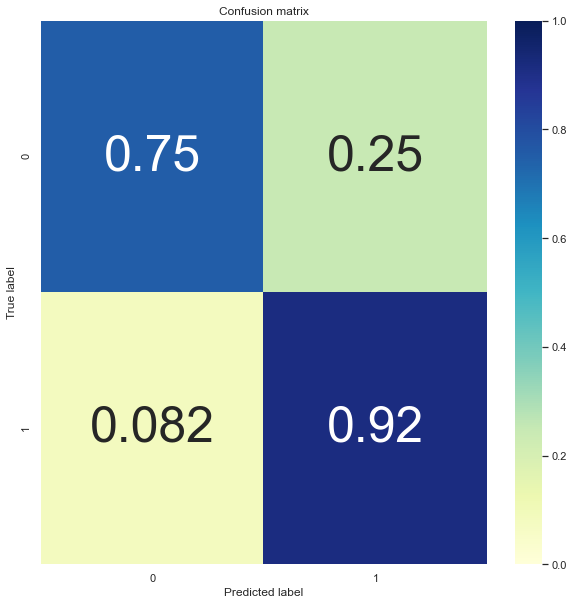

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 25808.615404180768 is 0.8441558441558441:
The Log Loss of C parameter 25808.615404180768 is 0.43565339655701524:



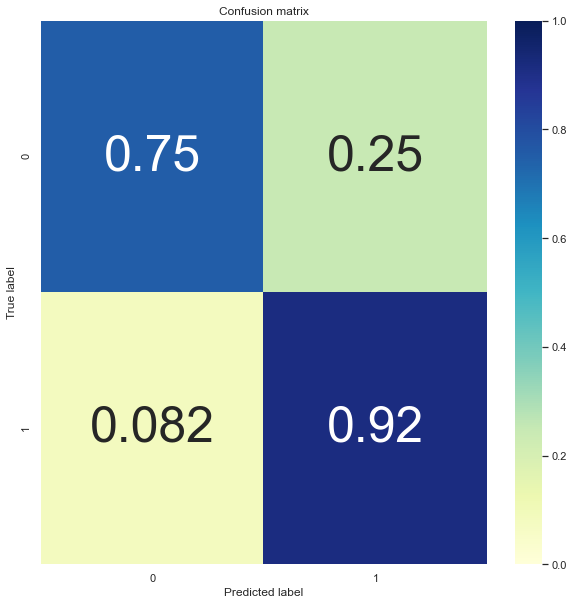

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 50802.18046913033 is 0.8441558441558441:
The Log Loss of C parameter 50802.18046913033 is 0.4356532890679006:



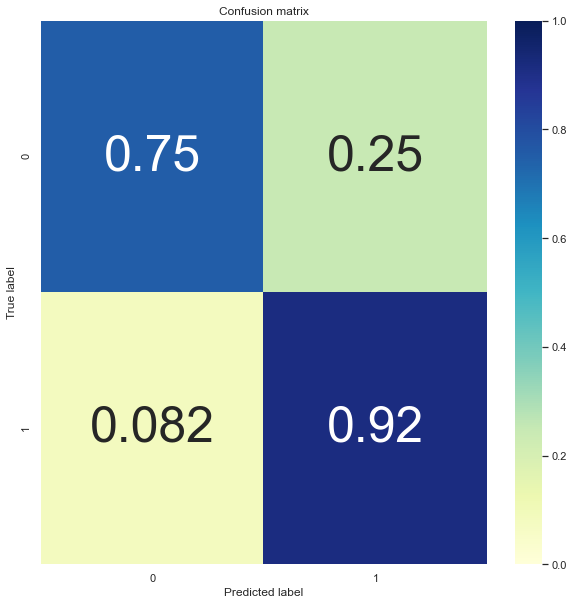

D:\D Program Files\Anaconda\lib\site-packages\sklearn\linear_model\_sag.py:330: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


The Accuracy of C parameter 100000.0 is 0.8441558441558441:
The Log Loss of C parameter 100000.0 is 0.43565323446131704:



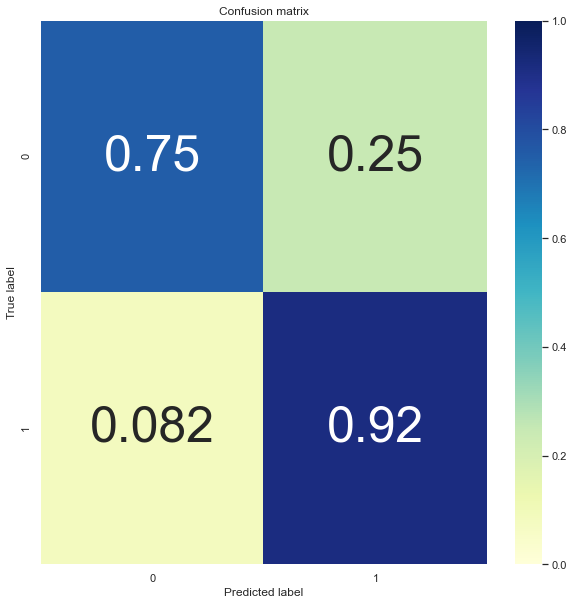

In [84]:
# Looping Over The Parametres & Checking the Confusion Matrixes
# Here we have selected geomspace range for C value because it is probably best for finding Global Minimum Loss
# Confusion Matrix function
def plot_confusion_matrix(cm, classes=None, title='Confusion matrix'):
    """Plots a confusion matrix."""
    if classes is not None:
        sns.heatmap(cm, cmap="YlGnBu", xticklabels=classes, yticklabels=classes, vmin=0., vmax=1., annot=True, annot_kws={'size':50})
    else:
        sns.heatmap(cm, vmin=0., vmax=1.)
    plt.title(title)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    
C_List = geomspace(1e-5,1e5,num=35)
Accuracy = []
Log_Loss = []
for c in C_List:
    LiverModel2=LogisticRegression(random_state=403,solver='saga', class_weight='balanced', C=c, penalty='l2')
    LiverModel2.fit(X_train,Y_train)
    Score=LiverModel2.score(X_test,Y_test)
    Accuracy.append(Score)
    print("The Accuracy of C parameter {} is {}:".format(c,Score))
    Predicted_Proba_Y = LiverModel2.predict_proba(X_test)
    Log_Loss2 = log_loss(Y_test,Predicted_Proba_Y)
    Log_Loss.append(Log_Loss2)
    print("The Log Loss of C parameter {} is {}:".format(c, Log_Loss2))
    print("")
    Y_pred = LiverModel2.predict(X_test)
    cm = confusion_matrix(Y_test, Y_pred)
    cm_norm = cm / cm.sum(axis=1).reshape(-1,1)
    plot_confusion_matrix(cm_norm, classes = LiverModel2.classes_, title='Confusion matrix')
    plt.show()

In [86]:
## Getting the best of everything.
print(LiverModel.best_score_)
print(LiverModel.best_params_)
print(LiverModel.best_estimator_)

0.7008130081300813
{'C': 0.8}
LogisticRegression(C=0.8, class_weight='balanced', solver='saga')


# Support Vector Machine

## KNN Tuning

In [151]:
## Importing the model.
## Always give test_size=.20
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import StratifiedShuffleSplit
## calling on the model oject. 
LiverKNN = KNeighborsClassifier(n_neighbors=49)
## knn classifier works by doing euclidian distance 


## doing 10 fold staratified-shuffle-split cross validation 
#cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=999)
cv = StratifiedShuffleSplit(n_splits = 5, test_size=0.20, random_state=999)
accuracies = cross_val_score(LiverKNN, Features, Label, cv = cv, scoring='balanced_accuracy')
print ("Cross-Validation balanced accuracy scores:{}".format(accuracies))
print ("Mean Cross-Validation mean balanced accuracy score: {}".format(round(accuracies.mean(),3)))

Cross-Validation balanced accuracy scores:[0.76174345 0.72515808 0.73148148 0.69188497 0.73750376]
Mean Cross-Validation mean balanced accuracy score: 0.73


In [183]:
from sklearn.model_selection import GridSearchCV
## Always give test_size=.20
## trying out multiple values for k
k_range = range(1,50)
## 
weights_options=['uniform','distance']
# 
param = {'n_neighbors':k_range, 'weights':weights_options}
## Using startifiedShufflesplit. 
cv = StratifiedShuffleSplit(n_splits=5, test_size=.20, random_state=618)
# estimator = knn, param_grid = param, n_jobs = -1 to instruct scikit learn to use all available processors. 
LiverKNN = GridSearchCV(KNeighborsClassifier(), param, cv=cv, verbose = False, n_jobs=-1)
## Fitting the model. 
LiverKNN.fit(X_train,Y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=618, test_size=0.2,
            train_size=None),
             estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': range(1, 50),
                         'weights': ['uniform', 'distance']},
             verbose=False)

In [184]:
print(LiverKNN.best_score_)
print(LiverKNN.best_params_)
print(LiverKNN.best_estimator_)

0.7479674796747967
{'n_neighbors': 5, 'weights': 'distance'}
KNeighborsClassifier(weights='distance')


In [185]:
### Using the best parameters from the grid-search.
LiverKNN= LiverKNN.best_estimator_
LiverKNN.score(X_test,Y_test)

0.8441558441558441

# GradientBoostingClassifier Hyperparameter Tuning

In [469]:
## Using StratifiedShuffleSplit No of Splits always should be 5 for 80% Train & 20% Test Split Pattern
## Always give test_size=.20
## We can use KFold, StratifiedShuffleSplit, StratiriedKFold or ShuffleSplit, They are all close cousins. look at sklearn userguide for more info.   
from sklearn.model_selection import StratifiedShuffleSplit, cross_val_score
cv = StratifiedShuffleSplit(n_splits = 5, test_size=.20, random_state=999) # run model 10x with 60/30 split intentionally leaving out 10%
accuracies = cross_val_score(GradientBoostingClassifier(n_estimators=150, learning_rate=0.47, max_depth=7), Features, Label, cv = cv)
print ("Cross-Validation accuracy scores:{}".format(accuracies))
print ("Mean Cross-Validation accuracy score: {}".format(round(accuracies.mean(),5)))

Cross-Validation accuracy scores:[0.88 0.79 0.81 0.79 0.84]
Mean Cross-Validation accuracy score: 0.82468
